In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import os,sys, gc, keras, time
from IPython.display import display

dirpath = os.getcwd().split("code")[0]+"code/"
sys.path.append(dirpath)
from pre_process import clean_LC,generate_representation
from evaluation import calculate_metrics, evaluate_metadata, evaluate_metadata_raw


folder = "../../KOI_Data/"
folder_lc = "/work/work_teamEXOPLANET/KOI_LC/"

Using TensorFlow backend.


In [2]:
keras.__version__

'2.1.3'

In [3]:
keras.layers.GRU(1,reset_after=False)                                                             


AttributeError: module 'tensorflow' has no attribute 'get_default_graph'

In [3]:
def impute_on_pandas(df):
    return df.fillna(df.median(),inplace=False)

df_meta = pd.read_csv(folder+"/kepler_dataset.csv")
all_labels = df_meta["NExScI Disposition"].values
mask_conf = (all_labels=="CONFIRMED")
mask_fp = (all_labels=="FALSE POSITIVE")
mask_cand = (all_labels=="CANDIDATE")

#NEW METADATA SELECTED!
metadata_used = ["Period", "Duration", "Time of Transit Epoch", "r/R", "a/R",
                 "Inclination", "Impact Parameter", 
                 "Fitted Stellar Density",
                 "Teq",
                 "Limb Darkening Coeff1", "Limb Darkening Coeff2",
                "Teff","Stellar Radius", "Stellar Mass"]
#dividir duration por 24??
df_meta["Duration"] = df_meta["Duration"]/24

#df_meta["Time of Transit Epoch"] = df_meta["Time of Transit Epoch"]- time_kepler[:,0] #modificacion

df_meta_obj = df_meta[metadata_used]
df_meta_obj.head()

,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Teq,Limb Darkening Coeff1,Limb Darkening Coeff2,Teff,Stellar Radius,Stellar Mass
0,8.884923,0.086252,169.991686,0.114,36.466,89.89,0.069,11.62061,770.0,0.497,0.204,5332.0,0.843,0.821
1,5.092465,0.152458,357.535940,0.014,10.670,89.14,0.161,0.88510,844.0,0.551,0.165,5037.0,0.751,0.727
2,275.073650,0.140417,315.248600,0.014,512.000,89.93,0.595,33.55994,303.0,0.437,0.243,5604.0,1.187,0.864
3,8.460439,0.197288,133.774490,0.478,14.087,85.68,1.061,0.73874,804.0,0.299,0.306,5951.0,0.702,0.796
4,21.761298,0.051792,166.540438,0.032,137.070,89.95,0.123,102.86534,486.0,0.627,0.108,4859.0,0.720,0.781


#### Impute nan

In [4]:
cand_nans = np.any(pd.isna(df_meta_obj[mask_cand]))
if cand_nans:
    print("Candidatos tienen nans")
    df_meta_obj[mask_cand] = df_meta_obj[mask_cand].fillna(df_meta_obj[mask_cand].median(),inplace=False)

cand_fp = np.any(pd.isna(df_meta_obj[mask_fp]))
if cand_fp:
    print("Falsos positivos tienen nans")
    df_meta_obj[mask_fp] = df_meta_obj[mask_fp].fillna(df_meta_obj[mask_fp].median(),inplace=False)

cand_conf = np.any(pd.isna(df_meta_obj[mask_conf]))
if cand_conf:
    print("Confirmados tienen nans")
    df_meta_obj[mask_conf] = df_meta_obj[mask_conf].fillna(df_meta_obj[mask_conf].median(),inplace=False)

Candidatos tienen nans


/opt/ohpc/pub/moduledeps/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.
/opt/ohpc/pub/moduledeps/anaconda3/lib/python3.7/site-packages/pandas/core/frame.py:3385: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.loc._setitem_with_indexer(indexer, value)
/opt/ohpc/pub/moduledeps/anaconda3/lib/python3.7/site-packages/pandas/core/frame.py:3367: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pan

Falsos positivos tienen nans


/opt/ohpc/pub/moduledeps/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


In [5]:
from autoencoder_utils import Recon_eval
Evaluate = Recon_eval()

def evaluate_reconst(x,xhat):
    print("----- EVALUANDO RECONSTRUCCION DE LA CURVA -----")
    res = Evaluate.get_res(x, xhat)
    plt.figure(figsize=(10,4))
    sns.distplot(res.flatten())
    plt.title("Distribucion de residuos promedio")
    plt.show()
    
    print("------------- Error -------------")
    #print("MSE      = ",Evaluate.MSE_LC(None,None, res))
    print("RMSE (+-) = ",Evaluate.RMSE_LC(None,None, res))
    print("MAE  (+-) = ",Evaluate.MAE_LC(None,None, res))
    
    print("------------- Smoothness -------------")
    xhat = np.squeeze(xhat)
    A = np.mean(np.apply_along_axis(Evaluate.autocorr_func, 1, xhat)[:,1])
    print("AutoCorr lag-one = ",A)
    M = np.mean(np.apply_along_axis(Evaluate.mean_diff, 1, xhat))
    print("Diff MEAN = ",M)
    #S = np.mean(np.apply_along_axis(Evaluate.std_diff, 1, xhat))
    #print("Diff STD = ",S)
    
    print("------------- Residual -------------")
    res = np.squeeze(res)
    R = np.mean(np.apply_along_axis(Evaluate.autocorr_func, 1, res)[:,1])
    print("AutoCorr lag-one = ",R)
    M = np.mean(np.apply_along_axis(np.mean, 1, res))
    S = np.mean(np.apply_along_axis(np.std, 1, res))
    print("Mean (+) STD = %f (+) %f"%(M,S))
    #perm = np.mean(np.apply_along_axis(Evaluate.series_entropy, 1, res, which='perm'))
    #print("Permutation H = ",perm)
    #spec = np.mean(np.apply_along_axis(Evaluate.series_entropy, 1, res, which='spec'))
    #print("Spectral H = ",spec)
    print("---------------------------------------")

In [7]:
keras.layers.GRU?

### Create dataset

How to select T?:
* Shallue T=2001 (ocupa local view tambien) -- usa convs
* Naul, Tsang T = 200 (division de fold) -- usa rnn
* Schanche T= 500 (division de fold)
* Armstrong (local) T=50
* Thompson T=141 (mezcla entre global y fold)

In [8]:
mask_transit = np.load("data/mask_transit_LC.npy")  #
# datos de abajo debieran ser todas las curvas.. poner mascara sobre los utilziados
mask_transit

array([ True,  True, False, ...,  True,  True,  True])

In [9]:
T = 300
X_fold_lc = np.load("data/LC_global_%dT.npy"%T)
X_fold_lc_aug = np.load("data/LC_globalA_%dT.npy"%T)
X_fold_time = np.load("data/Time_global_%dT.npy"%T)
X_fold_lc.shape

(8054, 300)

In [10]:
## NEW : set mask
X_fold_lc_tr = X_fold_lc[mask_transit]
X_fold_lc_aug_tr = X_fold_lc_aug[mask_transit]
X_fold_time_tr = X_fold_time[mask_transit]
N,T = X_fold_lc_tr.shape

In [11]:
mask_train = np.random.rand(X_fold_lc_tr.shape[0])< 1#0.75
mask_test = ~mask_train

In [12]:
#X_train = np.concatenate([X_fold_lc[mask_train[mask_conf]], X_fold_lc_aug[mask_train[mask_conf]]], axis=0)
X_train_t = np.concatenate([X_fold_time_tr[mask_train], X_fold_time_tr[mask_train]], axis=0)
#X_train = np.concatenate([X_fold_lc[mask_train[mask_conf]], X_fold_lc_aug[mask_train[mask_conf]]], axis=0)
X_train = np.concatenate([X_fold_lc_tr[mask_train], X_fold_lc_aug_tr[mask_train]], axis=0)

#X_test = X_fold_lc[mask_test[mask_conf]]
X_test = X_fold_lc_tr[mask_test]
#X_test_t = X_fold_time[mask_test[mask_conf]]
X_test_t = X_fold_time_tr[mask_test]

X_train = np.expand_dims(X_train, axis=-1)
X_test = np.expand_dims(X_test, axis=-1)

X_train_t = np.expand_dims(X_train_t, axis=-1)
X_test_t = np.expand_dims(X_test_t, axis=-1)

print("X train shape: ",X_train.shape)
print("X train time shape: ",X_train_t.shape)
print("X test shape: ",X_test.shape)

X train shape:  (8634, 300, 1)
X train time shape:  (8634, 300, 1)
X test shape:  (0, 300, 1)


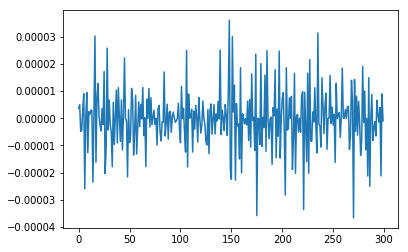

In [10]:
plt.plot(X_train[1248,:,0])
plt.show()

###  NEW

In [13]:
def scaled_MSE(y_true,y_pred,scale):
    return np.mean(np.mean( scale**2 * np.mean( (y_true - y_pred)**2 , axis=1), axis=0))

S_train = np.std(X_train, axis=1)
S_test = np.std(X_test, axis=1)

S_mu = np.mean(S_train)
S_std = np.std(S_train) 

X_train = X_train/S_train[:,None,:]
X_test = X_test/S_test[:,None,:]

In [14]:
S_fold = np.std(X_fold_lc, axis=1) #all data

X_train_all = X_fold_lc/S_fold[:,None]
X_train_t_all = X_fold_time

X_train_all = np.expand_dims(X_train_all, axis=-1)
X_train_t_all = np.expand_dims(X_train_t_all, axis=-1)
X_train_t_all.shape

(8054, 300, 1)

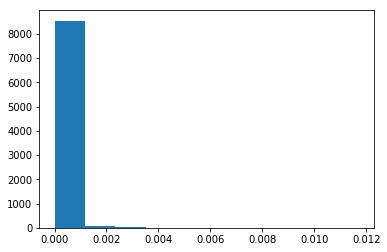

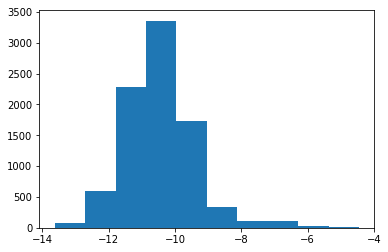

In [12]:
plt.hist(S_train)
plt.show()
plt.hist(np.log(S_train))
plt.show()

In [13]:
print("--------- Smoothness ------------")
x_aux = np.squeeze(X_train[:N,:,0])
A = np.mean(np.apply_along_axis(Evaluate.autocorr_func, 1, x_aux)[:,1])
print("AutoCorr lag-one = ",A)
M = np.mean(np.apply_along_axis(Evaluate.mean_diff, 1, x_aux))
print("Diff MEAN = ",M)
S = np.mean(np.apply_along_axis(Evaluate.std_diff, 1, x_aux))
print("Diff STD = ",S)
print("--------- Smoothness ------------")
del x_aux

--------- Smoothness ------------
AutoCorr lag-one =  0.2726586971818649
Diff MEAN =  0.7840281211441535
Diff STD =  0.8318126136642712
--------- Smoothness ------------


### Keras models

In [15]:
import keras
from keras import backend as K
from keras.models import Sequential, Model
from keras.layers import *

from IPython.display import SVG
from keras.utils.vis_utils import model_to_dot
from sklearn.metrics import mean_squared_error
def plot_n_lc(real_lc, decoded_lc, n = 10, s=None):
    for _ in range(n):
        n_sampled = np.random.randint(0, real_lc.shape[0])
        real_lc_n = np.squeeze(real_lc[n_sampled])
        decoded_lc_n = np.squeeze(decoded_lc[n_sampled])
        
        if s !=None:
            print("Real scale = %f\nPred scale = %f"%(s[0][n_sampled], s[1][n_sampled] ))
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, sharey=True,figsize= (15,5))
        ax1.plot(real_lc_n, 'b.-')
        ax1.set_title("Real")
        ax2.plot(decoded_lc_n, 'b.-')
        ax2.set_title("Reconstructed")
        ax3.plot(real_lc_n-decoded_lc_n, 'b.-')
        ax3.set_title("Residuo")
        plt.show()  

        plt.figure(figsize=(15,5))
        plt.plot(real_lc_n, 'bo-', label="Real")
        plt.plot(decoded_lc_n, 'g*-', label="Reconstructed")
        plt.title("Over")
        plt.legend()
        plt.show()
        print("----------------------------------------------------------------")

## Regular VAE

In [16]:
from autoencoder_utils import define_samp_model
from autoencoder_utils import Mul_L,  Div_L
latent_dim = 16
EPOCHS = 300

_, T, channels = X_train.shape

#### Para cargar los pesos se deben cargar encoder y decoder
```python
encoder.load_weights("./models/VAE_%dT_%dD_%de_E.h5"%(T,latent_dim,EPOCHS))
generator.load_weights("./models/VAE_%dT_%dD_%de_D.h5"%(T,latent_dim,EPOCHS)
```
o se puede
```python
vae.get_layer("encoder").load_weights("./models/VAE_%dT_%dD_%de_E.h5"%(T,latent_dim,EPOCHS))
vae.get_layer("generator").load_weights("./models/VAE_%dT_%dD_%de_D.h5"%(T,latent_dim,EPOCHS))
```

#### Si se ejecuta en CPU (como en datecenter) GRU debe tener la siguiente configuración
```python
gru_args = {'reset_after':True, 'recurrent_activation':'sigmoid', 'implementation':2} 
GRU(units, return_sequences=T o F, **gru_args)
```

In [15]:
def get_GRU(units, **args):
    try:
        from keras.layers import CuDNNLSTM
        import tensorflow as tf
        GPU_AVAIL = tf.test.is_gpu_available() 
    except:
        GPU_AVAIL = False
    
    if GPU_AVAIL:
        layer = CuDNNGRU(units, **args)
    else:
        from keras.layers import GRU
        gru_args = {'reset_after':True, 'recurrent_activation':'sigmoid', 'implementation':2} 
        layer = GRU(units, **gru_args, **args)
    return layer

from autoencoder_utils import get_GRU

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
T_inp (InputLayer)              (None, 300, 1)       0                                            
__________________________________________________________________________________________________
LC_inp (InputLayer)             (None, 300, 1)       0                                            
__________________________________________________________________________________________________
encoder (Model)                 [(None, 32), (None,  108864      T_inp[0][0]                      
                                                                 LC_inp[0][0]                     
__________________________________________________________________________________________________
norm_sampl (Model)              (None, 32)           0           encoder[1][0]                    
          

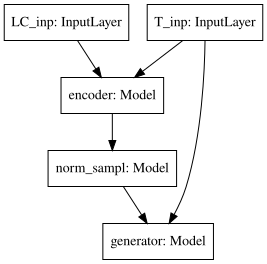

In [40]:
x_lc = Input(shape = (T, channels) , name="LC_inp")
x_t = Input(shape = (T, 1) , name ="T_inp")

x = Concatenate(axis=-1)([x_t, x_lc]) #add time encode

f1 = Bidirectional(get_GRU(64, return_sequences=True))(x) #bidirectional
f1 = Bidirectional(get_GRU(64, return_sequences=False))(f1) #bidirectional

z_mean = Dense(latent_dim,activation='linear')(f1)
z_log_var = Dense(latent_dim,activation='linear')(f1)
encoder = Model([x_t, x_lc], [z_mean,z_log_var], name="encoder")
samp_model = define_samp_model(latent_dim) #model to sample

decoder_input = Input(shape=(latent_dim,))
decode = RepeatVector(T)(decoder_input)

decode = Concatenate(axis=-1)([x_t, decode]) #add time decode

decode = Bidirectional(get_GRU(64, return_sequences=True))(decode) #bidirectional
decode = Bidirectional(get_GRU(64, return_sequences=True))(decode) #bidirectional

decode = TimeDistributed(Dense(1, activation='linear'))(decode)
generator = Model([x_t, decoder_input], decode, name="generator")

# instantiate VAE model
out = generator([x_t, samp_model(encoder([x_t, x_lc])) ])
vae = Model([x_t, x_lc], out)

#vae.compile(optimizer='adam', loss=vae_loss, metrics = [KL_loss, MSE_loss])
vae.get_layer("encoder").load_weights("./models/VAE_%dT_%dD_%de_E.h5"%(T,latent_dim,EPOCHS))
vae.get_layer("generator").load_weights("./models/VAE_%dT_%dD_%de_D.h5"%(T,latent_dim,EPOCHS))

vae.summary()
SVG(model_to_dot(vae).create(prog='dot', format='svg'))

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


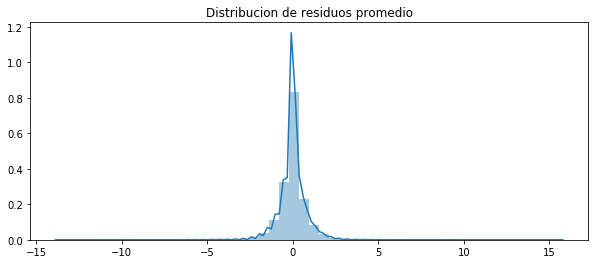

------------- Error -------------
RMSE (+-) =  0.6851999866125437
MAE  (+-) =  0.48048974232577696
------------- Smoothness -------------
AutoCorr lag-one =  0.56919974
Diff MEAN =  0.075348586
------------- Residual -------------
AutoCorr lag-one =  -0.05406188738976387
Permutation H =  0.9958052635491688
Spectral H =  0.9000592832629155
---------------------------------------


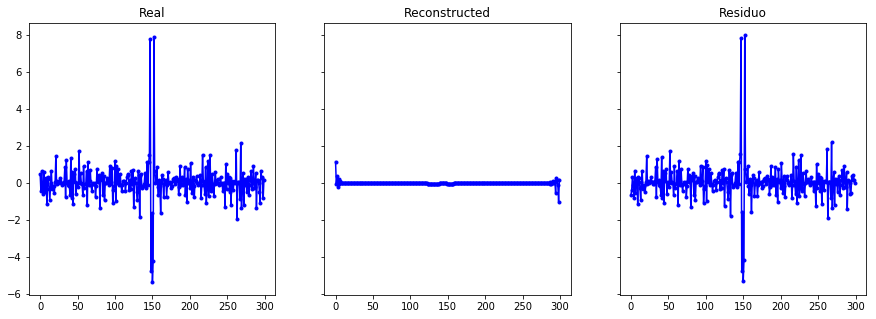

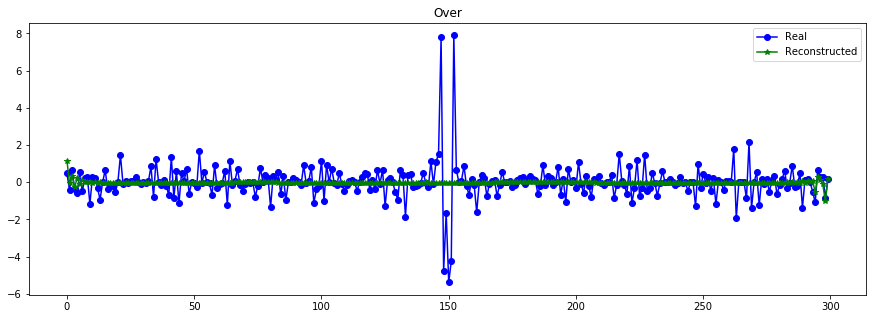

----------------------------------------------------------------


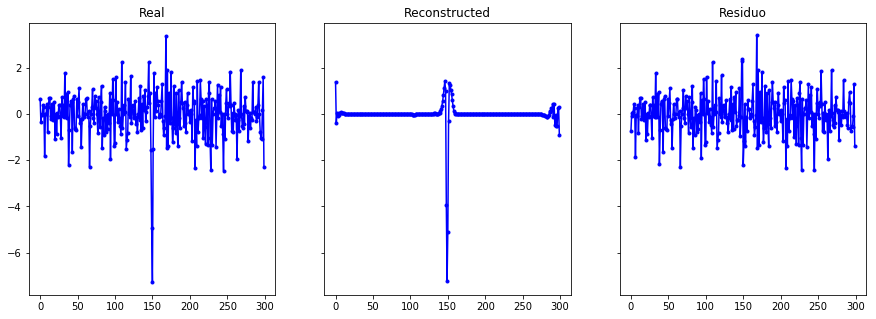

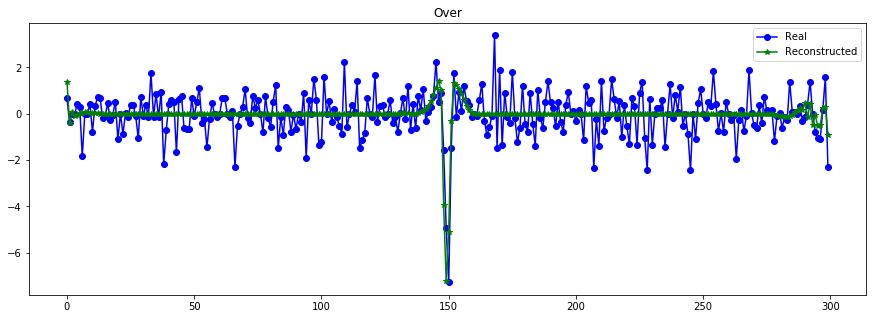

----------------------------------------------------------------


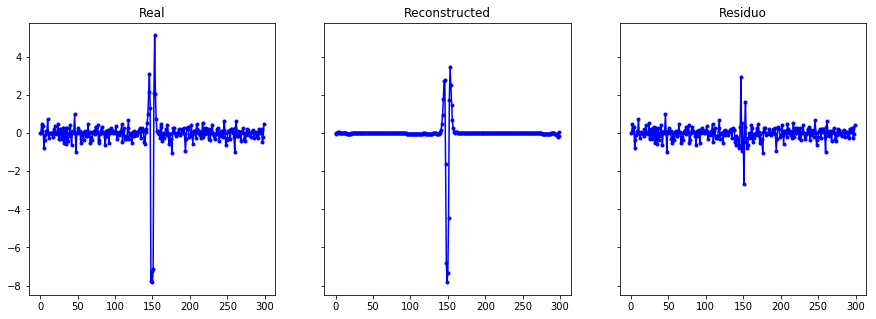

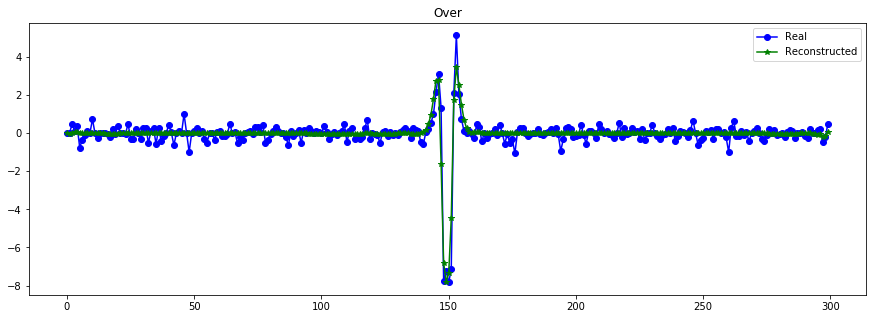

----------------------------------------------------------------


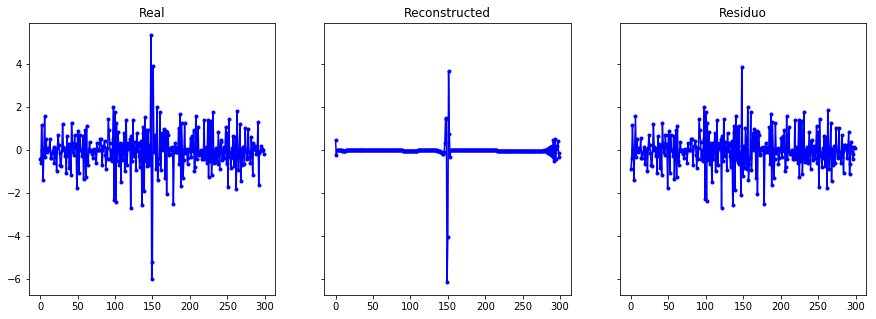

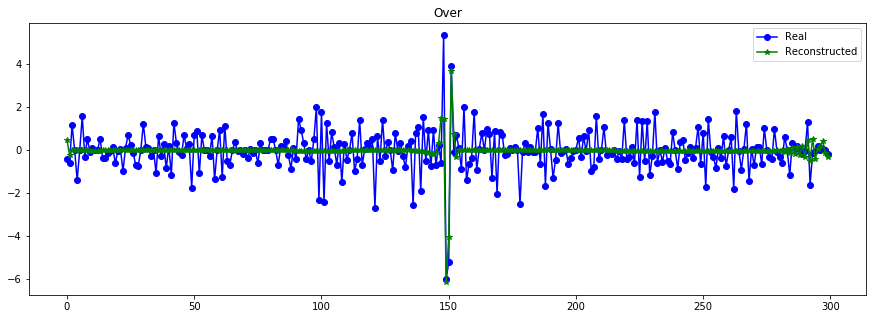

----------------------------------------------------------------


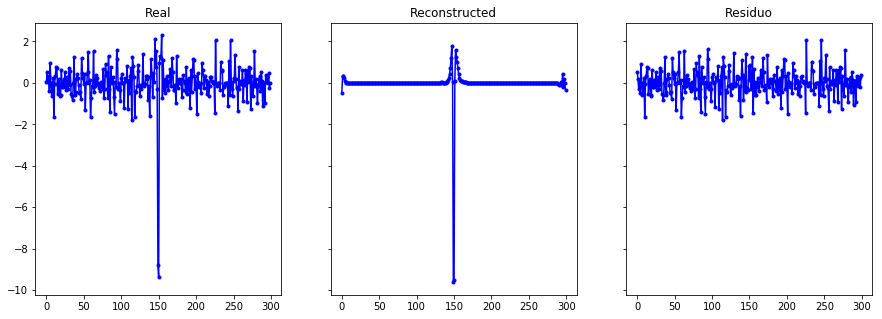

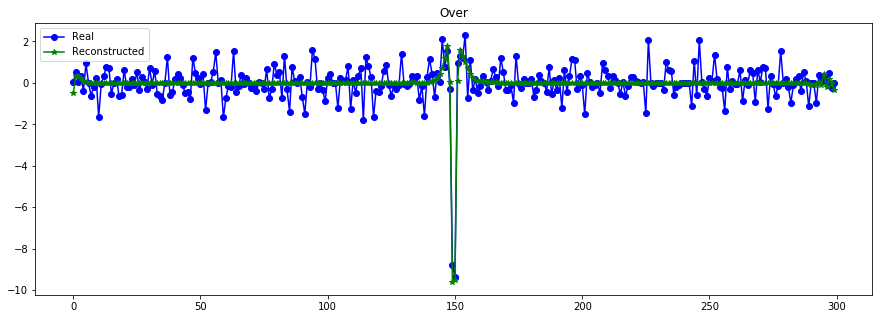

----------------------------------------------------------------


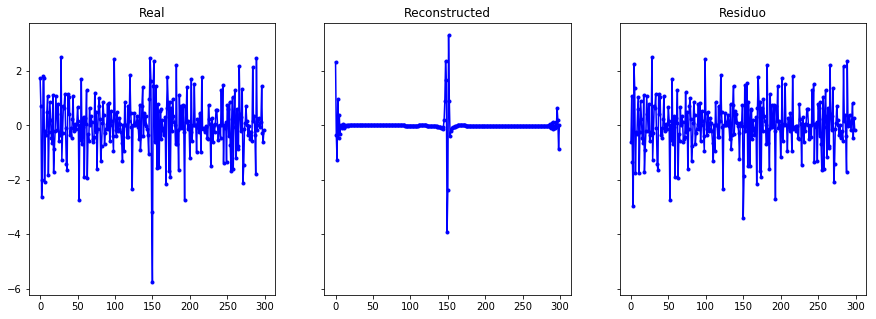

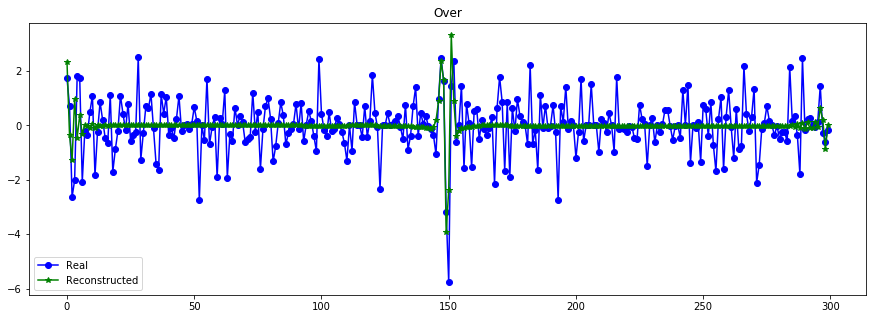

----------------------------------------------------------------


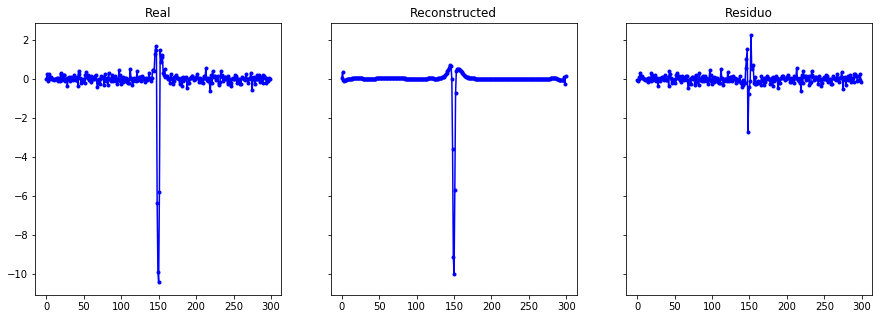

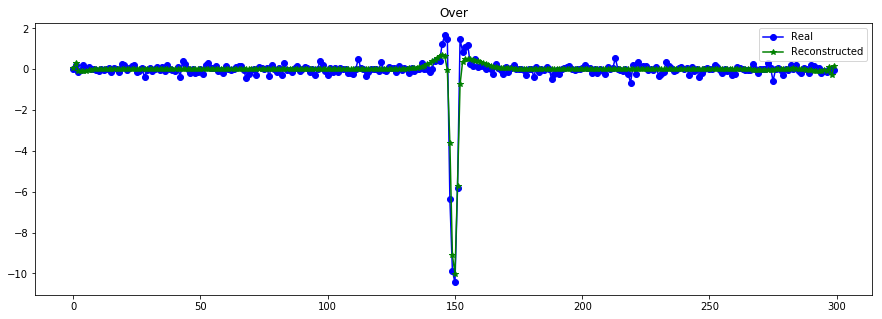

----------------------------------------------------------------


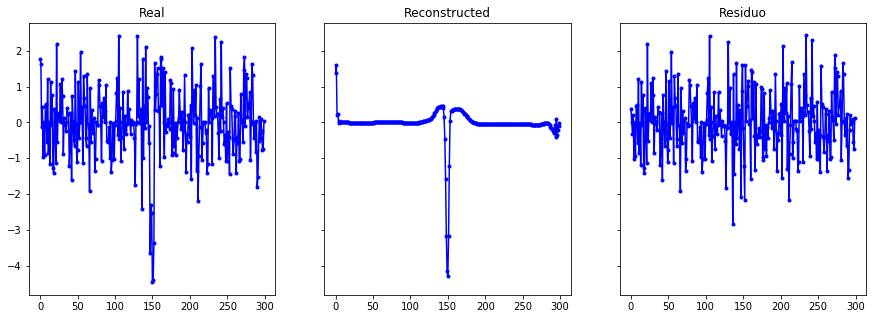

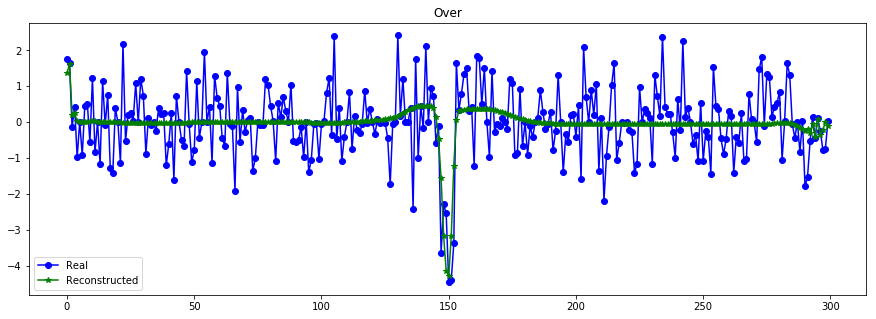

----------------------------------------------------------------


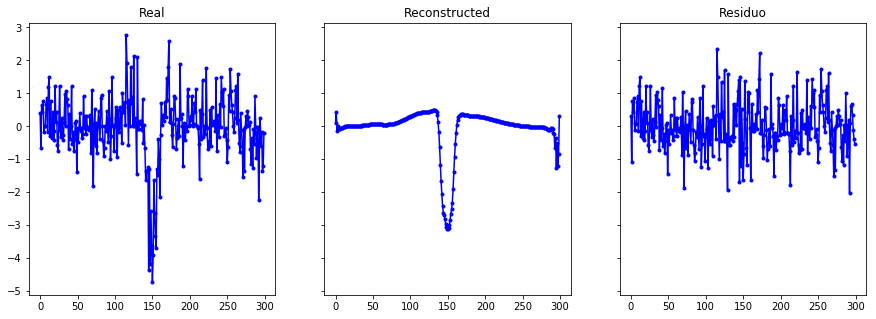

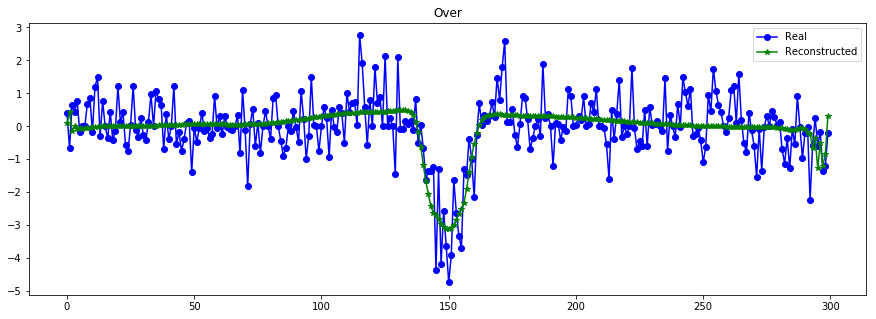

----------------------------------------------------------------


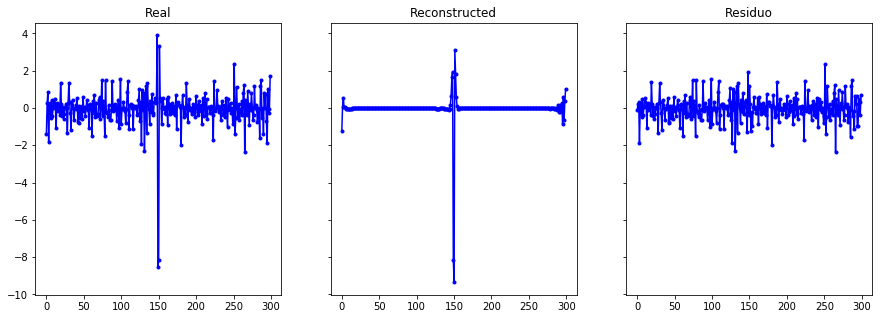

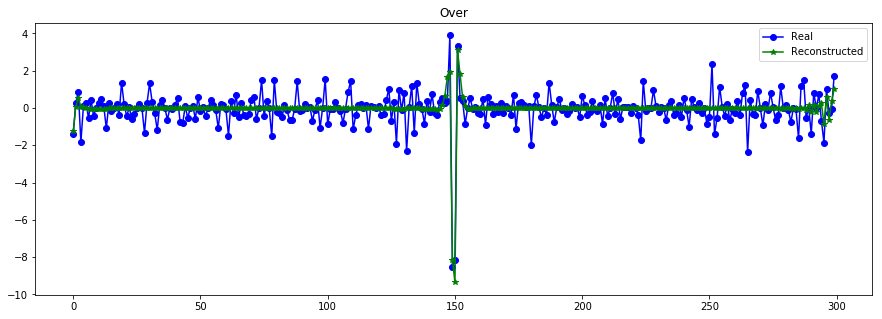

----------------------------------------------------------------


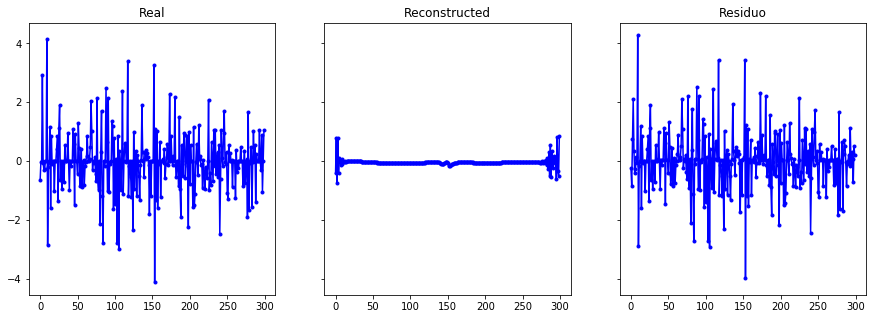

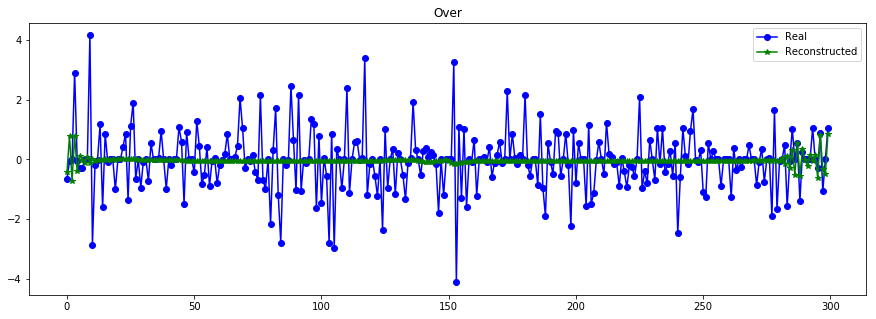

----------------------------------------------------------------


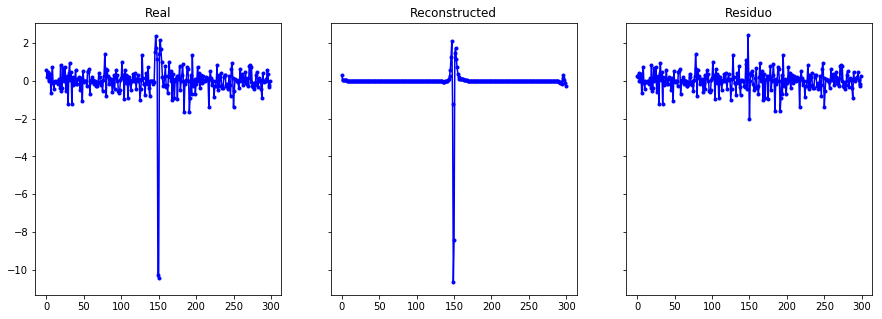

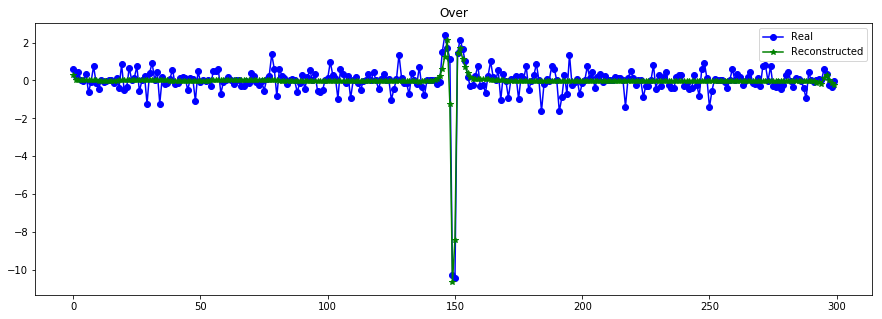

----------------------------------------------------------------


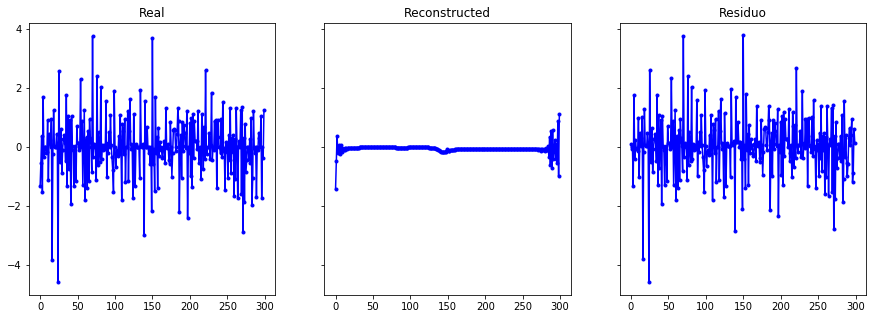

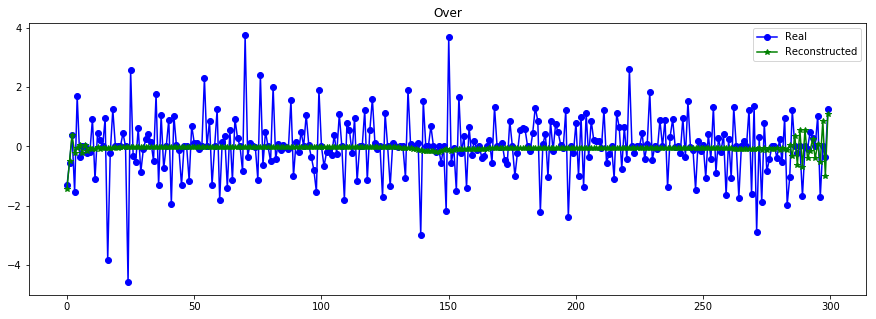

----------------------------------------------------------------


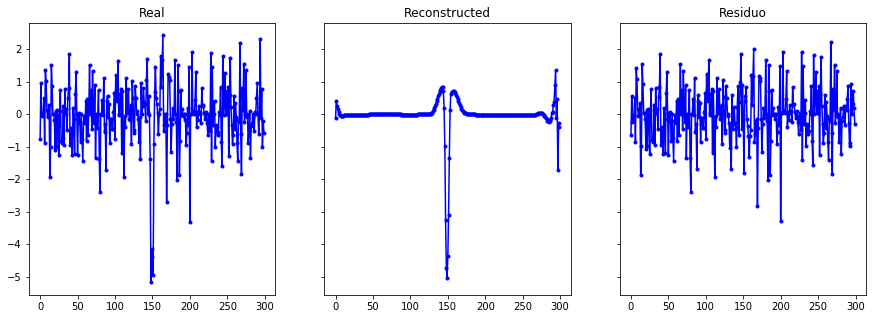

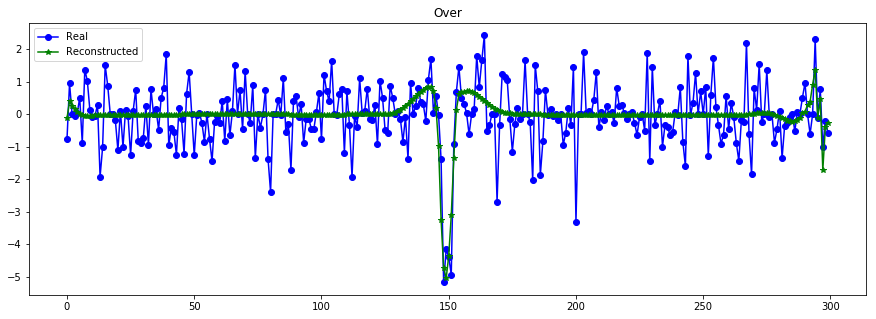

----------------------------------------------------------------


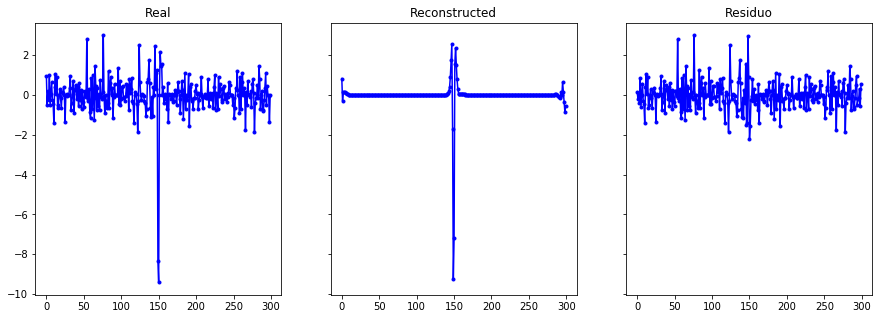

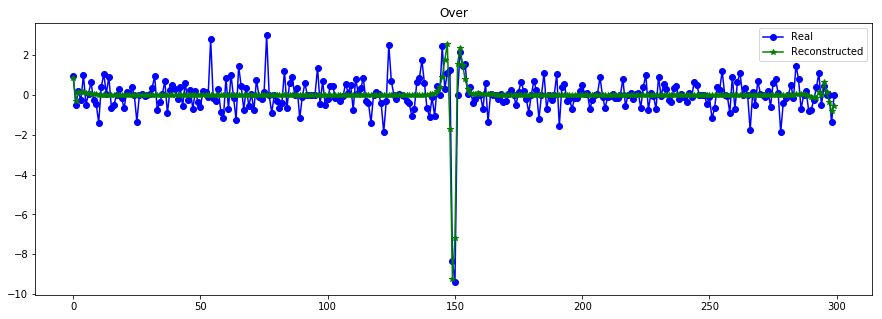

----------------------------------------------------------------


In [20]:
X_train_hat = vae.predict([X_train_t[:N], X_train[:N]], batch_size=512)
evaluate_reconst(X_train[:N], X_train_hat)

plot_n_lc(X_train[:N,:,0], X_train_hat, n= 15)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


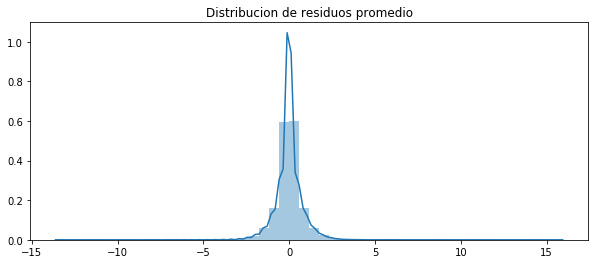

------------- Error -------------
RMSE (+-) =  0.6881706728023332
MAE  (+-) =  0.48362314371703297
------------- Smoothness -------------
AutoCorr lag-one =  0.5935378
Diff MEAN =  0.068336315
------------- Residual -------------
AutoCorr lag-one =  -0.047154217968756545
Permutation H =  0.9957945745011851
Spectral H =  0.901278583865734
---------------------------------------


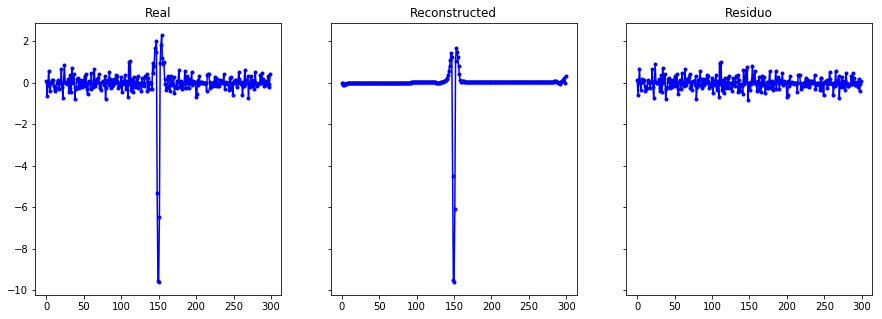

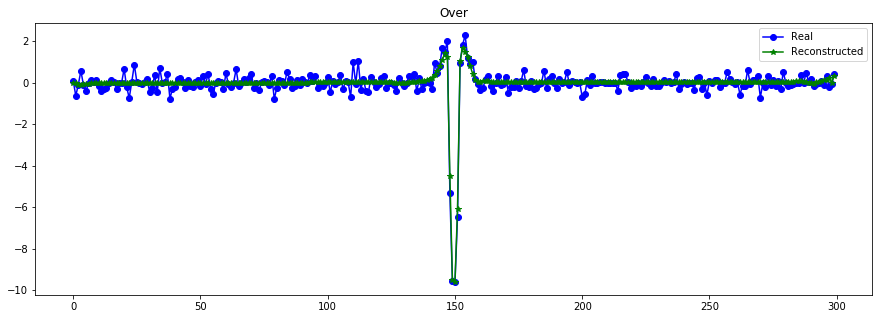

----------------------------------------------------------------


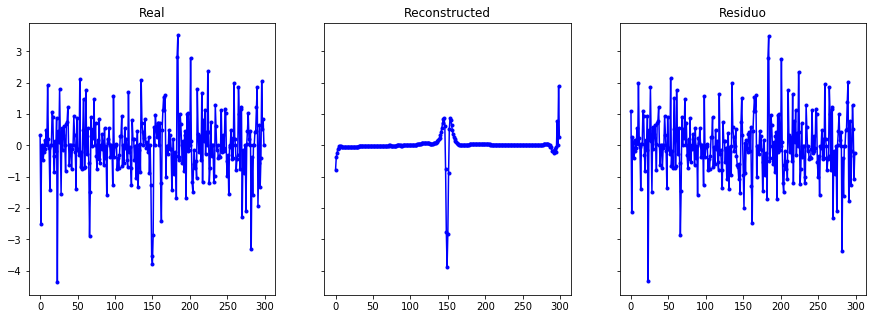

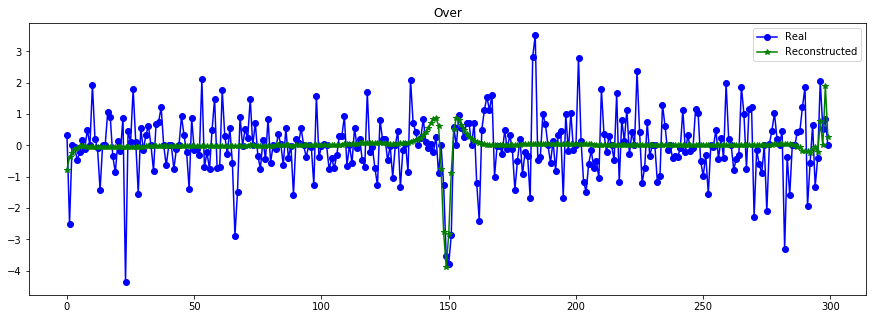

----------------------------------------------------------------


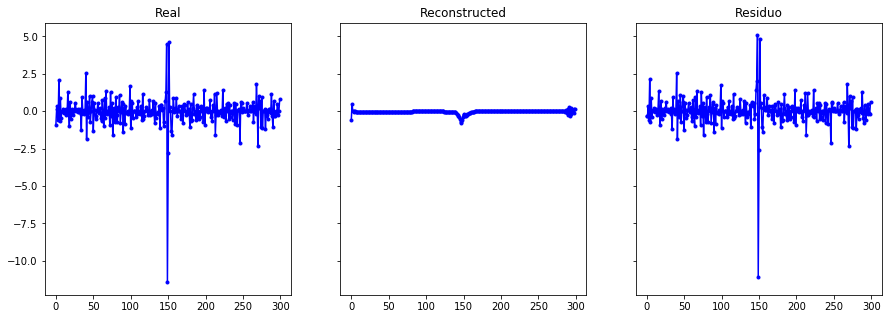

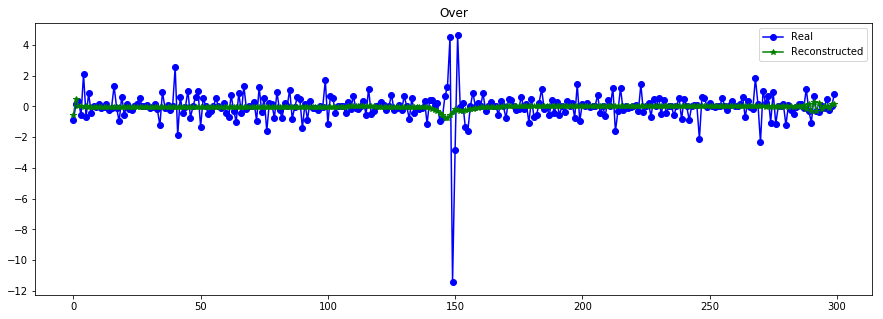

----------------------------------------------------------------


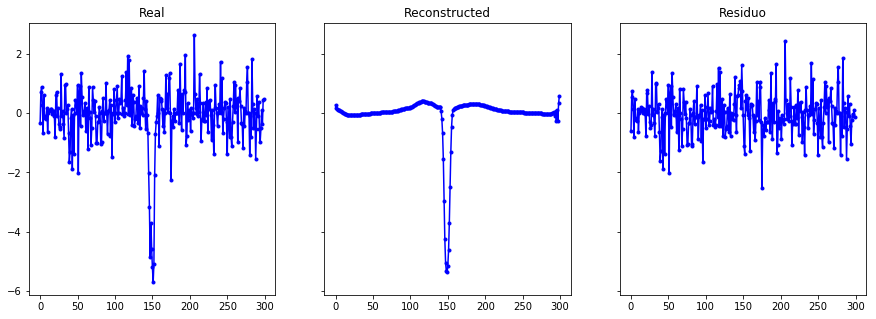

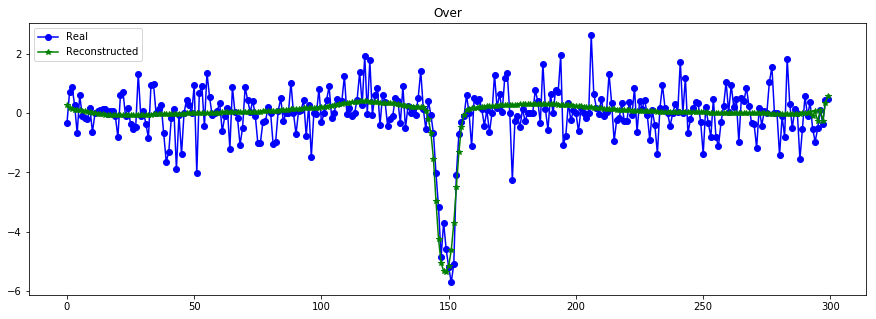

----------------------------------------------------------------


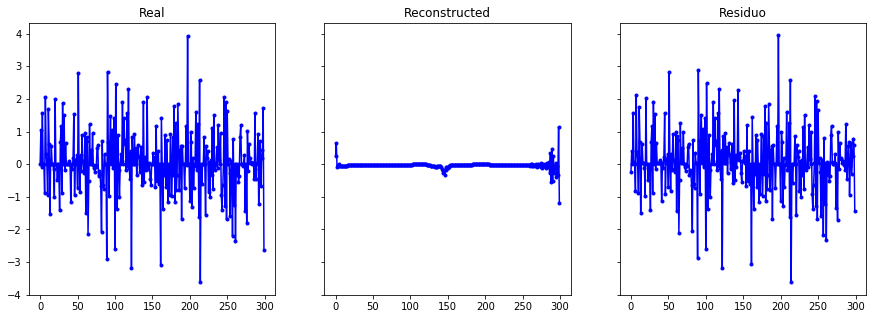

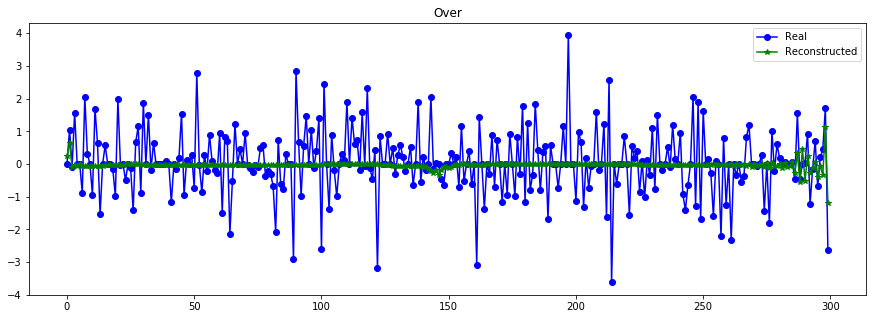

----------------------------------------------------------------


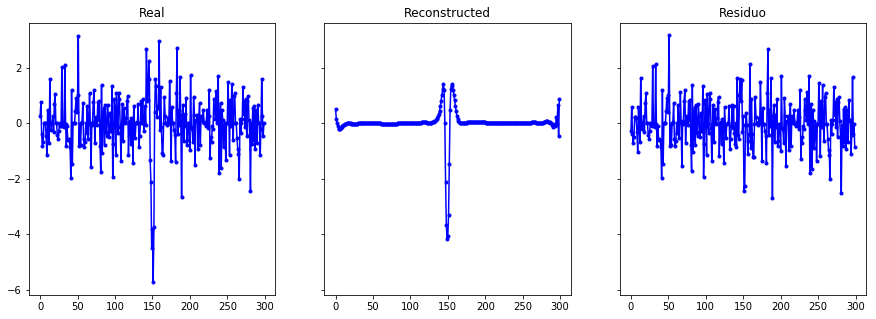

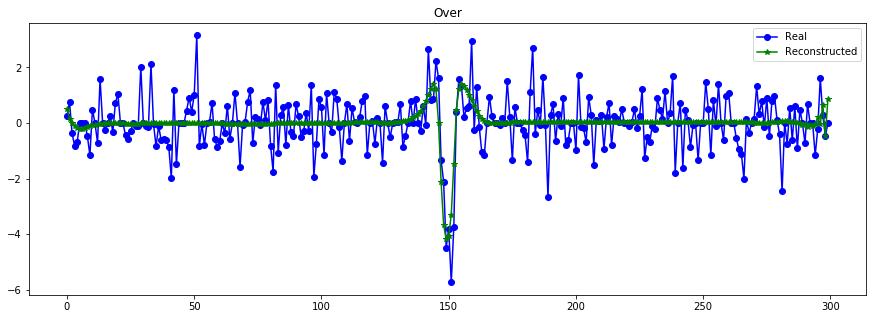

----------------------------------------------------------------


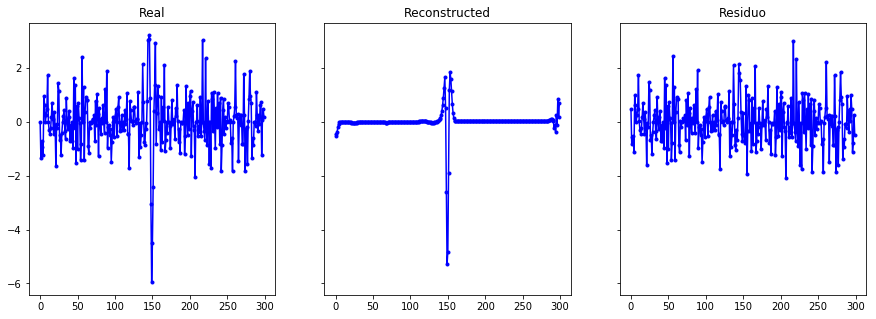

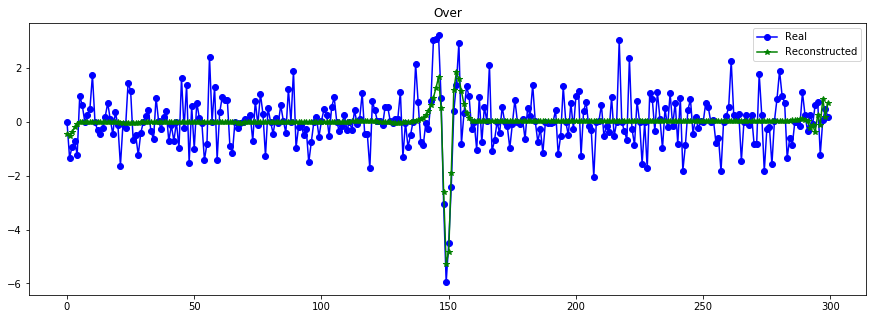

----------------------------------------------------------------


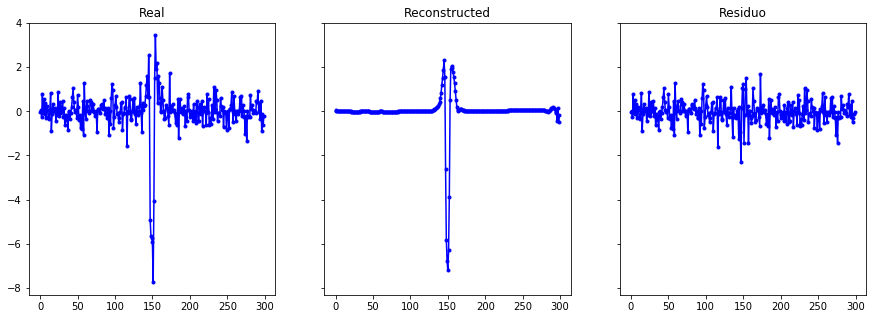

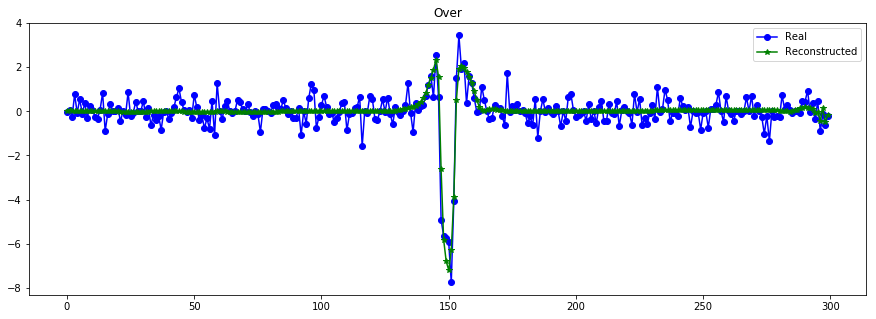

----------------------------------------------------------------


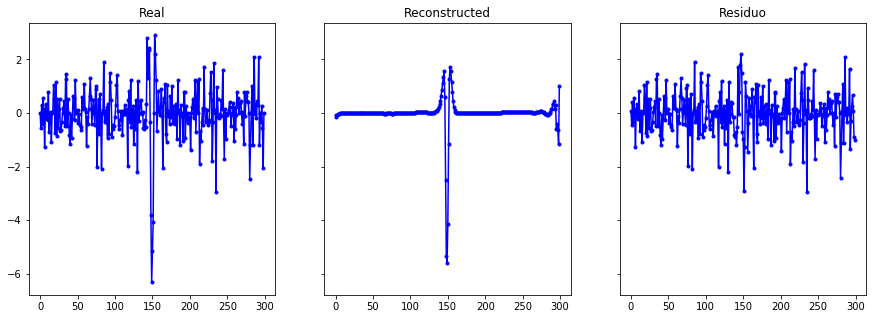

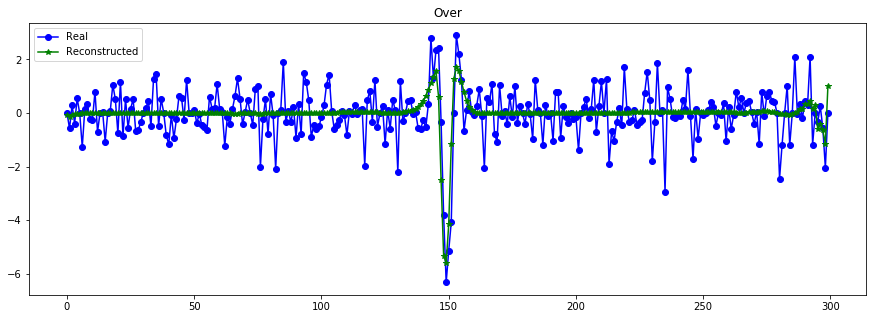

----------------------------------------------------------------


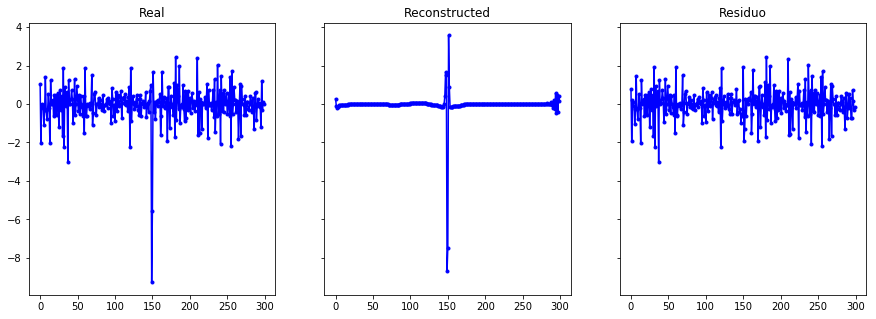

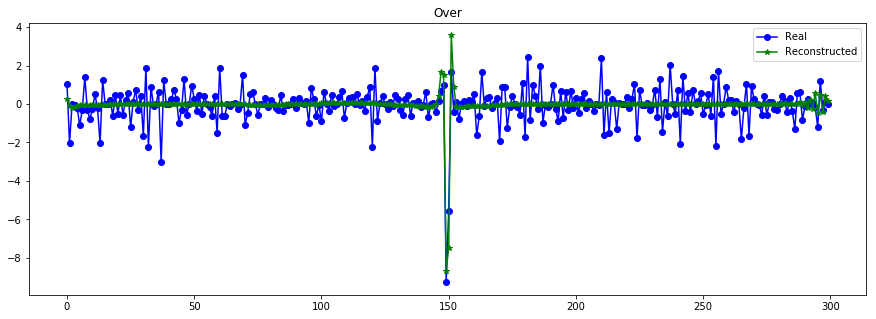

----------------------------------------------------------------


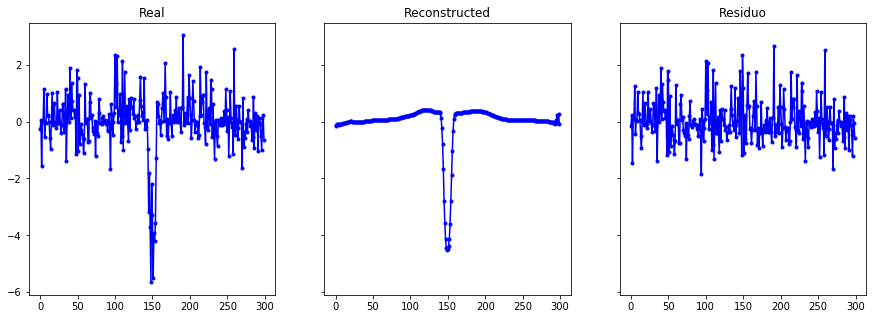

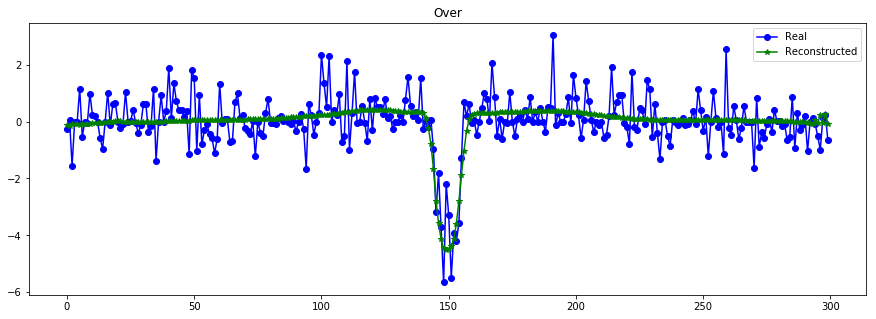

----------------------------------------------------------------


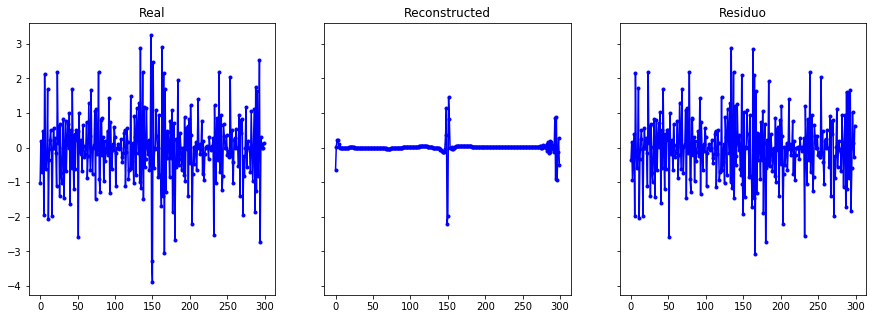

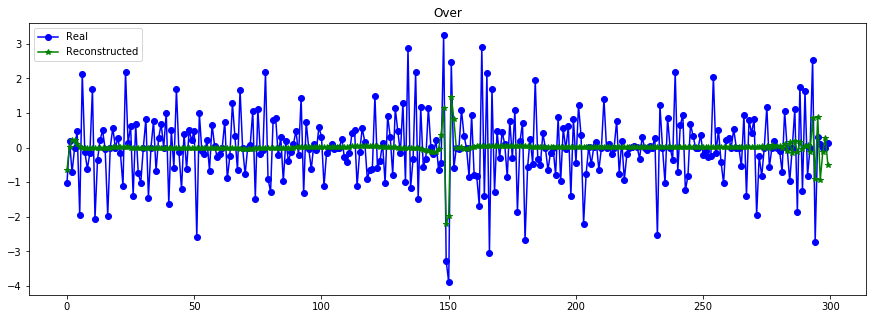

----------------------------------------------------------------


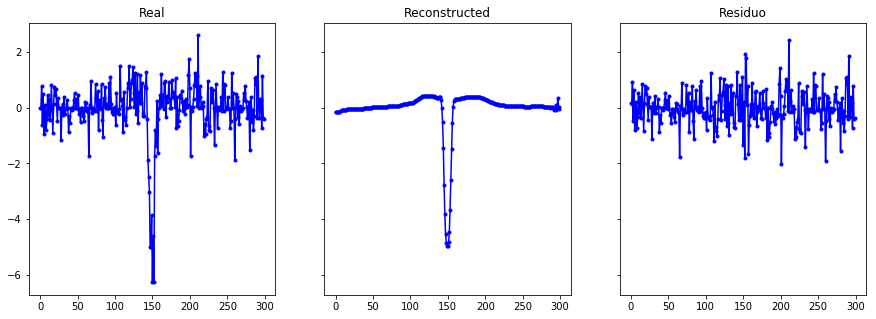

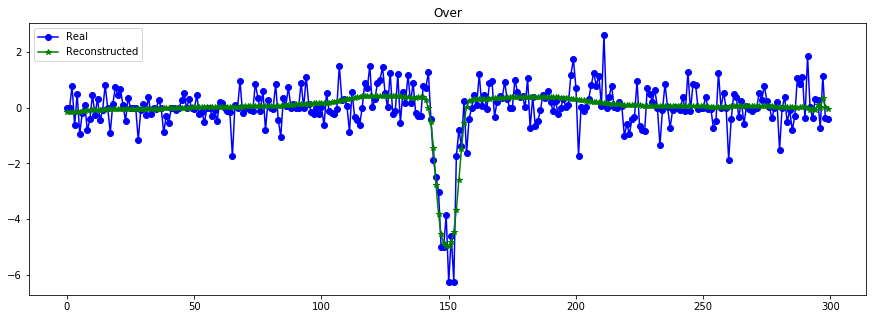

----------------------------------------------------------------


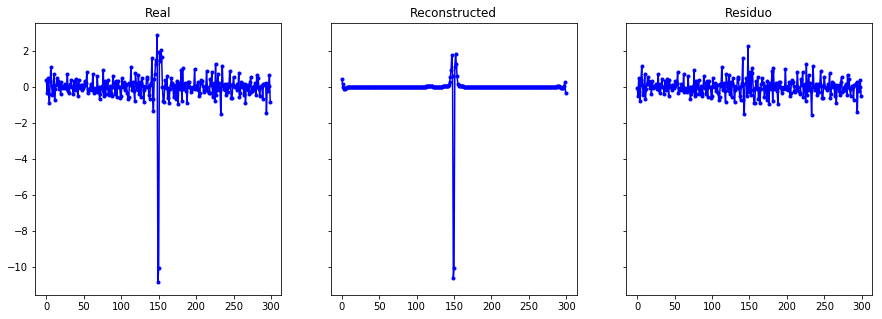

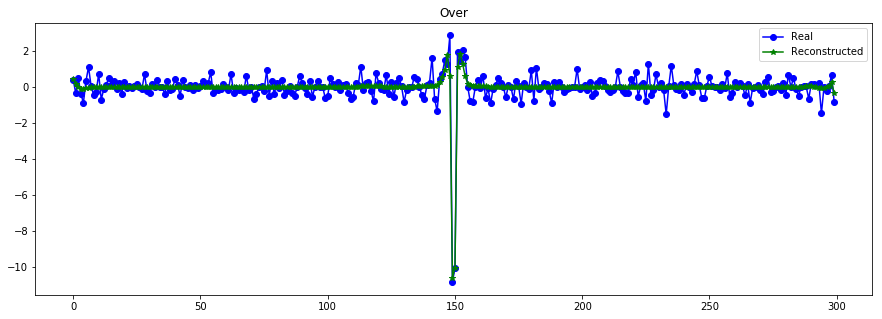

----------------------------------------------------------------


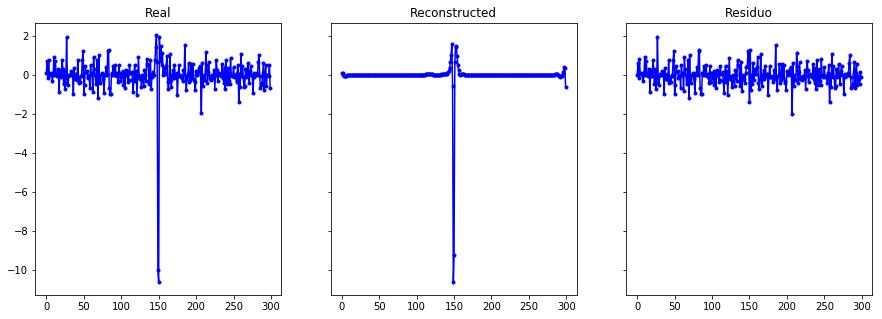

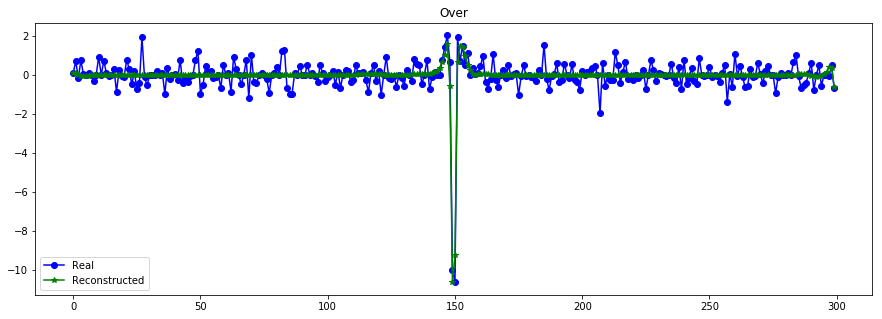

----------------------------------------------------------------


In [27]:
X_train_hat = vae.predict([X_train_t[:N], X_train[:N]], batch_size=512)
evaluate_reconst(X_train[:N], X_train_hat)

plot_n_lc(X_train[:N,:,0], X_train_hat, n= 15) ### 16

### Filtros

In [16]:
#https://plot.ly/python/v3/fft-filters/
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.butter.html
#https://scipy-cookbook.readthedocs.io/items/ButterworthBandpass.html
from scipy.signal import butter, lfilter

def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    #b, a = butter(order, high, btype='highpass')
    #b, a = butter(order, low, btype='lowpass')
    return b, a

def butter_bandpass_filter(data):
    b, a = butter_bandpass(lowcut, highcut, fs, order)
    y = lfilter(b, a, data)
    return y

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


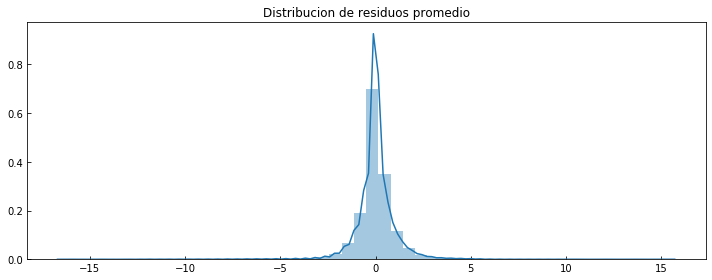

------------- Error -------------
RMSE (+-) =  1.0810371548099567
MAE  (+-) =  0.6259611584562023
------------- Smoothness -------------
AutoCorr lag-one =  0.9677034441089
Diff MEAN =  0.04689125019225638
------------- Residual -------------
AutoCorr lag-one =  0.3295796897534972
Mean (+) STD = -0.006477 (+) 1.080984
---------------------------------------


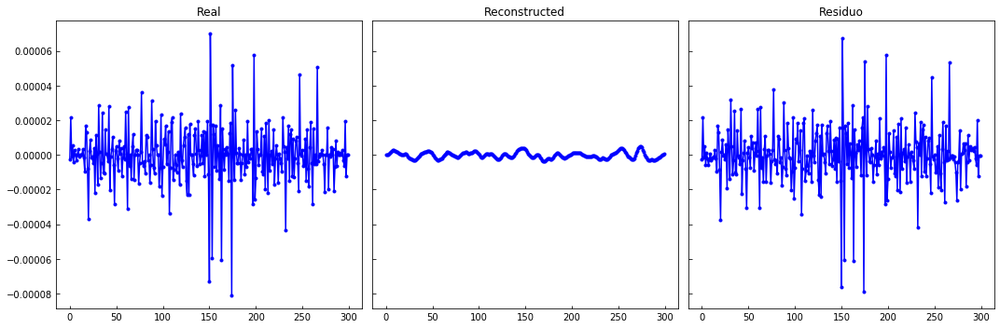

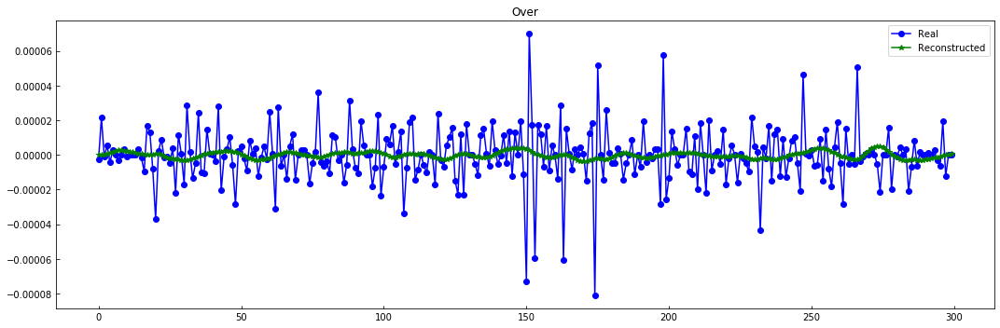

----------------------------------------------------------------


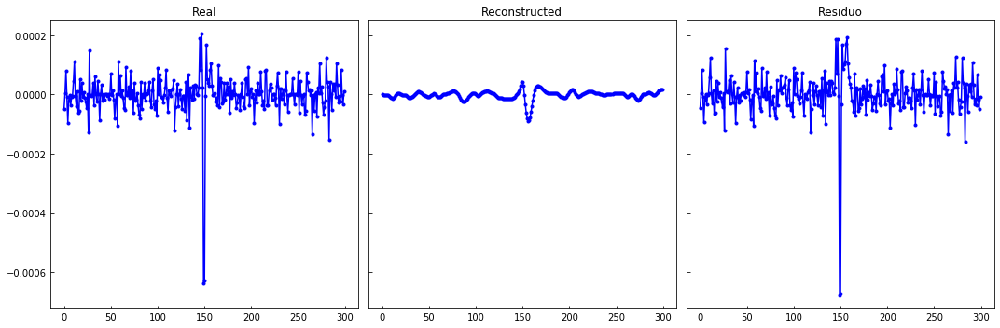

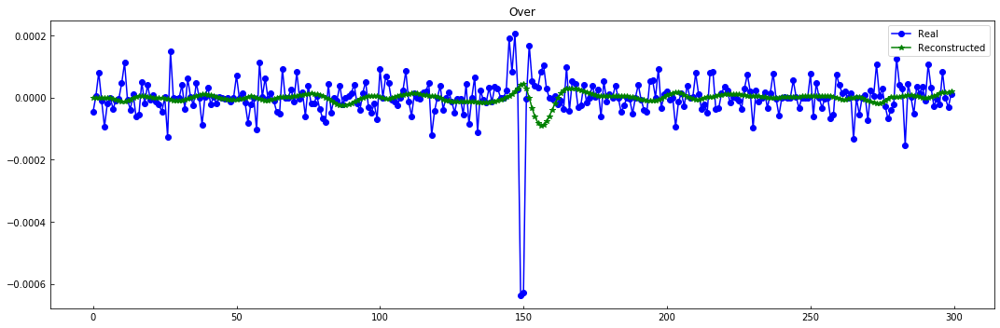

----------------------------------------------------------------


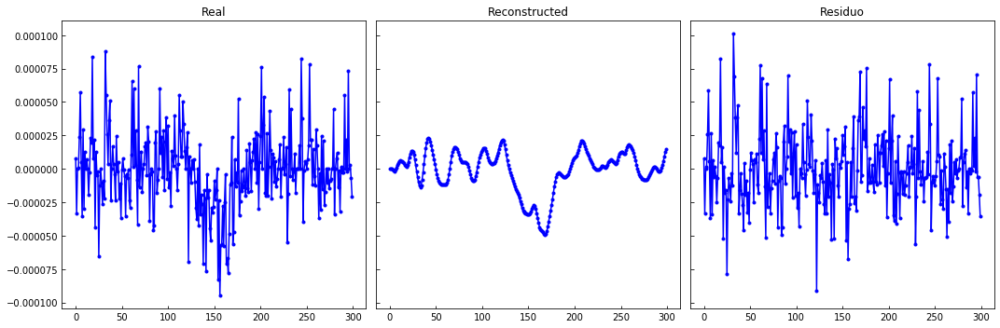

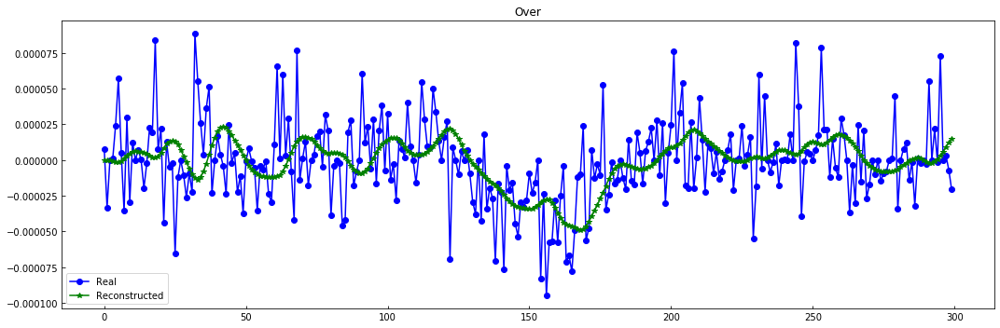

----------------------------------------------------------------


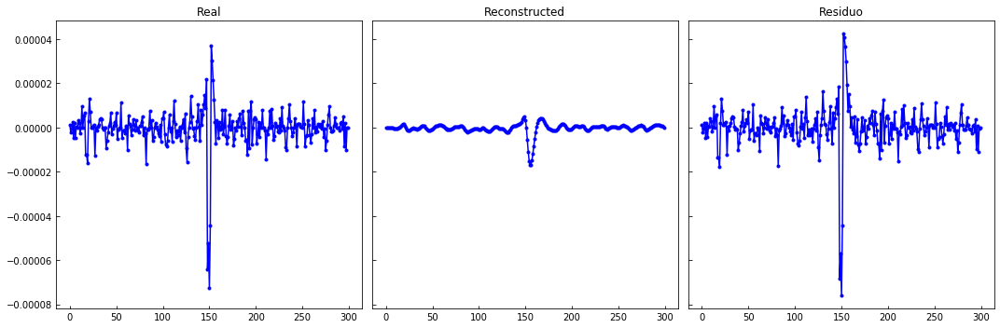

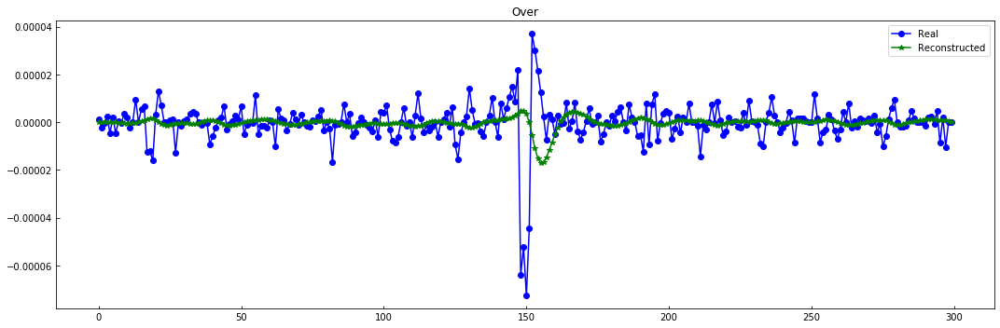

----------------------------------------------------------------


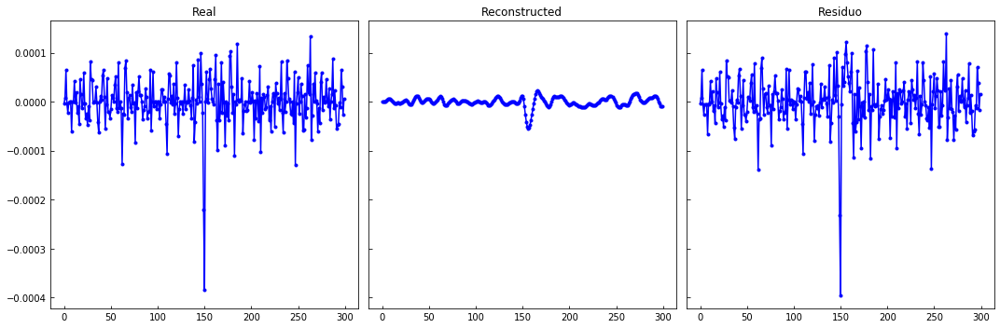

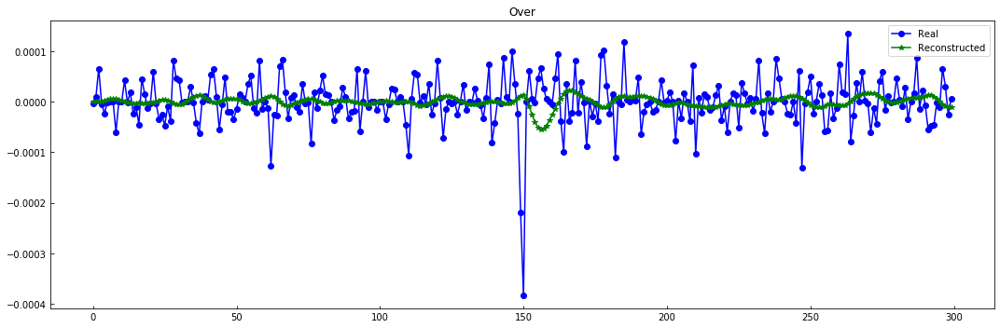

----------------------------------------------------------------


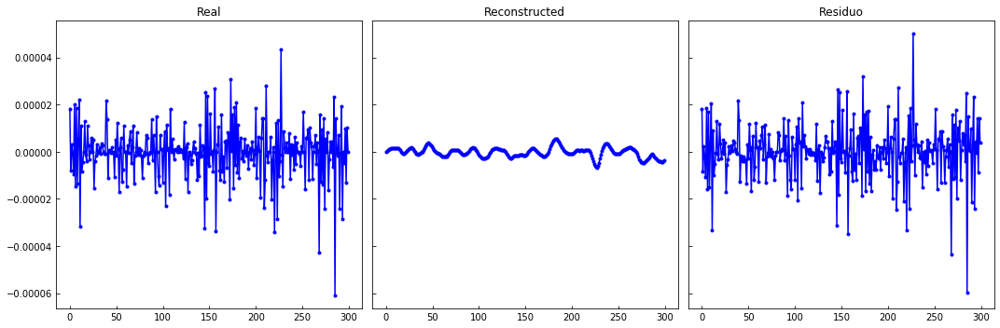

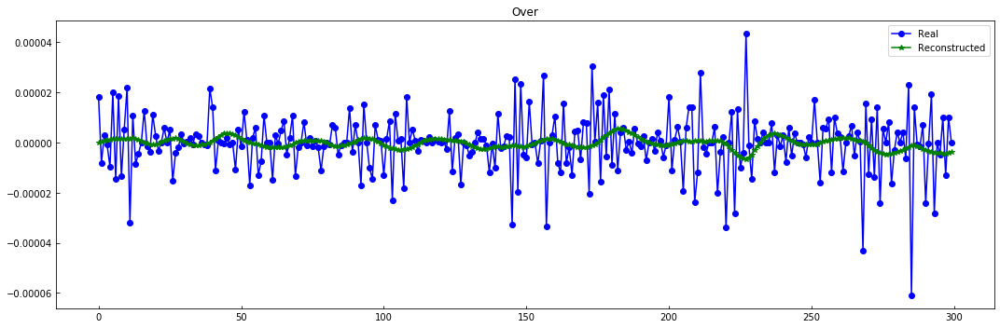

----------------------------------------------------------------


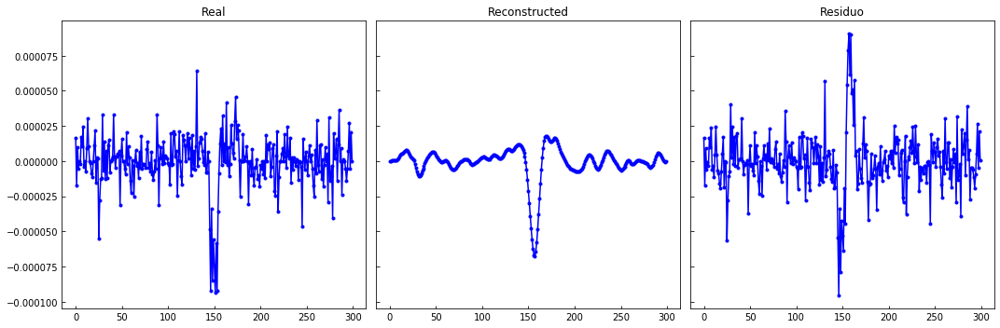

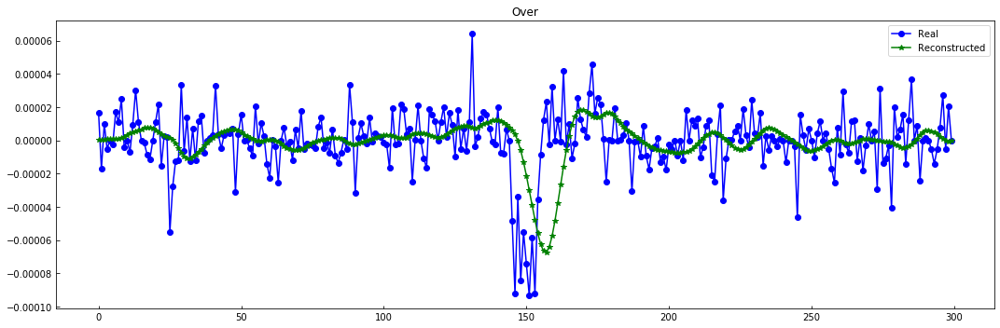

----------------------------------------------------------------


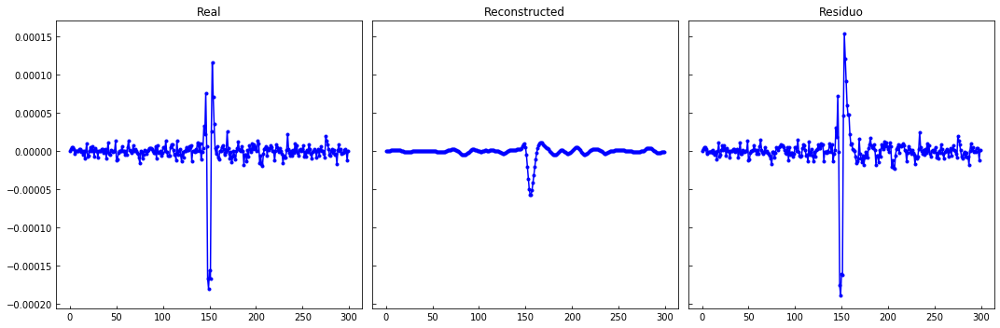

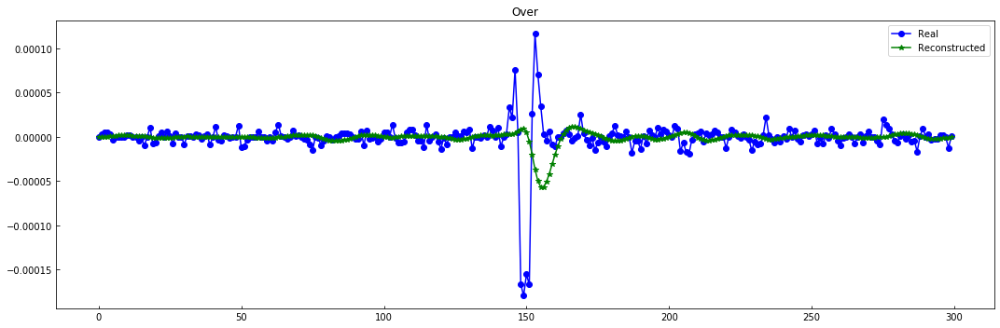

----------------------------------------------------------------


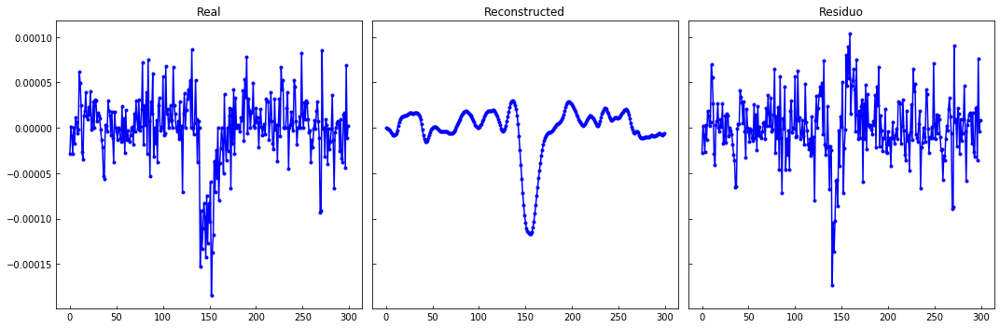

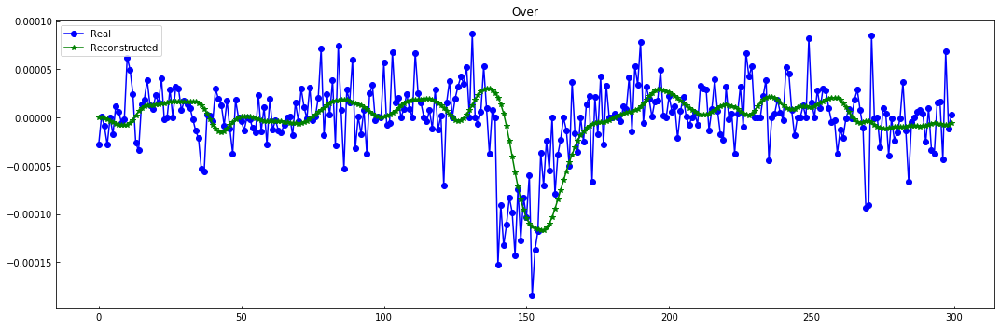

----------------------------------------------------------------


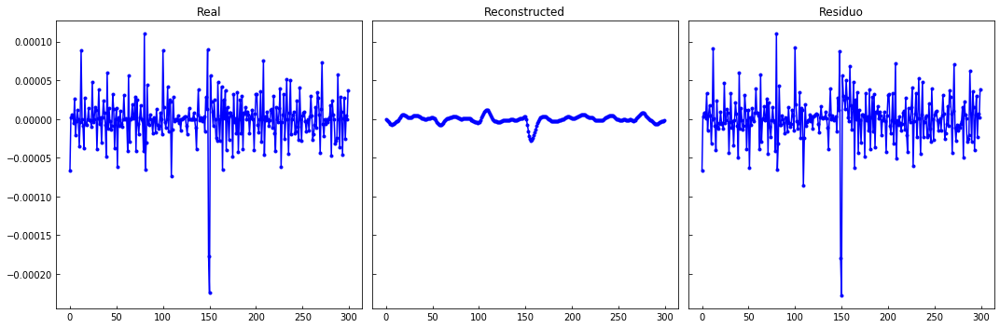

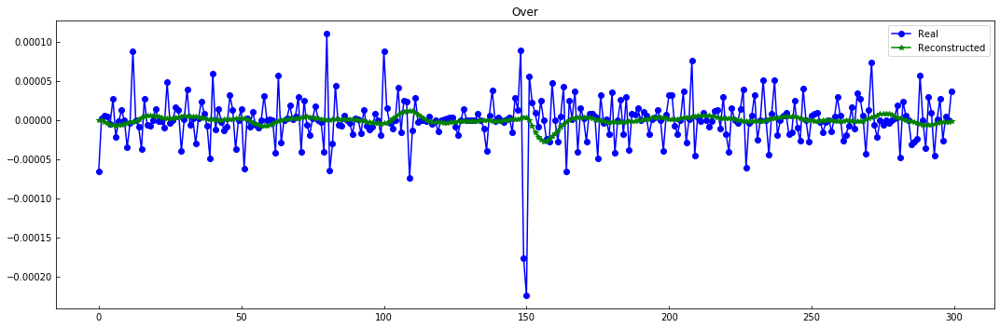

----------------------------------------------------------------


In [48]:
lowcut  = 1 #300. #2000. #con order 3
highcut = 500 #2500 #2500. # 500. #0.1
fs =  10000.
order = 3

X_train_filter = np.apply_along_axis(butter_bandpass_filter, 1, X_train[:N,:,0]*S_train[:N])

evaluate_reconst(X_train[:N,:,0], X_train_filter/S_train[:N])

plot_n_lc(X_train[:N,:,0]*S_train[:N], X_train_filter, n= 10)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


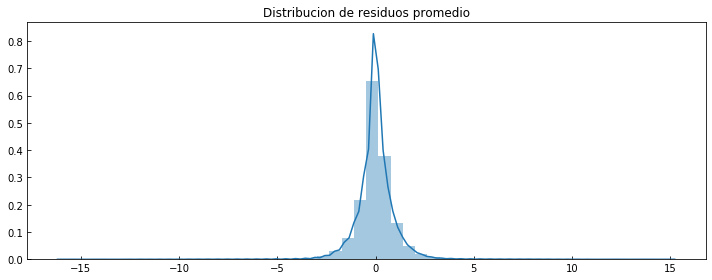

------------- Error -------------
RMSE (+-) =  1.0358927443745802
MAE  (+-) =  0.6335282091431932
------------- Smoothness -------------
AutoCorr lag-one =  0.8309864693821888
Diff MEAN =  0.1969279735059727
------------- Residual -------------
AutoCorr lag-one =  0.22846771041754135
Mean (+) STD = -0.006474 (+) 1.035826
---------------------------------------


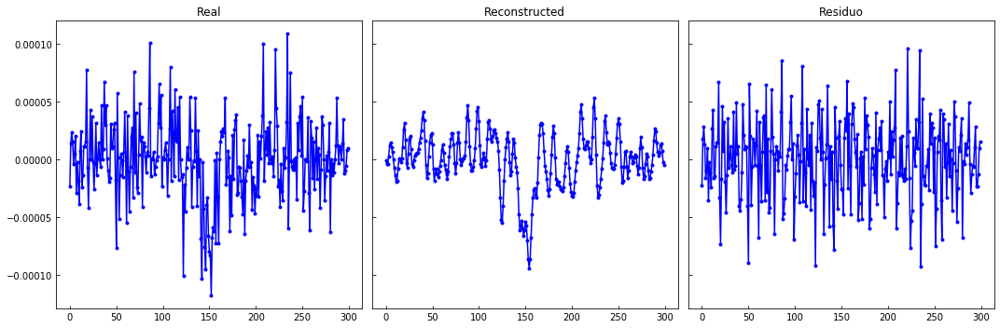

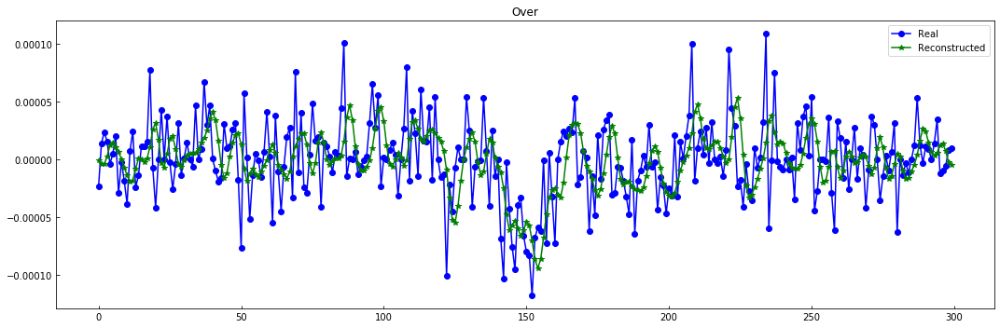

----------------------------------------------------------------


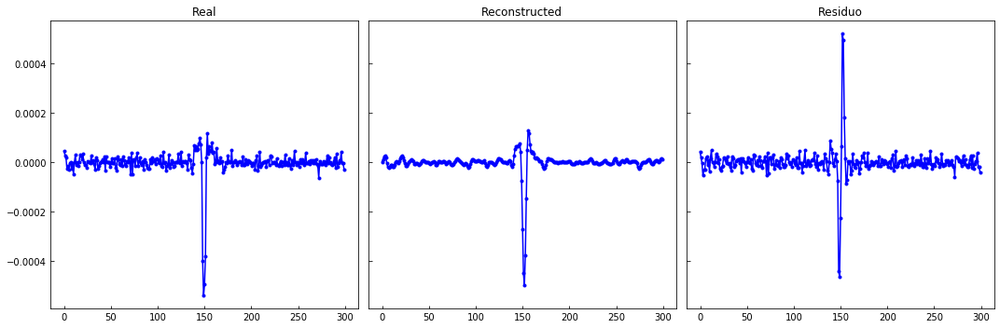

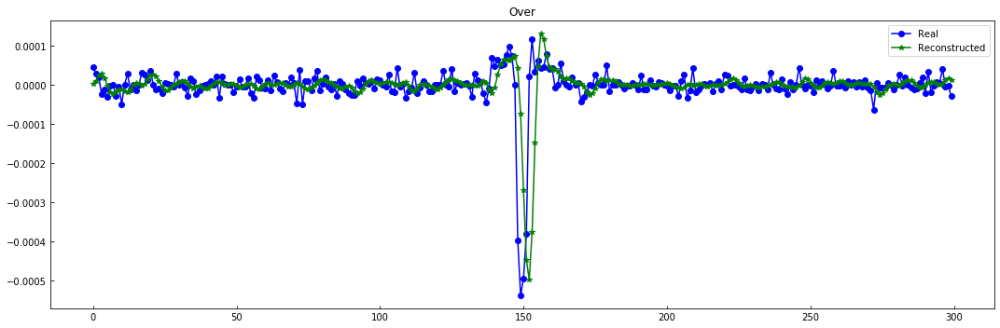

----------------------------------------------------------------


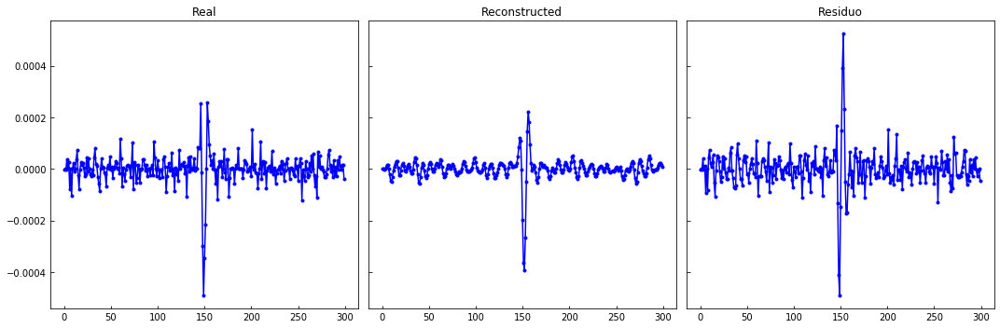

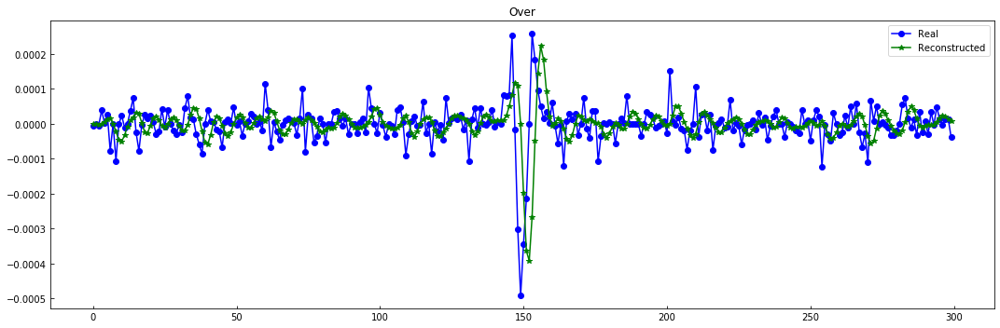

----------------------------------------------------------------


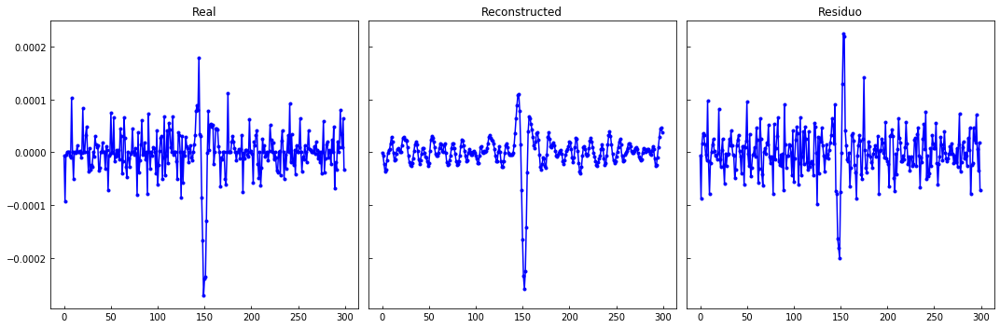

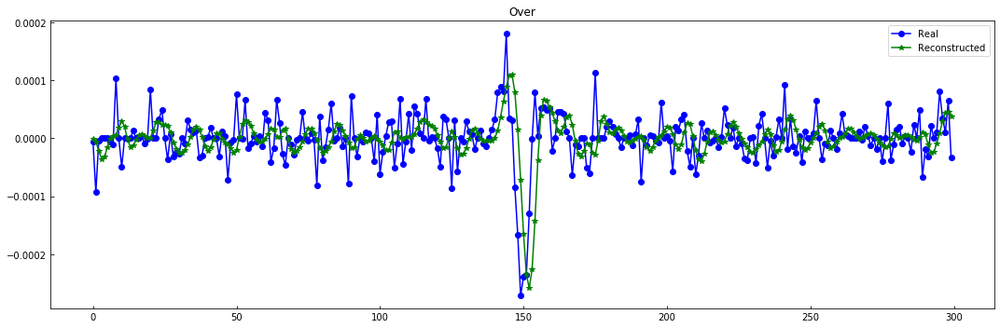

----------------------------------------------------------------


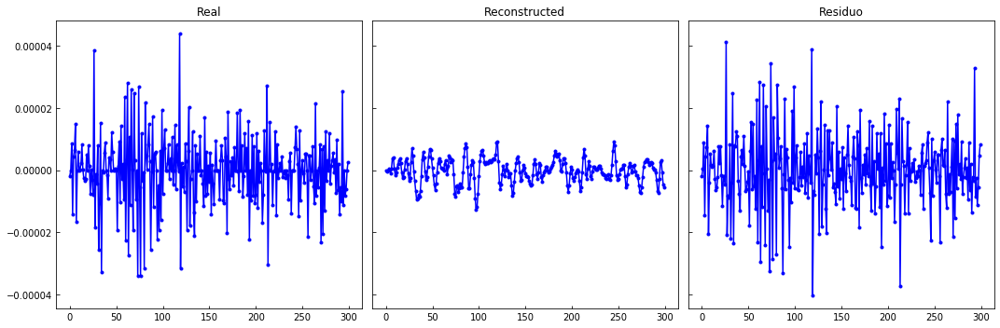

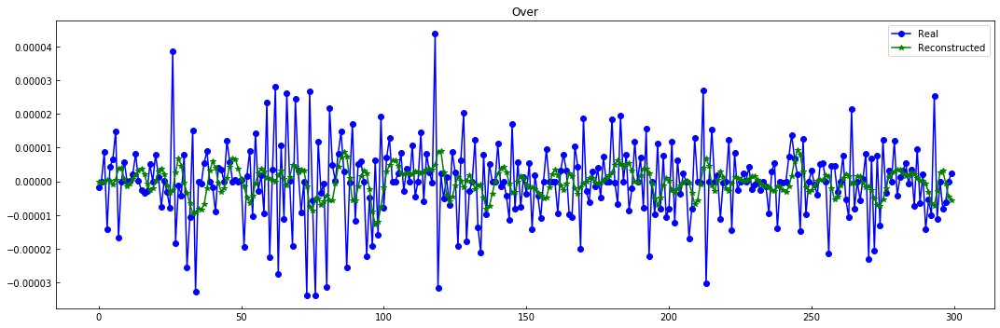

----------------------------------------------------------------


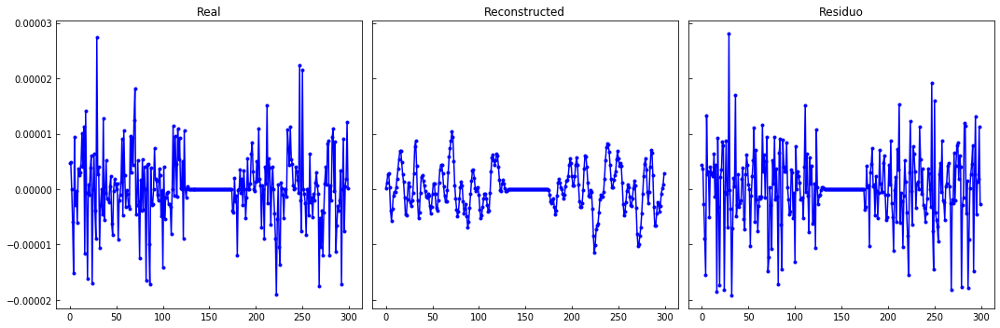

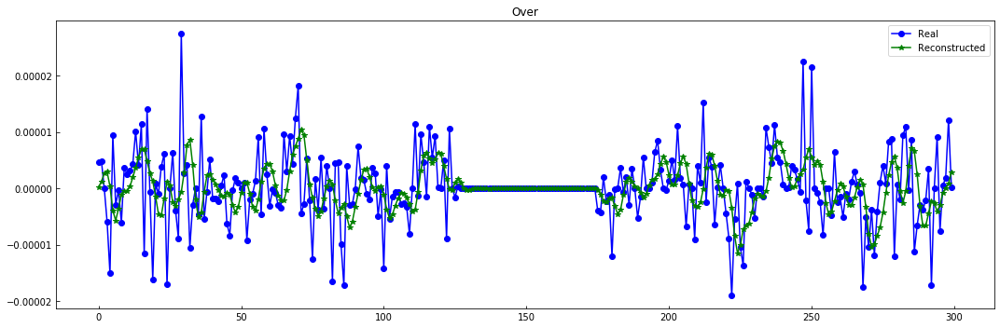

----------------------------------------------------------------


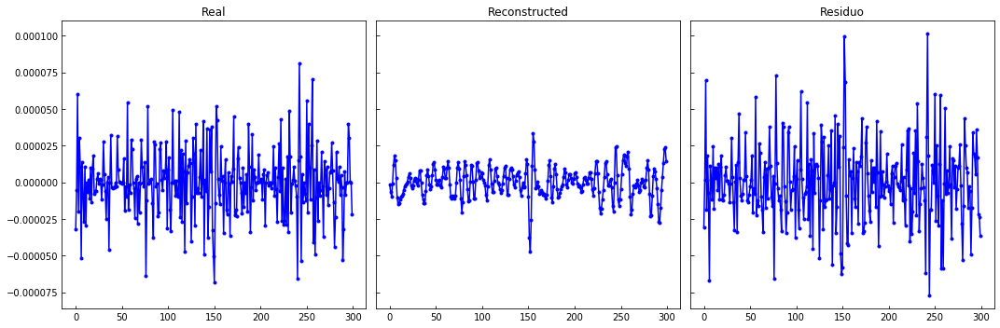

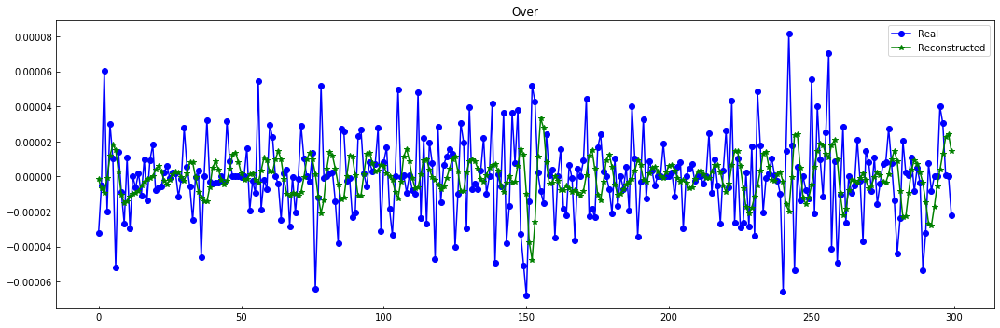

----------------------------------------------------------------


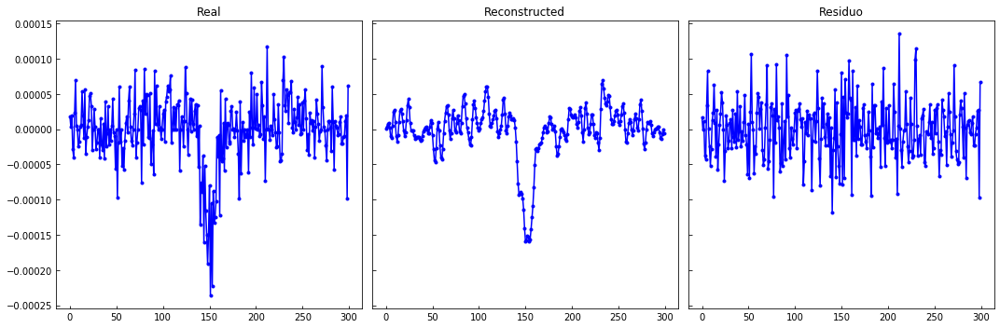

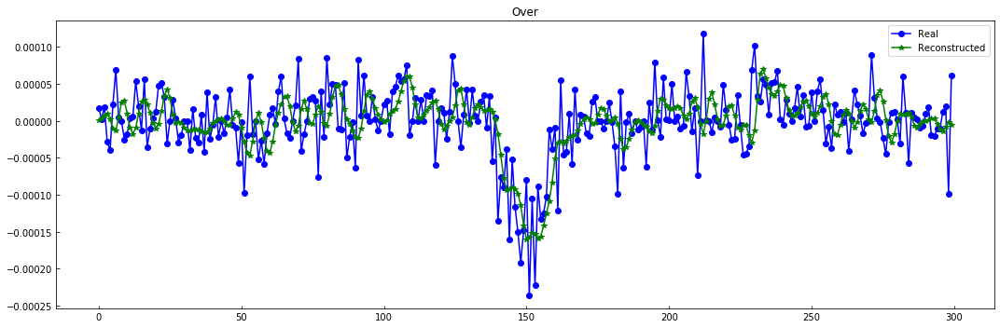

----------------------------------------------------------------


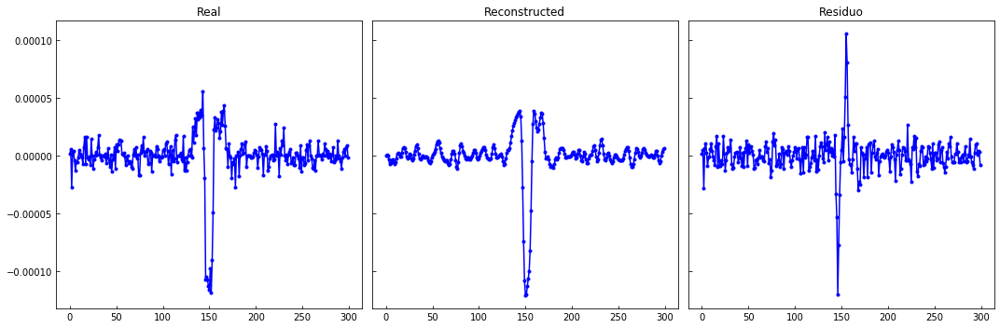

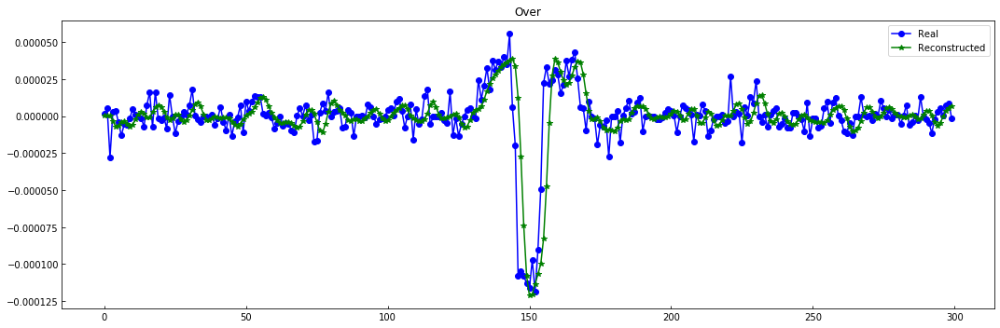

----------------------------------------------------------------


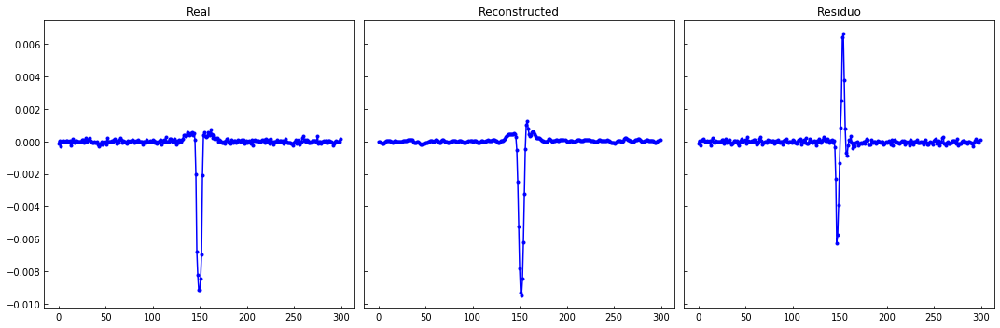

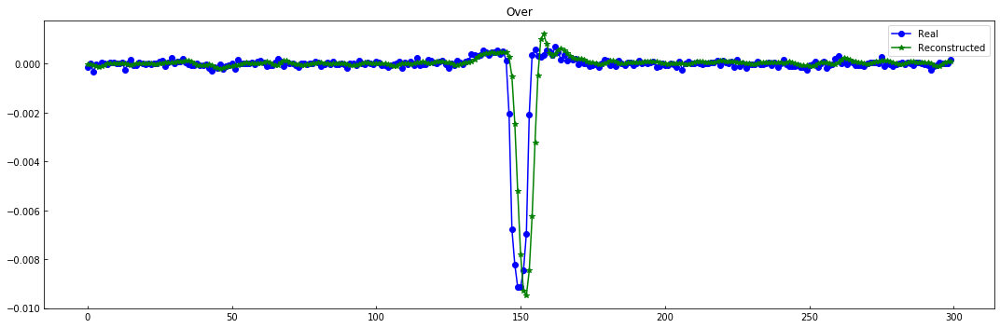

----------------------------------------------------------------


In [49]:
lowcut = 1. 
highcut= 1500.
fs =  10000.
order = 3

X_train_filter = np.apply_along_axis(butter_bandpass_filter, 1, X_train[:N,:,0]*S_train[:N])

evaluate_reconst(X_train[:N,:,0], X_train_filter/S_train[:N])

plot_n_lc(X_train[:N,:,0]*S_train[:N], X_train_filter, n= 10)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


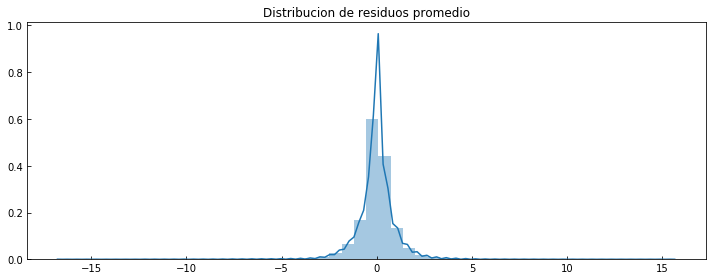

------------- Error -------------
RMSE (+-) =  1.0684869531239796
MAE  (+-) =  0.6368145013358195
------------- Smoothness -------------
AutoCorr lag-one =  0.9693243179782369
Diff MEAN =  0.04613753569153137
------------- Residual -------------
AutoCorr lag-one =  0.3232563932951328
Mean (+) STD = -0.030041 (+) 1.067489
---------------------------------------


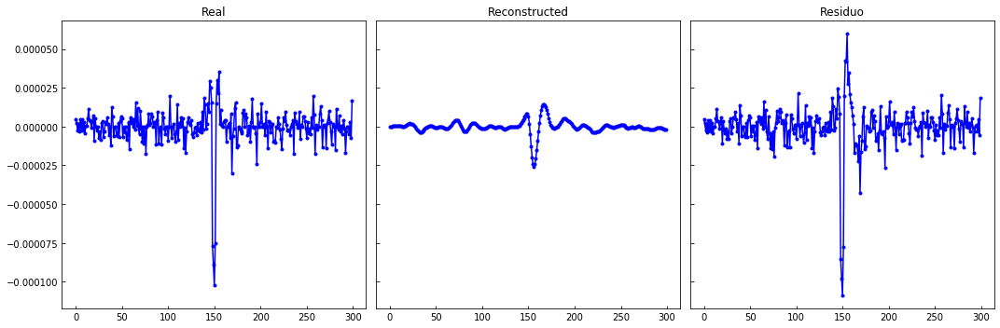

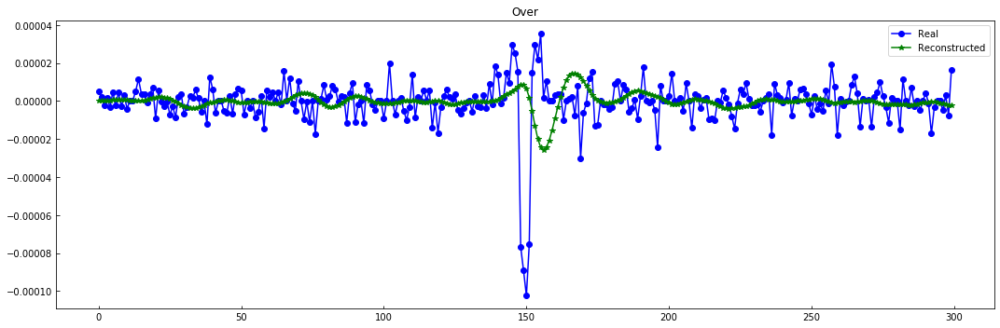

----------------------------------------------------------------


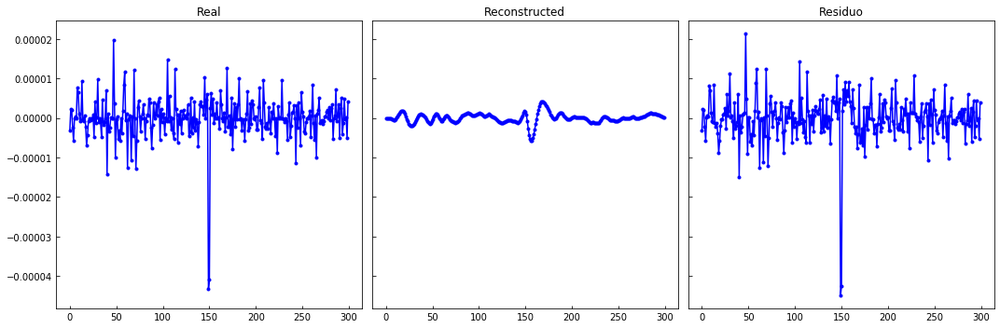

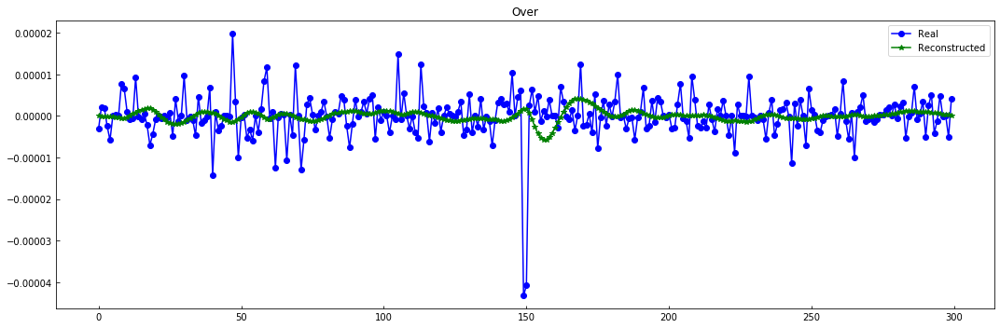

----------------------------------------------------------------


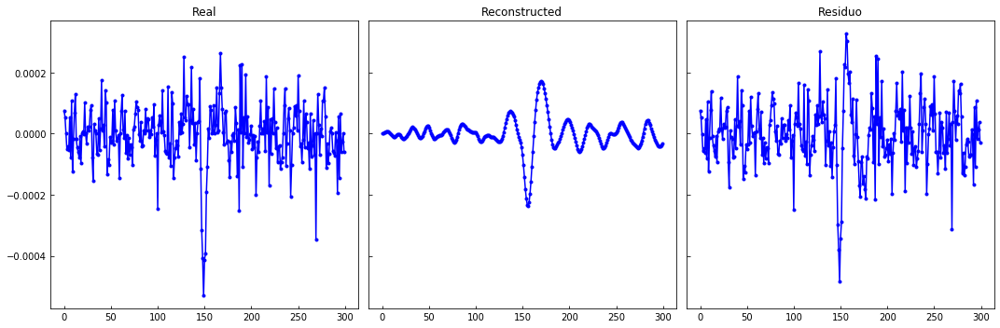

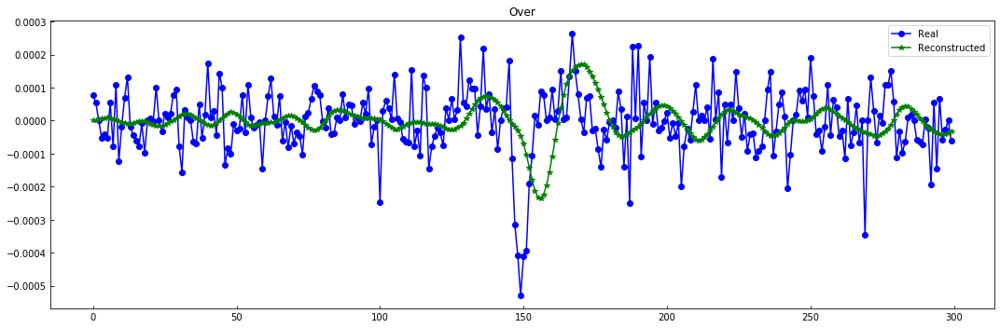

----------------------------------------------------------------


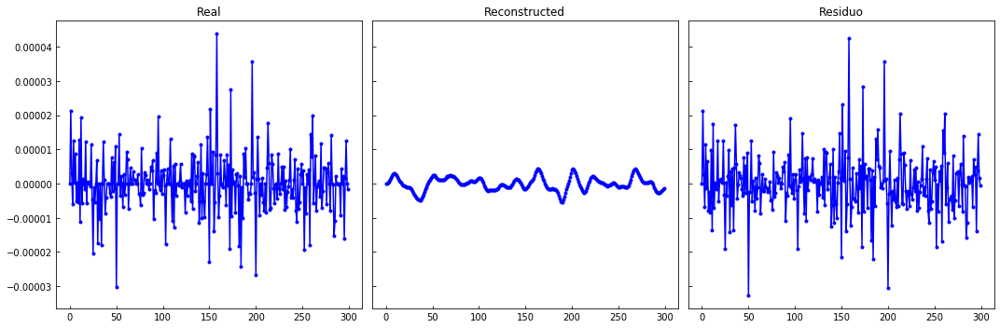

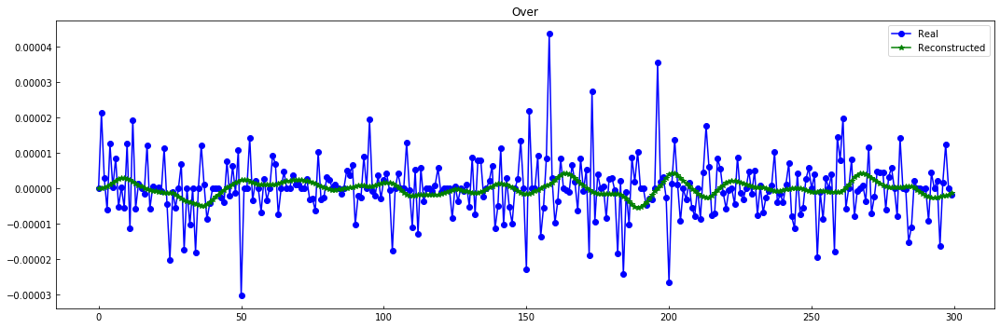

----------------------------------------------------------------


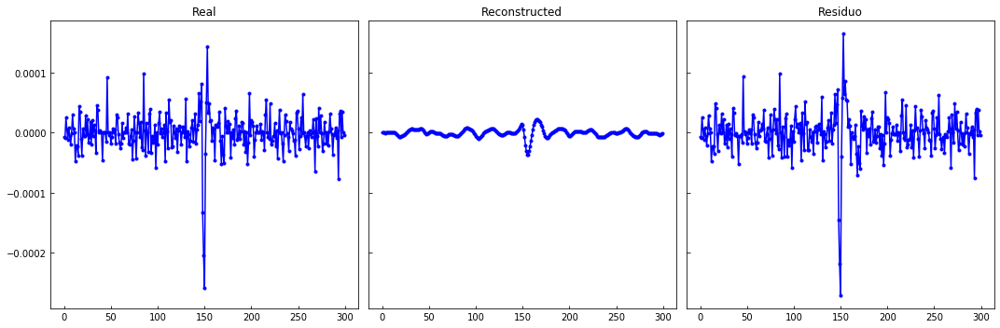

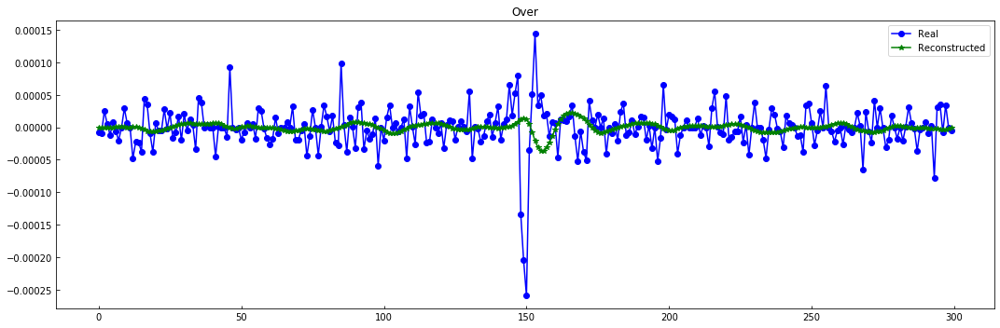

----------------------------------------------------------------


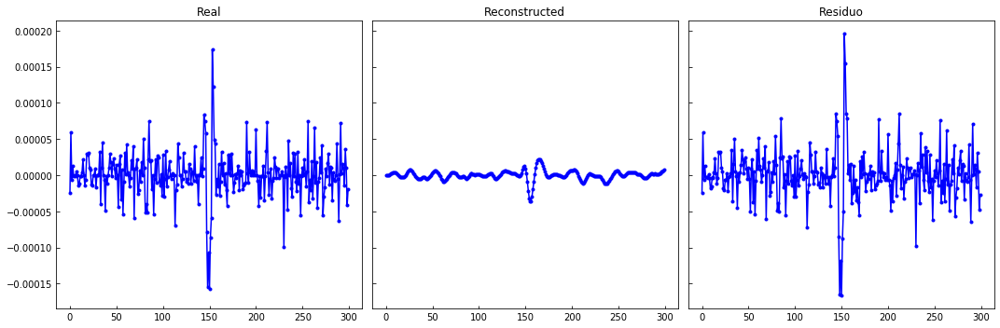

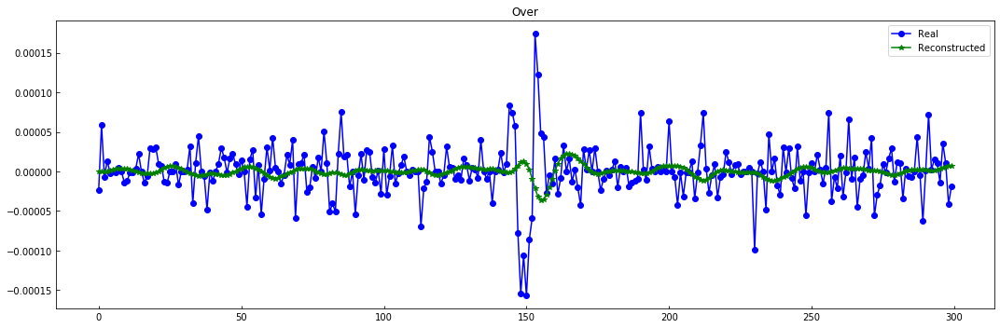

----------------------------------------------------------------


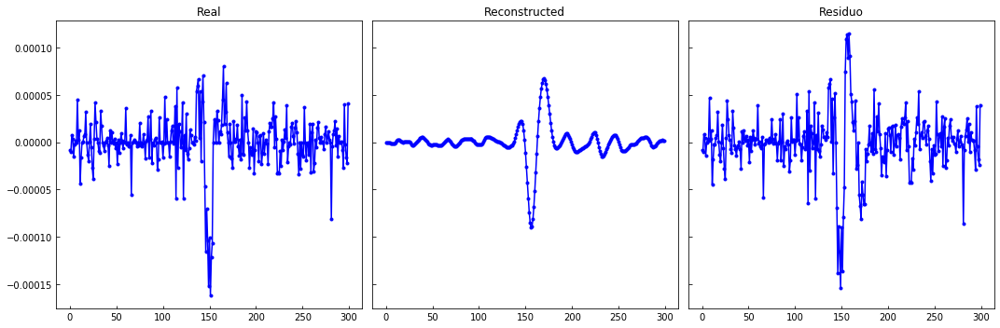

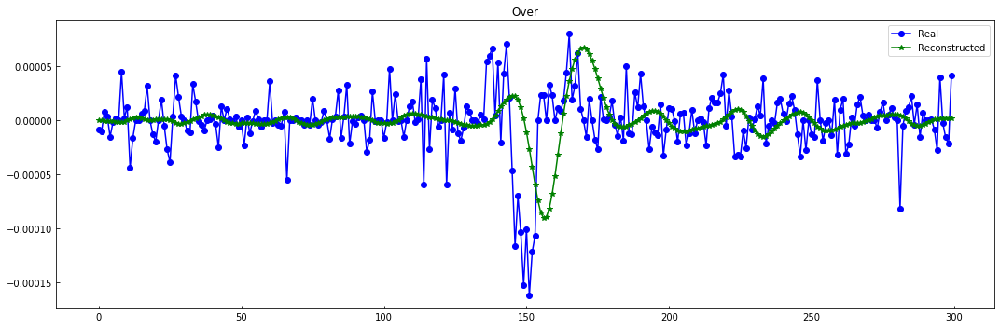

----------------------------------------------------------------


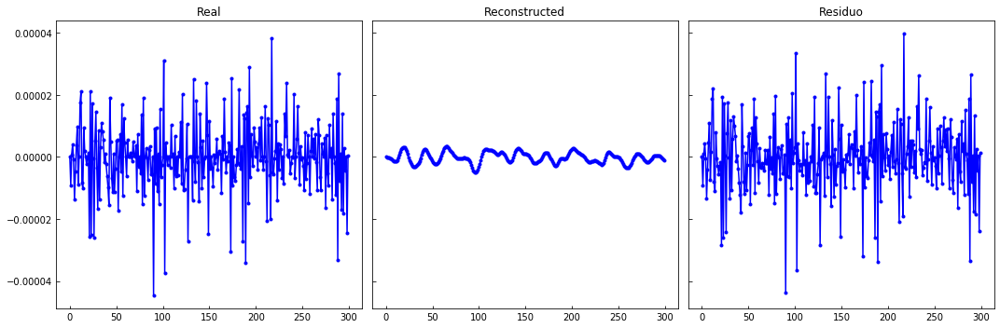

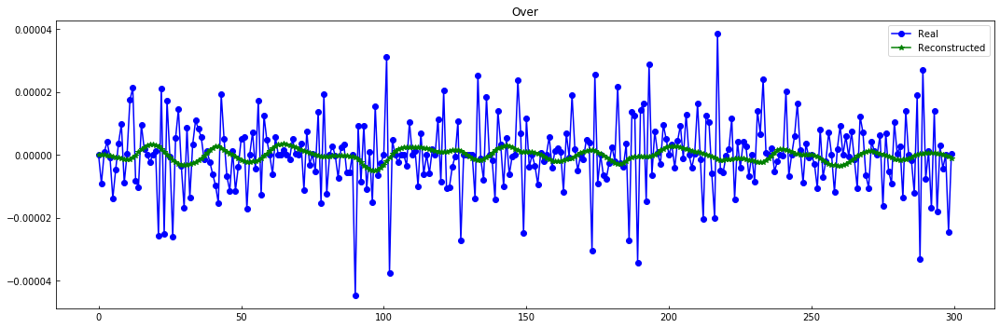

----------------------------------------------------------------


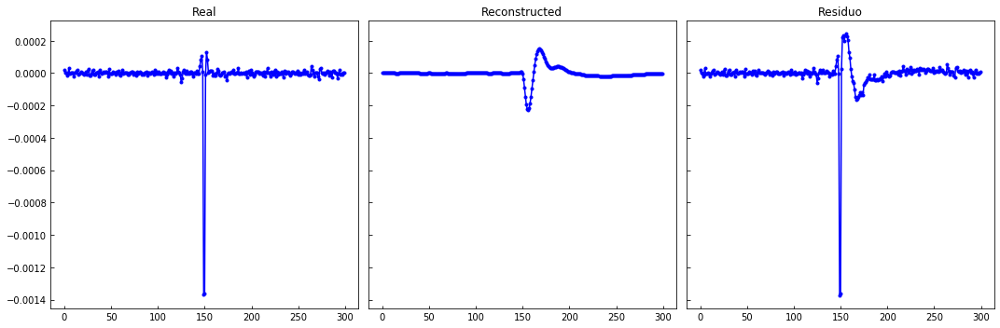

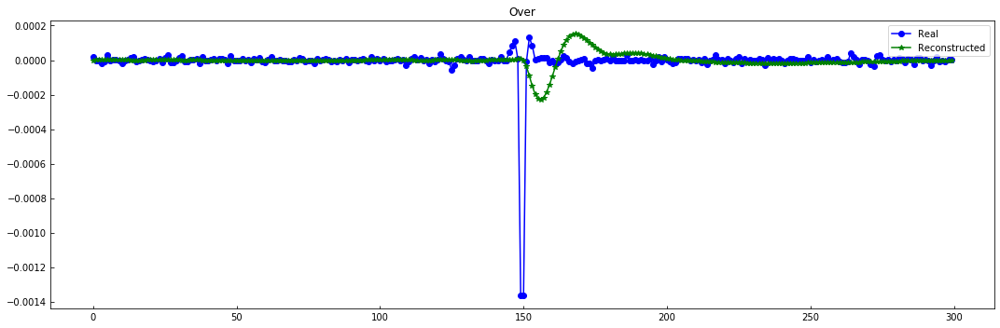

----------------------------------------------------------------


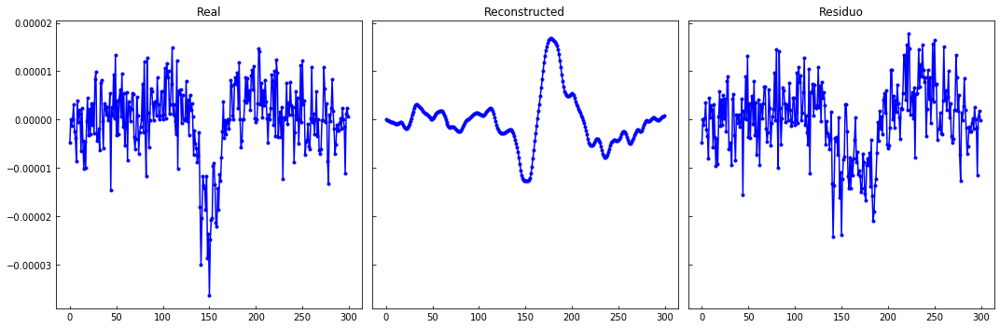

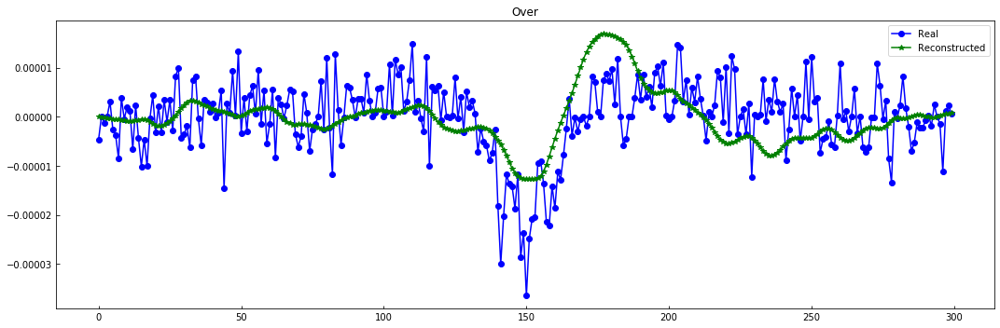

----------------------------------------------------------------


In [50]:
lowcut  = 50 #300. #2000. #con order 3
highcut = 500 #2500 #2500. # 500. #0.1
fs =  10000.
order = 3

X_train_filter = np.apply_along_axis(butter_bandpass_filter, 1, X_train[:N,:,0]*S_train[:N])

evaluate_reconst(X_train[:N,:,0], X_train_filter/S_train[:N])

plot_n_lc(X_train[:N,:,0]*S_train[:N], X_train_filter, n= 10)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


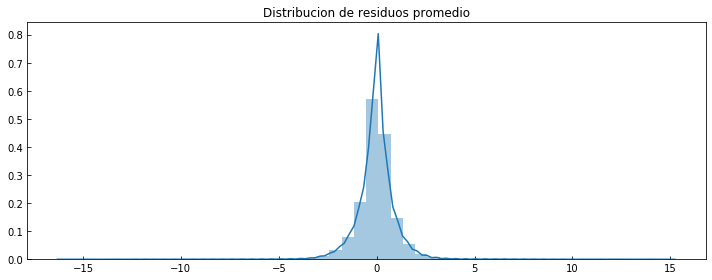

------------- Error -------------
RMSE (+-) =  1.0411482330354886
MAE  (+-) =  0.6547341818479183
------------- Smoothness -------------
AutoCorr lag-one =  0.8308406281062477
Diff MEAN =  0.19652549378649753
------------- Residual -------------
AutoCorr lag-one =  0.24384733475153575
Mean (+) STD = -0.030596 (+) 1.039933
---------------------------------------


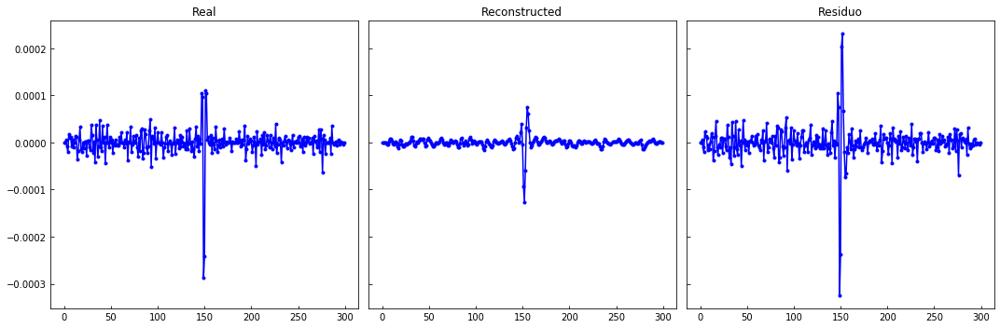

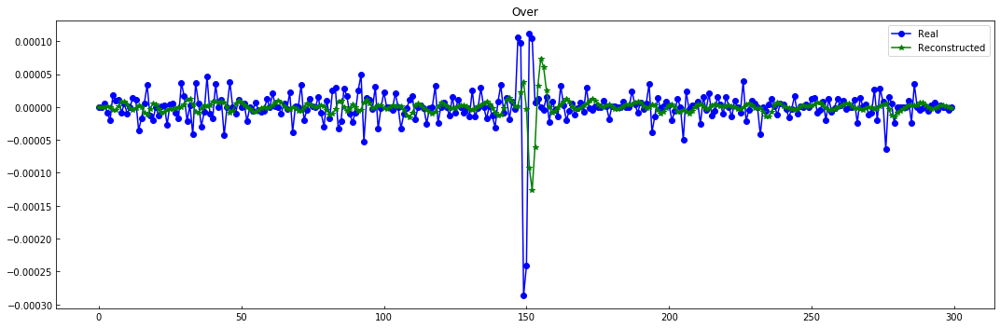

----------------------------------------------------------------


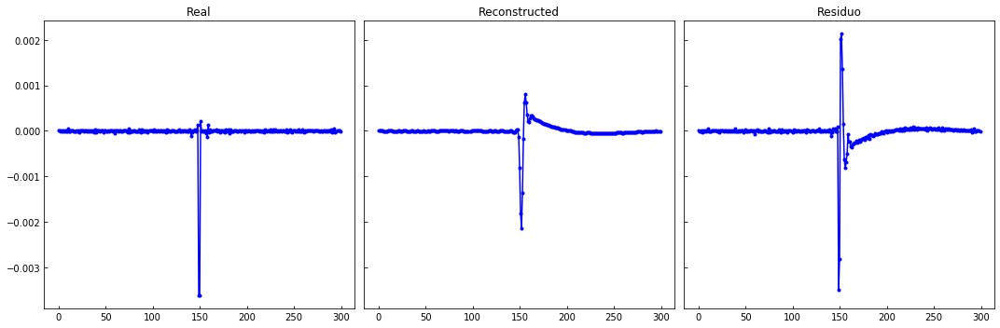

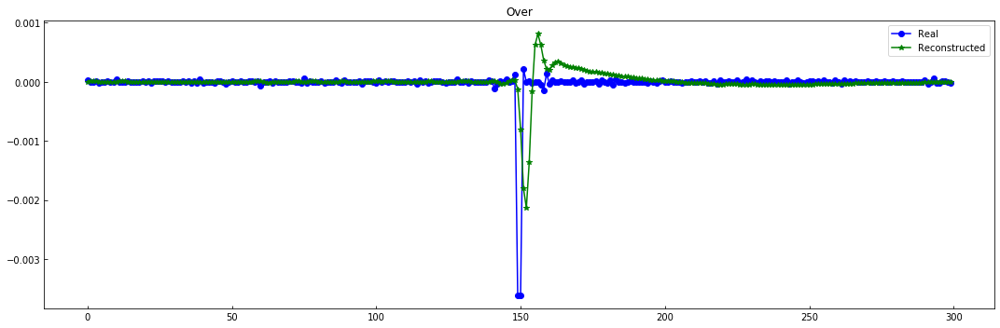

----------------------------------------------------------------


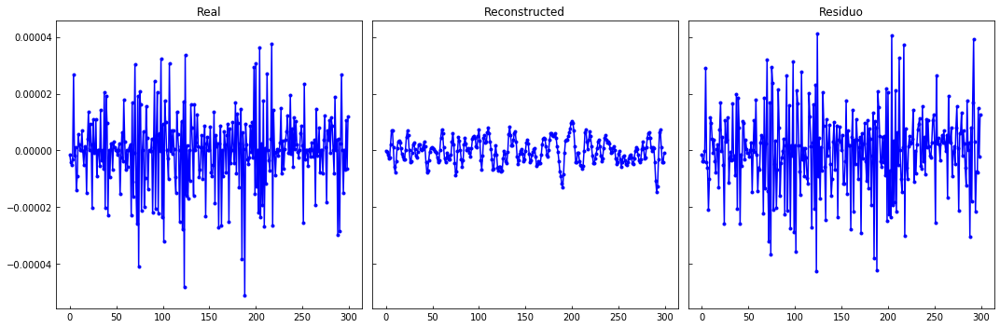

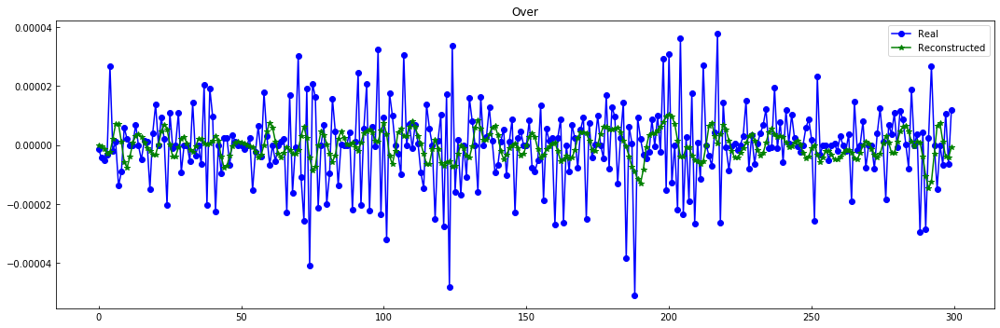

----------------------------------------------------------------


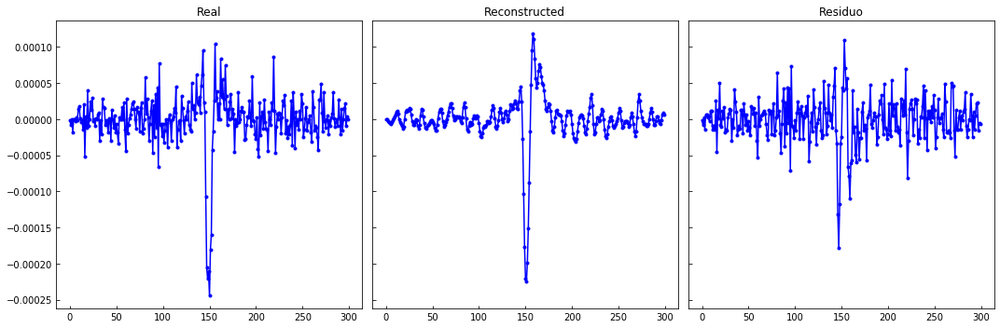

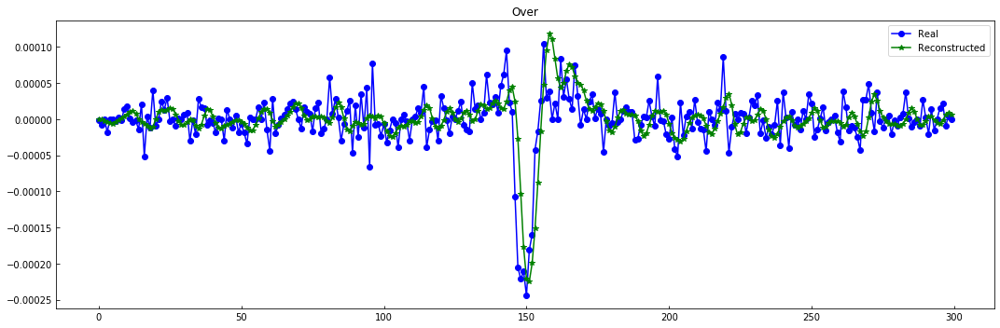

----------------------------------------------------------------


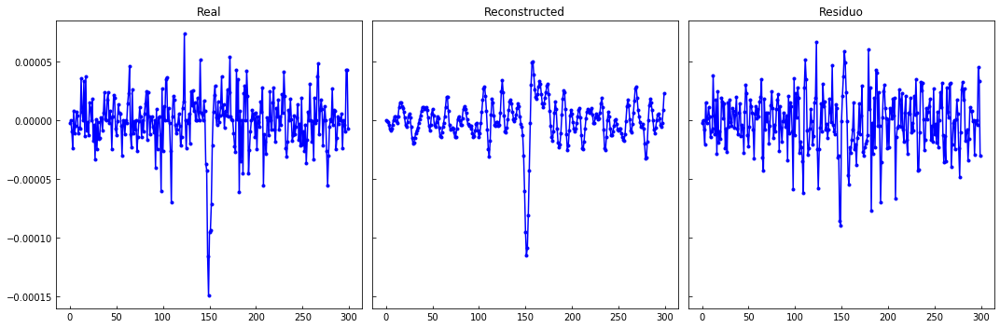

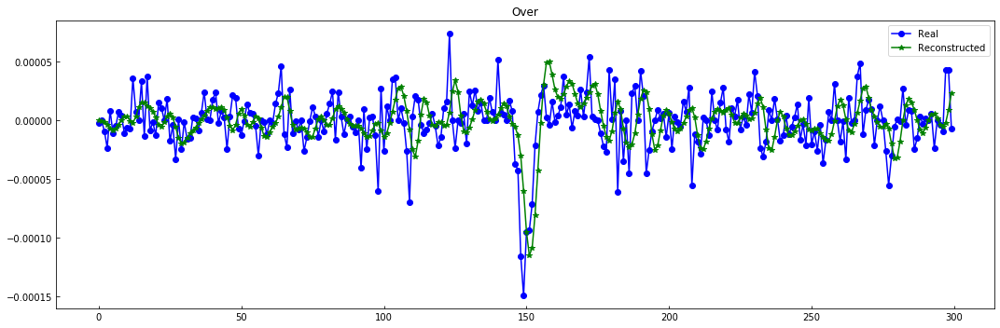

----------------------------------------------------------------


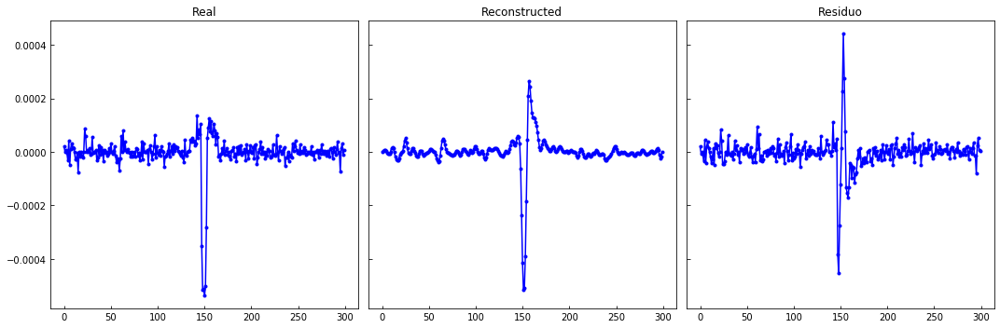

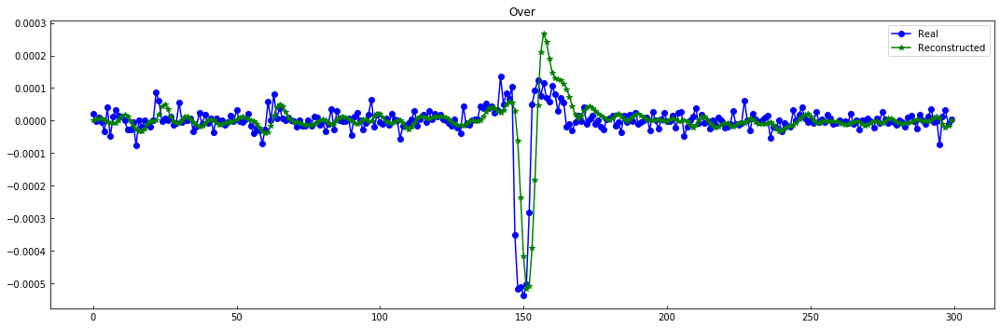

----------------------------------------------------------------


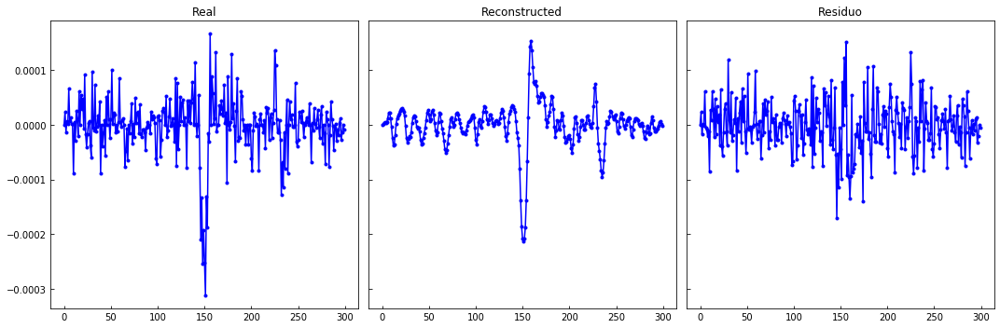

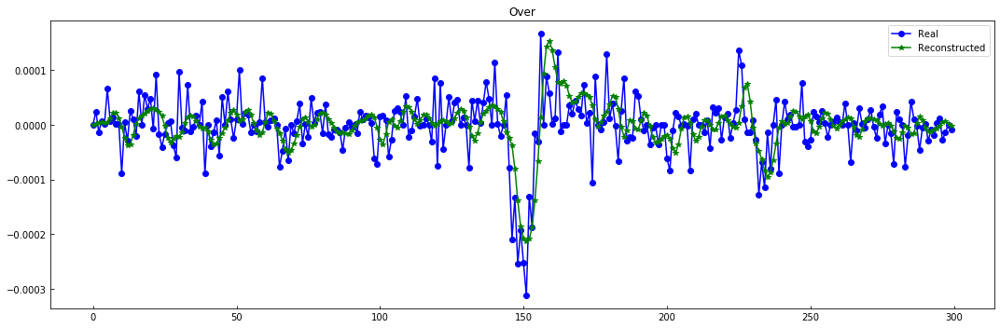

----------------------------------------------------------------


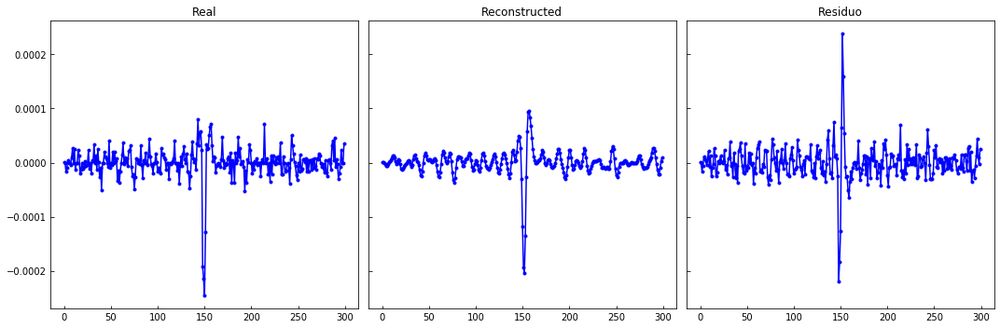

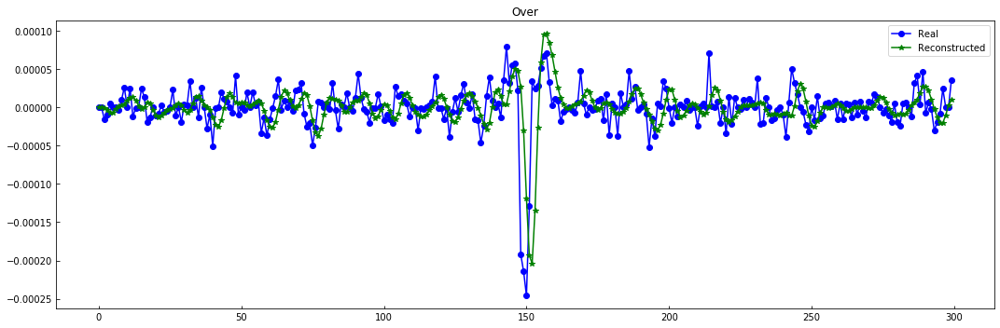

----------------------------------------------------------------


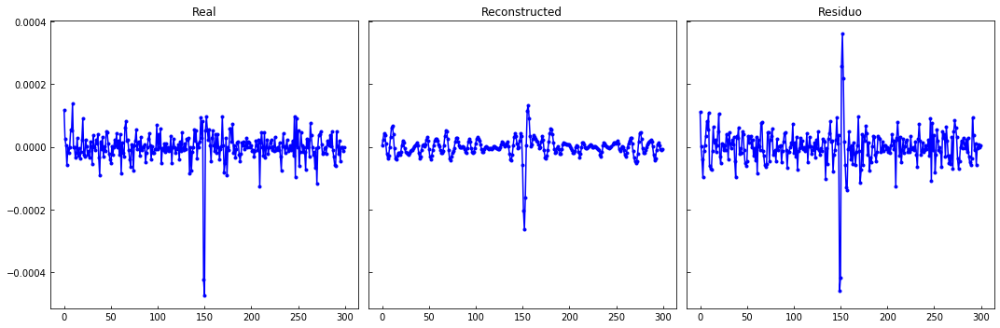

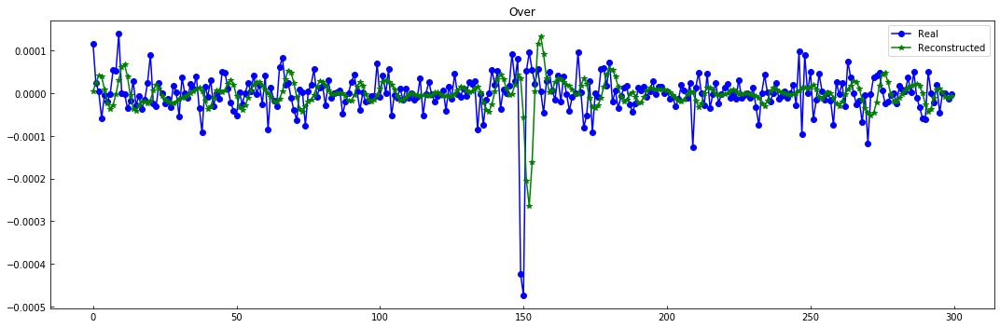

----------------------------------------------------------------


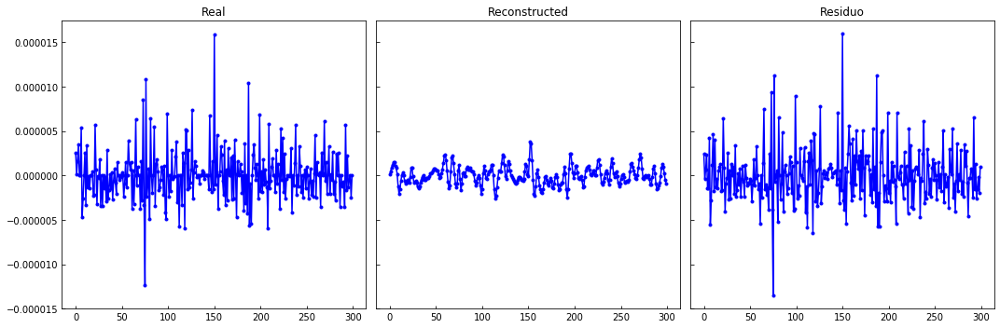

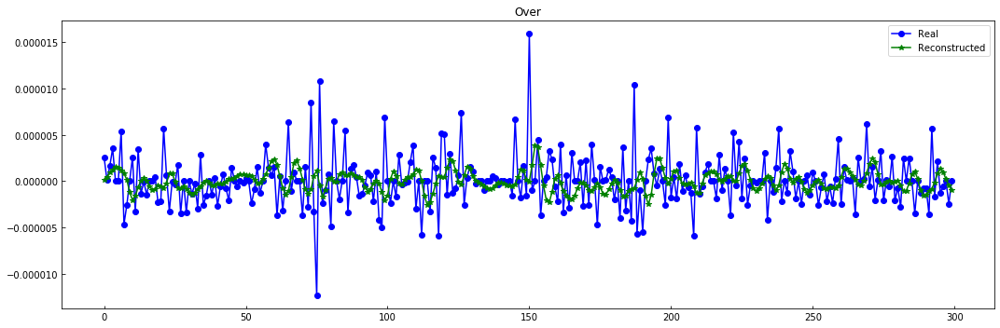

----------------------------------------------------------------


In [51]:
lowcut  = 50 #300. #2000. #con order 3
highcut = 1500 #2500 #2500. # 500. #0.1
fs =  10000.
order = 3

X_train_filter = np.apply_along_axis(butter_bandpass_filter, 1, X_train[:N,:,0]*S_train[:N])

evaluate_reconst(X_train[:N,:,0], X_train_filter/S_train[:N])

plot_n_lc(X_train[:N,:,0]*S_train[:N], X_train_filter, n= 10)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


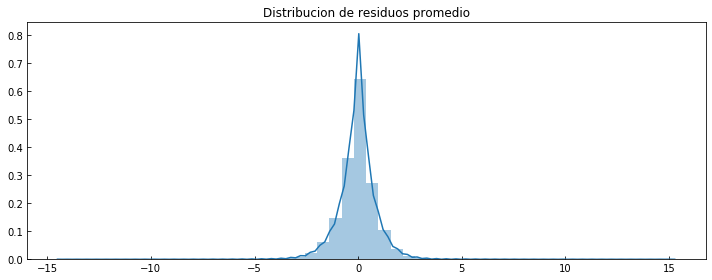

------------- Error -------------
RMSE (+-) =  0.9591904213536872
MAE  (+-) =  0.6403531005600576
------------- Smoothness -------------
AutoCorr lag-one =  0.6700086968365959
Diff MEAN =  0.3634347977239073
------------- Residual -------------
AutoCorr lag-one =  0.04471106448129067
Mean (+) STD = -0.030700 (+) 0.957772
---------------------------------------


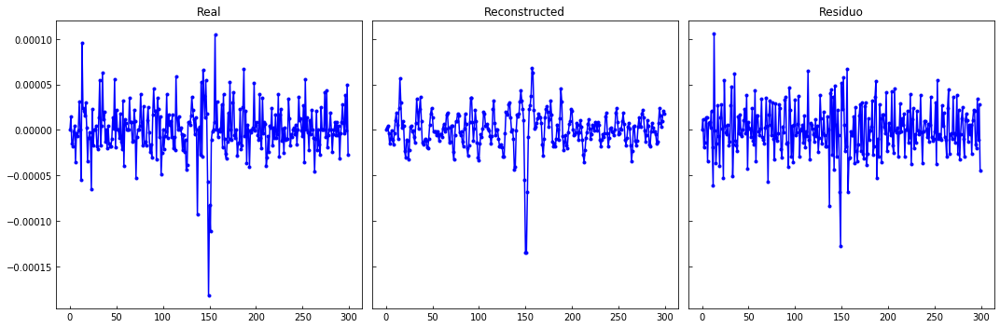

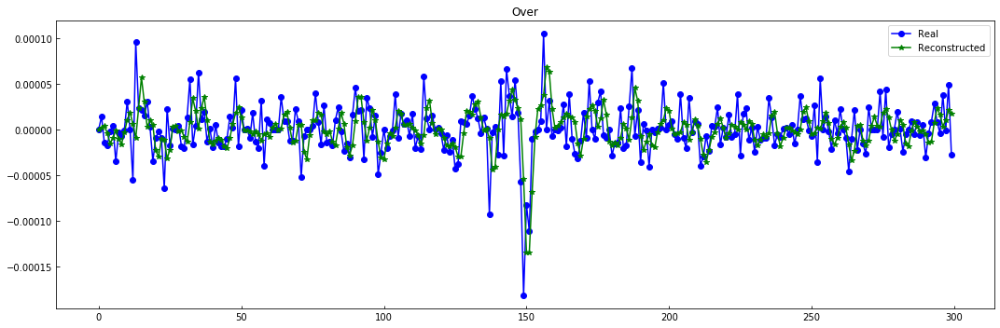

----------------------------------------------------------------


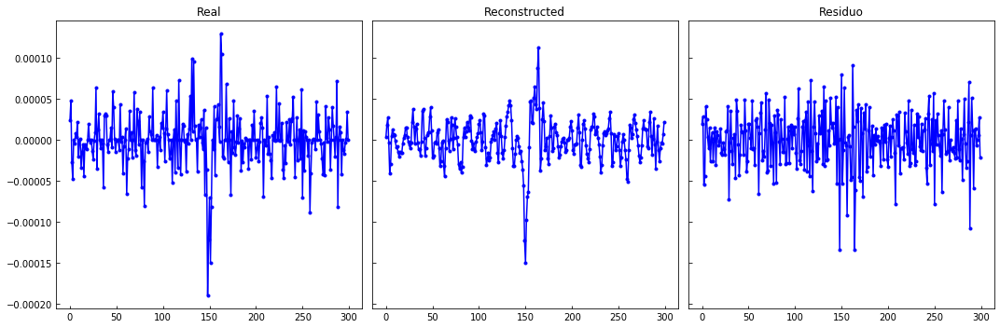

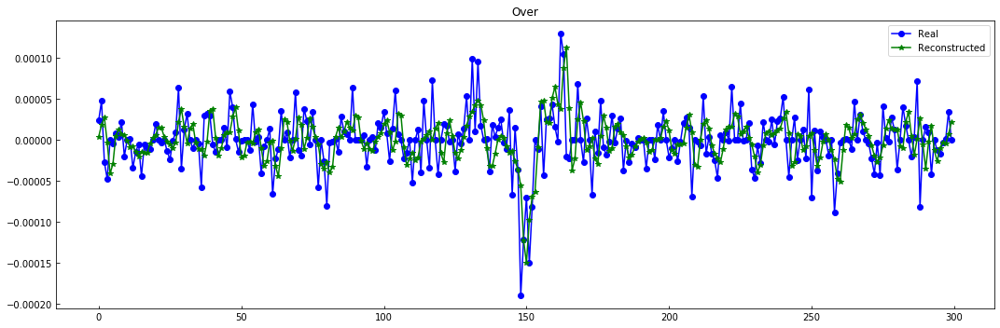

----------------------------------------------------------------


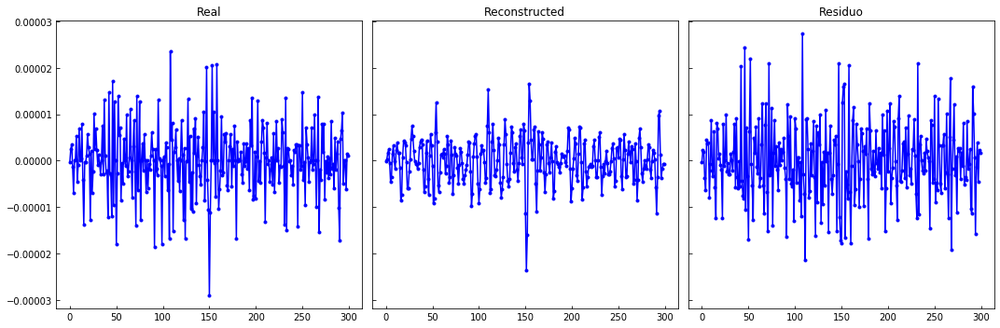

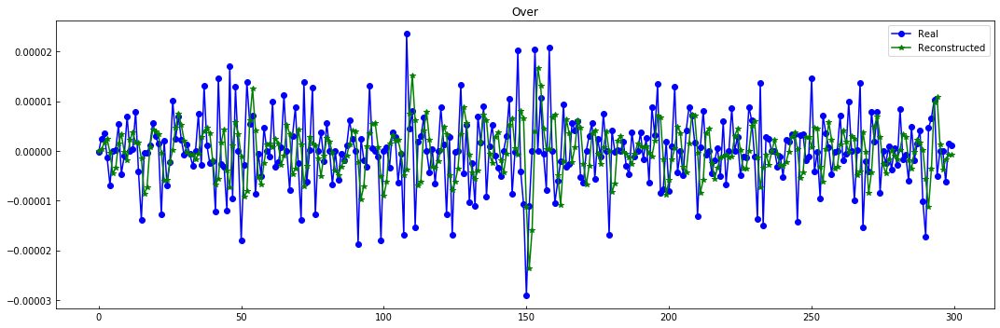

----------------------------------------------------------------


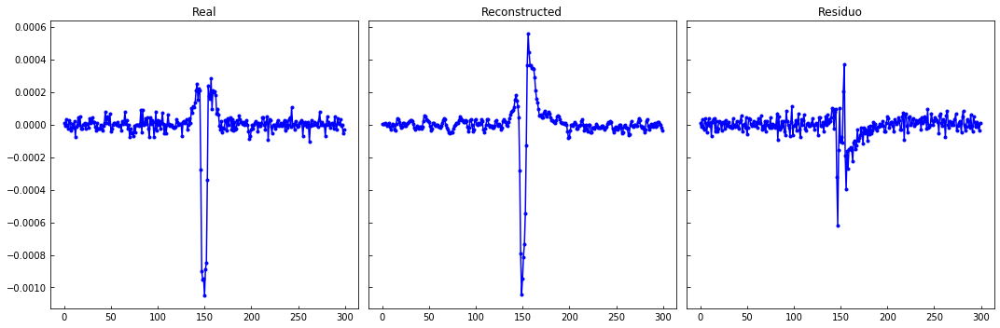

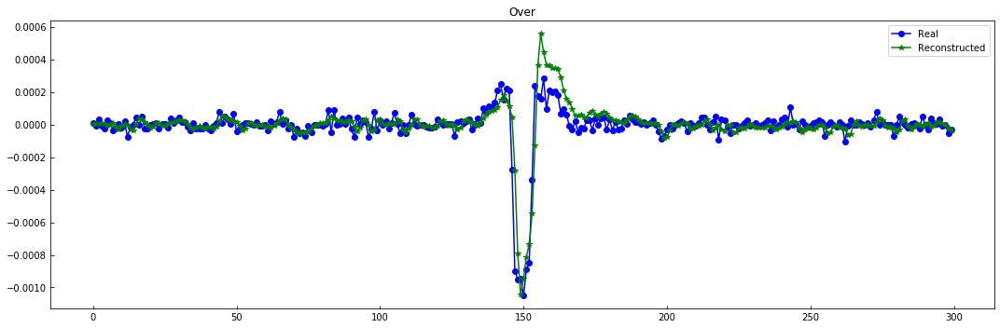

----------------------------------------------------------------


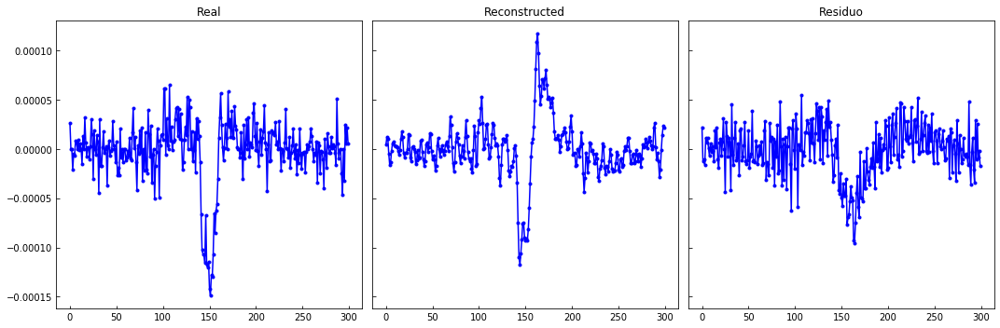

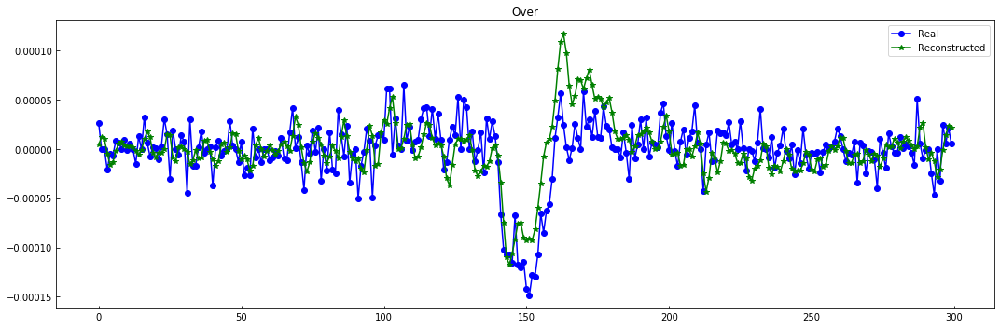

----------------------------------------------------------------


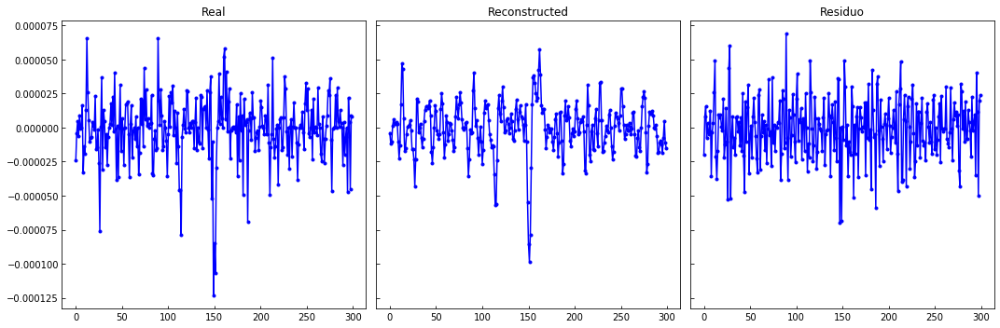

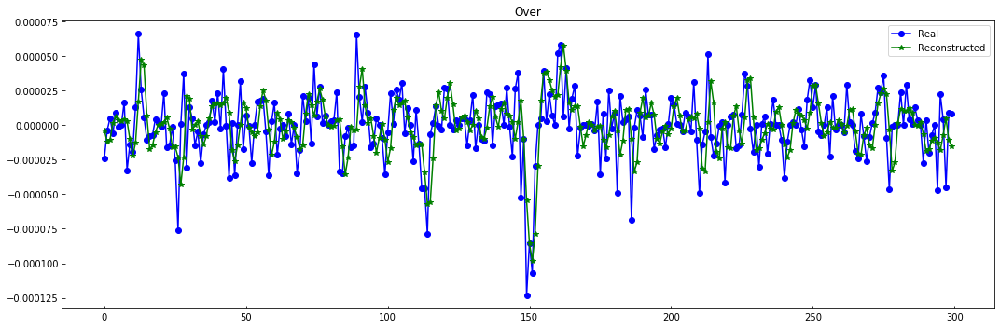

----------------------------------------------------------------


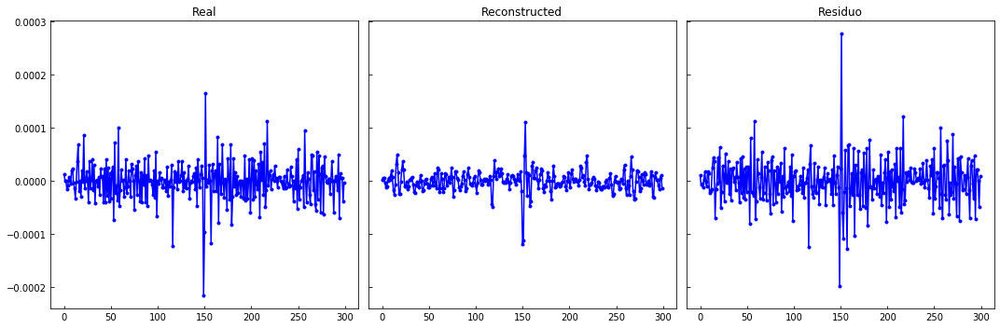

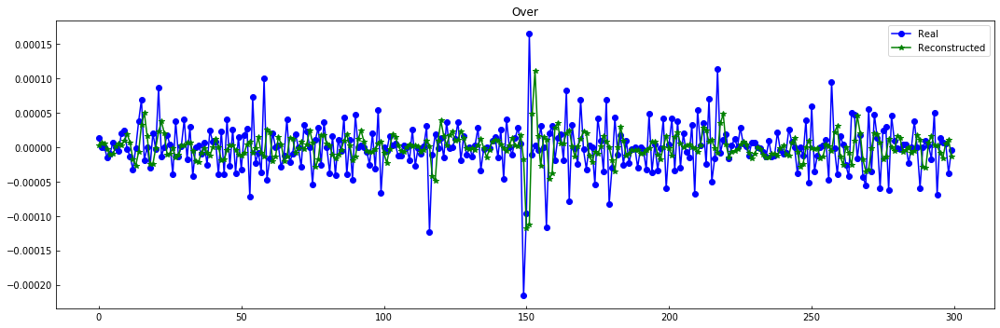

----------------------------------------------------------------


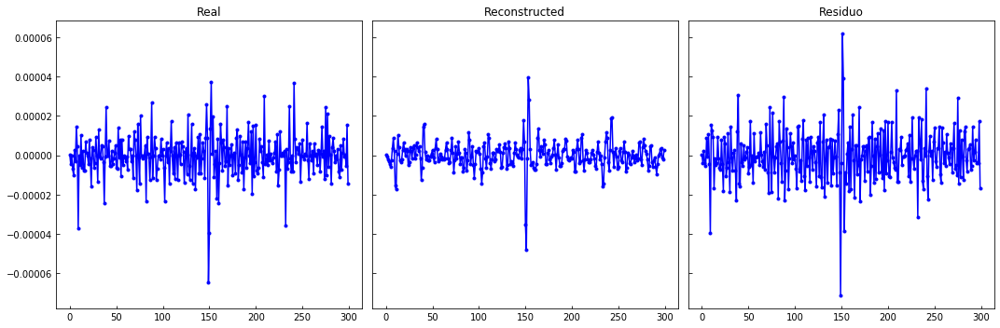

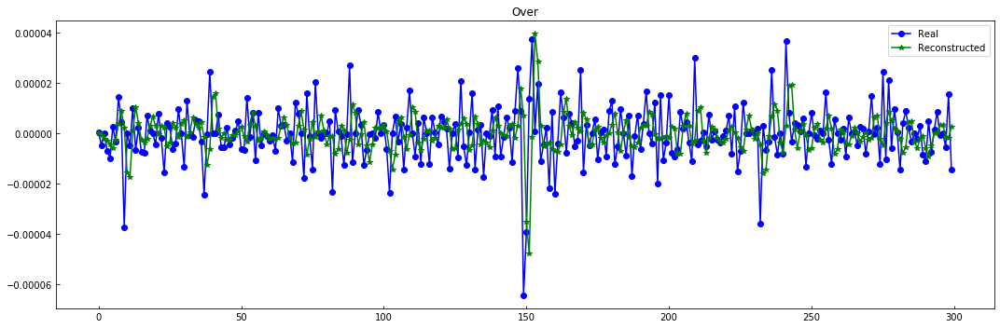

----------------------------------------------------------------


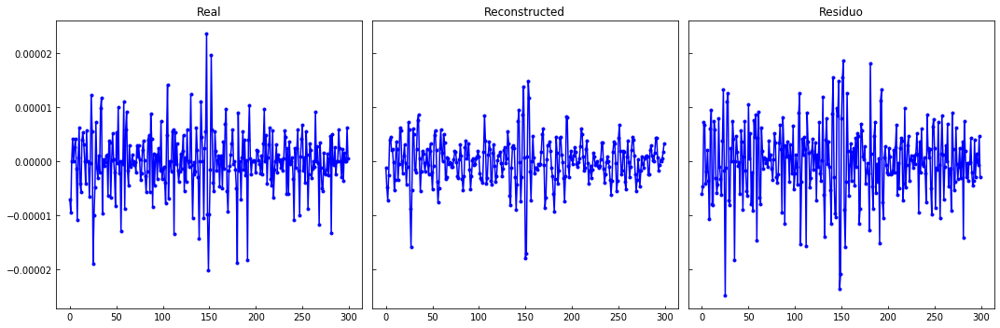

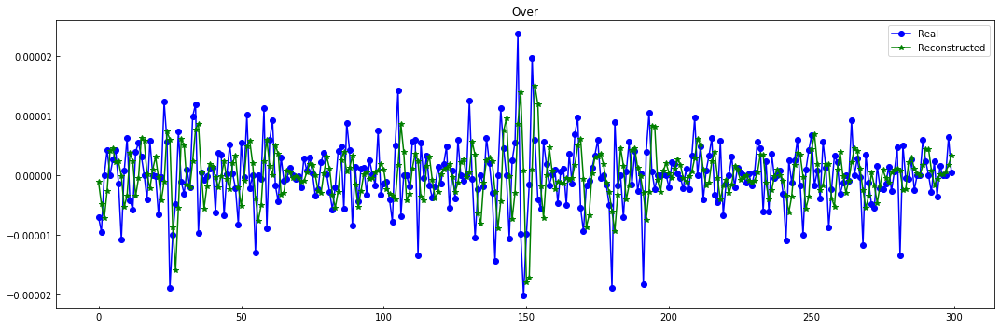

----------------------------------------------------------------


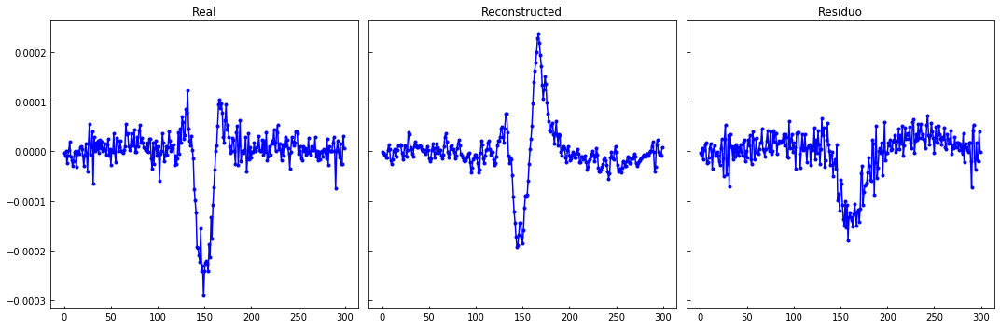

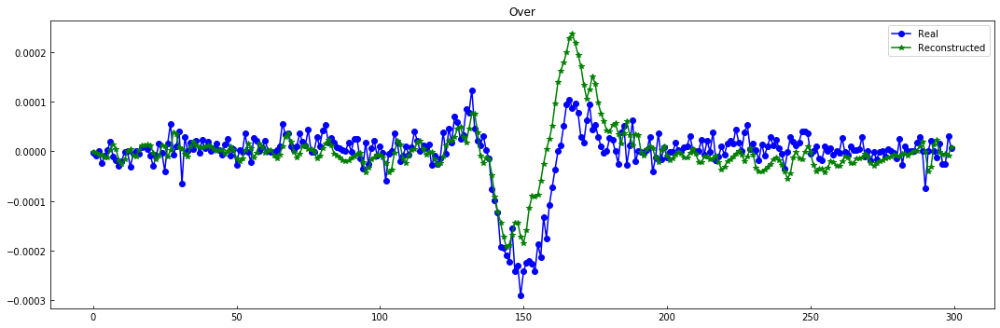

----------------------------------------------------------------


In [52]:
lowcut  = 50 #300. #2000. #con order 3
highcut = 2500 #2500 #2500. # 500. #0.1
fs =  10000.
order = 3

X_train_filter = np.apply_along_axis(butter_bandpass_filter, 1, X_train[:N,:,0]*S_train[:N])

evaluate_reconst(X_train[:N,:,0], X_train_filter/S_train[:N])

plot_n_lc(X_train[:N,:,0]*S_train[:N], X_train_filter, n= 10)

### Smooth light curve (moving average)

In [14]:
df = pd.DataFrame(X_train[:N,:,0]*S_train[:N])
df.head()

,0,1,2,3,4,5,6,7,8,9,...,290,291,292,293,294,295,296,297,298,299
0,2.133975e-06,-0.000019,-0.000036,-0.000065,0.000032,-2.171737e-05,1.116452e-04,0.000007,0.000014,-8.637438e-06,...,0.000005,-0.000071,0.000010,-5.138291e-05,0.000015,5.743022e-07,0.000000,5.709905e-06,2.181083e-05,0.000050
1,7.683856e-05,0.000000,0.000025,-0.000046,-0.000007,-6.448281e-06,1.548516e-05,-0.000013,-0.000029,1.066848e-06,...,0.000019,0.000017,0.000007,3.010494e-05,-0.000059,0.000000e+00,0.000033,-1.526291e-05,4.088124e-05,0.000003
2,6.840072e-07,-0.000007,0.000015,-0.000004,0.000001,-6.996477e-06,1.549588e-05,0.000000,0.000008,-1.470522e-05,...,-0.000015,0.000001,0.000004,-1.367435e-06,-0.000006,2.552921e-06,-0.000002,1.921818e-06,7.506118e-07,0.000000
3,5.053178e-07,-0.000001,0.000000,0.000005,0.000003,5.151207e-07,7.989454e-07,0.000007,0.000009,-1.751745e-07,...,-0.000001,0.000003,0.000000,-4.779266e-07,0.000000,-5.736840e-07,0.000003,0.000000e+00,-1.640786e-06,-0.000009
4,-1.050078e-05,-0.000016,0.000036,-0.000004,0.000012,-6.310806e-06,-6.811486e-08,0.000053,-0.000003,-3.923716e-05,...,-0.000046,-0.000034,0.000044,-1.566232e-05,-0.000008,-1.029041e-06,0.000028,-5.689944e-07,0.000000e+00,-0.000002


----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


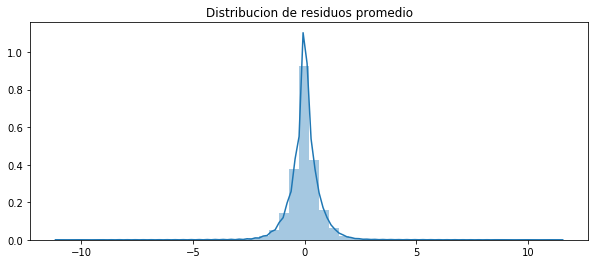

------------- Error -------------
RMSE (+-) =  0.7187058571779474
MAE  (+-) =  0.4611879447505643
------------- Smoothness -------------
AutoCorr lag-one =  0.7035915001171615
Diff MEAN =  0.27365729201587496
------------- Residual -------------
AutoCorr lag-one =  0.025868088395345802
Mean (+) STD = 0.000081 (+) 0.718701
---------------------------------------


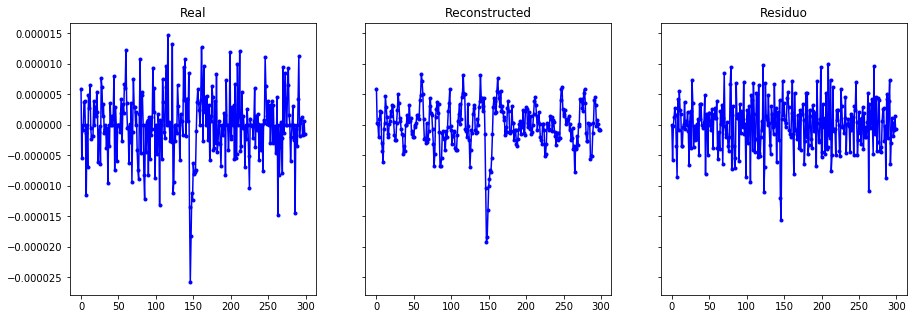

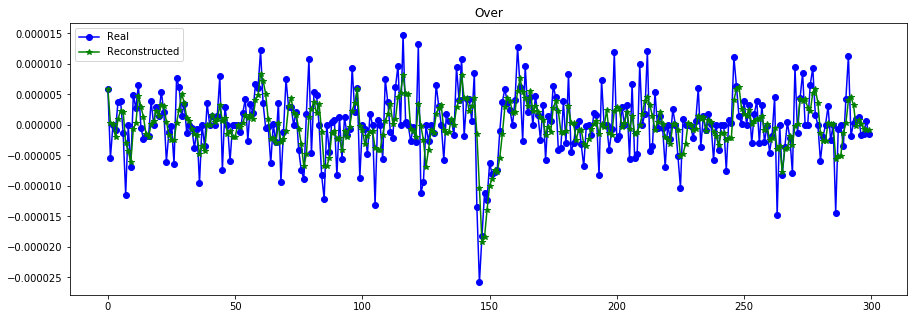

----------------------------------------------------------------


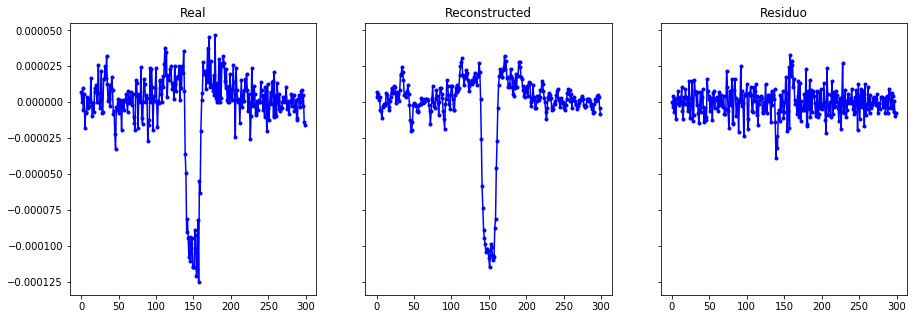

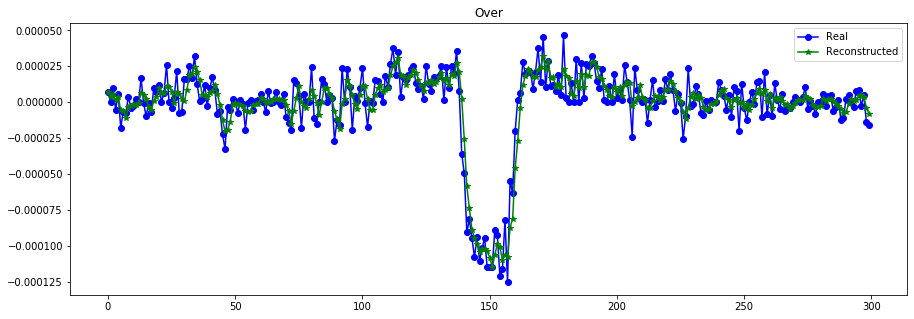

----------------------------------------------------------------


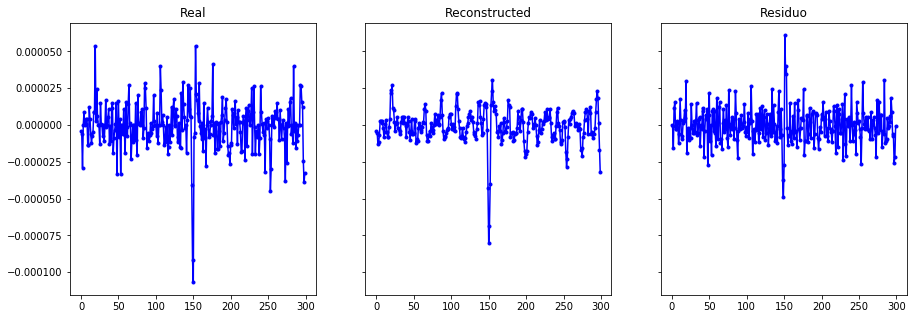

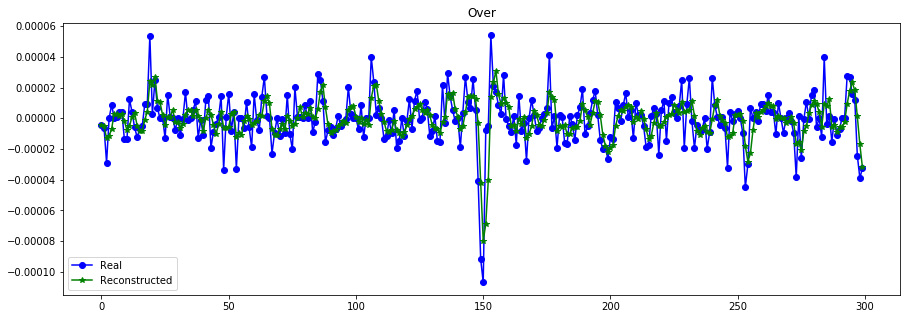

----------------------------------------------------------------


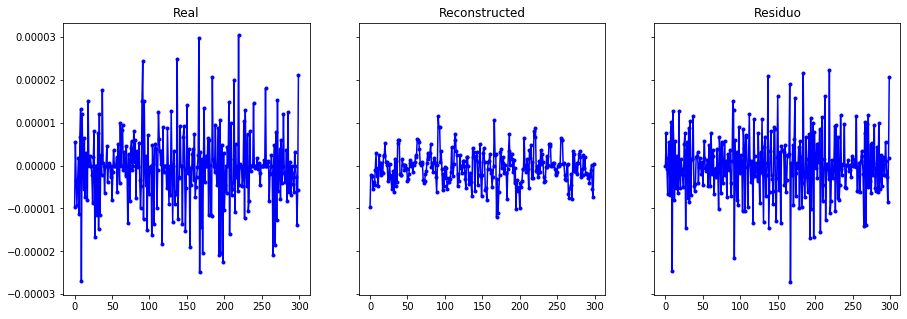

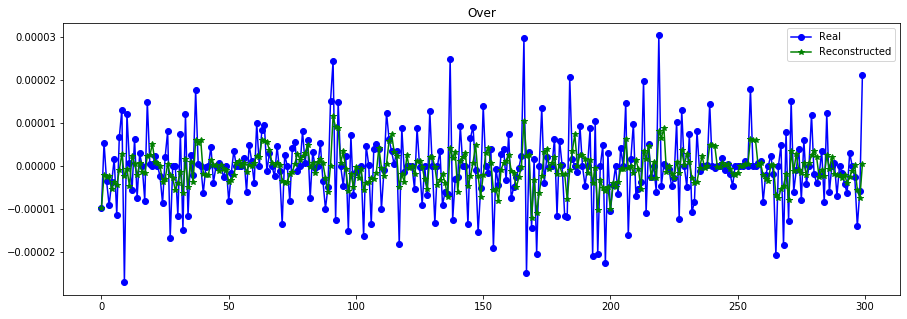

----------------------------------------------------------------


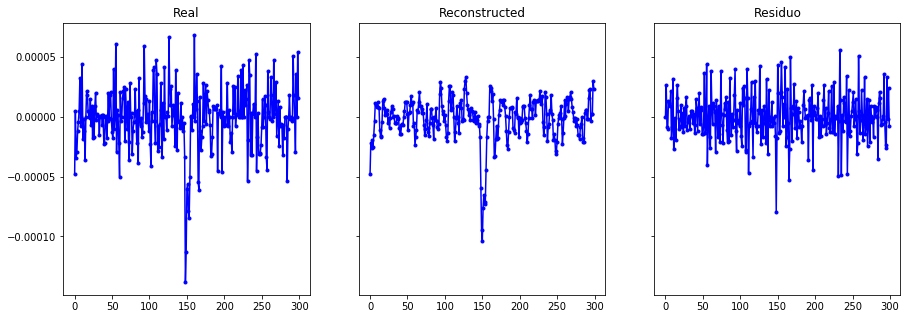

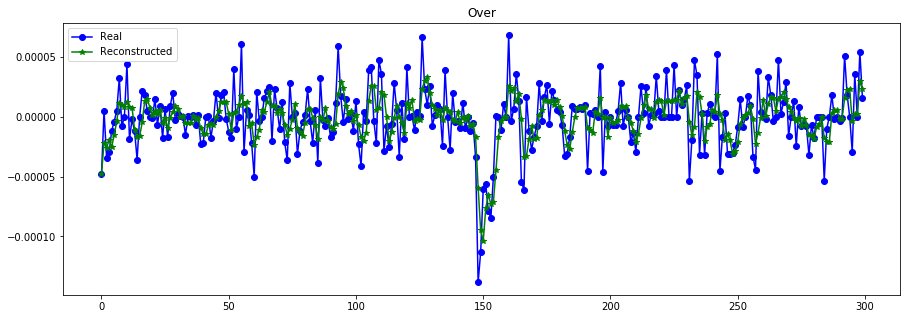

----------------------------------------------------------------


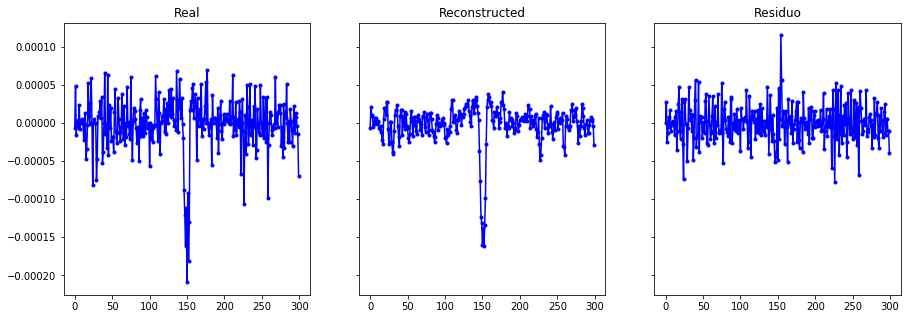

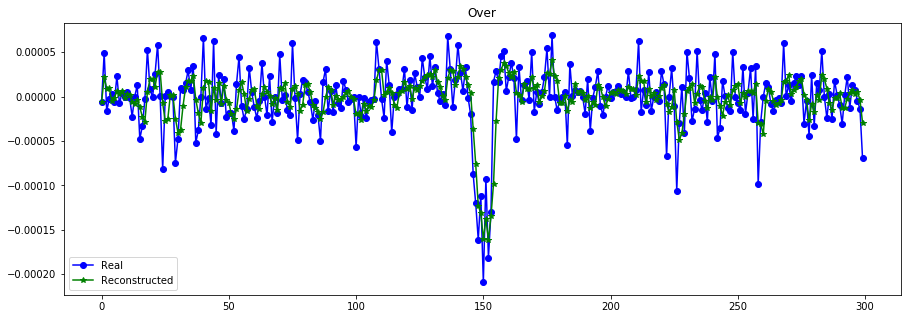

----------------------------------------------------------------


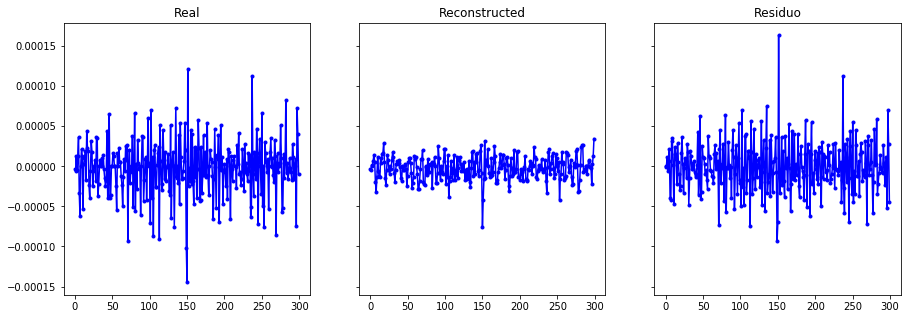

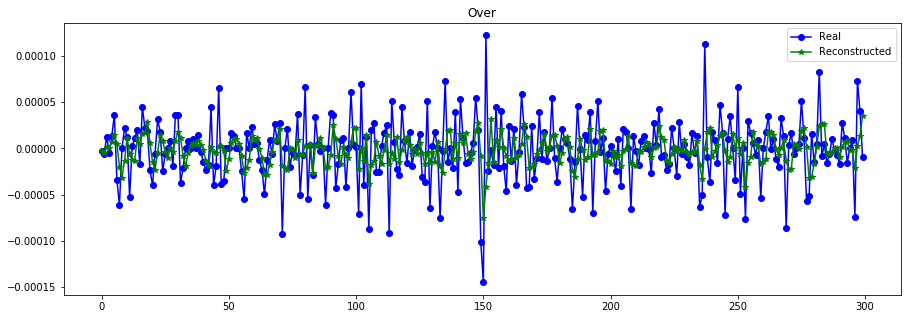

----------------------------------------------------------------


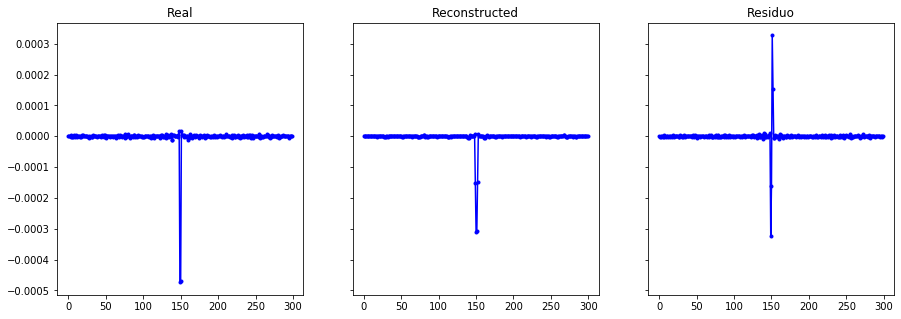

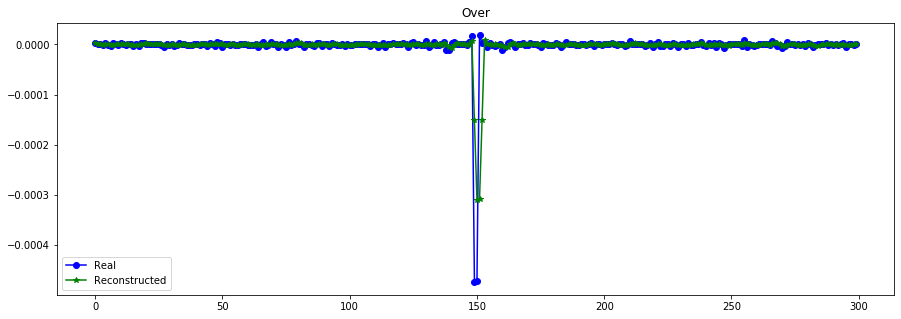

----------------------------------------------------------------


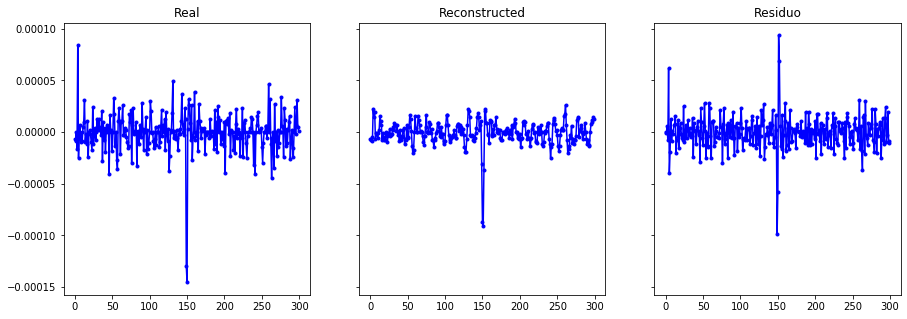

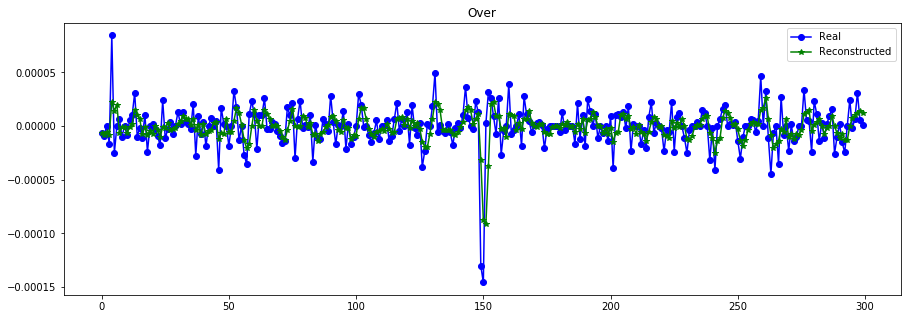

----------------------------------------------------------------


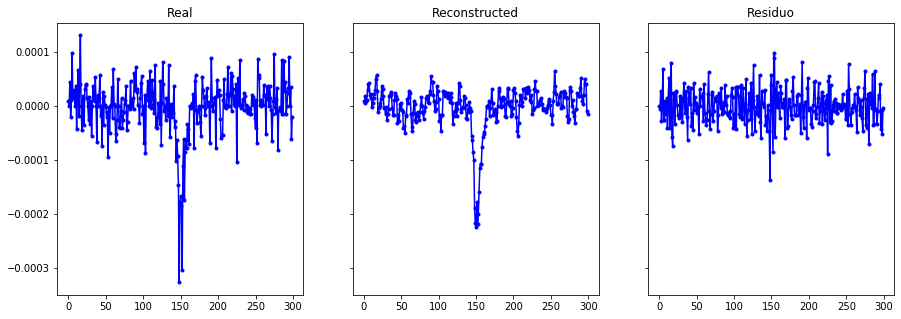

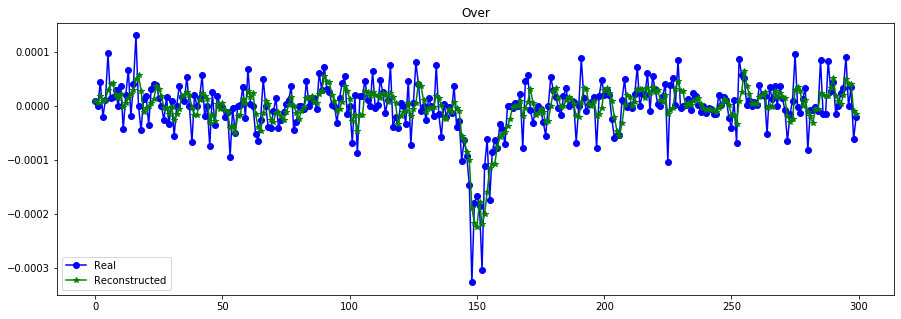

----------------------------------------------------------------


In [15]:
X_train_smooth = df.rolling(window=3, axis=1, min_periods=1).mean().values

evaluate_reconst(X_train[:N,:,0], X_train_smooth/S_train[:N])

plot_n_lc(X_train[:N,:,0]*S_train[:N], X_train_smooth, n= 10)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


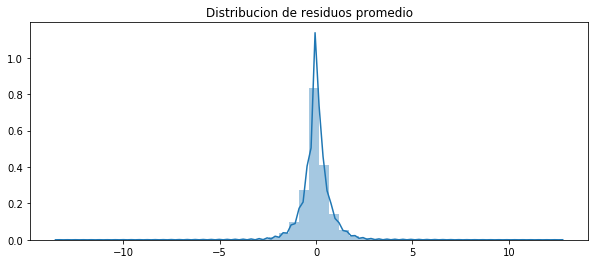

------------- Error -------------
RMSE (+-) =  0.8409120402980607
MAE  (+-) =  0.5127002680673107
------------- Smoothness -------------
AutoCorr lag-one =  0.7843279671025901
Diff MEAN =  0.1697166959053285
------------- Residual -------------
AutoCorr lag-one =  0.1826428783445488
Mean (+) STD = 0.000179 (+) 0.840902
---------------------------------------


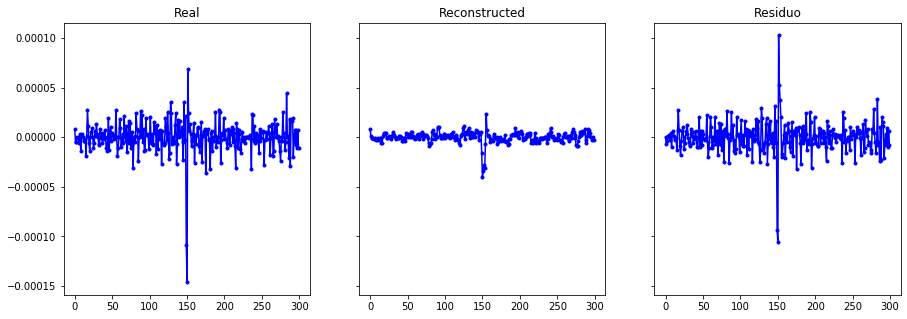

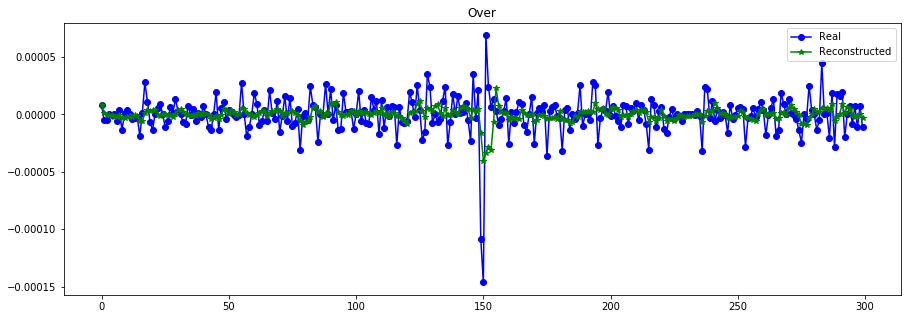

----------------------------------------------------------------


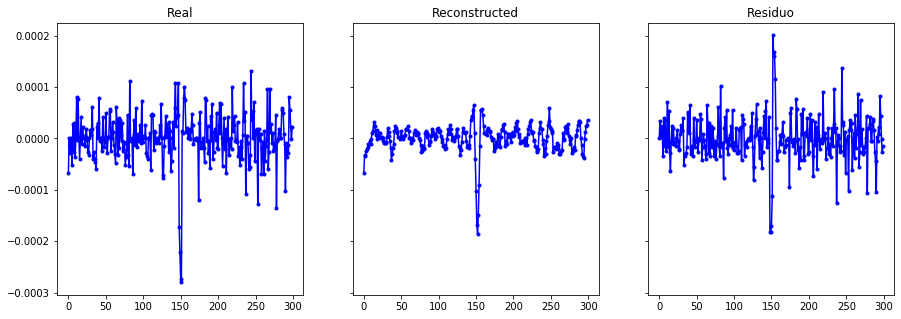

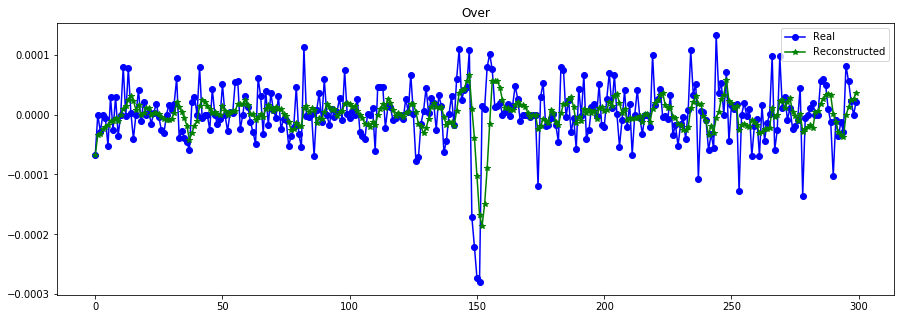

----------------------------------------------------------------


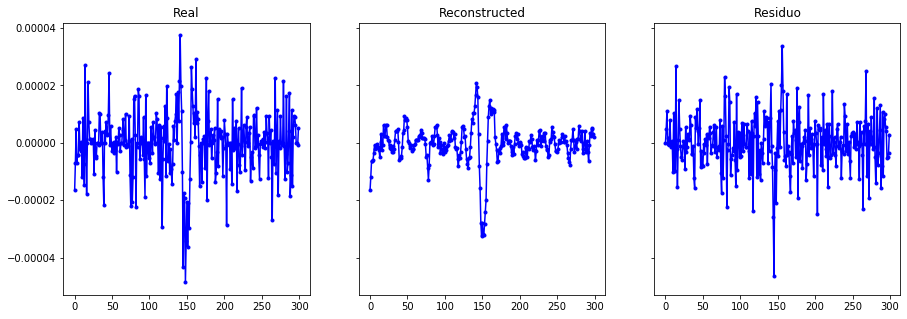

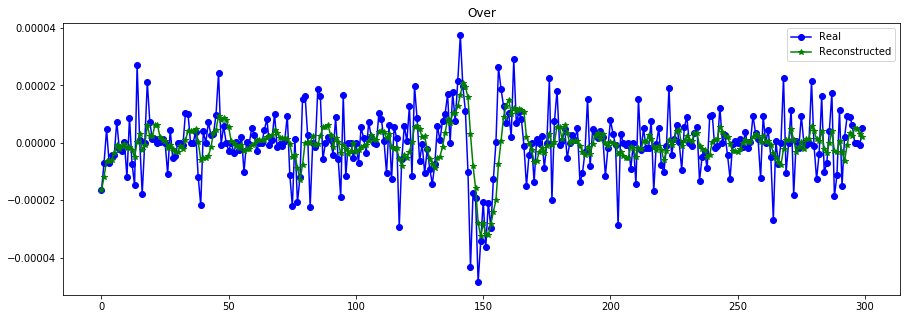

----------------------------------------------------------------


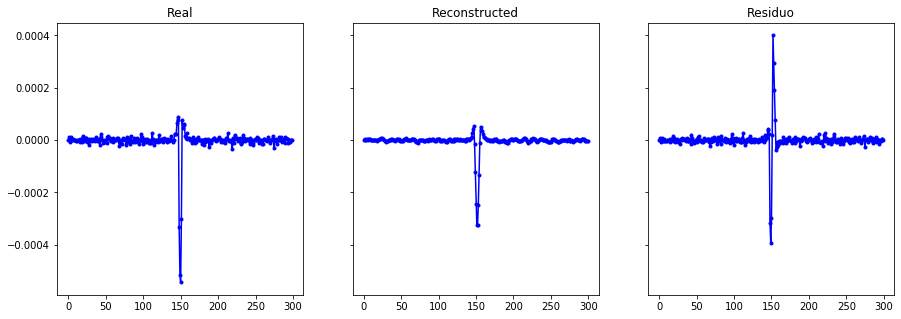

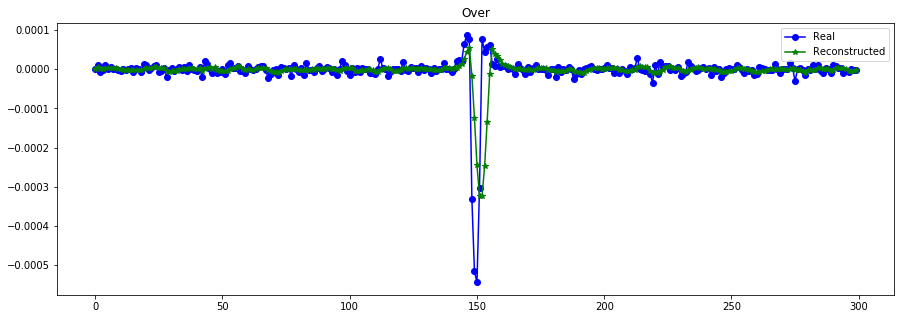

----------------------------------------------------------------


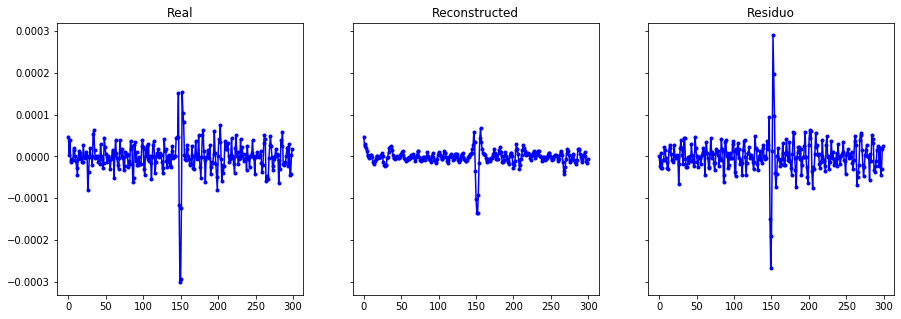

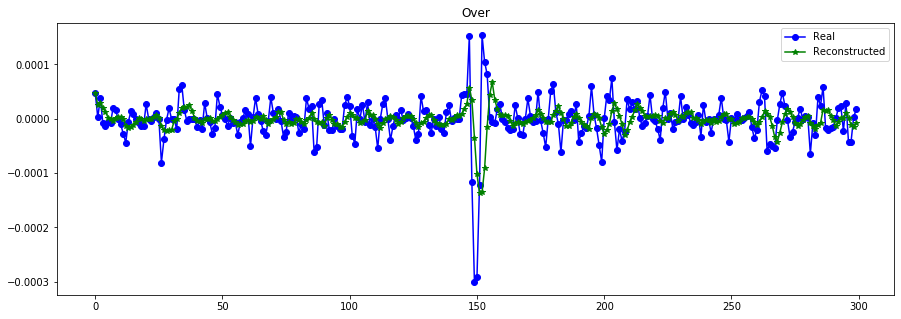

----------------------------------------------------------------


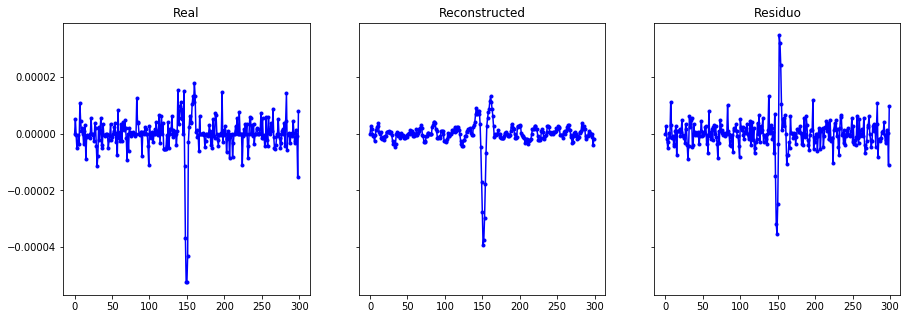

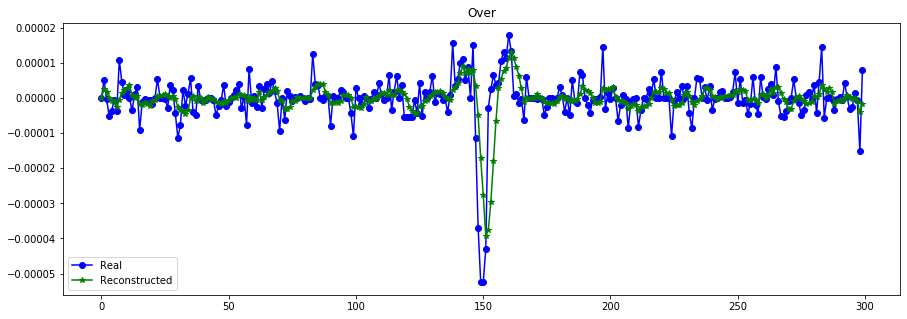

----------------------------------------------------------------


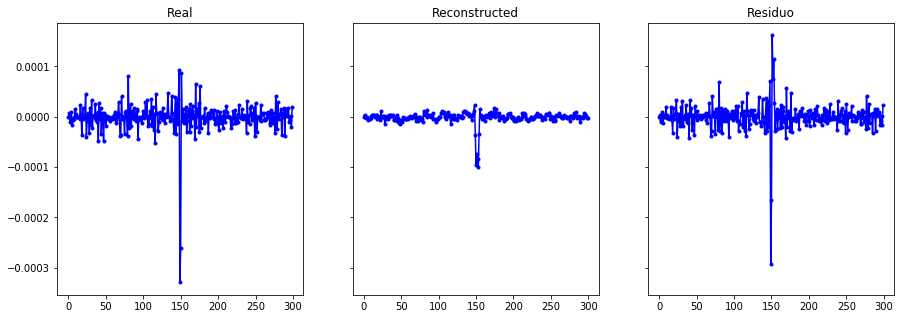

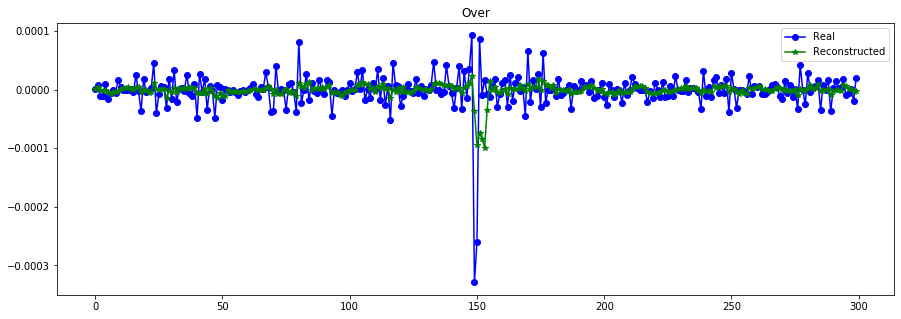

----------------------------------------------------------------


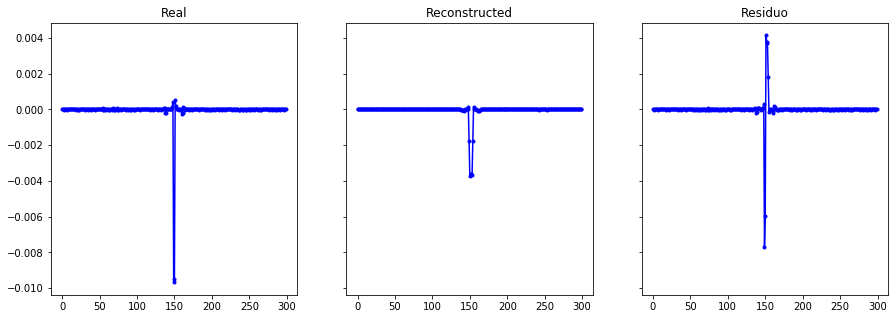

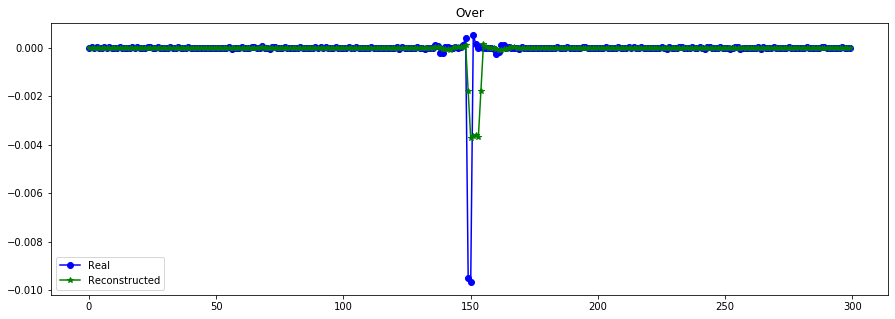

----------------------------------------------------------------


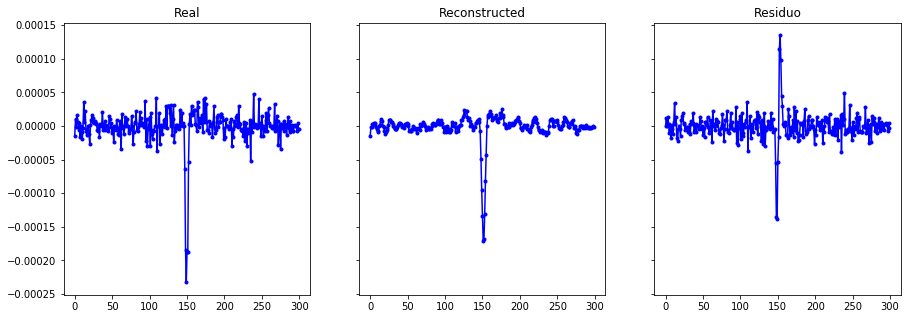

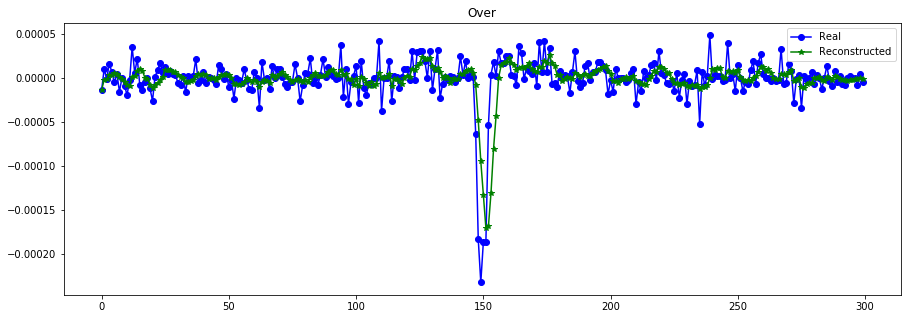

----------------------------------------------------------------


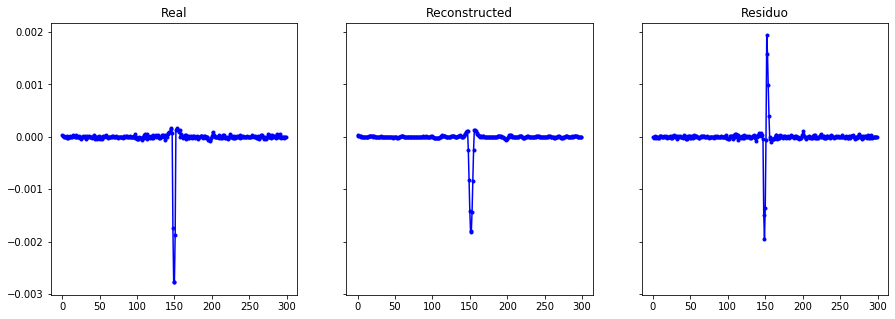

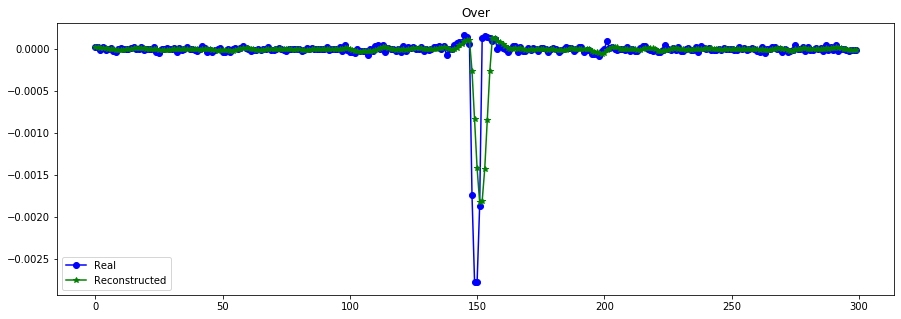

----------------------------------------------------------------


In [16]:
X_train_smooth = df.rolling(window=5, axis=1, min_periods=1).mean().values

evaluate_reconst(X_train[:N,:,0], X_train_smooth/S_train[:N])

plot_n_lc(X_train[:N,:,0]*S_train[:N], X_train_smooth, n= 10)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


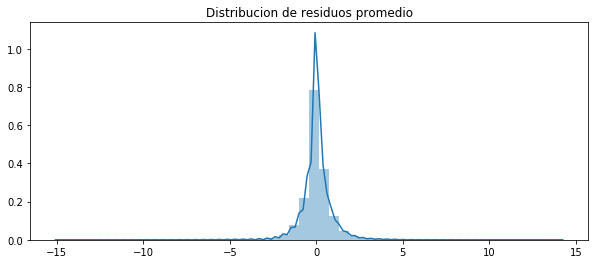

------------- Error -------------
RMSE (+-) =  0.9374380124070237
MAE  (+-) =  0.553104806769996
------------- Smoothness -------------
AutoCorr lag-one =  0.8429504580613227
Diff MEAN =  0.08855878372794385
------------- Residual -------------
AutoCorr lag-one =  0.25656169274600454
Mean (+) STD = 0.000382 (+) 0.937414
---------------------------------------


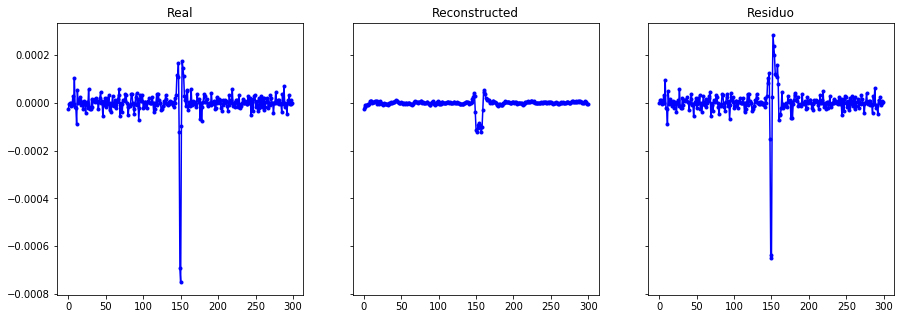

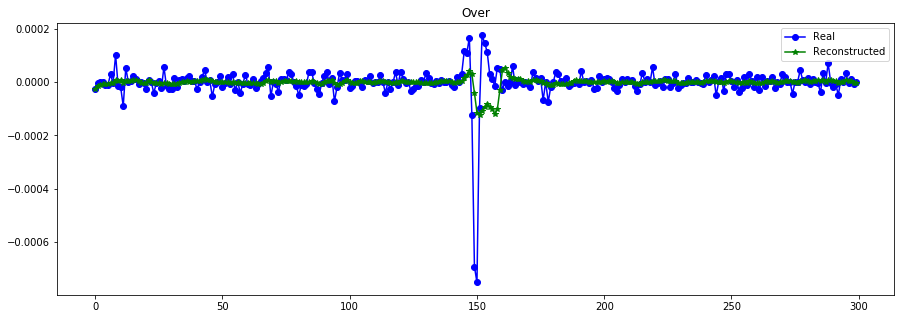

----------------------------------------------------------------


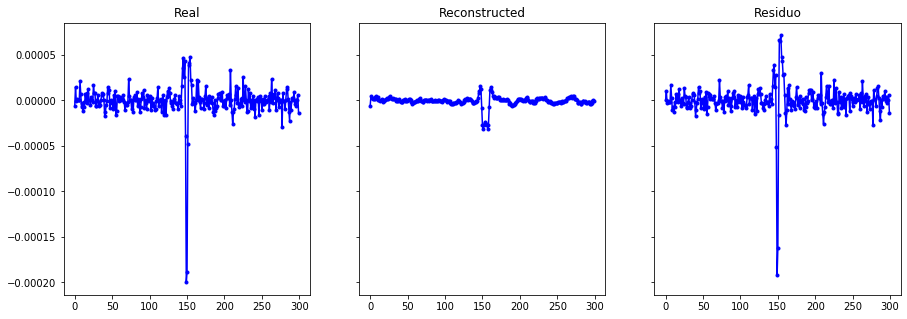

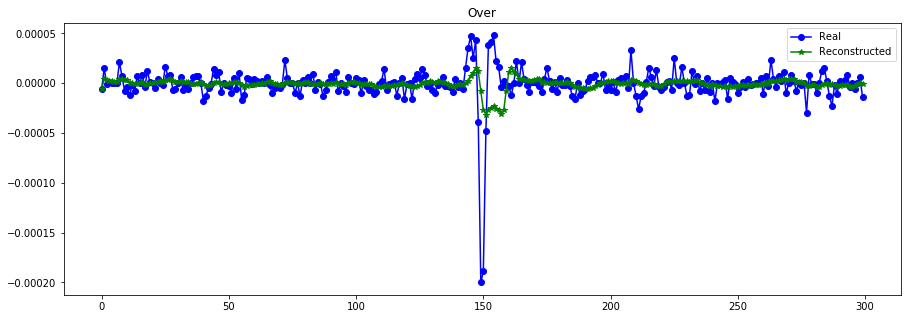

----------------------------------------------------------------


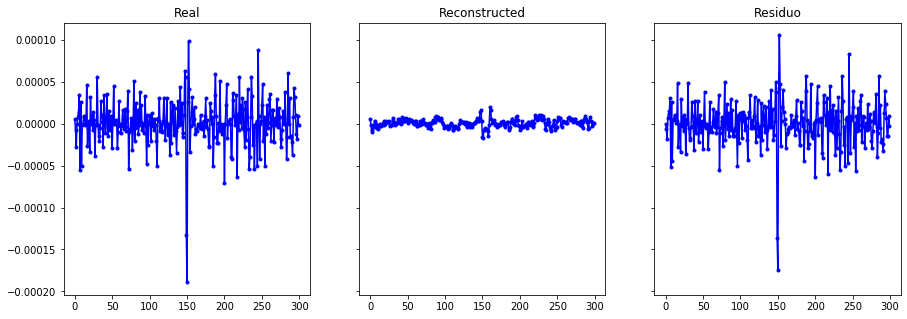

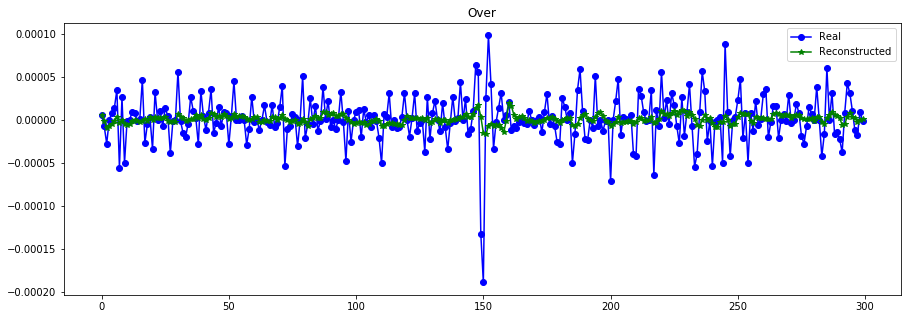

----------------------------------------------------------------


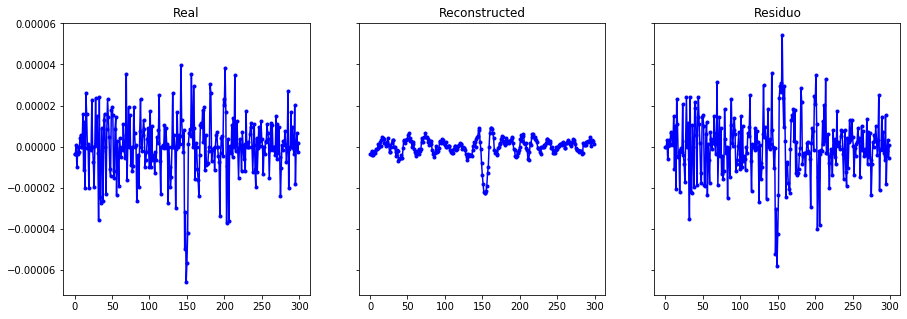

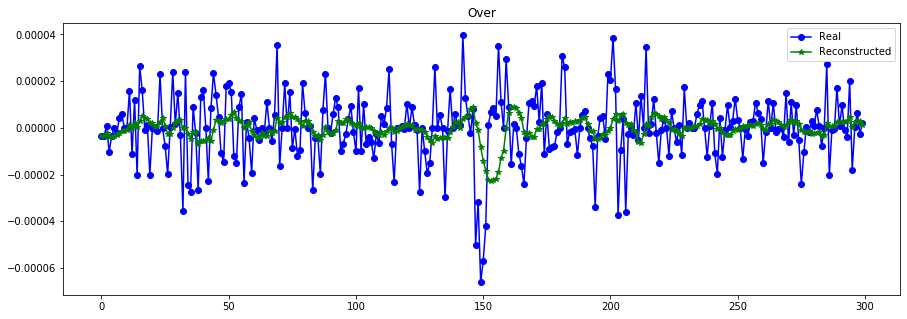

----------------------------------------------------------------


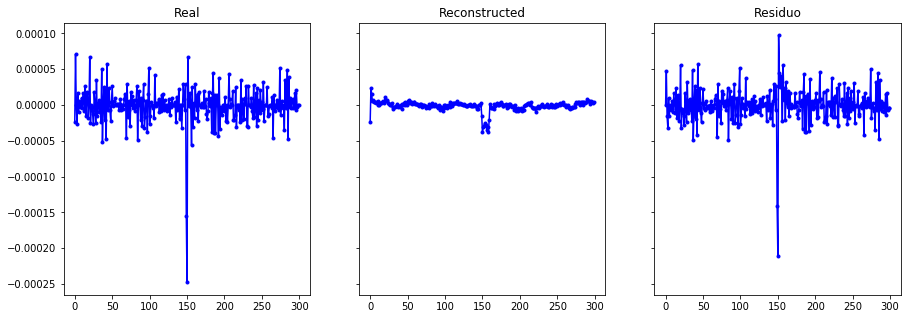

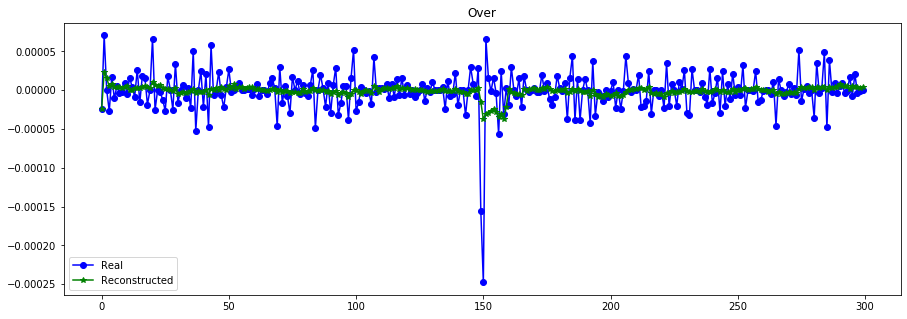

----------------------------------------------------------------


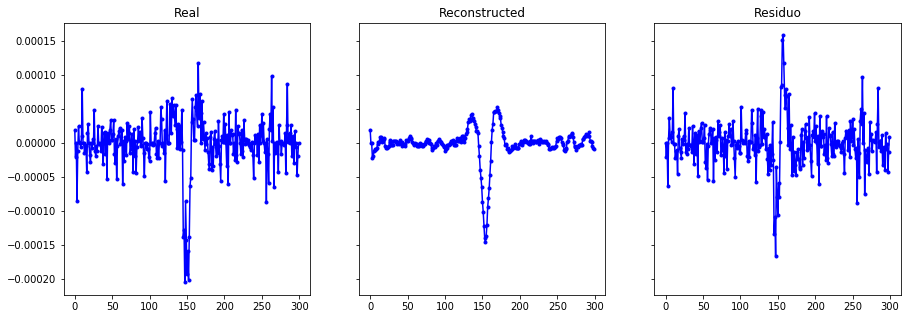

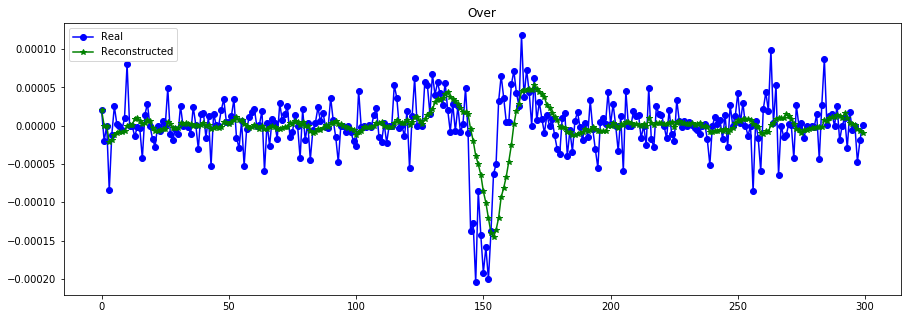

----------------------------------------------------------------


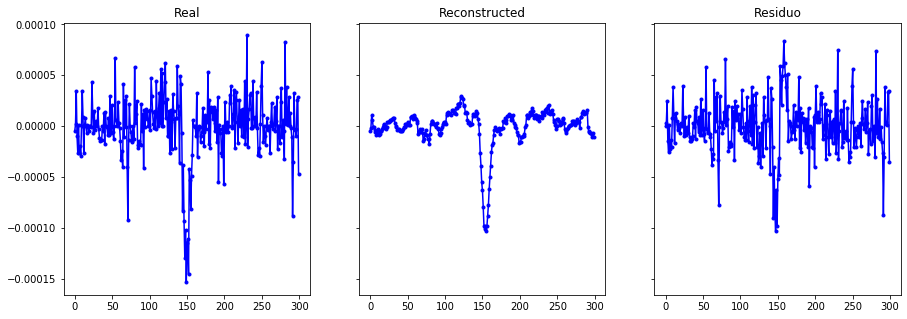

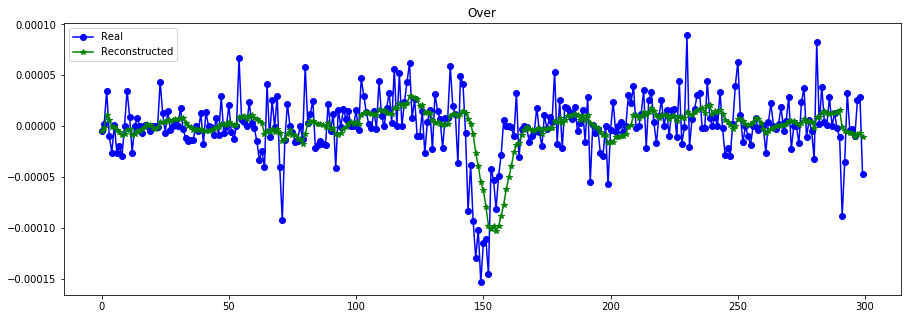

----------------------------------------------------------------


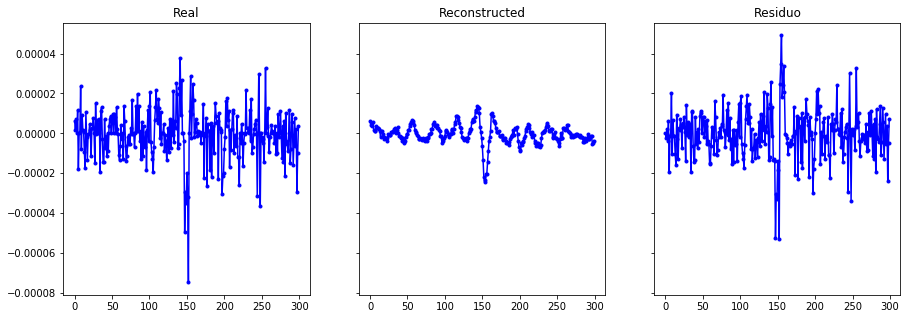

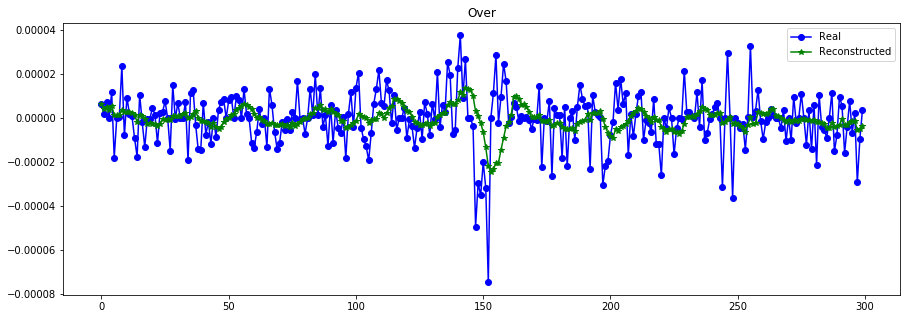

----------------------------------------------------------------


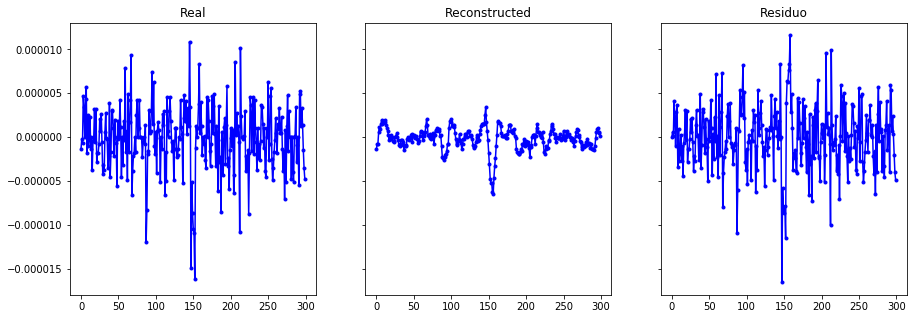

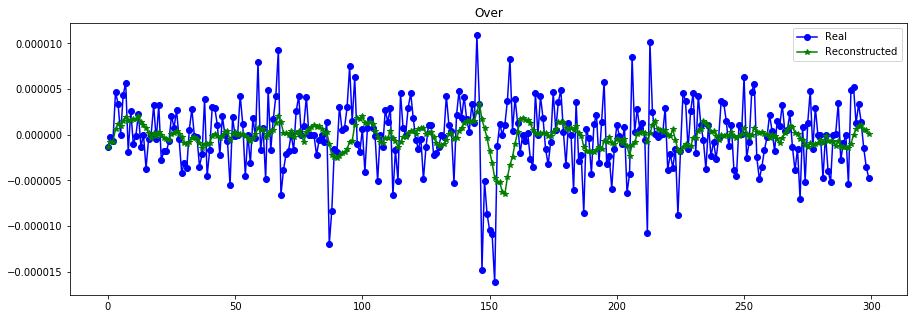

----------------------------------------------------------------


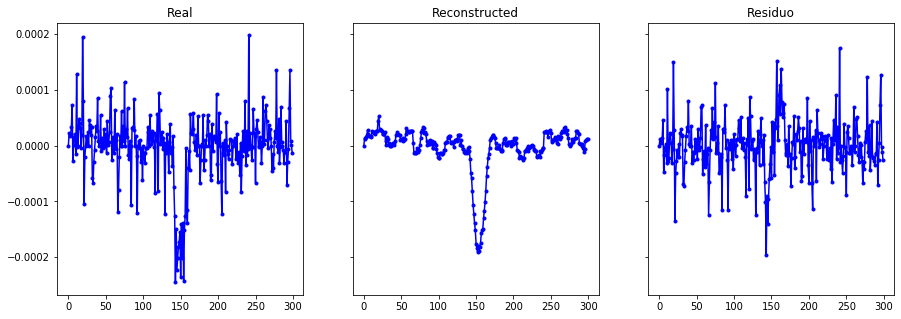

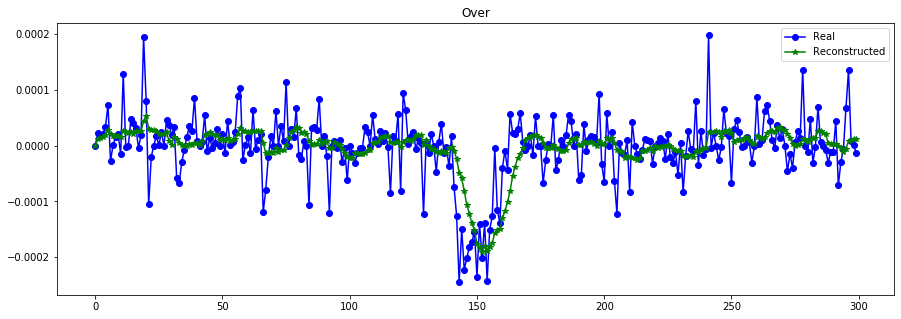

----------------------------------------------------------------


In [17]:
X_train_smooth = df.rolling(window=10, axis=1, min_periods=1).mean().values

evaluate_reconst(X_train[:N,:,0], X_train_smooth/S_train[:N])

plot_n_lc(X_train[:N,:,0]*S_train[:N], X_train_smooth, n= 10)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


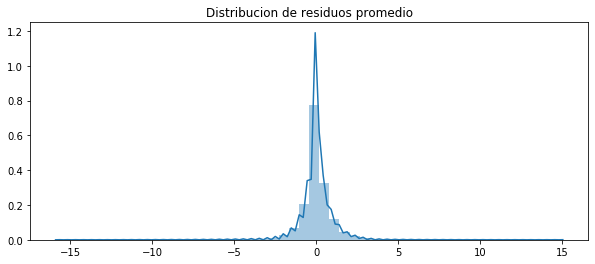

------------- Error -------------
RMSE (+-) =  0.9784135451479038
MAE  (+-) =  0.5716868761399737
------------- Smoothness -------------
AutoCorr lag-one =  0.8652092112413781
Diff MEAN =  0.04672179944086782
------------- Residual -------------
AutoCorr lag-one =  0.2762243368718218
Mean (+) STD = 0.000681 (+) 0.978365
---------------------------------------


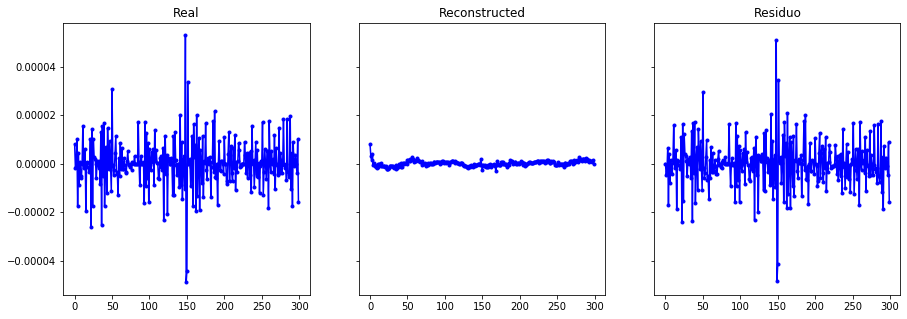

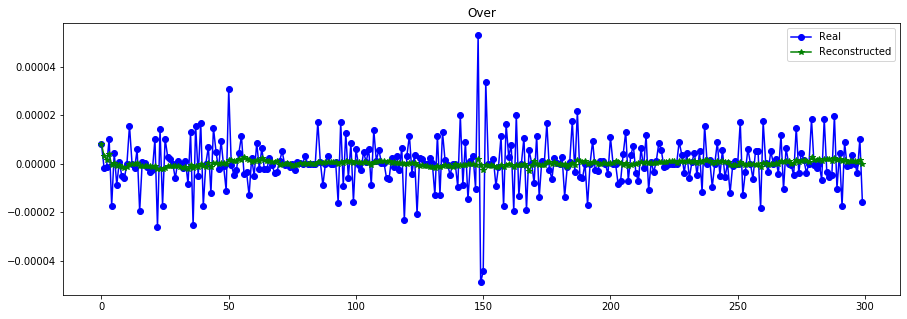

----------------------------------------------------------------


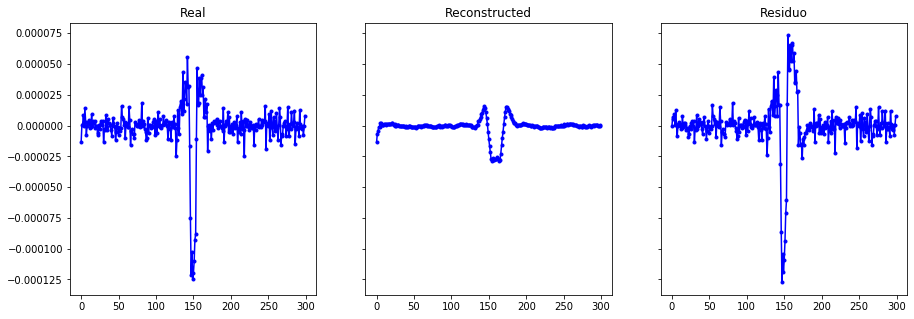

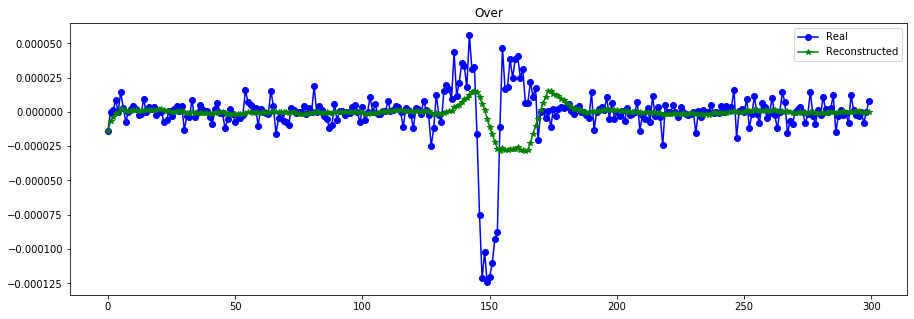

----------------------------------------------------------------


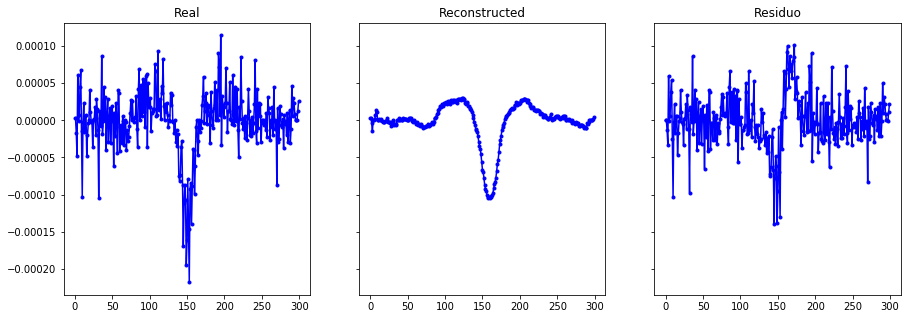

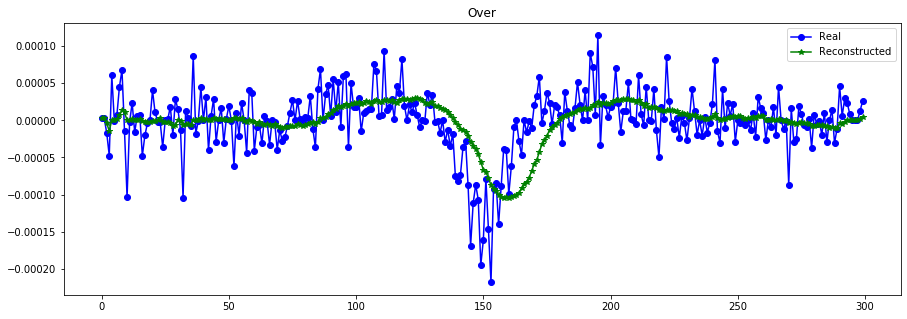

----------------------------------------------------------------


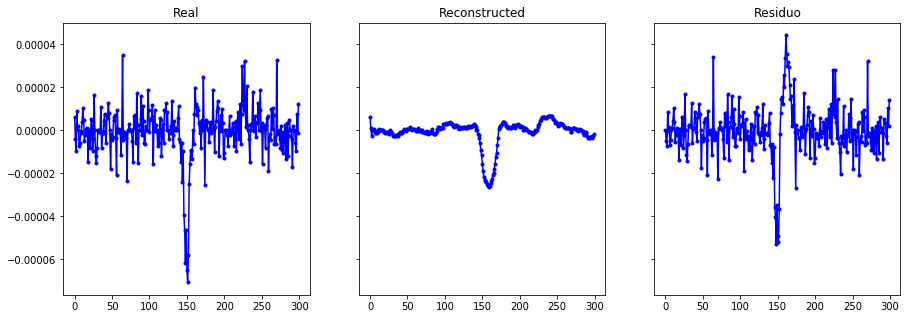

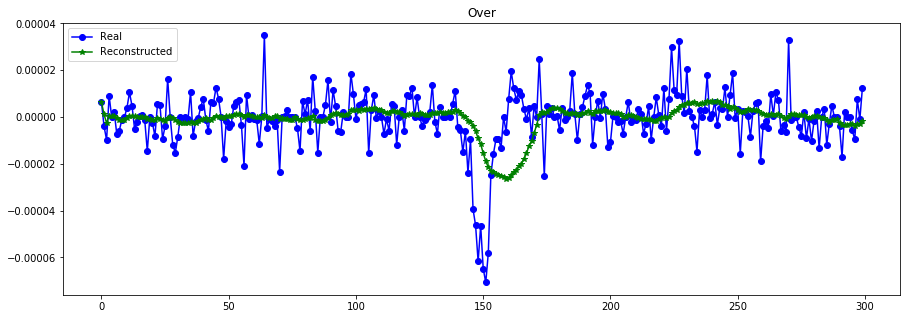

----------------------------------------------------------------


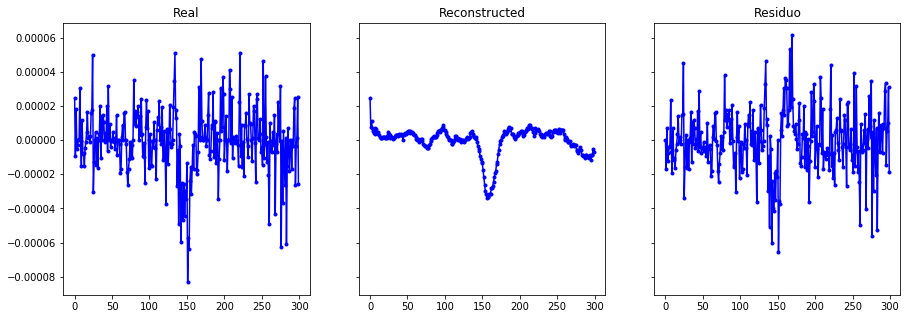

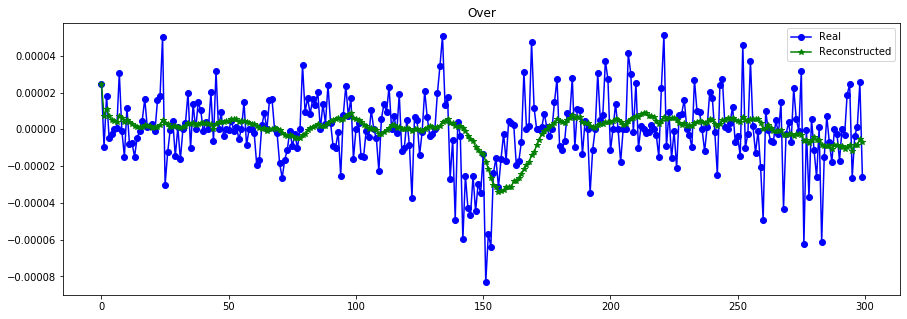

----------------------------------------------------------------


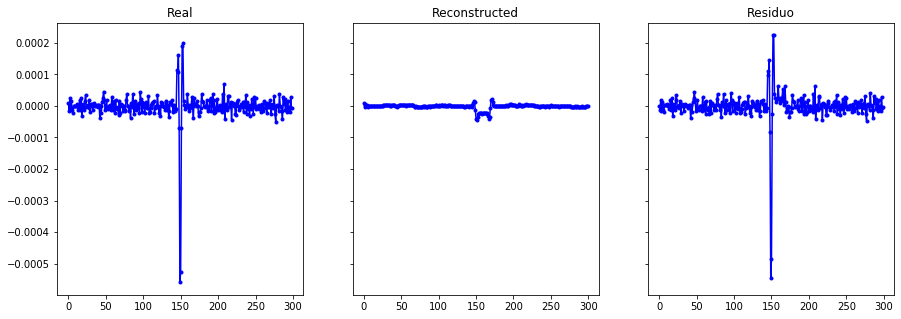

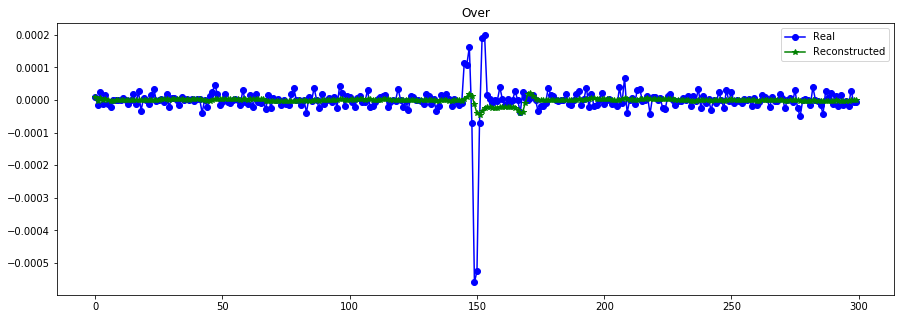

----------------------------------------------------------------


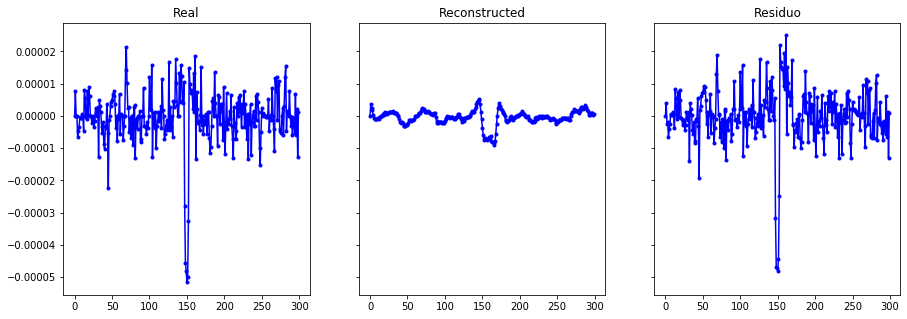

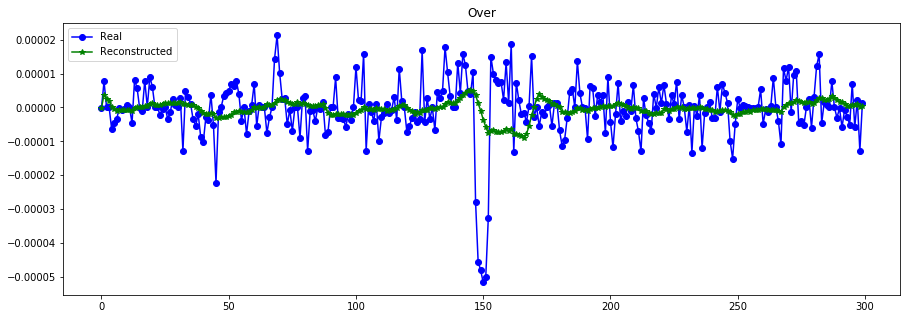

----------------------------------------------------------------


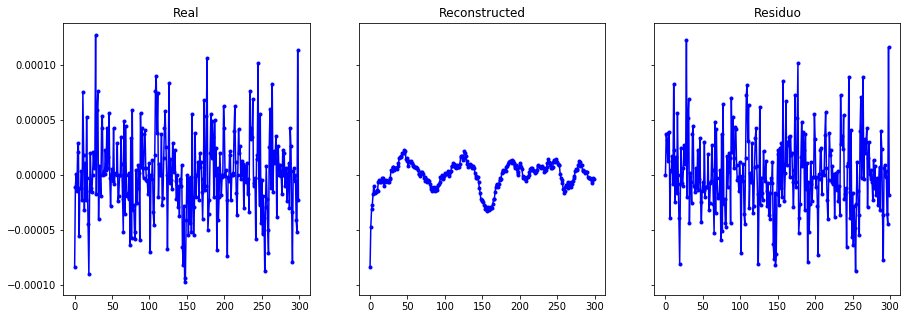

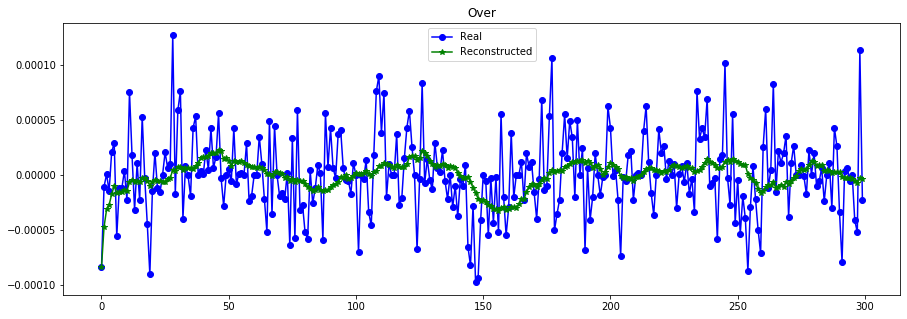

----------------------------------------------------------------


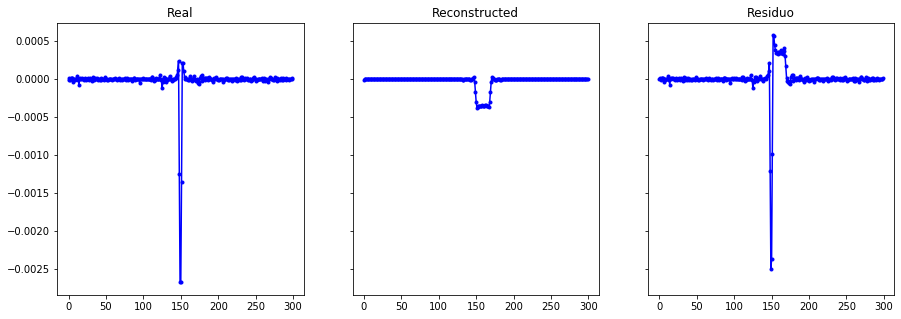

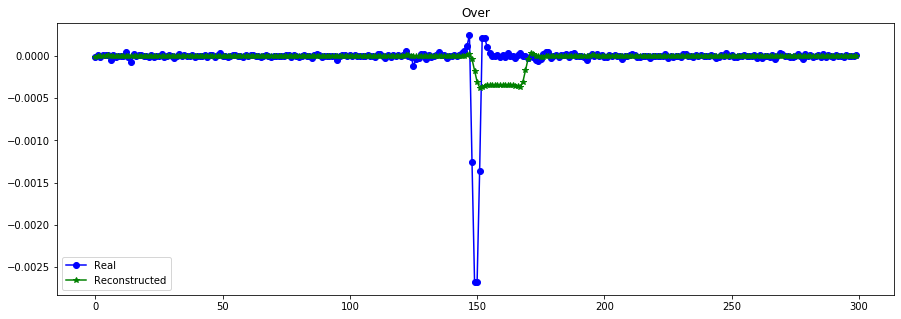

----------------------------------------------------------------


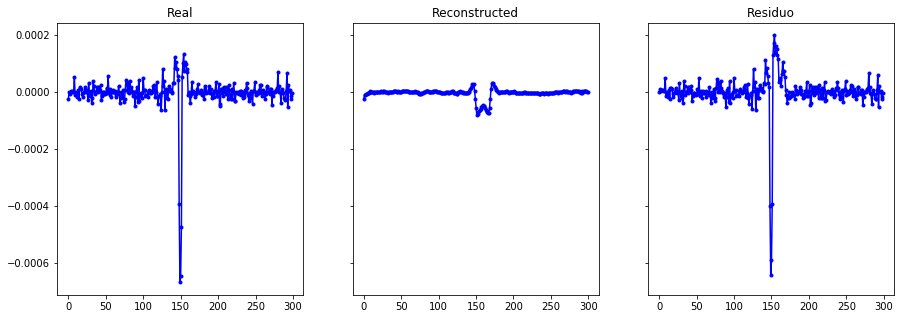

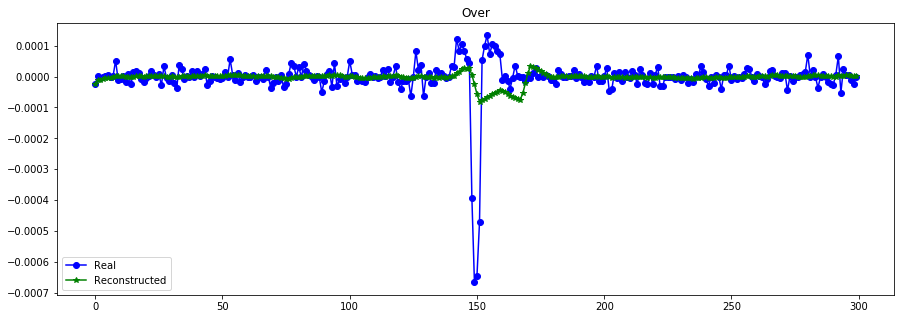

----------------------------------------------------------------


In [18]:
X_train_smooth = df.rolling(window=20, axis=1, min_periods=1).mean().values

evaluate_reconst(X_train[:N,:,0], X_train_smooth/S_train[:N])

plot_n_lc(X_train[:N,:,0]*S_train[:N], X_train_smooth, n= 10)

### Mandel-Agol model
Radio de planeta indica la profundidad de transito, periodo indica el tiempo entre repeticiones, los coefiecients de limb indican el tipo de luz que emiten los bordes de la estrella, radio de órbita se refleja en la duracion del transito, ángulo de inclination indica el angulo entre el plano perpendicular a la estrella y de la estrella al planeta (si i=90 orbita es perpendicular a la vision).

Relación I:
* ángulo de inclination (i)
* semi-major axis normalized ($a_R$)  -- /Rs
* **impact circular parameter (b)** (dependiente)
* $ b= a_R \cdot cos(i) $ 
    * (en radios estelares) --idealmente debiera ser adimensional (0 a 1)

Relación II:
* radio del planeta normalizado ($r_R$) -- /Rs
* impact circular parameter (b) 
* semi-major axis normalized ($a_R$)  -- /Rs
* periodo (p)
* **transit duration (trans)**
* derivado desde la distancia que el planeta viaja al eclipsar la estrella $l= \sqrt{ (R_s+ R_p)^2 + b^2 }$
* $trans = \frac{p}{\pi} \sin^{-1}{(l/a*R_s)} = \frac{p}{\pi} \sin^{-1}(\sqrt{ (1+ r_R)^2 + b^2 }/a_R) $

Relación III:
* periodo (p)
* transit depth -- relacionado a $r_R$
* transit duration (trans)
* **stellar density** se deriva de una relación similar a la tercera ley de newton
segun libreria con "a"


refs: 
* https://www.paulanthonywilson.com/exoplanets/exoplanet-detection-techniques/the-exoplanet-transit-method/ 
* https://www.hs.uni-hamburg.de/DE/Ins/Per/Czesla/PyA/PyA/pyaslDoc/aslDoc/transitDuration.html
* https://cds.cern.ch/record/560538/files/0206228.pdf

In [27]:
import pysyzygy as ps 
import everest #-- basado en pysyzygy
import pytransit
import batman
#otros transit modeling
import pylightcurve as plc
import ktransit

import matplotlib
matplotlib.use('module://ipykernel.pylab.backend_inline') 

no display found. Using non-interactive Agg backend



In [41]:
from mandelagol_sim import simulate_MA, get_MA_sim_names
        
MA_sim_names = get_MA_sim_names()

ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.539366,0.269683,0.016,1.012,12.57,0.988,0.314,0.304


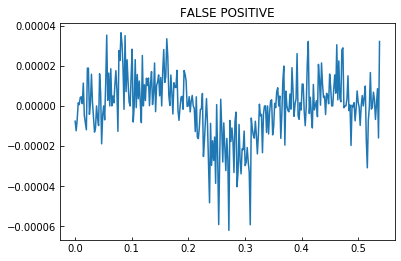

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.283466,1.141733,1.166,4.917,84.66,0.457,0.273,0.318


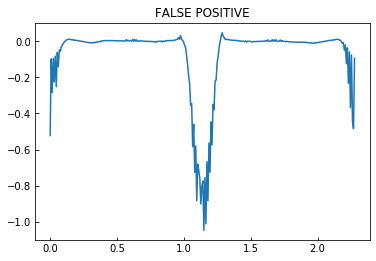

ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.43574,1.21787,0.127,1.105,25.56,0.997,0.235,0.338


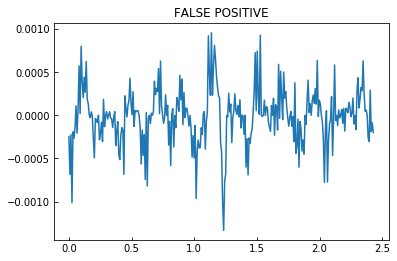

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.404692,0.702346,1.068,3.642,80.56,0.597,0.328,0.306


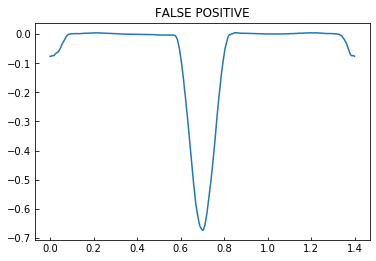

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.453067,3.726533,9.563,28.0,68.35,10.337,0.404,0.262


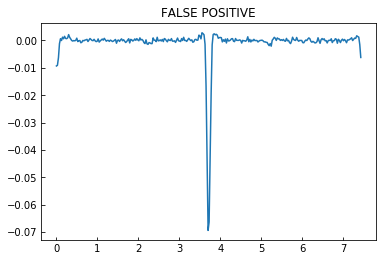

ERROR GENERACION DE CURVA:  Error in elliptic integral function RC().


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.922256,0.461128,0.008,1.042,17.8,0.992,0.413,0.26


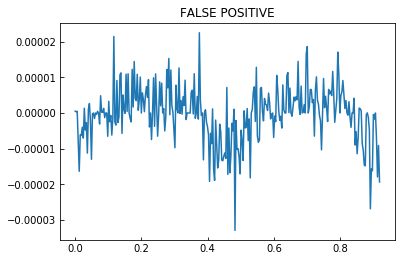

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.513523,10.756762,1.475,2.6,20.29,2.441,0.547,0.171


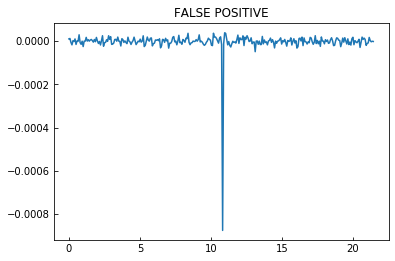

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,25.221893,12.610946,NaN,NaN,NaN,NaN,NaN,NaN


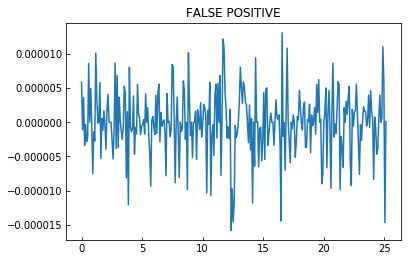

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.973622,0.986811,NaN,NaN,NaN,NaN,NaN,NaN


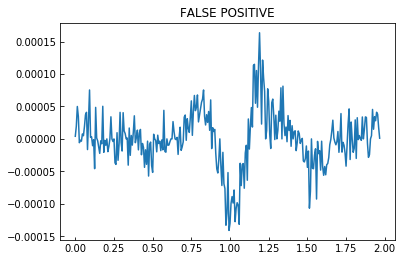

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.948952,0.474476,1.056,3.341,73.32,0.959,0.404,0.262


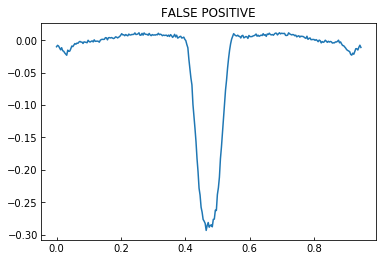

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.912679,1.95634,22.82,53.344,64.31,23.127,0.335,0.306


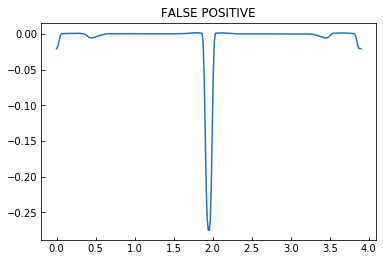

ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.015044,0.507522,0.016,1.013,13.85,0.984,0.351,0.289


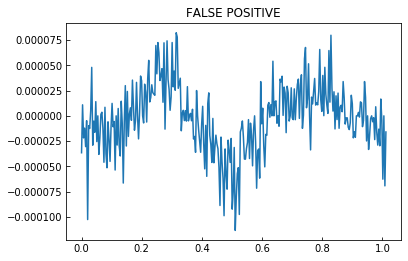

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.8811,1.44055,1.213,5.004,80.47,0.829,0.303,0.272


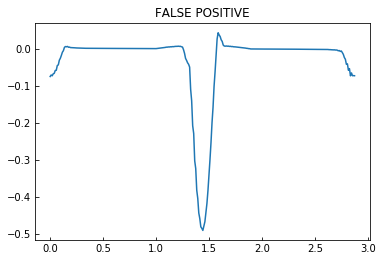

ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.085965,0.542983,0.113,1.09,32.81,0.916,0.128,0.249


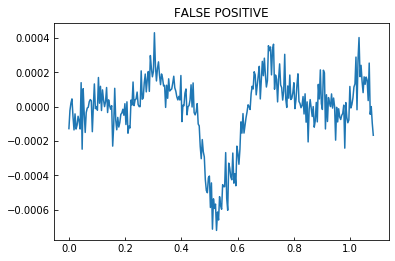

ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.983762,0.491881,0.022,1.02,7.83,1.01,0.292,0.304


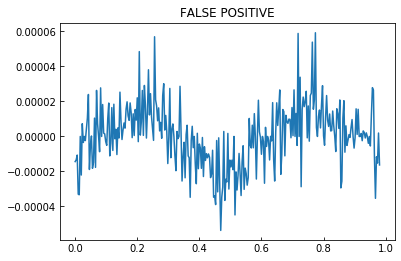

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,178.44973,89.224865,NaN,NaN,NaN,NaN,NaN,NaN


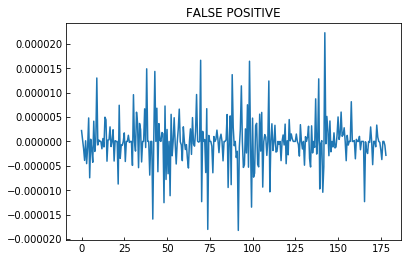

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.4714,1.7357,NaN,NaN,NaN,NaN,NaN,NaN


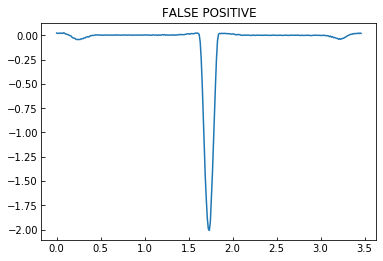

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.37622,3.18811,NaN,NaN,NaN,NaN,NaN,NaN


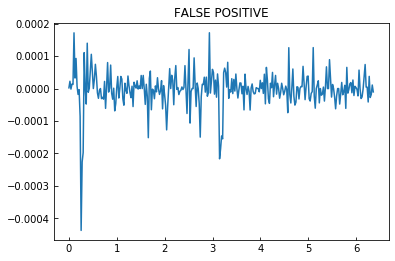

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.282033,3.141017,1.359,9.107,78.75,1.777,0.334,0.296


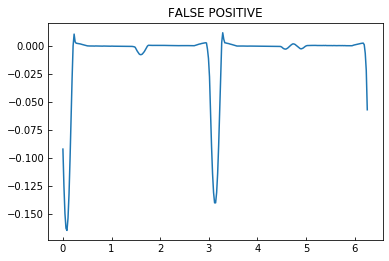

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,16.025019,8.012509,12.407,68.0,78.78,13.239,0.356,0.286


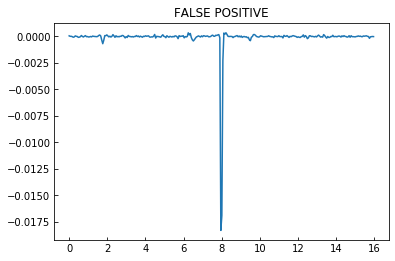

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,13.995854,6.997927,1.248,17.45,83.1,2.095,0.33,0.292


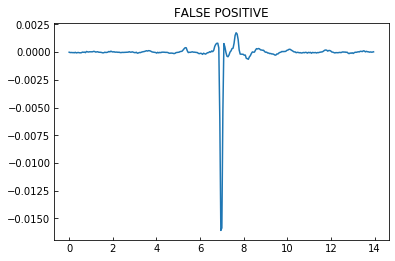

ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.46127,0.730635,0.357,1.352,17.61,1.288,0.454,0.234


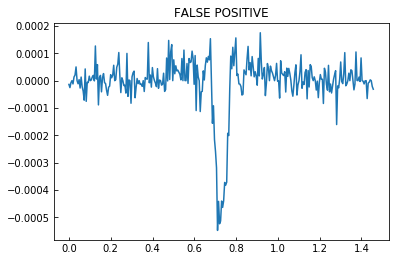

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.722404,1.861202,1.653,13.54,79.9,2.375,0.356,0.286


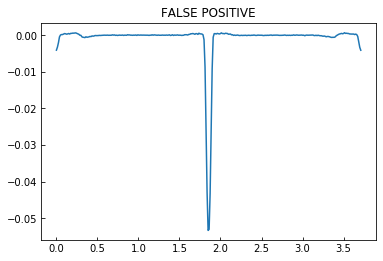

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.161102,0.580551,NaN,NaN,NaN,NaN,NaN,NaN


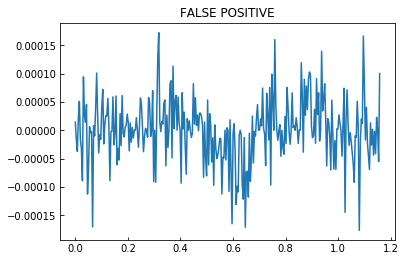

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.112396,1.056198,1.055,9.48,82.21,1.285,0.404,0.262


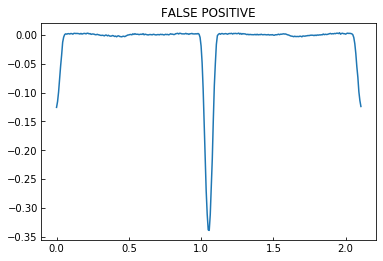

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.23416,1.11708,NaN,NaN,NaN,NaN,NaN,NaN


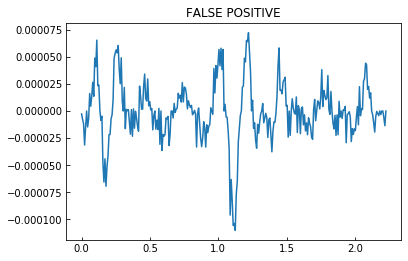

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.878877,0.939438,1.099,4.64,84.55,0.441,0.287,0.307


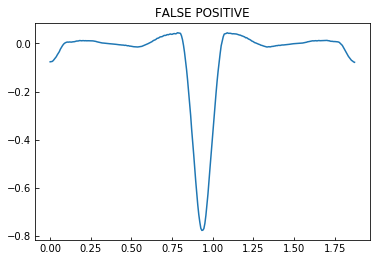

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.154951,0.577475,NaN,NaN,NaN,NaN,NaN,NaN


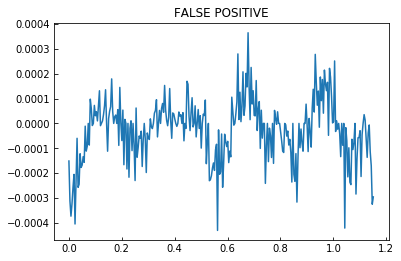

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.086076,1.043038,12.633,22.1,52.67,13.376,0.324,0.298


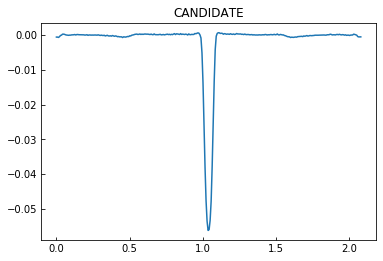

ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.120998,0.560499,0.126,1.124,7.67,1.114,0.271,0.322


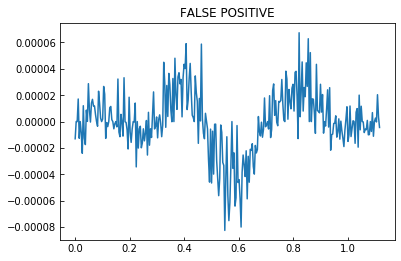

ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.302365,1.151183,0.47,1.457,40.96,1.1,0.359,0.287


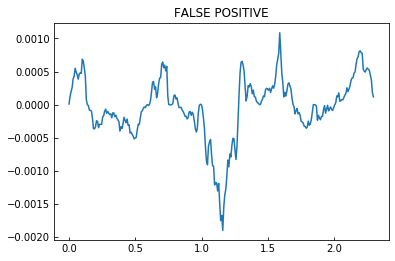

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.632935,1.816467,NaN,NaN,NaN,NaN,NaN,NaN


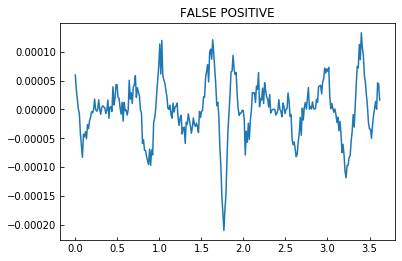

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,94.818136,47.409068,NaN,NaN,NaN,NaN,NaN,NaN


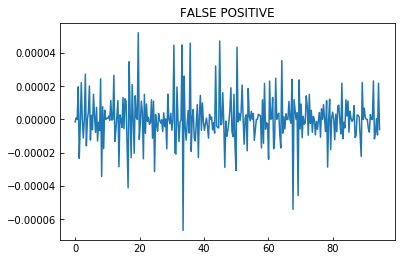

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,49.266785,24.633393,7.446,79.6,83.97,8.364,0.381,0.28


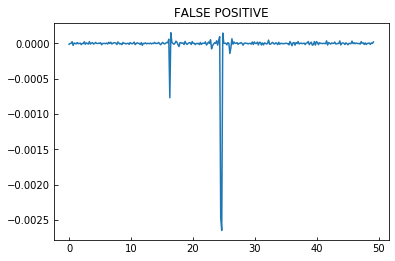

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.674738,0.837369,NaN,NaN,NaN,NaN,NaN,NaN


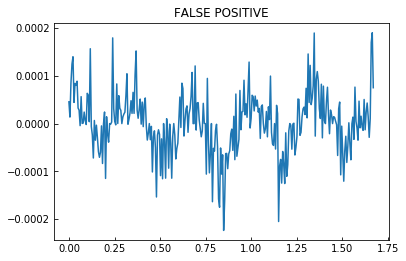

ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.215591,1.607795,0.166,1.163,7.81,1.153,0.307,0.306


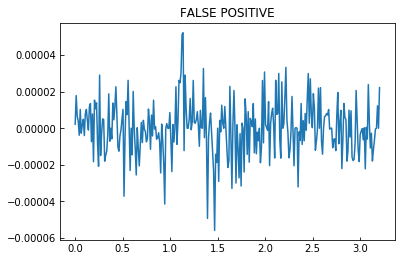

ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.615605,0.807803,0.196,1.154,5.58,1.149,0.274,0.319


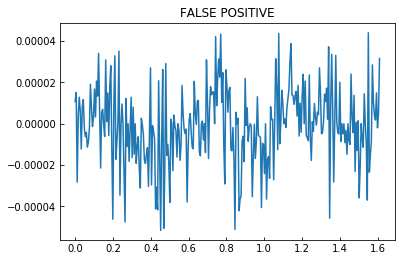

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.568188,0.284094,NaN,NaN,NaN,NaN,NaN,NaN


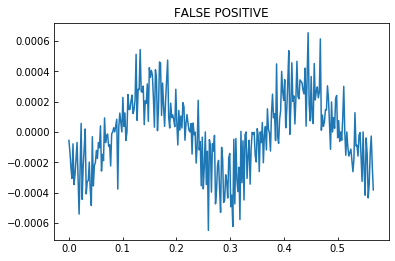

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.009478,0.504739,NaN,NaN,NaN,NaN,NaN,NaN


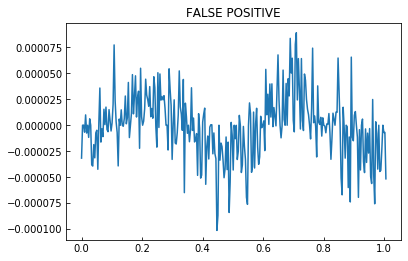

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.35046,2.17523,3.448,19.59,77.61,4.203,0.289,0.31


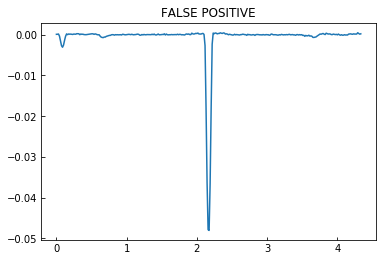

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.195862,3.097931,2.432,11.31,72.61,3.38,0.434,0.243


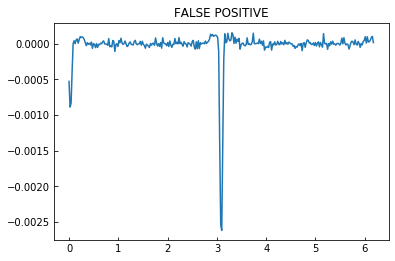

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.656201,0.328101,1.034,2.416,53.45,1.439,0.359,0.287


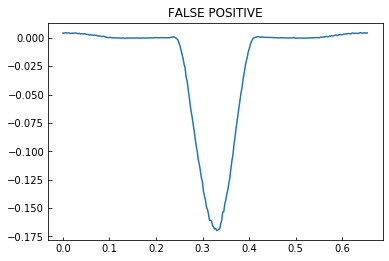

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.35021,1.675105,8.829,14.16,46.93,9.666,0.273,0.318


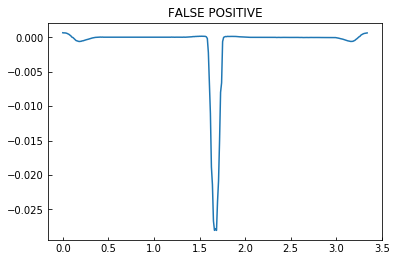

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.910399,2.9552,NaN,NaN,NaN,NaN,NaN,NaN


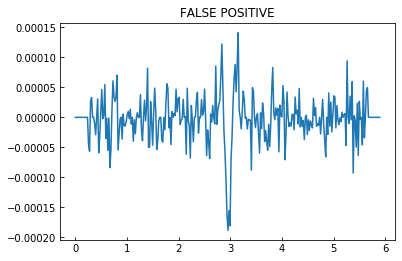

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.735993,1.867997,1.29,3.723,74.53,0.993,0.41,0.259


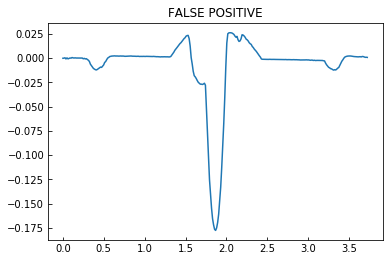

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.638698,0.319349,1.258,2.396,42.83,1.757,0.3,0.314


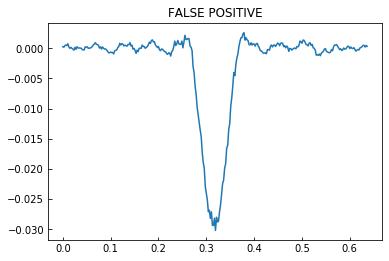

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.852311,7.926155,6.222,88.7,85.93,6.286,0.404,0.262


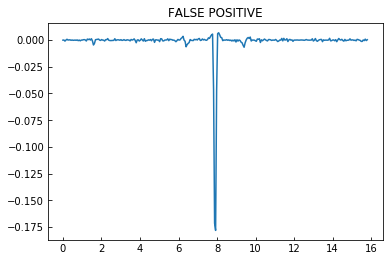

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.774599,0.387299,NaN,NaN,NaN,NaN,NaN,NaN


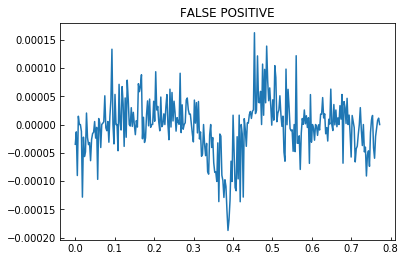

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,24.328225,12.164113,3.452,15.06,72.91,4.426,0.497,0.204


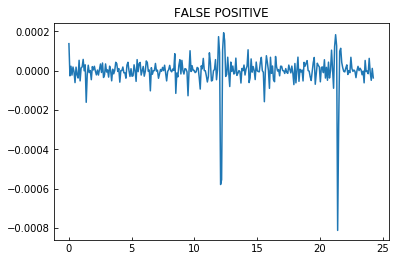

ERROR GENERACION DE CURVA:  Error in elliptic integral function RC().


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.182244,2.091122,0.01,1.436,46.42,0.99,0.324,0.298


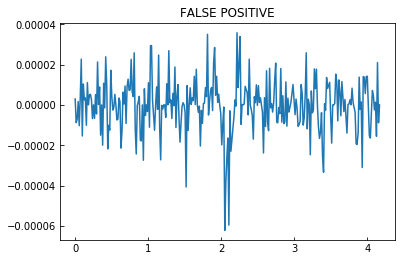

ERROR GENERACION DE CURVA:  Error in elliptic integral function RC().


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,34.650637,17.325318,0.027,8.5,83.42,0.973,0.271,0.322


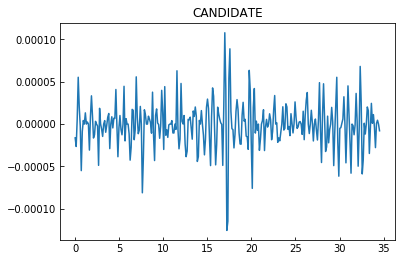

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.869638,1.934819,NaN,NaN,NaN,NaN,NaN,NaN


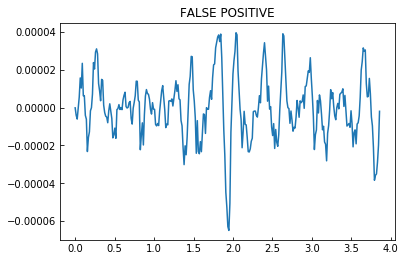

ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.343285,1.671643,0.221,1.218,6.71,1.21,0.293,0.31


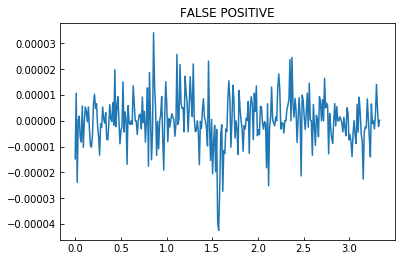

ERROR GENERACION DE CURVA:  Object does not transit the star.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.875197,0.437599,0.004,2.175,62.52,1.004,0.413,0.26


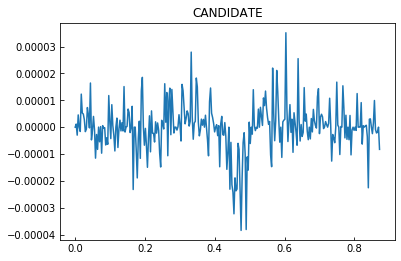

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.739429,0.869714,3.316,5.93,44.32,4.246,0.421,0.252


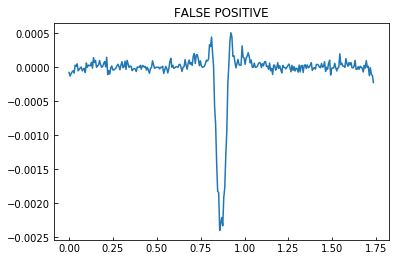

ERROR GENERACION DE CURVA:  Error in elliptic integral function RC().


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.906633,0.953317,0.02,1.671,54.12,0.98,0.273,0.317


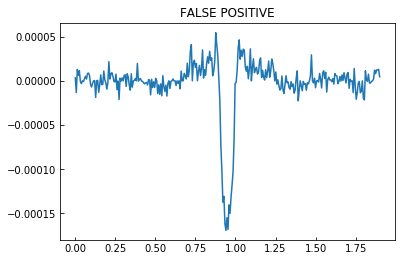

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.063188,2.531594,3.68,9.761,69.62,3.4,0.454,0.234


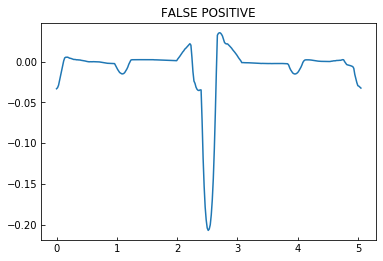

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.576272,0.288136,NaN,NaN,NaN,NaN,NaN,NaN


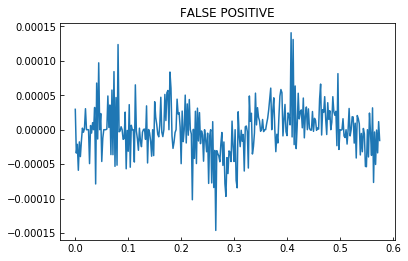

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.401752,1.200876,4.418,12.96,66.1,5.25,0.574,0.155


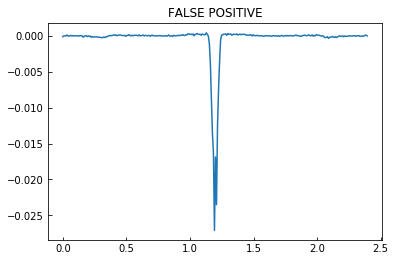

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.873381,7.93669,3.047,32.0,83.8,3.454,0.437,0.243


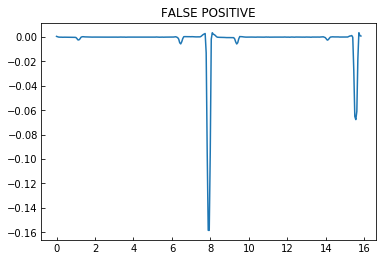

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.541781,7.270891,21.721,58.7,67.71,22.28,0.345,0.292


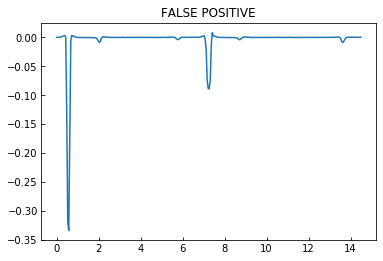

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.224224,2.612112,NaN,NaN,NaN,NaN,NaN,NaN


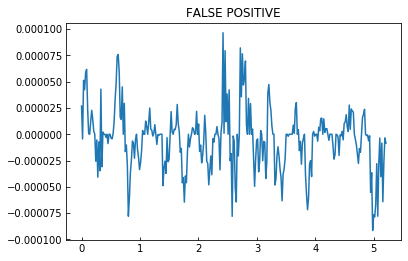

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.34197,10.670985,NaN,NaN,NaN,NaN,NaN,NaN


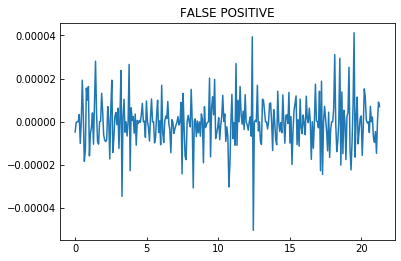

ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.320693,2.160347,0.015,1.015,16.66,0.973,0.319,0.302


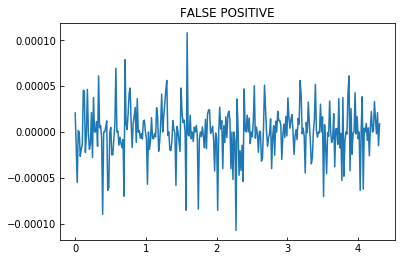

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.080432,1.040216,1.497,5.281,81.6,0.771,0.281,0.28


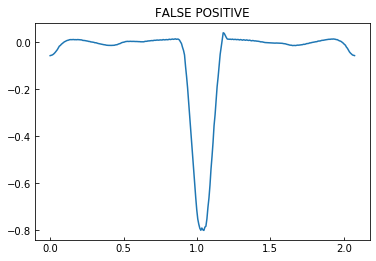

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.080434,1.040217,4.178,5.43,19.79,5.106,0.295,0.31


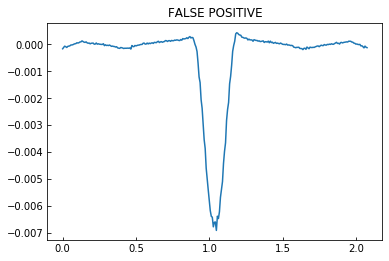

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.395089,0.697544,NaN,NaN,NaN,NaN,NaN,NaN


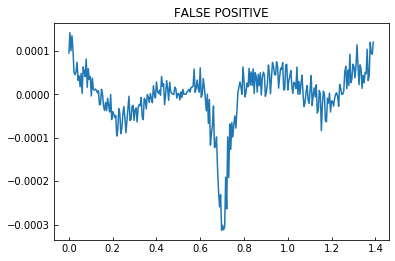

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.920987,0.460494,NaN,NaN,NaN,NaN,NaN,NaN


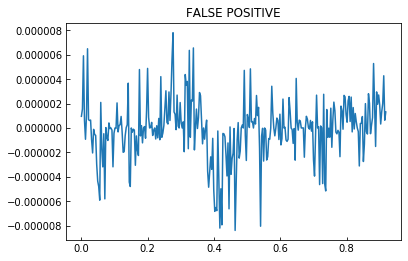

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.715382,0.357691,NaN,NaN,NaN,NaN,NaN,NaN


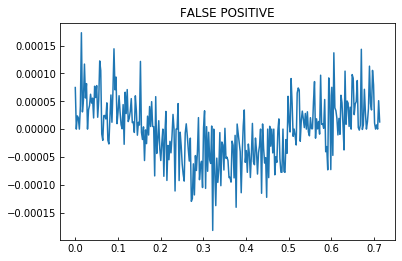

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.043576,3.521788,NaN,NaN,NaN,NaN,NaN,NaN


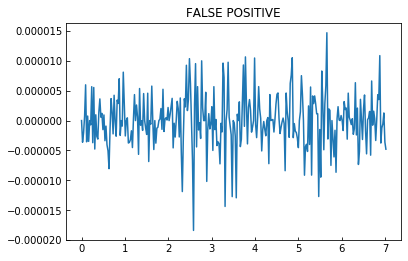

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,16.662167,8.331083,6.607,52.0,81.76,7.444,0.297,0.312


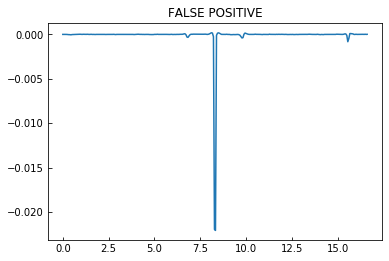

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.702374,3.851187,2.485,15.32,77.38,3.346,0.442,0.24


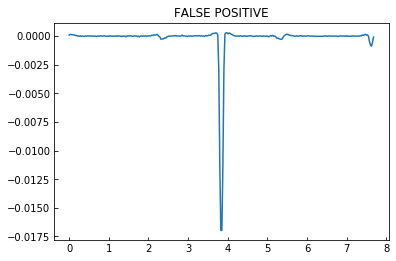

ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566796,0.283398,0.013,1.006,12.68,0.981,0.315,0.303


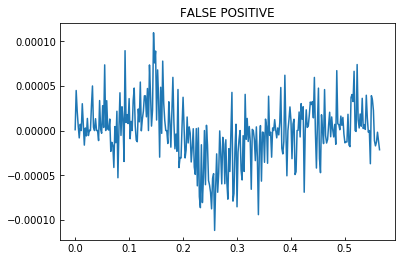

ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566797,0.283398,0.016,1.008,14.79,0.974,0.357,0.366


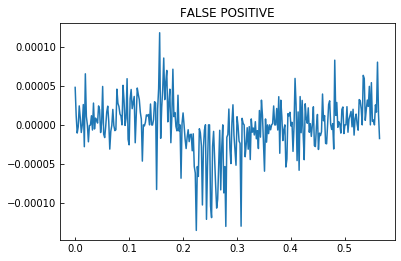

ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566795,0.283397,0.01,1.009,15.15,0.974,0.286,0.312


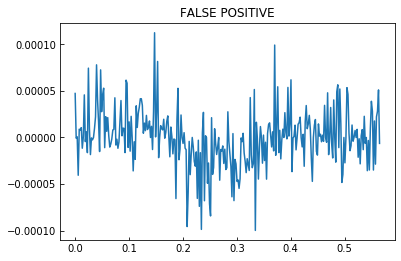

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,33.937542,16.968771,1.188,21.75,84.78,1.979,0.319,0.302


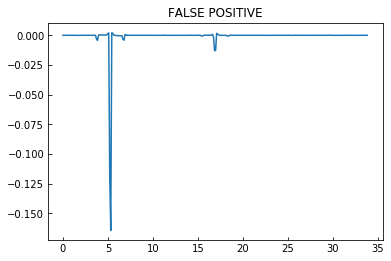

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,29.015853,14.507926,11.513,83.4,81.57,12.223,0.373,0.279


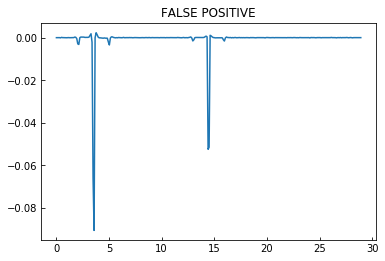

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.9981,3.49905,6.503,38.6,79.0,7.361,0.442,0.24


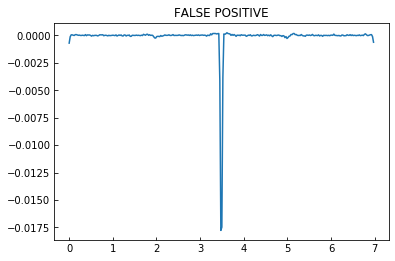

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566802,0.283401,NaN,NaN,NaN,NaN,NaN,NaN


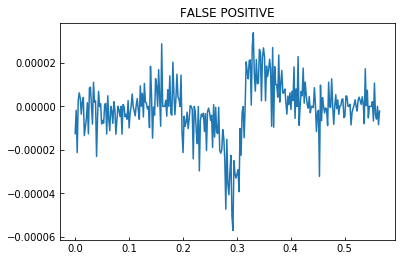

ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566811,0.283405,0.018,1.01,13.58,0.982,0.398,0.267


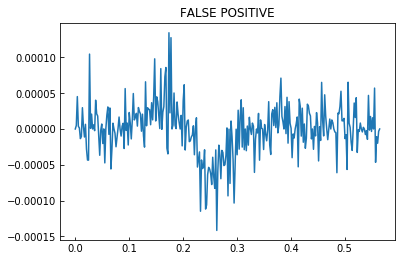

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.50279,2.251395,NaN,NaN,NaN,NaN,NaN,NaN


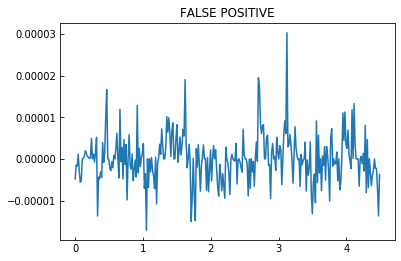

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,44.827324,22.413662,1.198,80.48,88.94,1.494,0.495,0.208


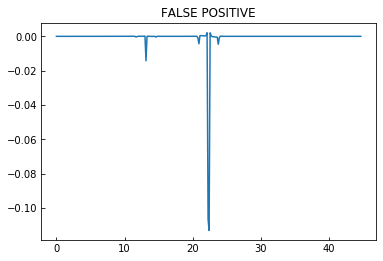

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.174707,2.087354,NaN,NaN,NaN,NaN,NaN,NaN


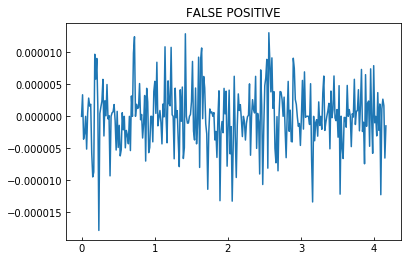

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.947377,1.473688,1.654,3.92,47.65,2.641,0.258,0.309


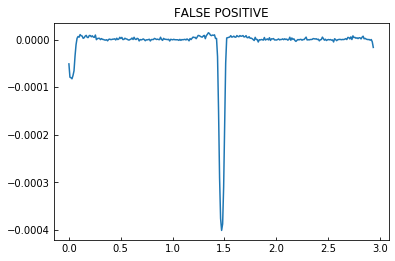

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.37159,1.185795,1.344,8.79,79.15,1.653,0.389,0.279


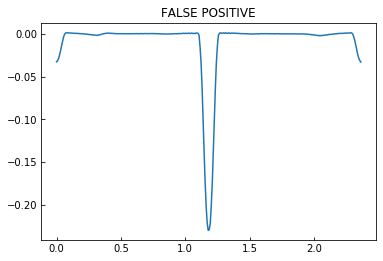

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.794005,8.897002,2.741,13.61,74.13,3.72,0.319,0.302


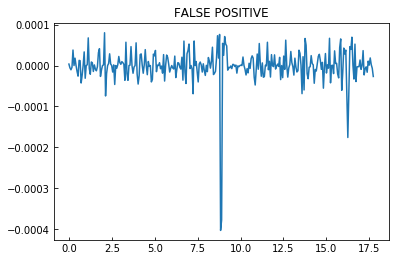

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,121.599128,60.799564,4.104,59.6,85.18,5.011,0.324,0.298


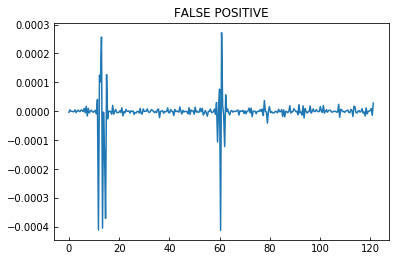

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.113203,1.056601,2.217,3.92,35.77,3.178,0.442,0.24


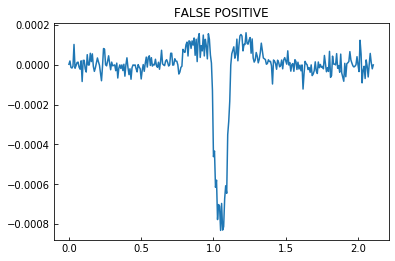

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.226944,3.613472,1.601,5.79,77.71,1.233,0.315,0.302


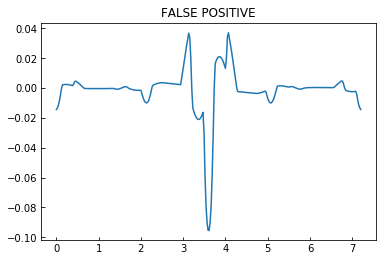

ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.655095,0.327547,0.239,1.236,9.25,1.22,0.366,0.284


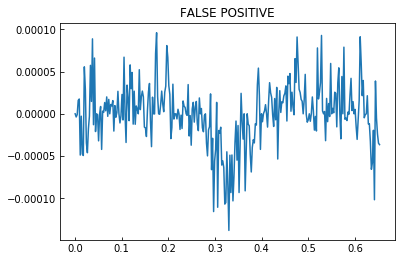

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.332872,1.666436,NaN,NaN,NaN,NaN,NaN,NaN


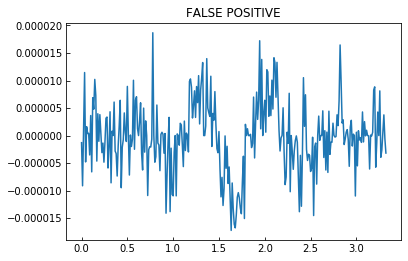

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.804895,0.402448,NaN,NaN,NaN,NaN,NaN,NaN


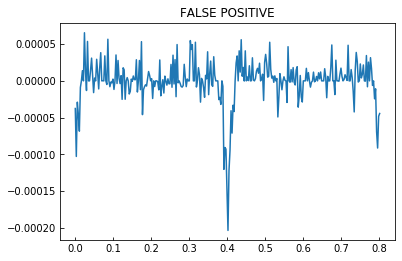

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.286597,0.643299,NaN,NaN,NaN,NaN,NaN,NaN


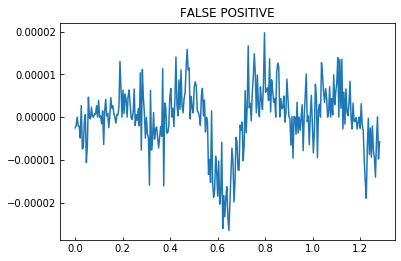

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,46.840086,23.420043,3.72,75.4,86.47,4.652,0.324,0.298


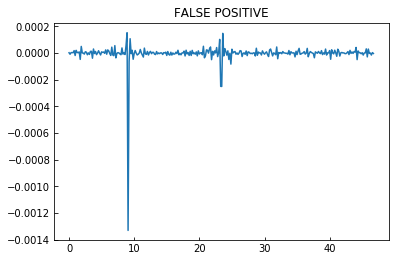

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.607274,1.803637,1.137,4.29,83.8,0.463,0.253,0.326


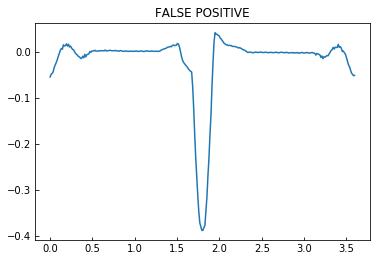

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,35.516192,17.758096,7.565,140.2,86.54,8.467,0.442,0.24


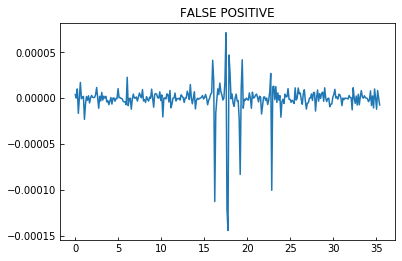

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,16.371987,8.185993,8.359,34.5,74.37,9.303,0.622,0.117


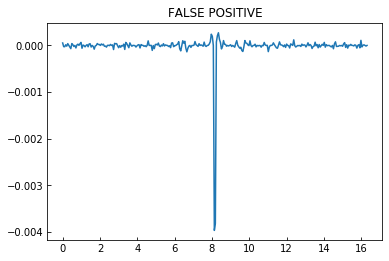

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.389201,1.194601,NaN,NaN,NaN,NaN,NaN,NaN


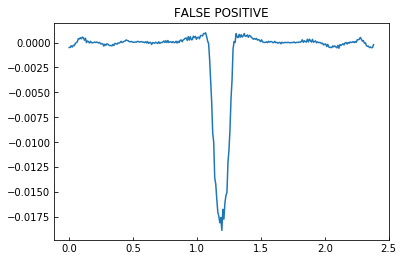

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.634846,0.817423,NaN,NaN,NaN,NaN,NaN,NaN


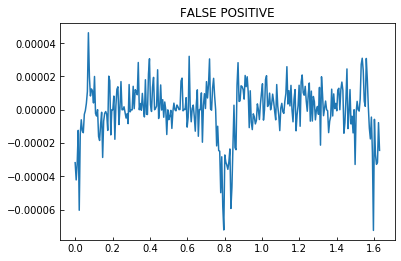

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,200.611033,100.305517,NaN,NaN,NaN,NaN,NaN,NaN


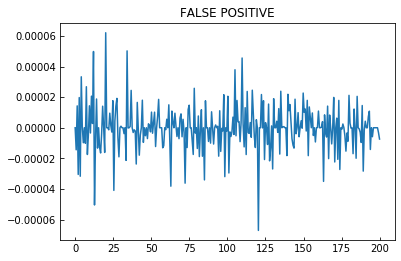

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.5873,0.29365,NaN,NaN,NaN,NaN,NaN,NaN


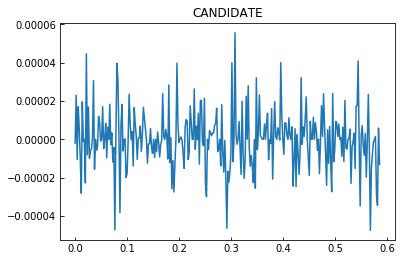

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,85.340926,42.670463,12.009,152.2,85.18,12.773,0.334,0.296


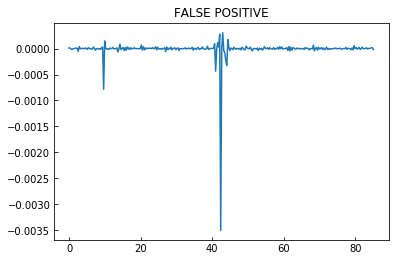

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.641258,0.820629,NaN,NaN,NaN,NaN,NaN,NaN


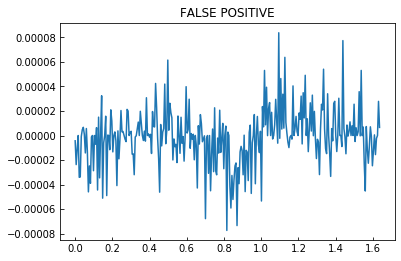

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.84992,10.42496,13.443,54.22,75.35,13.715,0.239,0.334


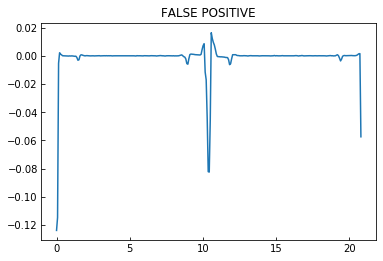

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.23336,5.11668,NaN,NaN,NaN,NaN,NaN,NaN


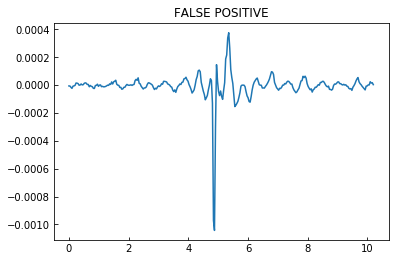

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.232736,5.116368,NaN,NaN,NaN,NaN,NaN,NaN


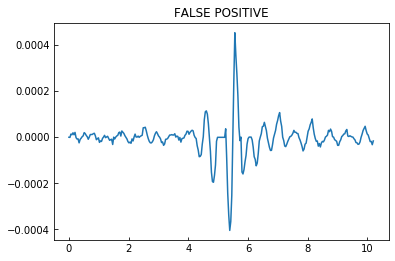

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.617281,1.30864,2.696,3.85,18.64,3.651,0.289,0.31


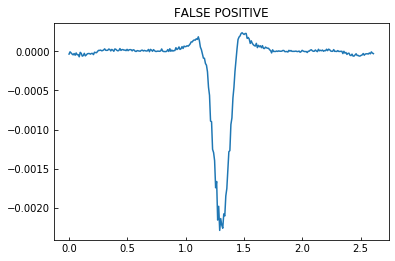

ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.34748,1.17374,0.487,1.473,44.47,1.051,0.351,0.289


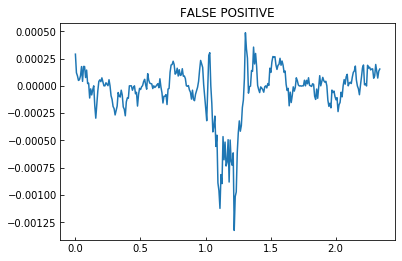

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.888835,2.944418,5.354,16.76,68.22,6.217,0.404,0.262


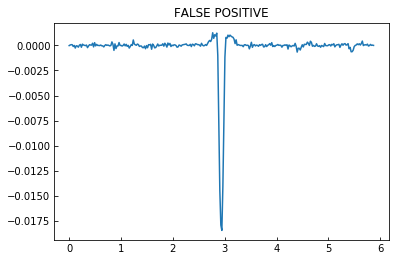

ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.576587,0.788294,0.046,1.044,5.26,1.04,0.27,0.323


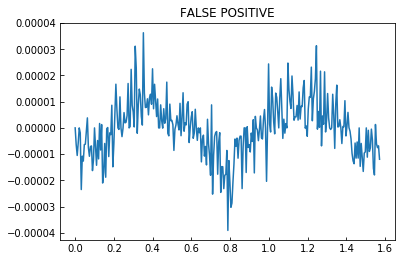

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.811461,0.905731,1.128,3.695,85.2,0.309,0.267,0.28


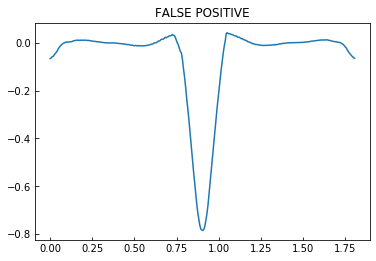

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.174915,1.087458,1.084,4.085,79.86,0.719,0.274,0.319


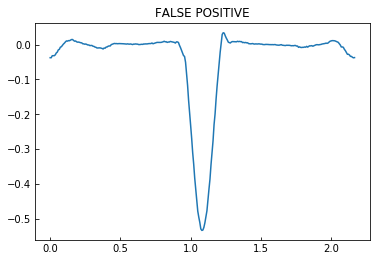

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.12626,0.56313,NaN,NaN,NaN,NaN,NaN,NaN


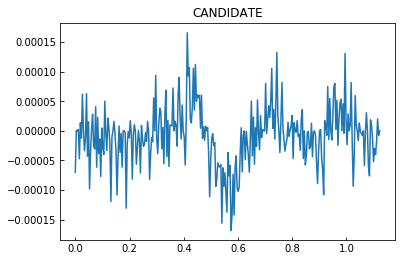

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,138.629025,69.314512,NaN,NaN,NaN,NaN,NaN,NaN


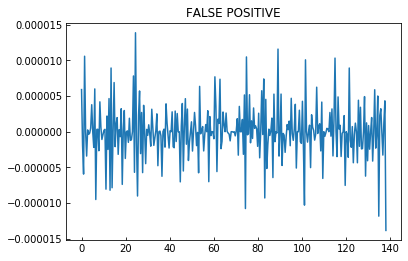

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.926991,7.963495,1.323,19.921,86.06,1.368,0.389,0.279


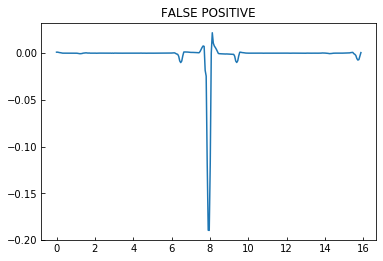

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.645852,0.322926,1.011,4.4,75.01,1.138,0.334,0.325


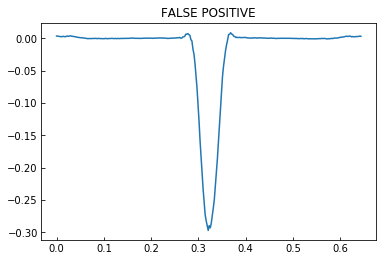

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.876832,0.438416,NaN,NaN,NaN,NaN,NaN,NaN


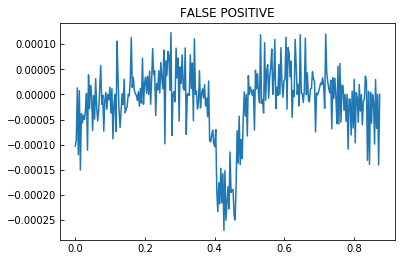

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.383858,0.691929,NaN,NaN,NaN,NaN,NaN,NaN


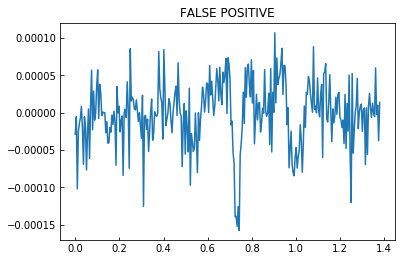

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.274268,4.637134,NaN,NaN,NaN,NaN,NaN,NaN


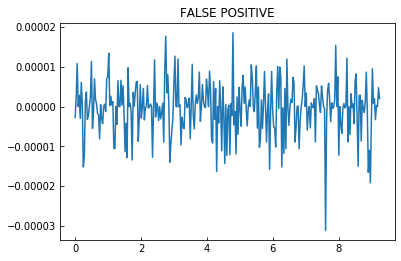

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.309067,2.154534,1.177,13.2,81.32,1.993,0.575,0.15


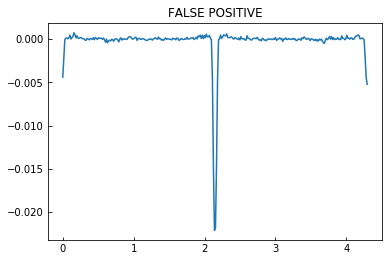

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.122845,0.561423,NaN,NaN,NaN,NaN,NaN,NaN


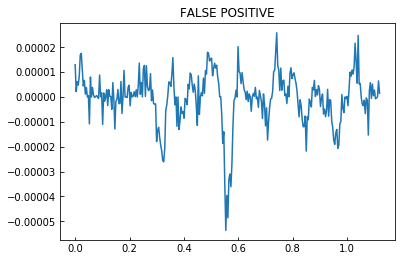

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,77.976212,38.988106,NaN,NaN,NaN,NaN,NaN,NaN


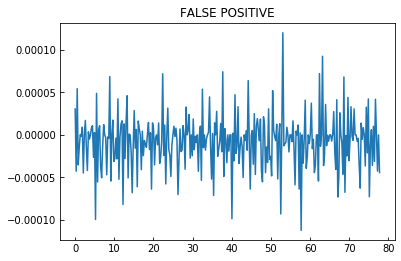

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.247157,0.623578,24.663,30.4,34.03,25.224,0.594,0.139


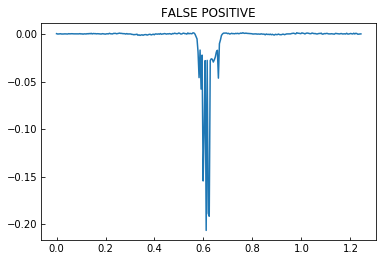

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.55651,1.778255,1.069,4.411,81.9,0.622,0.298,0.28


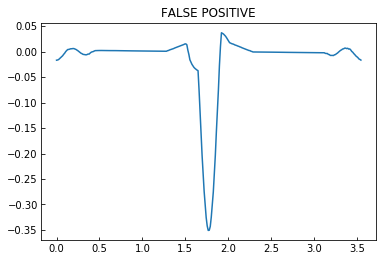

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.332115,1.166058,1.174,8.0,77.38,1.747,0.287,0.307


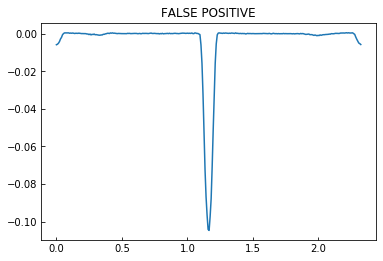

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.661896,1.830948,2.16,3.178,21.39,2.959,0.277,0.309


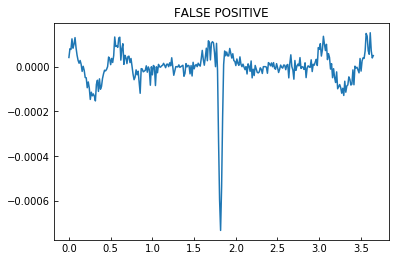

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.427232,10.213616,4.912,98.0,86.78,5.499,0.319,0.302


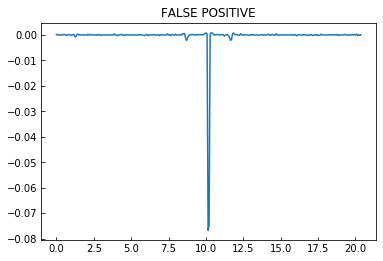

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.873664,3.436832,NaN,NaN,NaN,NaN,NaN,NaN


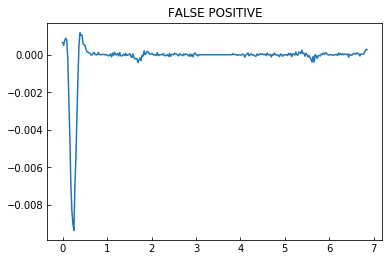

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.394518,2.197259,1.247,18.41,85.12,1.566,0.316,0.387


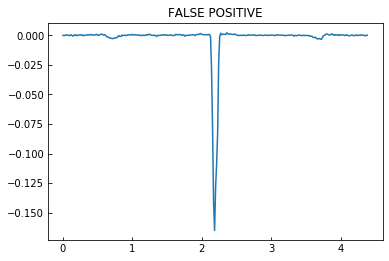

ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.53021,1.265105,0.293,1.288,8.13,1.275,0.382,0.274


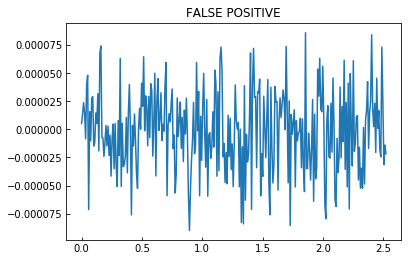

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.331993,0.665996,NaN,NaN,NaN,NaN,NaN,NaN


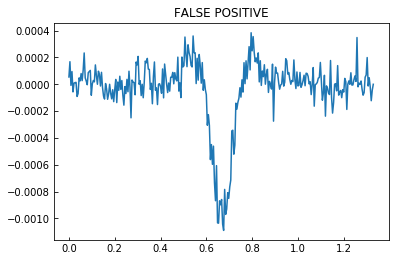

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.73399,1.366995,NaN,NaN,NaN,NaN,NaN,NaN


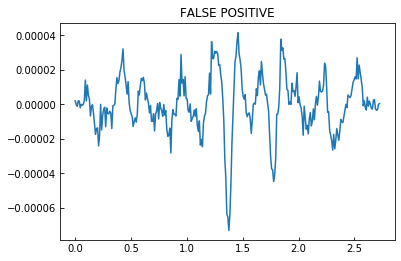

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.096587,0.548294,1.64,2.75,17.79,2.623,0.41,0.26


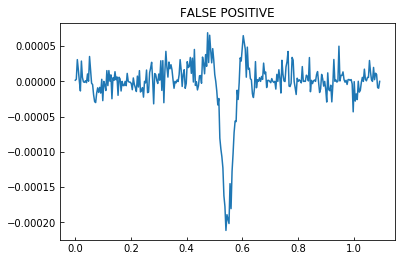

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,158.348345,79.174173,2.676,45.2,85.36,3.655,0.303,0.316


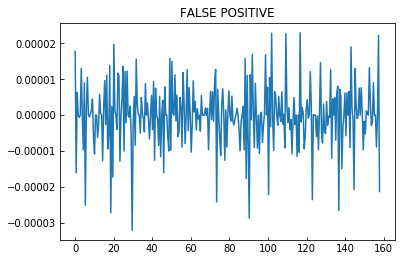

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.45393,3.726965,NaN,NaN,NaN,NaN,NaN,NaN


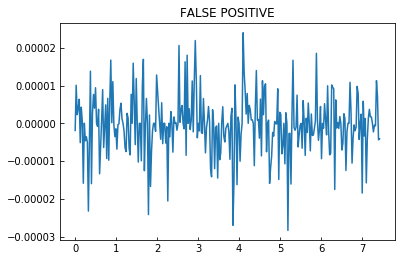

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.061151,3.530575,1.856,7.02,66.27,2.824,0.386,0.271


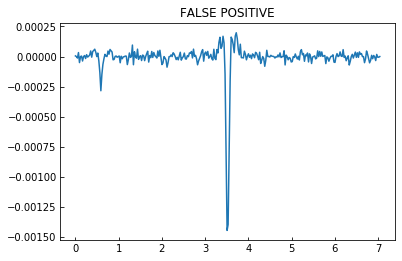

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.103978,0.551989,NaN,NaN,NaN,NaN,NaN,NaN


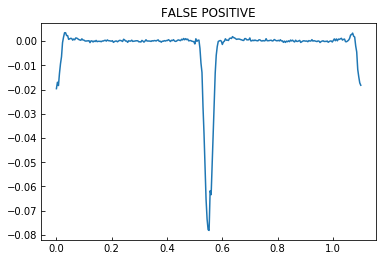

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.726754,4.863377,3.746,5.62,33.72,4.676,0.317,0.303


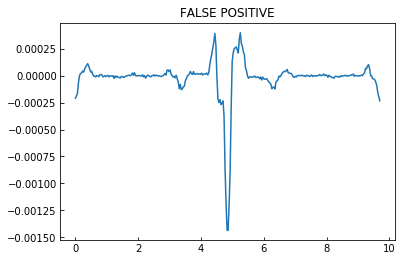

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.726749,4.863374,1.807,8.274,76.84,1.883,0.437,0.243


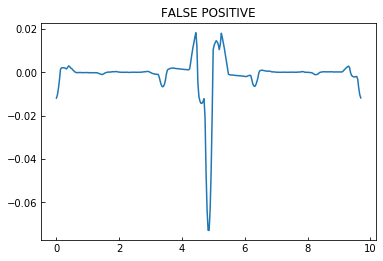

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.296746,4.648373,1.271,16.509,84.36,1.623,0.289,0.312


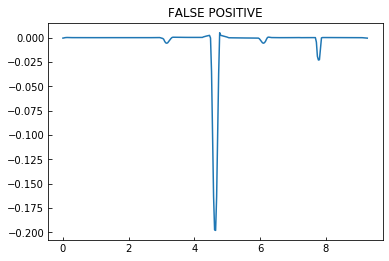

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.934207,0.467103,NaN,NaN,NaN,NaN,NaN,NaN


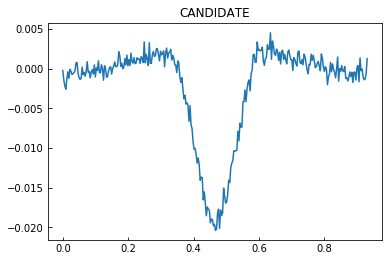

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.008255,1.504127,NaN,NaN,NaN,NaN,NaN,NaN


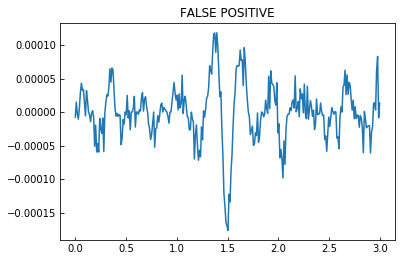

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.521446,5.760723,1.625,20.75,83.13,2.483,0.386,0.271


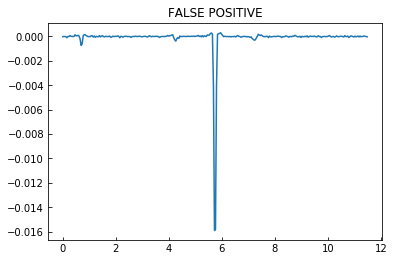

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,87.140633,43.570316,NaN,NaN,NaN,NaN,NaN,NaN


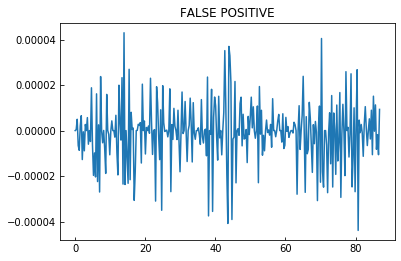

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.855816,0.427908,NaN,NaN,NaN,NaN,NaN,NaN


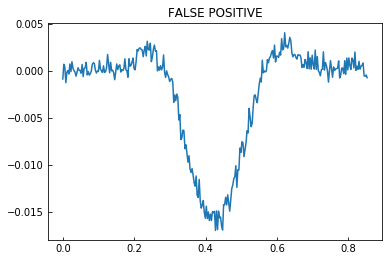

ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.427966,0.713983,0.396,1.383,19.36,1.305,0.334,0.296


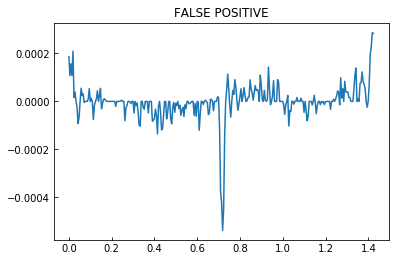

ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.948086,0.474043,0.121,1.12,9.31,1.105,0.273,0.329


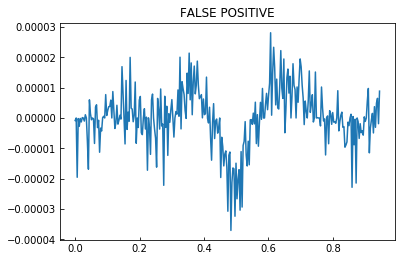

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.371797,1.685898,3.075,19.04,80.26,3.219,0.434,0.243


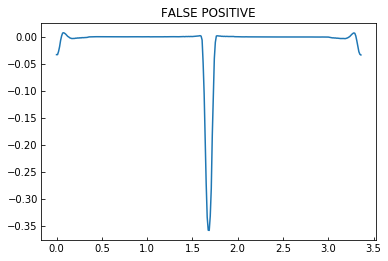

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.842939,3.421469,NaN,NaN,NaN,NaN,NaN,NaN


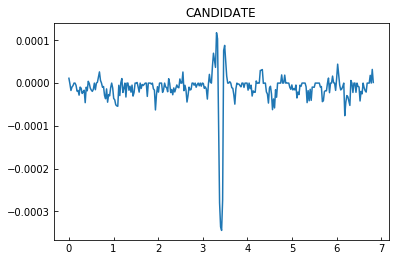

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.668483,0.334242,1.271,4.754,80.64,0.773,0.404,0.262


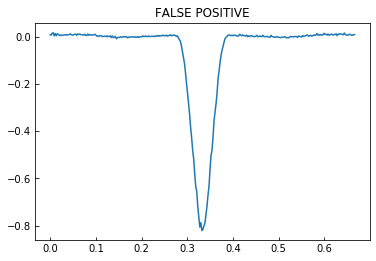

ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.213185,1.606593,0.05,1.019,24.96,0.924,0.271,0.318


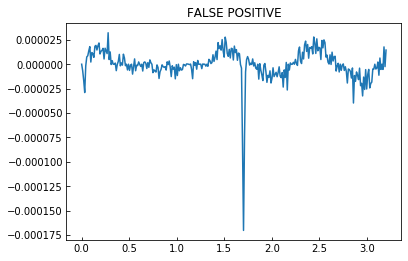

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.002808,1.001404,NaN,NaN,NaN,NaN,NaN,NaN


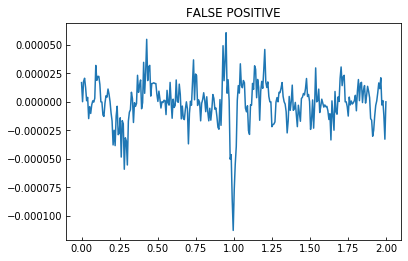

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.269177,1.634588,1.485,10.93,78.42,2.195,0.307,0.306


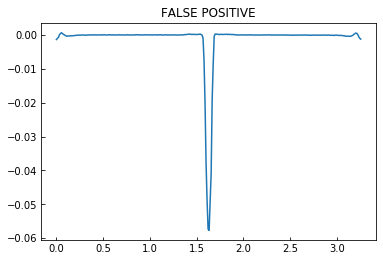

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.344105,4.172052,9.139,49.2,78.22,10.047,0.46,0.229


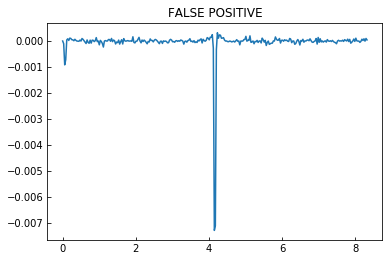

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.053254,2.026627,14.708,30.7,60.02,15.329,0.366,0.284


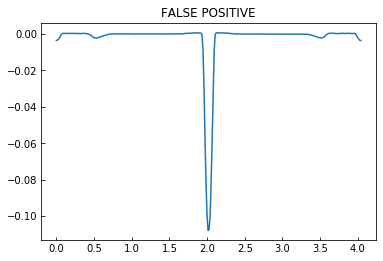

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.42809,4.214045,5.886,40.4,80.33,6.787,0.373,0.279


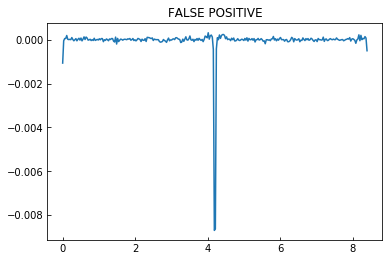

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.589393,7.294696,NaN,NaN,NaN,NaN,NaN,NaN


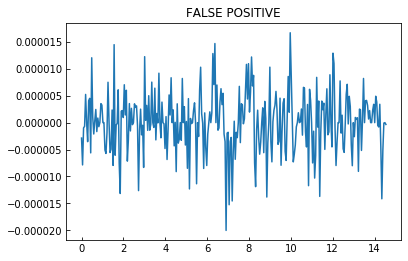

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.699207,10.349604,NaN,NaN,NaN,NaN,NaN,NaN


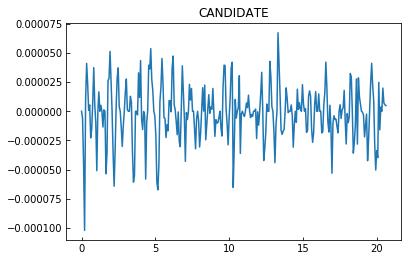

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.719573,0.359786,NaN,NaN,NaN,NaN,NaN,NaN


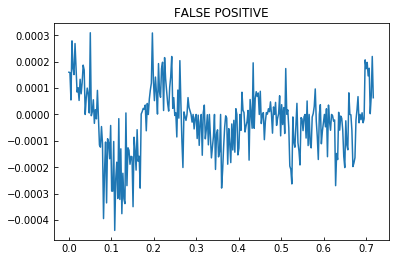

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.096031,3.048015,1.384,5.984,83.84,0.642,0.219,0.342


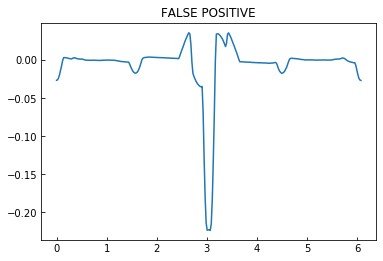

ERROR GENERACION DE CURVA:  Error in elliptic integral function RC().


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.937206,2.968603,0.024,3.033,71.23,0.976,0.312,0.308


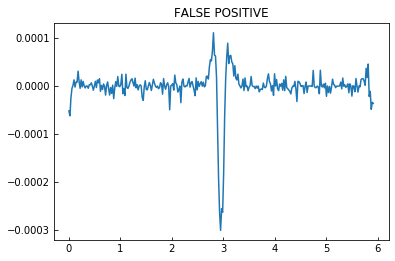

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.937177,2.968589,5.442,13.66,62.62,6.282,0.404,0.262


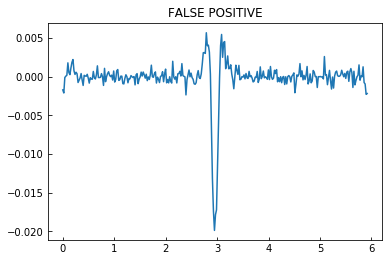

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.865959,0.43298,2.821,8.58,69.06,3.068,0.221,0.4


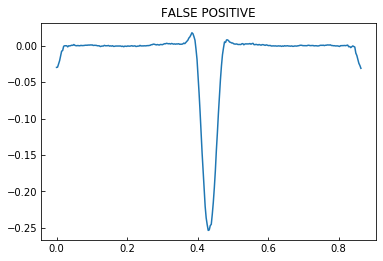

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.603179,0.80159,NaN,NaN,NaN,NaN,NaN,NaN


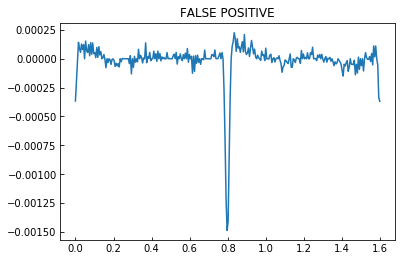

ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.907665,8.953832,2.488,51.36,86.89,2.79,0.324,0.303


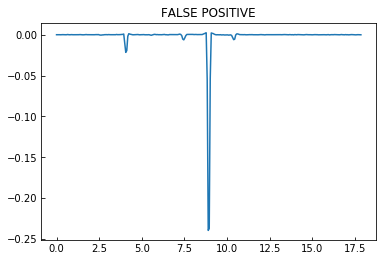

ERROR GENERACION DE CURVA:  Bad value for the limb darkening coefficients.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.595865,0.297932,NaN,NaN,NaN,NaN,NaN,NaN


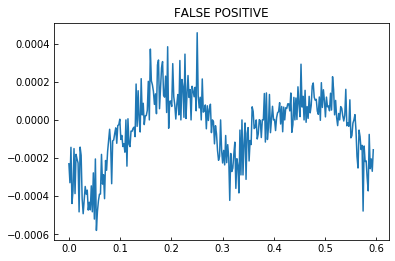

CPU times: user 32.3 s, sys: 504 ms, total: 32.8 s
Wall time: 32.6 s


In [147]:
%%time
for i in range(df_meta_obj.shape[0]):
    t_glo = np.cumsum(X_fold_time[i])
    
    metadata_n = df_meta_obj.iloc[i]
    sim_dat = {v: metadata_n[v] for v in MA_sim_names if v != "T0"} #get metadata
    sim_dat["T0"] = t_glo[int(np.round(len(t_glo)/2))] #trabajando con folds global ...
    
    lc_simulated = simulate_MA(t_glo, sim_dat, lib='ps', plot_m=False)
    
    if (np.max(lc_simulated) == np.min(lc_simulated)) and (np.min(lc_simulated) == 1): 
        plt.plot(t_glo, X_fold_lc[i])
        plt.title(df_meta.iloc[i]["NExScI Disposition"])
        plt.show()
        continue
    #    print("ERROR, CURVA ELIMINADO DE INMEDIATO")

Tipo de errores (Son todos Falsos o candidatos):
* *Bad value for ``RpRs`*: radio de planeta sobre radio estrella mayor a 1 (planeta mas grande que estrella)
* *Error in elliptic integral function RC()*: Error numérico en 
    * Carlson's degenerate elliptic integral
        (C) Copr. 1986-92 Numerical Recipes Software "U,6VV'.
* *Star-crossing orbit*: Si el radio del planeta + 1 (radio de estrella) es mayor al semi major axis (distancia planeta-estrella) -- orbita se cruza con la estrella? 
* *Object does not transit the star*: ? quizas en los tiempos de modelación no alcanza a aparecer un tránsito (tránsito muy rápido, con tiempo corto)

In [ ]:
%%time
for i in range(df_meta_obj.shape[0]):
    t_glo = np.cumsum(X_fold_time[i])
    
    metadata_n = df_meta_obj.iloc[i]
    #Simular MA
    sim_dat = {v: metadata_n[v] for v in MA_sim_names if v != "T0"} #get metadata
    sim_dat["T0"] = t_glo[int(np.round(len(t_glo)/2))] #trabajando con folds global ...
    
    lc_simulated = simulate_MA(t_glo, sim_dat, lib='pytransit', plot_m=False)
    
    if (np.max(lc_simulated) == np.min(lc_simulated)) and (np.min(lc_simulated) == 1): 
        plt.plot(t_glo, X_fold_lc[i])
        plt.title(df_meta.iloc[i]["NExScI Disposition"])
        plt.show()
        continue
    #    print("ERROR, CURVA ELIMINADO DE INMEDIATO")

In [ ]:
%%time
for i in range(df_meta_obj.shape[0]):
    t_glo = np.cumsum(X_fold_time[i])
    
    metadata_n = df_meta_obj.iloc[i]
    #Simular MA
    sim_dat = {v: metadata_n[v] for v in MA_sim_names if v != "T0"} #get metadata
    sim_dat["T0"] = t_glo[int(np.round(len(t_glo)/2))] #trabajando con folds global ...
    
    lc_simulated = simulate_MA(t_glo, sim_dat, lib='pylc', plot_m=False)
    
    if (np.max(lc_simulated) == np.min(lc_simulated)) and (np.min(lc_simulated) == 1): 
        plt.plot(t_glo, X_fold_lc[i])
        plt.title(df_meta.iloc[i]["NExScI Disposition"])
        plt.show()
        continue
    #    print("ERROR, CURVA ELIMINADO DE INMEDIATO")

>   #### PyTransit

|Periodo|T0|Planet Radius|Orbital Radius| Inclination| Limb coefs| Impact parameter| Duration| stellar dens|
|---|---|---|---|---|---|---|---|---|
|$\checkmark$|$\checkmark$|$\checkmark$|$\checkmark$|$\checkmark$|$\checkmark$|dep|dep|dep|

In [38]:
%%time

X_MA = []

for i in range(df_meta_obj.shape[0]):
    #load time to simulate
    t_glo = np.cumsum(X_fold_time[i])
    
    metadata_n = df_meta_obj.iloc[i]
    #Simular MA
    sim_dat = {v: metadata_n[v] for v in MA_sim_names if v != "T0"} #get metadata
    sim_dat["T0"] = t_glo[int(np.round(len(t_glo)/2))] #trabajando con folds global ...
    
    lc_simulated = simulate_MA(t_glo, sim_dat, lib='pytransit', plot_m=False)
    
    X_MA.append(lc_simulated)
    
X_MA = np.asarray(X_MA)
X_MA.shape

ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.460439,4.230219,0.478,14.087,85.68,1.061,0.299,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,161.788327,80.894164,0.273,289.8,89.95,0.267,0.373,0.283


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.592634,0.796317,0.519,2.046,64.63,0.877,0.293,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.252418,1.126209,0.456,7.32,80.57,1.198,0.424,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.629001,0.314501,0.004,3.61,84.2,0.365,0.273,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.419758,0.709879,0.008,5.93,83.77,0.644,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.975209,0.987604,0.008,8.4,86.18,0.559,0.293,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.098963,5.049482,0.007,10.31,87.06,0.529,0.32,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.963842,1.481921,0.346,3.62,73.0,1.059,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.126012,3.063006,0.006,24.7,89.02,0.422,0.372,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,77.362415,38.681207,0.483,53.602,88.94,0.995,0.497,0.204


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,145.562493,72.781246,0.336,82.2,89.11,1.274,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.764598,0.382299,0.004,4.965,86.02,0.345,0.324,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.564614,1.782307,0.472,8.705,83.47,0.989,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.573611,10.286806,0.008,14.12,89.87,0.032,0.464,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,27.249752,13.624876,0.009,17.77,89.37,0.194,0.464,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.81154,3.90577,0.304,3.17,66.38,1.271,0.477,0.217


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.967428,0.483714,0.375,1.485,32.82,1.248,0.551,0.165


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,116.521432,58.260716,0.288,42.9,88.32,1.26,0.353,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.283466,1.141733,1.166,4.917,84.66,0.457,0.273,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.781139,2.39057,0.009,13.41,89.49,0.118,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.101595,2.050798,0.579,7.908,87.14,0.394,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.096939,4.04847,0.442,25.97,88.27,0.786,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.813438,0.906719,0.009,1.775,76.37,0.418,0.54,0.173


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.609654,4.304827,0.007,29.2,89.58,0.213,0.446,0.241


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.542123,0.271061,0.009,3.29,88.11,0.108,0.419,0.256


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.404692,0.702346,1.068,3.642,80.56,0.597,0.328,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.681138,0.340569,0.485,2.449,66.72,0.968,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.306983,5.153491,0.611,10.451,86.91,0.564,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,204.032934,102.016467,0.652,140.0,89.8,0.49,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.983305,0.491652,0.008,3.815,82.82,0.477,0.334,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.109842,0.554921,0.507,1.841,86.26,0.12,0.389,0.273


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.838514,0.919257,0.5,5.145,79.4,0.947,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,54.356351,27.178175,0.283,37.79,88.27,1.142,0.324,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.531619,4.26581,0.5,22.1,87.1,1.118,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.187087,1.593544,0.359,4.074,80.61,0.665,0.673,0.09


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,18.798622,9.399311,0.634,29.73,88.99,0.524,0.509,0.196


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.234966,3.617483,0.391,10.098,86.89,0.548,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.476427,10.738214,0.545,45.679,89.99,0.006,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.453067,3.726533,9.563,28.0,68.35,10.337,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.442941,1.221471,0.441,4.0,73.07,1.164,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.442957,1.221479,0.406,3.3,67.88,1.242,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.315778,1.657889,0.3,6.849,84.7,0.633,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.43377,0.716885,0.319,2.46,58.99,1.268,0.353,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.192009,1.096005,0.292,2.28,56.89,1.248,0.453,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.192004,1.096002,0.501,6.195,80.68,1.003,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.856895,0.428448,0.009,4.28,82.56,0.554,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,49.788613,24.894307,0.55,69.489,89.38,0.753,0.508,0.224


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.412009,4.206004,0.354,14.782,87.91,0.539,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,175.065861,87.53293,0.454,263.8,89.75,1.149,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.944046,2.472023,0.497,9.678,84.28,0.964,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.648868,0.324434,0.435,1.93,52.61,1.172,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.546248,0.273124,0.497,2.58,68.45,0.946,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.523299,0.761649,0.412,2.809,81.62,0.41,0.497,0.204


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,45.582712,22.791356,0.008,106.4,89.86,0.253,0.239,0.334


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.891293,0.945647,0.005,2.466,81.3,0.373,0.551,0.165


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.891245,0.945622,0.005,2.125,69.79,0.734,0.308,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.891285,0.945643,0.259,1.446,32.77,1.216,0.627,0.108


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.005997,3.002998,0.006,14.78,89.48,0.135,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.09506,2.54753,0.005,5.02,82.09,0.691,0.27,0.323


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.70258,3.35129,0.27,3.45,68.98,1.237,0.594,0.139


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,205.583331,102.791665,0.427,195.0,89.64,1.215,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,87.878262,43.939131,0.618,79.062,89.58,0.585,0.372,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.592563,0.296281,0.296,1.359,22.94,1.252,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.209539,3.10477,0.006,16.52,88.93,0.308,0.867,-0.058


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.926633,7.963316,0.579,23.421,88.36,0.672,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.958117,0.479058,0.33,1.749,43.19,1.275,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,39.841523,19.920761,0.515,42.183,88.77,0.902,0.359,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.922256,0.461128,0.008,1.042,17.8,0.992,0.413,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.70274,0.35137,0.008,2.79,74.58,0.742,0.509,0.196


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.094066,3.047033,0.3,9.11,82.21,1.235,0.273,0.329


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.513523,10.756762,1.475,2.6,20.29,2.441,0.547,0.171


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.692808,0.346404,0.425,3.031,66.75,1.196,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.891274,0.945637,0.005,2.872,79.69,0.514,0.305,0.272


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.891268,0.945634,0.786,3.292,86.81,0.183,0.163,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.891259,0.945629,0.008,2.15,71.65,0.677,0.285,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.89125,0.945625,0.271,1.356,23.83,1.24,0.575,0.15


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.891242,0.945621,0.009,3.295,86.55,0.198,0.532,0.183


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.891299,0.945649,0.009,2.148,71.02,0.699,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,52.884577,26.442289,0.409,31.0,87.65,1.272,0.286,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.020878,0.510439,0.005,3.248,87.39,0.148,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.429439,0.71472,0.363,2.3,55.59,1.298,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.858879,1.42944,0.29,2.77,62.89,1.262,0.547,0.178


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.858899,1.42945,0.009,5.7,80.54,0.936,0.575,0.15


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,18.384953,9.192476,0.009,23.95,89.97,0.012,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.279291,8.639645,0.385,33.642,89.16,0.496,0.389,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.371289,0.685644,0.009,2.59,68.41,0.953,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.540389,0.770195,0.008,7.07,89.65,0.043,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.209231,1.104616,0.007,7.088,89.11,0.11,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.812898,2.906449,0.008,9.8,87.08,0.499,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,25.003202,12.501601,0.008,23.2,88.13,0.756,0.32,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.718409,1.859204,0.008,7.81,88.59,0.192,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.961309,5.980654,0.602,29.128,88.79,0.616,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.894947,1.447474,0.006,6.742,88.38,0.191,0.256,0.326


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.055693,0.527846,0.005,6.27,88.81,0.131,0.557,0.161


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.974303,0.487152,0.438,3.219,68.71,1.169,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.629871,1.314935,0.322,3.536,78.5,0.705,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.947555,0.473777,0.007,6.66,89.51,0.058,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.686994,0.343497,0.323,1.416,27.08,1.261,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.627612,3.313806,0.564,11.326,86.19,0.753,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.199381,1.59969,0.008,13.5,88.86,0.268,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.794373,1.897186,0.008,12.77,89.78,0.05,0.429,0.247


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,420.929204,210.464602,0.48,195.95,89.7,1.033,0.286,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,28.59788,14.29894,0.275,34.655,89.41,0.356,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.244779,3.622389,0.298,19.446,88.46,0.522,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.244761,3.622381,0.007,24.06,89.9,0.04,0.509,0.196


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,13.554805,6.777403,0.006,39.6,89.28,0.497,0.509,0.196


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.029803,2.014902,0.404,9.721,89.0,0.17,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,30.476519,15.238259,0.609,34.022,88.99,0.6,0.453,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,30.476399,15.238199,0.501,15.396,86.57,0.92,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,13.782522,6.891261,0.574,17.844,87.69,0.718,0.389,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.202539,2.101269,0.006,2.39,66.9,0.937,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.254247,1.627123,0.009,3.6,79.35,0.665,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.875476,2.437738,0.006,19.63,89.75,0.084,0.455,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.399048,1.699524,0.008,7.26,85.3,0.596,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.891217,0.945608,0.008,2.68,81.32,0.404,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.995861,0.497931,0.349,3.51,69.01,1.256,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.444292,0.222146,0.396,1.641,39.97,1.258,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.888584,0.444292,0.65,4.896,84.7,0.453,0.622,0.117


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.693703,1.846851,0.41,6.462,79.39,1.19,0.34,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.142447,2.071224,0.008,13.39,88.35,0.386,0.279,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.265613,5.132807,0.395,16.961,87.74,0.667,0.413,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.948951,0.474475,0.298,1.424,28.98,1.246,0.324,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.948952,0.474476,1.056,3.341,73.32,0.959,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.16357,1.081785,0.456,2.383,62.07,1.116,0.293,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.008707,1.004353,0.007,3.17,86.5,0.194,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.730957,0.365478,0.005,2.72,87.29,0.129,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.730955,0.365477,0.005,2.414,80.1,0.415,0.296,0.317


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.730964,0.365482,0.006,2.132,77.58,0.459,0.359,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,18.508453,9.254226,0.286,5.88,77.63,1.258,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,44.705588,22.352794,0.709,13.3,82.69,1.692,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.047106,3.523553,0.472,17.121,86.39,1.077,0.283,0.28


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.73402,8.86701,0.551,24.338,88.03,0.837,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.900109,1.950055,0.382,8.993,85.32,0.733,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,18.998528,9.499264,0.319,7.28,79.72,1.3,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.38721,4.193605,0.37,18.6,86.04,1.284,0.359,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.379464,0.189732,0.306,1.814,46.6,1.246,0.554,0.165


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,82.13761,41.068805,0.901,149.37,89.53,1.221,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.934182,0.467091,0.003,1.626,67.58,0.62,0.219,0.342


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.978047,0.489023,0.26,1.485,34.27,1.227,0.547,0.171


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.912679,1.95634,22.82,53.344,64.31,23.127,0.335,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.703359,0.85168,0.007,6.79,88.72,0.152,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.703348,0.851674,0.673,6.605,88.06,0.223,0.389,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.851679,0.425839,0.008,3.018,82.03,0.418,0.478,0.219


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.703329,0.851665,0.009,7.55,87.67,0.307,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.708805,0.354403,0.414,1.648,41.28,1.238,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.62663,0.813315,0.305,2.38,58.03,1.26,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,67.419585,33.709793,0.471,86.43,89.52,0.72,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.810972,4.405486,0.439,10.58,83.34,1.227,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.334105,0.667052,0.38,3.325,72.75,0.986,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.363572,3.681786,0.499,11.613,85.45,0.922,0.274,0.319


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,33.693202,16.846601,0.701,57.375,89.62,0.379,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.882425,1.441212,0.454,1.513,45.99,1.051,0.6,0.138


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.115511,1.057755,0.664,3.681,82.32,0.492,0.219,0.342


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.115512,1.057756,0.501,2.02,50.75,1.278,0.718,0.044


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.765591,2.382795,0.007,16.52,89.51,0.14,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.711012,1.855506,0.379,4.716,74.36,1.272,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.711013,1.855507,0.409,6.558,79.53,1.192,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.891323,0.945661,0.004,2.009,69.35,0.709,0.26,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.844857,0.922429,0.009,6.98,85.12,0.594,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.996865,0.498432,0.009,5.44,83.2,0.644,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.047103,3.523552,0.459,16.511,86.36,1.047,0.419,0.256


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.976063,1.488031,0.008,5.22,86.01,0.363,0.495,0.21


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.975861,1.48793,0.009,5.085,88.69,0.117,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.873381,0.93669,0.702,2.603,84.05,0.27,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.658014,7.329007,0.685,45.77,88.57,1.141,0.51,0.197


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,30.55287,15.276435,0.5,42.95,88.49,1.134,0.295,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.523494,0.261747,0.007,4.49,88.94,0.083,0.353,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,18.839487,9.419744,0.404,34.268,89.3,0.421,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.920311,2.460155,0.008,9.11,88.48,0.242,0.396,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.039047,0.519523,0.004,4.736,88.84,0.096,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.555974,0.277987,0.008,2.89,78.77,0.563,0.398,0.265


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.651784,0.325892,0.29,1.603,40.22,1.224,0.478,0.219


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.30357,0.651785,0.602,6.651,85.28,0.548,0.54,0.175


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.470111,6.235056,0.009,21.96,88.51,0.569,0.464,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.544804,3.772402,0.364,3.77,70.38,1.266,0.327,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,324.18028,162.09014,0.009,94.6,89.56,0.733,0.387,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.43585,1.217925,0.007,7.96,86.61,0.471,0.291,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.964401,3.9822,0.788,18.98,86.61,1.121,0.691,0.063


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.803836,0.401918,0.007,4.02,83.62,0.447,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.495458,1.747729,0.497,4.53,77.7,0.965,0.271,0.275


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.01668,2.00834,0.255,11.65,85.52,0.911,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,114.908624,57.454312,0.532,150.96,89.7,0.78,0.707,0.055


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.891342,0.945671,0.008,1.881,66.86,0.739,0.295,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.975994,1.487997,0.007,5.56,87.49,0.243,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.976013,1.488006,0.678,5.739,85.57,0.444,0.287,0.307


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.8811,1.44055,1.213,5.004,80.47,0.829,0.303,0.272


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.806277,0.403139,0.008,1.052,48.46,0.697,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,52.569019,26.284509,0.419,45.4,88.49,1.197,0.235,0.344


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.665784,0.832892,0.319,2.73,62.29,1.27,0.309,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.605556,0.302778,0.009,3.757,87.32,0.176,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.513482,0.256741,0.009,1.572,89.85,0.004,0.453,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.606003,0.803002,0.652,4.093,83.03,0.496,0.354,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.16696,0.58348,0.009,5.376,89.65,0.033,0.419,0.256


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.892062,0.446031,0.501,3.403,71.52,1.079,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.570518,0.785259,0.349,1.936,48.03,1.295,0.495,0.21


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.237556,1.118778,0.009,8.14,88.72,0.182,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.953966,4.476983,0.008,10.72,86.49,0.656,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.946199,0.973099,0.336,4.904,87.09,0.249,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,178.41299,89.206495,0.265,395.7,89.86,0.936,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.504426,0.252213,0.345,1.457,24.92,1.321,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.471399,1.7357,0.486,5.796,79.92,1.014,0.375,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.176929,2.088465,0.406,6.26,80.96,0.984,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.922862,0.961431,0.497,4.874,78.15,1.001,0.293,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.482993,4.241496,0.008,21.6,88.5,0.564,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.305578,1.652789,0.335,6.81,80.32,1.145,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.177075,4.088538,0.006,12.18,87.86,0.456,0.287,0.307


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.642349,0.321174,0.298,2.29,65.02,0.966,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,13.845273,6.922636,0.009,34.6,89.06,0.566,0.273,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.191049,0.595524,0.301,2.55,60.51,1.257,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.79672,0.39836,0.521,2.143,66.97,0.839,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.823015,0.411507,0.28,1.36,23.45,1.247,0.568,0.153


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.393727,0.196864,0.261,1.274,15.47,1.228,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.327106,2.163553,0.008,8.63,89.83,0.025,0.411,0.266


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.327842,2.663921,0.009,8.7,89.24,0.116,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.785821,1.392911,0.009,2.95,72.39,0.893,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,122.805442,61.402721,0.361,72.6,88.94,1.346,0.396,0.27


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.448658,5.724329,0.009,10.31,85.42,0.824,0.34,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,119.67747,59.838735,0.348,11.8,83.76,1.283,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,119.679803,59.839902,0.546,41.3,89.27,0.527,0.281,0.281


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,359.00688,179.50344,0.314,30.8,87.65,1.263,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,119.686505,59.843253,0.253,8.73,81.96,1.221,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,359.08368,179.54184,0.286,43.4,88.33,1.262,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,119.682075,59.841038,0.305,10.15,82.87,1.259,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.673685,0.336842,0.007,3.82,81.77,0.547,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.067371,2.033686,0.84,5.779,74.86,1.51,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.066492,7.533246,0.499,20.679,87.26,0.988,0.396,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.066499,7.53325,0.318,16.12,86.38,1.018,0.396,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.896271,0.448135,0.462,3.35,71.51,1.062,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.939376,0.469688,0.489,3.052,71.12,0.987,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.318943,1.159471,0.008,2.49,73.2,0.72,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.54038,0.77019,0.008,5.57,86.62,0.329,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.540399,0.770199,0.008,6.73,86.0,0.47,0.496,0.205


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.071437,5.035718,0.006,11.25,89.97,0.006,0.354,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.664187,2.332093,0.713,14.84,88.88,0.29,0.565,0.161


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.664189,2.332094,0.393,5.858,77.64,1.254,0.372,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.312459,0.65623,0.006,4.81,81.26,0.732,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.371989,2.185995,0.009,15.26,89.34,0.177,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.065731,0.532866,0.348,2.39,57.77,1.277,0.315,0.309


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.570954,0.285477,0.008,4.44,89.24,0.059,0.329,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,135.586077,67.793038,0.632,287.264,89.89,0.549,0.303,0.316


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,36.514374,18.257187,0.305,55.853,89.86,0.133,0.419,0.256


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.516815,7.258408,0.009,15.43,87.75,0.607,0.347,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.634497,3.317249,0.277,1.4,27.12,1.246,0.289,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.783883,1.391942,0.287,2.75,62.83,1.255,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.666962,1.333481,0.382,4.559,73.74,1.276,0.287,0.307


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.529284,0.764642,0.009,1.013,14.47,0.981,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,30.483801,15.2419,0.412,63.3,88.89,1.222,0.38,0.338


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.141877,0.570939,0.593,3.152,79.07,0.598,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.180791,1.090395,0.009,1.269,54.35,0.74,0.253,0.331


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.908455,1.454227,0.49,8.55,82.52,1.113,0.312,0.308


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.540397,0.770199,0.257,1.971,51.56,1.225,0.419,0.256


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.540396,0.770198,0.447,4.161,74.77,1.093,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.540396,0.770198,0.471,4.402,75.9,1.072,0.226,0.335


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.5404,0.7702,0.007,7.252,89.16,0.106,0.49,0.207


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.990252,1.495126,0.823,4.42,75.36,1.117,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.888045,0.444023,0.009,2.813,79.94,0.491,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,359.04147,179.520735,0.357,87.5,89.16,1.28,0.674,0.072


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.52363,0.261815,0.642,2.11,74.92,0.549,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.523632,0.261816,0.003,1.604,62.62,0.738,0.277,0.288


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.741057,0.370529,0.315,2.39,58.26,1.26,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.918493,0.459247,0.007,2.902,84.54,0.276,0.3,0.314


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.341079,0.670539,0.312,3.476,84.9,0.309,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.91851,0.459255,0.007,2.284,74.21,0.622,0.382,0.274


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,293.505607,146.752804,0.442,350.0,89.78,1.341,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.234407,4.117204,0.008,13.42,86.53,0.812,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,25.952548,12.976274,0.251,2.56,61.31,1.228,0.511,0.199


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,25.951854,12.975927,0.304,5.11,75.84,1.25,0.49,0.207


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,25.951988,12.975994,0.353,6.51,78.76,1.269,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,25.951984,12.975992,0.322,3.89,70.99,1.266,0.381,0.28


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,25.951937,12.975969,0.653,19.526,88.5,0.51,0.292,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,25.95224,12.97612,0.435,4.14,70.59,1.375,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,25.951846,12.975923,0.257,4.3,73.51,1.22,0.497,0.204


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,25.95188,12.97594,0.298,3.19,66.75,1.259,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.345733,2.172867,0.008,12.85,87.72,0.512,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.702496,2.351248,0.388,7.45,79.93,1.303,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,73.337798,36.668899,0.506,71.1,89.21,0.978,0.24,0.33


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.369408,2.684704,0.007,5.88,81.82,0.837,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,31.02431,15.512155,0.491,34.07,88.3,1.009,0.347,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.611968,6.305984,0.009,10.88,86.26,0.709,0.359,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.045492,0.522746,0.005,2.11,70.39,0.708,0.327,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,32.904573,16.452287,0.26,14.89,85.25,1.232,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.587295,3.293648,0.378,7.136,84.19,0.723,0.417,0.254


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.417959,1.20898,0.009,6.791,88.78,0.145,0.574,0.155


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.778817,1.889408,0.007,3.98,80.92,0.628,0.346,0.294


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.012476,1.506238,0.495,9.19,85.58,0.708,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.012477,1.506238,0.294,2.493,59.63,1.261,0.258,0.293


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.463533,1.231767,0.253,2.17,55.7,1.222,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,55.663917,27.831958,0.366,7.8,80.42,1.298,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,43.075911,21.537956,0.33,2.07,52.57,1.256,0.606,0.131


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,110.295127,55.147563,0.388,69.583,89.8,0.248,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.892241,4.94612,0.367,8.743,81.58,1.28,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.992099,0.996049,0.466,3.975,74.4,1.069,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.318727,2.159363,0.297,11.957,85.84,0.867,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.873658,1.436829,0.442,9.42,83.11,1.13,0.405,0.264


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.635442,0.317721,0.516,3.24,74.39,0.872,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.635445,0.317723,0.316,1.654,40.74,1.253,0.508,0.224


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,119.840102,59.920051,0.366,125.6,89.42,1.269,0.681,0.067


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,13.091488,6.545744,0.006,48.9,89.83,0.145,0.353,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.80447,2.402235,0.351,12.817,87.47,0.567,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,16.290853,8.145426,0.006,39.21,89.85,0.105,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.867994,0.933997,0.008,13.05,89.24,0.173,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,76.453158,38.226579,0.388,65.6,88.9,1.26,0.423,0.275


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,282.536356,141.268178,0.458,164.8,89.57,1.227,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.018347,0.509174,0.007,1.574,65.43,0.654,0.381,0.275


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.698431,3.849216,0.447,9.588,83.12,1.149,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.634614,0.817307,0.417,2.87,64.64,1.229,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,58.873429,29.436714,0.445,37.172,90.0,0.0,0.256,0.326


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.282033,3.141017,1.359,9.107,78.75,1.777,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.892989,0.446494,0.009,2.166,70.88,0.71,0.314,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,61.422527,30.711263,0.613,187.81,89.83,0.574,0.586,0.139


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.747606,8.873803,0.278,7.26,80.09,1.25,0.229,0.293


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.761173,4.880586,0.427,9.105,87.84,0.343,0.292,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.880781,2.44039,0.008,3.35,80.02,0.581,0.423,0.275


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.534109,0.267055,0.009,3.88,82.95,0.476,0.184,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,16.025019,8.012509,12.407,68.0,78.78,13.239,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.756536,1.378268,0.315,5.99,78.06,1.239,0.472,0.225


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.727226,8.863613,0.36,42.739,89.49,0.381,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.913245,0.456622,0.007,13.67,88.8,0.286,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.291233,0.645617,0.008,5.29,87.84,0.2,0.291,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,33.502923,16.751461,0.008,14.31,86.97,0.756,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,13.995854,6.997927,1.248,17.45,83.1,2.095,0.33,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,22.91339,11.456695,0.368,21.4,86.56,1.281,0.271,0.335


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,22.913446,11.456723,0.576,59.863,89.32,0.709,0.291,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.803697,0.901849,0.008,8.01,87.1,0.405,0.286,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.32085,2.160425,0.5,8.093,82.28,1.087,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,55.251786,27.625893,0.301,59.44,89.06,0.978,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.653066,4.326533,0.261,4.72,74.99,1.222,0.619,0.114


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.4342,0.7171,0.273,1.435,32.66,1.208,0.272,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.653099,4.326549,0.471,16.373,86.11,1.11,0.272,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.19742,2.59871,0.488,6.426,80.82,1.025,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.01836,0.50918,0.67,1.976,73.76,0.553,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.183518,1.091759,0.261,1.805,47.72,1.214,0.944,-0.119


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,49.612758,24.806379,0.507,63.582,89.16,0.929,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.945914,0.972957,0.397,3.255,66.98,1.273,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.608185,0.304093,0.843,2.05,26.59,1.835,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.138548,0.569274,0.008,3.51,81.07,0.545,0.292,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.257062,5.628531,0.795,5.415,90.0,0.0,0.253,0.326


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.10087,2.050435,0.5,4.646,78.35,0.938,0.359,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.050435,1.025218,0.387,1.692,41.09,1.275,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.050484,1.025242,0.007,4.338,89.83,0.013,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.858963,10.929482,0.51,30.58,88.18,0.969,0.359,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.591504,7.295752,0.257,33.5,87.93,1.21,0.347,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,23.266633,11.633316,0.006,21.43,89.75,0.092,0.354,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,155.046089,77.523044,0.322,42.6,88.29,1.271,0.287,0.325


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,165.40575,82.702875,0.473,91.71,89.32,1.091,0.308,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.46127,0.730635,0.357,1.352,17.61,1.288,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.150529,3.075265,0.291,4.128,72.57,1.236,0.277,0.309


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.171828,1.085914,0.602,4.86,74.22,1.323,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.722404,1.861202,1.653,13.54,79.9,2.375,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.665437,10.332719,0.009,50.16,89.94,0.05,0.602,0.126


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.340597,0.670298,0.009,6.299,89.94,0.007,0.373,0.283


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.015305,0.507652,0.412,1.446,30.61,1.245,0.296,0.317


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.543585,4.771792,0.4,19.53,87.11,0.985,0.344,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.243041,1.121521,0.009,4.75,88.22,0.147,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.243016,1.121508,0.586,5.819,83.47,0.661,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.694218,2.347109,0.417,10.135,86.51,0.616,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.238315,3.119158,0.009,13.748,87.05,0.707,0.568,0.153


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.643744,5.321872,0.632,20.59,89.02,0.353,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.731796,0.865898,0.007,4.15,83.84,0.445,0.405,0.264


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.71441,0.857205,0.007,3.37,80.44,0.56,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.714415,0.857207,0.664,3.267,68.8,1.181,0.32,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.550538,0.275269,0.008,3.081,80.36,0.516,0.258,0.309


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.640642,7.820321,0.514,26.342,88.86,0.522,0.3,0.314


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.562568,0.281284,0.002,2.018,69.95,0.692,0.232,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.993703,0.496852,0.008,9.05,87.24,0.436,0.274,0.322


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.444384,0.722192,0.008,3.72,82.8,0.466,0.275,0.317


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,61.25965,30.629825,0.564,52.935,89.2,0.741,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,27.677521,13.838761,0.255,16.99,85.82,1.238,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.87236,0.43618,0.586,2.77,75.66,0.686,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.900613,1.450307,0.38,7.987,87.6,0.334,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.627911,2.813956,0.67,9.795,87.28,0.464,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,38.138531,19.069265,0.269,23.2,86.95,1.231,0.294,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,56.347952,28.173976,0.007,31.9,88.62,0.768,0.382,0.274


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.225781,0.612891,0.488,4.82,78.2,0.985,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.751409,0.375704,0.421,2.163,54.95,1.242,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.88673,1.943365,0.564,3.018,90.0,0.0,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.886732,1.943366,0.251,1.292,18.85,1.223,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.029202,4.014601,0.008,15.42,88.1,0.51,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.711967,0.355983,0.368,1.899,48.11,1.268,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.760928,0.880464,0.007,2.58,83.55,0.29,0.243,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.242941,1.121471,0.006,6.65,88.02,0.23,0.308,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.57208,0.28604,0.422,2.5,71.51,0.793,0.389,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.822315,0.411157,0.005,1.832,75.87,0.447,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,31.005393,15.502696,0.728,131.1,89.87,0.305,0.563,0.159


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.189099,1.094549,0.317,1.797,45.58,1.258,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.189093,1.094546,0.317,1.723,42.52,1.27,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.189091,1.094545,0.274,1.578,38.28,1.238,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.189097,1.094548,0.314,1.75,44.59,1.246,0.314,0.398


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.729724,0.364862,0.005,1.915,74.16,0.523,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.189075,1.094538,0.009,7.15,89.62,0.048,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.482662,1.241331,0.006,6.25,83.28,0.731,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.283841,3.14192,0.005,11.21,89.49,0.101,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.087452,4.543726,0.005,17.35,88.87,0.341,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,13.950957,6.975478,0.006,18.16,88.53,0.467,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.823157,1.911578,0.006,12.3,89.7,0.064,0.334,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.215752,2.607876,0.007,24.5,88.29,0.729,0.334,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.522059,0.261029,0.283,1.407,28.22,1.24,0.509,0.196


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.562564,0.281282,0.006,2.619,82.1,0.36,0.286,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.30622,0.65311,0.677,3.345,83.96,0.352,0.291,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.306272,0.653136,0.009,1.783,71.34,0.57,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,252.163862,126.081931,0.624,92.42,89.29,1.149,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.112396,1.056198,1.055,9.48,82.21,1.285,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,623.005238,311.502619,0.506,244.49,89.79,0.895,0.428,0.251


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,22.271199,11.135599,0.499,47.63,89.07,0.775,0.54,0.173


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,63.900594,31.950297,0.374,40.1,88.29,1.194,0.389,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.814013,1.407007,0.007,3.173,79.7,0.567,0.429,0.247


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.064846,0.532423,0.006,2.496,84.44,0.242,0.291,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,198.013792,99.006896,0.498,188.55,89.73,0.88,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,73.894164,36.947082,0.427,83.334,89.81,0.27,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,56.699311,28.349655,0.364,31.4,87.69,1.264,0.608,0.132


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.705891,0.352946,0.004,1.159,63.82,0.511,0.184,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.278393,0.639197,0.004,1.639,82.96,0.201,0.237,0.326


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.124034,0.562017,0.574,2.427,72.77,0.719,0.239,0.334


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.124011,0.562005,0.006,2.778,83.86,0.297,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.003049,0.501525,0.461,1.662,70.01,0.568,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.796661,1.398331,0.329,2.688,61.66,1.276,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.288709,7.644355,0.695,38.614,89.45,0.372,0.691,0.063


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.878877,0.939439,0.502,2.979,70.29,1.005,0.345,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.878877,0.939438,1.099,4.64,84.55,0.441,0.287,0.307


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.848357,1.924179,0.009,2.32,73.2,0.671,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.027905,0.513952,0.32,2.26,56.15,1.261,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,26.190289,13.095145,0.007,93.2,89.93,0.109,0.294,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.835922,0.917961,0.434,2.272,58.43,1.189,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.961293,0.480646,0.604,2.596,77.11,0.579,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.710512,0.855256,0.006,10.24,89.68,0.057,0.327,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.938858,0.469429,0.38,1.733,45.4,1.217,0.722,0.048


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.545922,3.772961,0.005,11.268,86.82,0.625,0.405,0.264


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.020189,2.010095,0.004,7.4,86.09,0.505,0.405,0.264


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,63.681929,31.840964,0.621,58.383,89.43,0.583,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.524077,4.762038,0.41,9.576,88.13,0.313,0.447,0.236


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.455586,4.727793,0.385,9.811,85.38,0.791,0.371,0.237


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.246586,0.623293,0.629,3.398,82.79,0.427,0.297,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.898933,0.449466,0.007,2.47,76.76,0.565,0.413,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.454242,1.727121,0.283,6.681,85.66,0.505,0.294,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.638461,3.81923,0.008,13.63,88.3,0.405,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.439803,2.719902,0.008,12.77,89.39,0.136,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.086076,1.043038,12.633,22.1,52.67,13.376,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.975155,0.987577,0.007,5.8,89.73,0.027,0.469,0.224


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.532416,2.266208,0.445,8.84,82.32,1.183,0.324,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.944928,2.472464,0.254,3.61,70.33,1.215,0.685,0.066


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.304452,3.652226,0.601,16.94,86.57,1.013,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.181046,0.590523,0.5,3.417,70.05,1.165,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,384.09781,192.048905,0.009,236.0,90.0,0.016,0.327,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.290196,0.645098,0.008,2.719,89.08,0.044,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.404401,1.202201,0.005,2.63,75.27,0.669,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.095957,3.047978,0.008,6.31,83.77,0.685,0.333,0.307


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,25.706001,12.853001,0.681,29.105,89.15,0.43,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.559517,0.279759,0.007,6.86,87.26,0.328,0.291,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.702428,3.351214,0.008,39.3,89.46,0.369,0.394,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.928421,0.96421,0.548,5.185,80.92,0.818,0.286,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,152.151448,76.075724,0.499,53.24,89.08,0.857,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.237147,0.618574,0.671,2.406,78.83,0.466,0.353,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,36.128955,18.064477,0.539,55.1,88.47,1.474,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.09564,3.54782,0.009,15.77,89.78,0.06,0.469,0.224


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.947733,0.473866,0.329,2.76,64.51,1.186,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.426344,2.213172,0.585,8.386,85.43,0.668,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.69487,1.347435,0.007,6.83,85.35,0.554,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.957824,0.478912,0.5,2.512,66.74,0.992,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.024769,2.512384,0.39,9.359,83.63,1.038,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.967073,0.483537,0.252,1.477,34.18,1.222,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.449267,1.224633,0.009,6.15,87.64,0.253,0.627,0.108


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,30.960217,15.480108,0.614,23.11,88.56,0.58,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.501787,0.750894,0.009,3.74,84.49,0.359,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.50176,0.75088,0.645,3.239,80.79,0.518,0.334,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.501799,0.7509,0.009,3.476,85.77,0.256,0.575,0.15


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.235215,0.617607,0.009,9.27,87.17,0.458,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.470284,1.235142,0.54,3.353,76.13,0.804,0.237,0.33


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.235124,0.617562,0.004,2.01,73.93,0.556,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.235164,0.617582,0.008,1.698,66.47,0.678,0.324,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.235135,0.617567,0.006,1.482,61.13,0.716,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.289319,1.64466,0.431,2.61,56.94,1.422,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.033594,1.516797,0.009,5.835,89.78,0.023,0.464,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.000013,0.500006,0.005,6.29,89.12,0.097,0.503,0.204


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.878803,0.439402,0.646,3.997,83.29,0.467,0.691,0.063


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.560159,0.780079,0.561,4.954,81.74,0.712,0.557,0.161


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.302365,1.151183,0.47,1.457,40.96,1.1,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,34.188303,17.094151,0.507,100.97,89.46,0.957,0.382,0.274


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.237086,0.618543,0.251,1.309,20.97,1.222,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,22.242003,11.121002,0.009,10.46,85.08,0.897,0.347,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.796815,0.398408,0.007,4.932,83.9,0.524,0.496,0.205


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.000119,1.50006,0.003,2.8,76.88,0.635,0.26,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,44.638983,22.319492,0.445,94.71,89.29,1.173,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,26.951238,13.475619,0.488,26.491,87.75,1.04,0.27,0.323


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,38.036729,19.018365,0.27,78.037,89.63,0.501,0.478,0.219


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,18.111846,9.055923,0.251,4.64,74.57,1.235,0.295,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,18.112089,9.056044,0.514,23.54,87.61,0.982,0.236,0.341


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.172911,1.086455,0.008,7.33,87.17,0.362,0.324,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.486319,1.743159,0.499,9.41,83.05,1.138,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.6409,2.32045,0.334,1.354,19.01,1.28,0.285,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.314533,5.157267,0.324,7.71,80.48,1.276,0.286,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.84884,4.92442,0.443,9.56,82.49,1.25,0.262,0.314


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.408296,2.204148,0.44,8.04,81.71,1.159,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.33967,0.669835,0.005,4.41,82.16,0.602,0.251,0.281


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.878914,0.939457,0.005,2.94,79.51,0.536,0.298,0.28


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,28.615014,14.307507,0.008,7.74,86.26,0.505,0.472,0.225


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.907944,0.453972,0.388,1.731,38.42,1.356,0.291,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.66526,4.33263,0.316,7.55,80.33,1.269,0.347,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.726086,2.363043,0.439,10.584,86.48,0.651,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.64355,4.321775,0.468,21.144,87.08,1.076,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.922031,0.461015,0.394,1.652,41.24,1.242,0.295,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.233076,0.616538,0.352,1.354,14.35,1.312,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,31.805143,15.902571,0.369,14.8,85.0,1.289,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,24.714791,12.357395,0.552,49.984,89.1,0.781,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.649026,1.324513,0.303,7.68,83.16,0.914,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.443585,1.221793,0.007,9.83,88.5,0.258,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.830236,2.415118,0.004,4.45,85.93,0.316,0.53,0.182


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.017155,1.508578,0.272,1.363,25.39,1.231,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.526287,2.263144,0.009,8.15,86.48,0.5,0.419,0.256


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.381257,0.690629,0.009,8.9,87.74,0.351,0.428,0.251


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,158.322638,79.161319,0.407,265.0,89.71,1.323,0.574,0.15


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.17997,0.589985,0.282,1.888,48.76,1.244,0.439,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.62283,1.311415,0.655,4.465,83.72,0.488,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.161947,0.580974,0.432,2.572,71.53,0.815,0.324,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.119107,1.059554,0.497,2.769,70.31,0.933,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.1191,1.05955,0.292,1.426,29.0,1.247,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.045063,2.022532,0.622,14.741,87.94,0.529,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.045057,2.022529,0.319,3.04,64.81,1.292,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.039465,7.519732,0.402,20.99,87.28,0.998,0.291,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,23.554101,11.777051,0.009,21.1,88.55,0.536,0.21,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.056803,0.528401,0.009,1.399,66.28,0.563,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.824653,0.912327,0.54,4.365,78.84,0.845,0.285,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.78712,0.39356,0.277,1.318,16.66,1.263,0.286,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.301031,2.150516,0.55,7.831,84.21,0.79,0.305,0.328


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.525925,0.762962,0.008,5.909,87.98,0.208,0.556,0.17


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.525924,0.762962,0.431,3.064,66.6,1.217,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.787529,0.893765,0.007,2.65,88.62,0.064,0.309,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.462689,2.731345,0.374,5.89,77.27,1.298,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.996384,0.998192,0.005,6.251,87.96,0.223,0.324,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.009602,0.504801,0.007,1.013,11.91,0.992,0.327,0.293


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.932281,3.466141,0.383,2.722,61.7,1.291,0.243,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,49.266785,24.633393,7.446,79.6,83.97,8.364,0.381,0.28


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.060997,0.530498,0.441,2.971,67.42,1.141,0.464,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.061008,0.530504,0.657,4.707,84.19,0.477,0.221,0.402


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,62.735644,31.367822,0.573,61.897,89.32,0.73,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.151384,1.075692,0.482,7.244,88.13,0.237,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.914469,0.457234,0.341,1.704,41.73,1.271,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.146846,6.073423,0.008,11.08,86.45,0.687,0.353,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.311694,1.155847,0.006,1.778,69.3,0.628,0.21,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.072178,1.036089,0.594,5.188,82.9,0.641,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.500561,1.25028,0.004,2.583,87.68,0.104,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.457449,4.228724,0.008,17.27,88.36,0.494,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.142459,10.571229,0.404,31.64,88.24,0.971,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.657944,10.328972,0.009,17.79,89.39,0.188,0.455,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,18.611957,9.305979,0.513,39.37,88.61,0.952,0.286,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.71786,0.85893,0.008,13.68,88.53,0.35,0.273,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.288066,0.644033,0.499,1.684,35.12,1.378,0.389,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.288058,0.644029,0.009,2.9,85.78,0.214,0.419,0.256


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.101767,5.050884,0.276,9.1,82.1,1.251,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,174.769712,87.384856,0.442,568.0,89.9,1.036,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.11913,1.059565,0.005,3.04,77.24,0.67,0.413,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.685224,1.342612,0.369,2.783,62.63,1.28,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.562006,0.281003,0.004,1.223,56.31,0.678,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.18509,1.592545,0.662,8.153,86.73,0.465,0.292,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,18.78971,9.394855,0.456,29.97,87.76,1.172,0.285,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.851722,6.425861,0.448,15.142,85.64,1.15,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.04162,0.52081,0.286,1.304,18.36,1.237,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.055171,1.527586,0.327,7.85,81.17,1.204,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.505323,0.252661,0.462,1.477,45.47,1.036,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,210.306444,105.153222,0.459,214.22,89.69,1.155,0.225,0.34


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,86.439293,43.219647,0.316,30.7,87.61,1.28,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.668827,0.334414,0.008,4.2,82.98,0.514,0.88,-0.059


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.720589,0.360295,0.008,1.273,59.8,0.64,0.258,0.293


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.950487,0.475244,0.004,1.423,50.41,0.907,0.297,0.281


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.261423,3.130711,0.007,10.07,89.61,0.069,0.291,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.984721,3.492361,0.009,17.69,88.54,0.451,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.756306,4.378153,0.008,22.0,89.03,0.371,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.579631,2.789816,0.809,15.613,85.14,1.323,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.35046,2.17523,3.448,19.59,77.61,4.203,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,46.943491,23.471746,0.009,258.6,89.95,0.213,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.377954,10.688977,0.455,9.592,90.0,0.0,0.54,0.175


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.378311,10.689156,0.256,9.273,88.41,0.257,0.54,0.175


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.480283,0.740142,0.007,4.612,89.28,0.058,0.353,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,78.604361,39.30218,0.324,133.234,89.64,0.828,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.903945,1.451972,0.004,1.742,66.82,0.686,0.241,0.336


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.728522,0.864261,0.009,2.9,75.67,0.719,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.195862,3.097931,2.432,11.31,72.61,3.38,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.87685,0.438425,0.007,4.43,89.36,0.049,0.367,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.682312,3.341156,0.008,7.42,83.1,0.892,0.51,0.197


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.404294,1.202147,0.478,2.727,59.99,1.364,0.567,0.156


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.553925,1.276962,0.303,1.443,29.31,1.258,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.656201,0.328101,1.034,2.416,53.45,1.439,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.53114,1.26557,0.392,1.435,29.52,1.249,0.49,0.207


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.756512,0.378256,0.5,2.236,57.06,1.216,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,161.252903,80.626452,0.289,64.16,89.8,0.227,0.219,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.845287,5.422643,0.417,10.42,82.79,1.307,0.556,0.17


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.035518,3.517759,0.321,5.79,77.34,1.268,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,32.455413,16.227706,0.396,40.1,88.96,0.726,0.423,0.275


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.39402,1.69701,0.009,8.67,88.9,0.166,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.35021,1.675105,8.829,14.16,46.93,9.666,0.273,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,120.581672,60.290836,0.568,146.7,89.67,0.845,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.917085,2.958543,0.704,3.393,88.4,0.095,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.958871,0.479436,0.471,3.786,81.91,0.533,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.288046,0.644023,0.005,2.725,85.4,0.219,0.447,0.236


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.337562,0.668781,0.006,6.541,89.52,0.055,0.294,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.179316,5.589658,0.009,25.72,89.15,0.381,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.516372,0.758186,0.009,7.65,85.53,0.596,0.329,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.784576,4.392288,0.5,17.929,88.4,0.5,0.271,0.294


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.949701,0.97485,0.431,3.161,68.61,1.153,0.3,0.314


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.948701,4.974351,0.34,9.46,82.24,1.277,0.49,0.207


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.50709,1.253545,0.295,3.32,67.79,1.255,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.457079,1.728539,0.532,7.61,87.61,0.317,0.293,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.735993,1.867997,1.29,3.723,74.53,0.993,0.41,0.259


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.63448,3.31724,0.008,14.095,89.53,0.116,0.291,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.639721,0.319861,0.683,3.141,82.61,0.404,0.586,0.139


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,69.200231,34.600116,0.327,34.0,87.85,1.276,0.257,0.323


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,37.32484,18.66242,0.351,19.69,86.32,1.263,0.49,0.207


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.399082,1.199541,0.372,2.48,59.07,1.276,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.070982,0.535491,0.006,5.49,84.11,0.563,0.387,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.842336,0.421168,0.008,4.17,86.34,0.266,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,27.364323,13.682162,0.327,22.1,86.7,1.273,0.334,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.628381,1.31419,0.009,6.346,89.21,0.087,0.373,0.283


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.867281,0.933641,0.279,1.355,22.51,1.252,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.987625,0.493813,0.005,5.69,84.48,0.547,0.21,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.265155,7.132577,0.007,28.57,89.29,0.353,0.405,0.264


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.784513,0.392256,0.258,1.381,26.69,1.234,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.931366,2.465683,0.565,3.759,79.49,0.686,0.292,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.539915,0.269958,0.009,3.532,85.27,0.291,0.575,0.15


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.331392,2.165696,0.416,12.305,88.57,0.306,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,345.184673,172.592336,0.424,321.3,89.79,1.179,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.584057,4.792028,0.401,12.393,86.31,0.798,0.448,0.236


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.57229,6.286145,0.009,19.69,89.27,0.252,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,70.751199,35.375599,0.271,24.3,87.08,1.24,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.115305,1.557652,0.519,6.102,81.61,0.89,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,29.804269,14.902135,0.274,22.3,86.83,1.237,0.497,0.204


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.99166,0.49583,0.009,2.407,71.48,0.765,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.951405,1.975703,0.331,5.42,76.4,1.276,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.265366,8.632683,0.008,26.48,89.99,0.007,0.296,0.317


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.635954,1.317977,0.009,15.53,89.98,0.005,0.531,0.211


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.041547,1.520774,0.425,5.301,76.55,1.233,0.297,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.425032,6.212516,0.005,41.897,88.94,0.777,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.422524,6.211262,0.006,5.87,84.47,0.566,0.24,0.331


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.42558,6.21279,0.263,1.348,24.95,1.222,0.696,0.06


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.424995,6.212498,0.007,3.28,76.84,0.746,0.333,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.435191,6.217595,0.008,23.698,89.22,0.321,0.586,0.139


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.069951,0.534976,0.007,6.158,88.36,0.176,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.809267,0.904634,0.009,5.26,85.81,0.385,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.638698,0.319349,1.258,2.396,42.83,1.757,0.3,0.314


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,42.399304,21.199652,0.426,24.455,89.21,0.336,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.217122,5.108561,0.551,23.973,88.12,0.786,0.353,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.444289,7.722144,0.347,24.7,87.04,1.275,0.373,0.283


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.811966,0.905983,0.26,1.49,33.66,1.24,0.359,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.618061,0.30903,0.006,1.298,43.32,0.944,0.477,0.217


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.8234,4.4117,0.009,10.12,89.88,0.022,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,181.852177,90.926089,0.42,186.8,89.64,1.189,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.044812,2.022406,0.005,11.56,88.05,0.393,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.319416,1.159708,0.009,10.19,87.59,0.429,0.478,0.219


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.759764,0.379882,0.665,1.963,73.89,0.545,0.396,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.75974,0.37987,0.006,1.719,73.19,0.497,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.35047,10.175235,0.009,21.33,89.48,0.192,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.216951,3.608476,0.361,13.23,84.43,1.283,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.487526,3.243763,0.401,14.68,85.32,1.199,0.334,0.325


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.820511,2.410255,0.007,4.27,77.54,0.922,0.343,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,131.978277,65.989139,0.62,213.39,89.84,0.58,0.547,0.171


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.937923,0.468962,0.006,2.087,75.72,0.515,0.453,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,50.563697,25.281848,0.007,45.8,89.03,0.779,0.272,0.33


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.539269,10.769635,0.52,37.699,88.62,0.908,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.270733,2.635367,0.512,21.01,88.83,0.428,0.703,0.056


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.845739,1.42287,0.426,1.881,49.84,1.213,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.845747,1.422873,0.701,3.002,87.6,0.126,0.387,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.845736,1.422868,0.363,1.542,32.93,1.294,0.543,0.178


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.6369,1.31845,0.539,5.61,74.29,1.519,0.453,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.427076,6.213538,0.006,5.504,89.73,0.026,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.422217,6.211108,0.007,14.569,89.78,0.056,0.324,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.425273,6.212637,0.008,4.585,87.86,0.171,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.962835,0.481417,0.009,3.19,84.45,0.309,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.424733,6.212367,0.006,4.37,81.37,0.656,0.277,0.309


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.258825,5.629413,0.545,12.711,86.37,0.805,0.299,0.299


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.991884,1.495942,0.336,3.852,82.6,0.496,0.287,0.307


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.852387,7.926193,0.293,6.72,79.17,1.262,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.852311,7.926155,6.222,88.7,85.93,6.286,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.697997,0.348998,0.37,1.473,32.38,1.244,0.477,0.217


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.795273,0.897637,0.5,2.488,67.93,0.935,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.38405,1.192025,0.606,8.3,85.78,0.611,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.882589,1.941295,0.007,9.14,86.53,0.553,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.341459,4.67073,0.008,10.41,87.49,0.455,0.347,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.755101,0.377551,0.008,1.648,71.5,0.523,0.357,0.366


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.755106,0.377553,0.587,1.981,68.32,0.732,0.295,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.755103,0.377552,0.006,1.713,67.25,0.662,0.347,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.519452,0.759726,0.004,3.25,79.39,0.599,0.32,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.759768,0.379884,0.007,1.851,71.66,0.583,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.759755,0.379878,0.008,2.033,77.07,0.455,0.373,0.283


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.759766,0.379883,0.259,1.271,13.26,1.238,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.082524,2.541262,0.495,11.348,88.64,0.269,0.286,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.113468,4.056734,0.006,11.24,87.69,0.454,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.025473,0.512736,0.005,3.11,77.91,0.651,0.274,0.319


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.025466,0.512733,0.52,2.85,72.01,0.88,0.274,0.319


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.859386,2.429693,0.355,8.29,81.27,1.259,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.700633,1.850316,0.008,3.83,79.31,0.71,0.455,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,243.821221,121.910611,0.394,160.26,89.63,1.029,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,74.985293,37.492646,0.495,103.24,89.45,0.987,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.936509,3.468254,0.009,13.76,88.62,0.331,0.295,0.313


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.204529,0.602265,0.009,5.34,85.89,0.383,0.51,0.197


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,25.762057,12.881028,0.668,21.298,88.8,0.445,0.469,0.224


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,24.328225,12.164113,3.452,15.06,72.91,4.426,0.497,0.204


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.514772,0.257386,0.006,3.134,85.94,0.222,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.867719,0.43386,0.328,1.356,20.52,1.27,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.867721,0.433861,0.481,1.918,59.04,0.987,0.455,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.049469,0.524734,0.005,1.415,58.9,0.731,0.345,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.412524,0.706262,0.538,2.666,71.49,0.846,0.273,0.317


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.294056,0.647028,0.007,9.51,87.63,0.394,0.272,0.315


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.717383,3.358692,0.368,19.387,89.53,0.159,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.648776,0.324388,0.491,1.766,57.03,0.961,0.497,0.204


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.648772,0.324386,0.005,1.894,78.78,0.368,0.54,0.178


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.569658,10.284829,0.316,8.11,80.79,1.298,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.132522,2.066261,0.521,3.34,74.77,0.877,0.292,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.209027,5.104513,0.006,12.25,89.01,0.213,0.344,0.308


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.938905,0.469453,0.627,2.449,77.26,0.54,0.267,0.28


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.938915,0.469458,0.006,3.42,88.84,0.069,0.296,0.317


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,16.294214,8.147107,0.413,26.375,88.67,0.612,0.32,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.675153,1.837577,0.007,2.87,75.28,0.73,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.025202,5.512601,0.653,10.529,87.61,0.439,0.317,0.293


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933489,0.466745,0.406,3.55,69.51,1.243,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,41.865397,20.932699,0.362,21.5,86.57,1.286,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.799868,0.399934,0.36,1.384,22.91,1.274,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.216079,0.608039,0.007,1.059,20.63,0.991,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.446737,1.223368,0.655,5.991,85.43,0.477,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.446737,1.223369,0.279,1.749,44.81,1.241,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.597933,0.298967,0.581,2.196,73.21,0.634,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.207853,0.603926,0.443,2.67,65.37,1.113,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.070273,0.535136,0.403,1.744,43.29,1.269,0.619,0.114


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.464565,2.232283,0.464,8.766,83.15,1.046,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,38.49537,19.247685,0.486,24.85,87.66,1.013,0.353,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.404484,1.202242,0.002,3.912,75.19,1.0,0.353,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.460942,4.730471,0.006,14.7,89.37,0.161,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.449023,2.224512,0.008,25.0,89.92,0.034,0.644,0.101


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,23.870694,11.935347,0.39,26.7,87.23,1.293,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,25.517274,12.758637,0.007,39.3,89.53,0.322,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.643003,0.321501,0.326,2.338,57.37,1.261,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.643008,0.321504,0.008,7.2,89.9,0.012,0.174,0.452


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.00189,4.000945,0.009,16.21,88.44,0.442,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.664727,0.332364,0.004,3.09,82.91,0.382,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.39156,1.69578,0.005,6.64,88.43,0.182,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.287622,0.643811,0.006,7.06,83.34,0.819,0.334,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.954873,0.477437,0.005,5.705,84.19,0.578,0.327,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.519189,2.759594,0.44,8.115,86.76,0.459,0.497,0.204


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.946367,3.973184,0.575,33.842,88.92,0.636,0.519,0.194


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.346159,3.67308,0.503,10.008,84.58,0.945,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,30.611393,15.305697,0.338,28.6,87.47,1.264,0.508,0.224


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.501509,4.750755,0.26,2.8,63.77,1.237,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.50158,4.75079,0.669,23.057,88.9,0.444,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.404353,1.202177,0.008,3.18,76.42,0.746,0.339,0.294


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.404387,1.202193,0.603,3.827,80.79,0.613,0.287,0.307


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.390514,2.195257,0.263,10.379,85.14,0.879,0.343,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.787881,3.393941,0.008,23.12,89.95,0.022,0.295,0.313


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.013774,0.506887,0.438,5.3,77.34,1.161,0.24,0.442


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.549979,0.77499,0.608,2.608,79.25,0.486,0.398,0.265


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,252.079235,126.039617,0.371,234.0,89.69,1.283,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.67578,2.83789,0.008,5.38,80.26,0.91,0.274,0.319


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.459993,4.729997,0.573,18.94,87.75,0.743,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.909128,0.454564,0.009,4.91,88.86,0.098,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,269.306232,134.653116,0.269,48.6,88.56,1.219,0.526,0.186


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,42.559266,21.279633,0.55,129.69,89.66,0.775,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.838597,0.419299,0.331,1.955,49.33,1.274,0.334,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,578.88761,289.443805,0.008,233.8,89.94,0.24,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.525154,0.262577,0.256,1.337,23.56,1.226,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.208524,0.604262,0.349,2.74,62.64,1.259,0.551,0.165


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.791874,1.895937,0.602,11.382,85.98,0.798,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.073918,0.536959,0.315,1.761,44.05,1.266,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.844323,8.922162,0.559,36.589,88.81,0.757,0.347,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,137.864588,68.932294,0.324,215.0,89.66,1.265,0.29,0.406


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.591915,0.295957,0.38,1.942,46.21,1.344,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.455433,2.227717,0.473,9.34,87.12,0.469,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.206097,2.103048,0.278,1.563,37.52,1.239,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.20607,2.103035,0.496,3.666,75.0,0.949,0.283,0.278


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.205974,2.102987,0.006,4.054,88.38,0.115,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.206013,2.103006,0.009,4.58,86.19,0.304,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.126781,7.06339,0.364,9.85,82.69,1.254,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.829938,5.914969,0.006,15.26,88.12,0.502,0.421,0.257


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.404412,1.202206,0.006,3.44,80.64,0.559,0.291,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.182361,2.091181,0.545,6.372,82.7,0.809,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,18.98283,9.491415,0.006,23.16,89.95,0.021,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.562712,1.281356,0.005,8.56,87.68,0.346,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,36.977088,18.488544,0.285,18.97,86.23,1.246,0.437,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,36.977095,18.488548,0.546,73.37,89.41,0.75,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.154911,1.077456,0.009,5.3,88.77,0.113,0.324,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.643304,6.321652,0.569,24.387,88.26,0.739,0.508,0.224


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.050853,0.525426,0.42,4.4,75.38,1.111,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,18.173045,9.086523,0.26,13.569,87.15,0.674,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.603087,0.301543,0.291,1.85,47.44,1.251,0.324,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.550904,0.775452,0.003,2.44,70.47,0.817,0.225,0.34


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.251612,1.125806,0.005,6.35,84.15,0.647,0.21,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.875197,0.437599,0.004,2.175,62.52,1.004,0.413,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.739429,0.869714,3.316,5.93,44.32,4.246,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.624678,0.312339,0.006,1.852,73.63,0.522,0.203,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.160154,0.580077,0.401,2.843,63.74,1.258,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.871737,3.935868,0.005,23.09,90.0,0.001,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.99205,3.496025,0.007,3.83,75.72,0.944,0.347,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.937051,0.468526,0.007,1.293,53.27,0.773,0.263,0.334


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.387247,7.193624,0.312,20.6,86.49,1.262,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.564525,1.782262,0.007,13.07,89.18,0.188,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.905678,0.452839,0.008,5.26,86.11,0.357,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.905679,0.45284,0.327,1.793,44.82,1.272,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.905678,0.452839,0.395,1.929,46.8,1.321,0.549,0.173


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.905676,0.452838,0.008,4.14,89.89,0.008,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.905673,0.452836,0.009,7.0,89.73,0.033,0.551,0.165


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.693345,5.846672,0.008,12.88,88.43,0.353,0.367,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.637859,5.818929,0.667,11.998,87.74,0.473,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.080185,7.040093,0.009,30.4,89.42,0.308,0.373,0.283


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.569115,0.284558,0.839,2.513,79.82,0.444,0.24,0.333


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.738087,3.369044,0.009,19.83,89.57,0.148,0.497,0.204


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.79005,0.395025,0.008,2.226,85.23,0.185,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.790046,0.395023,0.388,1.789,68.69,0.65,0.276,0.327


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.804592,0.902296,0.489,4.446,78.59,0.879,0.324,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.140735,0.570368,0.004,2.5,72.11,0.768,0.251,0.281


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,25.150788,12.575394,0.325,20.929,87.19,1.025,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.95294,4.47647,0.007,16.14,87.45,0.718,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,23.737953,11.868976,0.488,23.441,87.55,1.004,0.453,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.94103,0.470515,0.005,1.736,86.07,0.119,0.387,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.258013,4.629006,0.009,24.57,89.57,0.186,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.64107,0.320535,0.008,4.81,89.27,0.061,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.614603,1.807301,0.008,7.44,86.02,0.516,0.437,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,27.009807,13.504904,0.383,105.55,89.49,0.949,0.508,0.224


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.174704,5.087352,0.007,10.52,86.04,0.726,0.396,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.750305,1.875152,0.006,5.78,82.34,0.77,0.396,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.591656,6.295828,0.596,25.522,88.59,0.629,0.49,0.207


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.518195,2.759098,0.005,22.7,89.39,0.243,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.828826,5.414413,0.009,113.654,89.93,0.137,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.024821,1.01241,0.007,5.954,87.61,0.248,0.419,0.256


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.977051,0.488526,0.004,2.68,77.0,0.603,0.298,0.319


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.407157,2.703579,0.473,7.26,81.59,1.062,0.226,0.335


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,30.971766,15.485883,0.571,39.117,88.88,0.763,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.063188,2.531594,3.68,9.761,69.62,3.4,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.909311,0.454655,0.404,1.803,45.5,1.264,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,62.815844,31.407922,0.354,61.1,88.77,1.31,0.344,0.308


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.559361,0.77968,0.58,3.329,78.79,0.647,0.261,0.317


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,354.7897,177.39485,0.008,194.0,89.87,0.449,0.422,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.431147,5.215573,0.462,16.42,85.72,1.225,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.603706,0.801853,0.006,1.26,54.63,0.729,0.305,0.328


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.731079,0.86554,0.538,4.73,72.75,1.404,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.748267,2.374133,0.006,5.54,83.02,0.673,0.359,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.564934,0.282467,0.573,2.607,74.63,0.691,0.423,0.275


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.564934,0.282467,0.311,1.431,28.32,1.26,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.313368,1.156684,0.402,4.842,75.07,1.247,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,76.018114,38.009057,0.308,44.965,89.0,0.788,0.271,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.303859,0.651929,0.5,2.925,71.49,0.928,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.303861,0.651931,0.283,1.408,26.7,1.258,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.30386,0.65193,0.006,2.752,75.81,0.674,0.277,0.309


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.643171,0.321586,0.5,2.292,58.03,1.214,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.086777,7.043388,0.318,12.482,87.23,0.603,0.239,0.334


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,19.741616,9.870808,0.497,52.85,88.87,1.04,0.295,0.313


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.670156,2.835078,0.292,11.94,83.91,1.267,0.265,0.434


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.909315,0.454657,0.006,2.36,72.19,0.722,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.455766,2.727883,0.372,16.16,87.18,0.794,0.54,0.173


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.872621,0.93631,0.287,2.99,65.44,1.242,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.11851,0.559255,0.008,7.53,88.09,0.251,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.936752,0.468376,0.007,1.021,13.9,0.991,0.237,0.33


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.527827,8.763913,0.617,35.081,89.07,0.567,0.551,0.165


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,356.535835,178.267917,0.345,205.0,89.64,1.281,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,178.26802,89.13401,0.448,209.01,89.69,1.135,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.745456,8.872728,0.48,34.8,88.27,1.049,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,22.446207,11.223104,0.3,7.72,80.64,1.256,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,27.467217,13.733609,0.48,50.99,88.79,1.076,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.451582,7.725791,0.009,38.4,89.05,0.636,0.238,0.332


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,25.836831,12.918416,0.518,38.191,88.65,0.899,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.06026,1.53013,0.008,6.91,84.39,0.675,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.785265,0.892633,0.307,1.479,31.38,1.262,0.295,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.765622,1.382811,0.381,5.271,76.15,1.262,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.948952,0.474476,0.008,1.515,60.85,0.738,0.271,0.322


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.364426,1.682213,0.672,9.73,80.55,1.597,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.664964,1.832482,0.287,8.383,86.22,0.552,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.399101,3.199551,0.48,10.929,84.55,1.039,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.399107,3.199554,0.579,14.642,89.04,0.245,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.789171,0.394586,0.008,3.26,82.65,0.417,0.644,0.099


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,370.94353,185.471765,0.328,50.6,88.53,1.294,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.75172,4.87586,0.53,7.063,88.78,0.15,0.447,0.236


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.881484,1.940742,0.006,10.79,88.66,0.252,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.548287,1.774143,0.008,8.34,89.75,0.036,0.296,0.317


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.722737,1.861368,0.006,2.95,79.87,0.52,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.722937,1.861468,0.009,1.561,54.98,0.896,0.29,0.406


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.722776,1.861388,0.319,2.485,75.4,0.626,0.41,0.259


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.722868,1.861434,0.007,2.02,66.65,0.8,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.804551,0.902275,0.006,6.04,86.69,0.348,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.245331,0.622666,0.006,2.96,77.31,0.649,0.347,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.245342,0.622671,0.561,3.176,76.75,0.728,0.254,0.33


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.136577,1.068289,0.444,7.01,81.84,0.996,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.537422,1.268711,0.009,12.03,88.64,0.285,0.469,0.224


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.273627,2.636813,0.009,6.25,84.53,0.595,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.144136,4.072068,0.278,8.842,88.56,0.222,0.221,0.341


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.401752,1.200876,4.418,12.96,66.1,5.25,0.574,0.155


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.200207,2.100103,0.5,6.582,80.65,1.07,0.274,0.322


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.091955,3.045977,0.27,10.906,84.99,0.953,0.299,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.873381,7.93669,3.047,32.0,83.8,3.454,0.437,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.995357,1.497679,0.529,4.579,79.4,0.843,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.935116,0.467558,0.007,4.362,86.81,0.243,0.419,0.256


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.525074,2.762537,0.007,16.39,89.47,0.152,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.166466,1.583233,0.349,4.05,71.8,1.266,0.54,0.173


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.866248,7.933124,0.009,15.2,86.77,0.858,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,94.094392,47.047196,0.006,63.3,89.71,0.32,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.605501,10.302751,0.006,29.8,88.65,0.705,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.638433,1.319216,0.26,7.683,83.55,0.863,0.292,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.761224,1.380612,0.008,5.64,87.58,0.238,0.294,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.106012,0.553006,0.007,2.9,79.41,0.532,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.661155,1.830578,0.006,1.622,65.36,0.676,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.600117,1.800059,0.006,11.56,89.88,0.025,0.54,0.173


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.54587,2.272935,0.008,16.55,88.05,0.563,0.54,0.173


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.18944,3.09472,0.008,19.3,89.01,0.334,0.54,0.173


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.743478,3.871739,0.008,21.39,89.95,0.018,0.54,0.173


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.805259,0.40263,0.288,1.905,49.2,1.245,0.413,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.766473,0.383237,0.537,3.35,76.77,0.766,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.243664,2.621832,0.009,3.01,77.34,0.66,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.541747,7.270874,0.252,6.22,78.74,1.214,0.524,0.187


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.541781,7.270891,21.721,58.7,67.71,22.28,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.559357,0.779679,0.007,3.5,80.67,0.568,0.292,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.53312,2.76656,0.007,11.68,88.53,0.299,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.253388,0.626694,0.006,2.336,78.43,0.469,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.991,5.9955,0.638,21.975,88.61,0.534,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.990976,5.995488,0.32,5.93,77.64,1.269,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,75.378957,37.689478,0.698,125.269,89.87,0.273,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.177964,1.588982,0.008,20.3,87.46,0.901,0.575,0.15


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,475.91706,237.95853,0.257,47.2,88.52,1.222,0.526,0.186


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.92103,0.460515,0.009,2.786,89.49,0.025,0.405,0.264


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.620814,0.810407,0.342,2.616,75.92,0.636,0.356,0.285


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.844786,0.422393,0.353,1.494,29.79,1.297,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.015519,1.50776,0.517,9.192,84.69,0.851,0.478,0.217


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.507761,0.753881,0.356,2.015,50.11,1.292,0.575,0.15


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.433262,0.716631,0.638,2.985,82.65,0.382,0.241,0.329


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.441361,3.720681,0.009,6.63,82.53,0.862,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.371167,1.685583,0.008,5.27,86.55,0.318,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.577046,8.788523,0.277,17.42,85.89,1.25,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.391695,5.695848,0.007,9.49,84.87,0.849,0.448,0.236


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.154024,7.077012,0.47,23.632,87.33,1.1,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.154026,7.077013,0.41,19.53,86.48,1.199,0.683,0.072


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.592401,2.296201,0.277,8.86,88.24,0.272,0.239,0.334


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.815632,0.907816,0.414,4.128,75.41,1.04,0.196,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.907818,0.453909,0.005,4.19,89.5,0.037,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.243386,2.621693,0.008,2.918,80.36,0.489,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.244152,2.622076,0.009,3.55,80.98,0.557,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.244333,2.622167,0.005,2.44,71.45,0.775,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.243661,2.621831,0.009,3.272,82.35,0.436,0.291,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.848484,0.424242,0.314,2.064,52.24,1.264,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.88985,0.944925,0.934,1.965,53.01,1.182,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.781123,1.890561,0.009,3.624,89.93,0.004,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.187618,10.593809,0.008,28.2,88.42,0.777,0.291,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.995672,0.997836,0.004,3.61,81.02,0.564,0.277,0.309


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.650701,0.325351,0.697,9.251,87.52,0.4,0.173,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.898793,0.449396,0.005,6.512,87.81,0.249,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.158398,1.079199,0.475,2.499,66.52,0.996,0.453,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,394.678163,197.339081,0.575,700.91,89.94,0.708,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,29.911334,14.955667,0.622,47.883,89.33,0.559,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.397975,0.698988,0.006,1.339,86.69,0.077,0.551,0.165


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.21275,1.106375,0.004,5.45,87.59,0.229,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,389.316341,194.658171,0.264,212.0,89.68,1.202,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.776976,0.388488,0.423,2.565,61.54,1.222,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.710249,0.855125,0.009,4.08,82.85,0.508,0.3,0.314


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.776794,2.888397,0.329,8.935,87.65,0.366,0.289,0.299


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.148808,10.074404,0.683,30.162,89.59,0.215,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.336057,2.668029,0.007,10.6,89.97,0.006,0.277,0.309


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.687772,0.343886,0.454,2.188,57.79,1.166,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.843651,0.421826,0.527,3.515,83.38,0.405,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.142947,0.571473,0.655,4.198,83.45,0.479,0.454,0.239


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.446463,3.723232,0.008,11.96,87.45,0.531,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.959854,0.479927,0.007,3.06,77.8,0.646,0.343,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,49.538726,24.769363,0.252,45.1,88.45,1.223,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.217011,3.608505,0.678,13.503,84.53,1.287,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.715802,0.357901,0.309,1.853,47.55,1.251,0.497,0.204


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.080432,1.040216,1.497,5.281,81.6,0.771,0.281,0.28


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.080434,1.040217,4.178,5.43,19.79,5.106,0.295,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.75245,0.876225,0.007,3.19,76.81,0.728,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,28.162613,14.081306,0.283,57.887,89.06,0.952,0.557,0.161


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.916327,0.458163,0.478,2.718,68.69,0.988,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566814,0.283407,0.007,1.736,75.01,0.449,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.887071,3.443535,0.008,8.62,85.37,0.696,0.405,0.264


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.212877,1.106439,0.634,5.704,84.79,0.518,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.845098,0.422549,0.009,2.58,73.87,0.717,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.445393,8.722697,0.276,5.03,75.56,1.254,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.44564,8.72282,0.615,32.931,88.98,0.588,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.066649,3.033325,0.009,10.71,85.17,0.902,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.710299,0.85515,0.528,4.317,78.26,0.878,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,75.131949,37.565974,0.329,34.022,89.18,0.487,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.71032,0.85516,0.006,3.74,81.39,0.559,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.542636,0.271318,0.008,3.38,89.05,0.056,0.493,0.207


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.576009,3.788004,0.006,16.72,89.08,0.267,0.49,0.207


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.431485,5.215742,0.009,13.06,85.83,0.95,0.49,0.207


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,200.79976,100.39988,0.488,218.01,89.73,1.016,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.67699,0.338495,0.421,2.558,61.44,1.223,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.324072,7.162036,0.342,8.64,81.4,1.292,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.32389,7.161945,0.47,22.759,87.3,1.073,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.512869,0.256435,0.318,1.338,19.26,1.263,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.090695,4.045348,0.008,23.3,89.63,0.151,0.526,0.186


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.195506,0.597753,0.005,2.513,78.92,0.483,0.353,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.195515,0.597758,0.635,2.575,79.38,0.475,0.327,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.195517,0.597758,0.692,2.674,82.97,0.327,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.195515,0.597758,0.391,1.641,38.69,1.281,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.995728,0.997864,0.481,3.463,82.29,0.465,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.053579,1.526789,0.453,6.889,80.73,1.11,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.491318,0.745659,0.005,2.258,78.06,0.467,0.347,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.768392,5.384196,0.294,8.534,89.99,0.001,0.504,0.2


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.733725,0.366862,0.006,2.548,84.22,0.257,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.289408,0.644704,0.005,2.26,73.86,0.628,0.403,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.332538,0.666269,0.007,2.774,86.62,0.164,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.592619,0.296309,0.009,5.64,89.15,0.083,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.088408,2.544204,0.64,12.733,87.69,0.513,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,18.527824,9.263912,0.255,29.907,89.67,0.171,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.819169,5.409585,0.626,24.095,89.35,0.275,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.680514,1.340257,0.416,8.776,87.66,0.359,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.556562,7.278281,0.009,24.64,89.93,0.031,0.373,0.283


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.053574,0.526787,0.372,2.362,56.36,1.308,0.355,0.281


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.698022,1.349011,0.397,1.418,23.5,1.3,0.295,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,37.806941,18.90347,0.597,86.194,89.26,1.111,0.295,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.699945,3.849972,0.008,13.38,89.92,0.018,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.77466,2.38733,0.007,9.667,89.82,0.03,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.971916,0.485958,0.008,3.86,81.16,0.592,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.584148,0.292074,0.008,2.387,75.84,0.584,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.300988,5.650494,0.614,12.323,87.18,0.606,0.32,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,35.145781,17.572891,0.38,62.8,88.84,1.276,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.993112,10.996556,0.285,5.99,77.97,1.249,0.49,0.207


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.526615,0.263308,0.007,3.87,89.59,0.028,0.405,0.264


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.46107,1.230535,0.009,7.17,85.4,0.575,0.478,0.219


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.714275,0.857137,0.428,5.229,76.93,1.182,0.38,0.338


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,137.759605,68.879803,0.312,121.468,89.63,0.776,0.519,0.192


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.840131,1.920065,0.303,9.86,84.92,0.872,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.532854,0.266427,0.007,1.275,60.98,0.618,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.264472,1.132236,0.534,3.329,75.91,0.81,0.277,0.309


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.21395,2.606975,0.008,12.37,89.1,0.195,0.455,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.69836,0.34918,0.278,1.6,38.82,1.247,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.759707,0.379853,0.006,4.64,83.57,0.52,0.26,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,23.832383,11.916191,0.584,37.105,88.98,0.664,0.419,0.256


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.443342,5.221671,0.404,24.577,88.35,0.707,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.428767,0.714383,0.009,2.675,82.39,0.354,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.125821,1.562911,0.355,5.28,76.09,1.269,0.319,0.308


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,364.42189,182.210945,0.332,28.0,87.39,1.276,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.554227,2.777114,0.344,11.874,89.16,0.174,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.10657,0.553285,0.009,4.97,86.97,0.263,0.334,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.106561,0.55328,0.5,4.593,83.36,0.531,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,77.086191,38.543096,0.26,35.1,88.0,1.227,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.721624,0.360812,0.52,2.951,73.16,0.855,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.916142,0.458071,0.009,5.98,87.78,0.232,0.622,0.117


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,46.270525,23.135262,0.307,39.029,88.74,0.859,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.508487,4.754244,0.009,16.61,89.5,0.143,0.324,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.267694,0.633847,0.618,4.212,81.97,0.589,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.466071,1.233035,0.252,2.85,64.63,1.223,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,13.909354,6.954677,0.009,15.715,89.52,0.132,0.359,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.942432,10.971216,0.008,20.71,88.86,0.413,0.359,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.1926,0.5963,0.007,6.14,89.86,0.015,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.692978,0.346489,0.009,1.977,61.66,0.938,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,290.777872,145.388936,0.565,252.04,89.83,0.761,0.477,0.217


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.236101,1.11805,0.64,7.56,79.13,1.427,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.446938,1.223469,0.005,15.65,87.76,0.611,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.002865,3.501433,0.565,13.846,88.52,0.358,0.273,0.317


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.081977,2.040989,0.005,10.08,88.14,0.328,0.287,0.307


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.945829,0.472915,0.009,4.075,85.41,0.326,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,30.13013,15.065065,0.569,24.538,88.53,0.631,0.275,0.317


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.21659,1.108295,0.005,11.93,86.62,0.703,0.453,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.122087,4.561044,0.464,14.552,85.65,1.104,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.122093,4.561047,0.269,4.73,74.86,1.236,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.721335,0.360668,0.005,3.698,88.41,0.103,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,44.71445,22.357225,0.492,63.897,89.07,1.032,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.041852,1.520926,0.008,16.09,89.37,0.176,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.528808,0.264404,0.007,1.751,75.72,0.432,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.778313,5.389157,0.009,12.84,87.36,0.591,0.275,0.308


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.700606,0.350303,0.005,5.08,85.82,0.37,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.8435,2.42175,0.008,5.45,80.44,0.906,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.537534,7.768767,0.432,27.866,89.13,0.425,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,16.662167,8.331083,6.607,52.0,81.76,7.444,0.297,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,197.37704,98.68852,0.289,13.71,84.65,1.277,0.173,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.098556,3.049278,0.008,15.42,89.22,0.21,0.453,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,19.577607,9.788804,0.009,44.568,89.94,0.049,0.453,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.172043,1.086021,0.52,2.803,71.68,0.881,0.239,0.334


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.882417,5.441208,0.38,10.47,83.42,1.199,0.54,0.173


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.882422,5.441211,0.553,20.191,87.76,0.788,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.994694,0.997347,0.008,2.37,74.27,0.643,0.38,0.338


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.986638,0.993319,0.47,3.334,70.65,1.105,0.219,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.994923,0.997462,0.009,1.885,65.82,0.772,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.926367,0.963183,0.646,5.893,85.16,0.498,0.477,0.217


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.325185,1.162593,0.259,1.32,19.08,1.247,0.173,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,40.877842,20.438921,0.58,44.602,89.09,0.71,0.272,0.33


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,40.877761,20.43888,0.289,8.52,81.49,1.262,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.702374,3.851187,2.485,15.32,77.38,3.346,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.964718,6.482359,0.354,23.6,86.89,1.282,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,22.238106,11.119053,0.009,61.2,89.73,0.288,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,36.758927,18.379464,0.48,26.154,89.35,0.298,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.963527,3.481763,0.008,16.73,89.69,0.09,0.327,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.65746,0.82873,0.004,2.8,86.04,0.193,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.574064,0.787032,0.273,1.404,28.25,1.237,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.523647,1.761823,0.008,7.91,89.97,0.004,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.752563,0.876281,0.634,3.53,81.12,0.545,0.396,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.939827,4.969914,0.99,5.141,67.43,1.973,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.867614,1.933807,0.606,8.369,86.21,0.553,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.549455,0.774727,0.004,1.839,82.89,0.228,0.219,0.344


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,130.419419,65.209709,0.313,89.7,89.2,1.258,0.356,0.285


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.570919,0.78546,0.466,3.877,73.78,1.083,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,36.472152,18.236076,0.007,71.5,89.41,0.738,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,36.473115,18.236558,0.635,123.62,89.54,1.003,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.946489,1.473245,0.007,7.208,89.92,0.01,0.295,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.121635,0.560817,0.008,6.87,86.59,0.409,0.691,0.063


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.238856,2.119428,0.433,6.283,80.56,1.031,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,440.584562,220.292281,0.008,321.4,89.99,0.062,0.196,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,70.582847,35.291424,0.515,75.418,89.33,0.882,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.626574,1.813287,0.009,14.88,88.82,0.306,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,175.329014,87.664507,0.266,63.2,88.88,1.231,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.541531,0.770765,0.546,3.437,77.24,0.759,0.318,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.841067,3.920533,0.622,16.601,88.0,0.579,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.148735,5.074368,0.502,15.98,86.54,0.965,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,34.52599,17.262995,0.474,58.73,88.94,1.087,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.634946,0.317473,0.655,3.382,82.49,0.442,0.696,0.06


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.723964,5.361982,0.403,13.67,84.75,1.25,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.077747,2.538873,0.396,8.589,81.9,1.211,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.003837,1.001919,0.006,4.32,86.44,0.268,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.887691,0.443846,0.006,3.83,83.72,0.419,0.464,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.772451,0.886226,0.008,5.582,89.94,0.006,0.334,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.321225,2.660612,0.491,6.103,80.54,1.003,0.312,0.308


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.770676,3.385338,0.007,8.662,89.16,0.127,0.328,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,24.25983,12.129915,0.289,16.1,85.57,1.244,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,18.645329,9.322664,0.67,62.911,89.59,0.454,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.127527,10.563763,0.006,71.2,89.87,0.157,0.811,-0.002


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.633108,0.816554,0.007,7.93,87.47,0.35,0.674,0.072


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.074107,0.537053,0.007,4.186,88.34,0.122,0.627,0.108


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.14822,1.07411,0.676,9.106,87.33,0.424,0.602,0.126


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.340534,1.170267,0.561,5.711,82.85,0.71,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566806,0.283403,0.008,1.192,88.7,0.027,0.59,0.141


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566803,0.283401,0.005,1.371,84.63,0.128,0.536,0.177


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566795,0.283398,0.004,2.036,83.59,0.227,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566769,0.283385,0.006,1.269,52.49,0.773,0.417,0.254


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.940669,6.470334,0.26,35.21,88.54,0.897,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.133531,0.566765,0.004,2.79,87.59,0.117,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566794,0.283397,0.008,1.137,86.99,0.06,0.932,-0.111


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566799,0.283399,0.005,1.325,79.13,0.25,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566785,0.283393,0.008,1.446,66.0,0.588,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.56678,0.28339,0.005,1.373,68.98,0.492,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566793,0.283396,0.004,1.752,87.78,0.068,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566795,0.283398,0.006,1.104,62.87,0.504,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566793,0.283396,0.009,1.3,82.06,0.18,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566811,0.283405,0.006,1.367,76.68,0.315,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566809,0.283405,0.008,1.413,69.94,0.484,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566797,0.283399,0.008,1.237,84.47,0.119,0.477,0.217


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.558484,10.279242,0.361,29.2,87.38,1.334,0.469,0.224


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566793,0.283396,0.005,1.529,72.22,0.467,0.292,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.5668,0.2834,0.009,1.214,60.78,0.593,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.196429,1.098214,0.009,3.48,89.94,0.004,0.453,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.196355,1.098178,0.59,2.714,75.02,0.702,0.29,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.13179,5.565895,0.009,19.94,89.02,0.342,0.367,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.27165,1.135825,0.008,4.356,89.87,0.01,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,35.882273,17.941136,0.397,76.53,89.36,0.858,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.522637,5.261319,0.008,12.63,86.34,0.806,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,26.718418,13.359209,0.475,25.518,87.6,1.069,0.327,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.33907,0.169535,0.009,1.209,37.61,0.958,0.396,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,34.084294,17.042147,0.358,87.5,89.16,1.28,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.213967,1.106983,0.008,3.942,89.75,0.017,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.213964,1.106982,0.345,3.114,78.26,0.634,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.951166,1.975583,0.007,11.02,88.05,0.374,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.89224,1.44612,0.006,8.83,89.89,0.017,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.992733,2.996366,0.008,15.08,88.08,0.505,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.101107,2.550553,0.007,14.74,89.68,0.083,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.235242,3.617621,0.007,20.4,89.49,0.182,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.72607,10.363035,0.527,28.488,88.01,0.989,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.183182,5.091591,0.007,22.35,88.85,0.449,0.428,0.251


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.232123,3.116062,0.005,15.93,88.85,0.32,0.428,0.251


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.294293,4.147146,0.005,16.04,89.98,0.006,0.428,0.251


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.812588,0.406294,0.008,4.88,83.93,0.515,0.324,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.467551,2.733776,0.008,12.38,88.75,0.27,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.519183,0.759592,0.691,3.675,84.75,0.336,0.226,0.335


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.086486,0.543243,0.008,8.55,86.48,0.524,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566801,0.283401,0.004,1.654,68.18,0.615,0.347,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,52.802768,26.401384,0.771,70.6,88.8,1.473,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.5668,0.2834,0.008,1.252,58.84,0.648,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566814,0.283407,0.006,1.16,56.95,0.633,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566806,0.283403,0.008,1.159,51.32,0.724,0.296,0.317


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.56679,0.283395,0.007,1.305,72.5,0.393,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566802,0.283401,0.005,1.51,68.05,0.565,0.32,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.400767,1.700383,0.004,5.4,87.29,0.256,0.32,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.5668,0.2834,0.006,1.217,74.25,0.33,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566799,0.283399,0.007,1.683,89.66,0.01,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566764,0.283382,0.008,1.7,69.56,0.594,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566764,0.283382,0.007,2.57,86.48,0.158,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,428.321739,214.16087,0.565,118.688,89.74,0.531,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566717,0.283359,0.004,1.537,66.78,0.606,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566813,0.283406,0.004,1.358,86.68,0.079,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566798,0.283399,0.006,1.403,69.68,0.487,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566797,0.283399,0.009,1.529,67.92,0.575,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.585674,0.792837,0.451,3.584,71.32,1.148,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566805,0.283403,0.006,1.326,87.03,0.069,0.291,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566796,0.283398,0.005,1.889,80.18,0.322,0.478,0.219


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.797219,7.39861,0.469,21.716,89.59,0.157,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,33.937542,16.968771,1.188,21.75,84.78,1.979,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.882125,10.441063,0.566,27.398,88.45,0.743,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.490662,3.245331,0.544,18.917,87.58,0.798,0.641,0.097


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.118798,3.559399,0.5,15.034,86.25,0.983,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.745911,1.372955,0.583,7.621,85.19,0.639,0.509,0.196


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.995104,3.497552,0.009,19.857,87.78,0.77,0.856,-0.074


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,66.360999,33.1805,0.656,40.027,89.3,0.486,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,38.510776,19.255388,0.269,8.975,87.02,0.467,0.644,0.101


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,13.647121,6.823561,0.008,10.01,86.47,0.617,0.372,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.52444,1.26222,0.006,7.99,88.33,0.232,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,29.015853,14.507926,11.513,83.4,81.57,12.223,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.253537,1.126769,0.533,4.036,78.28,0.82,0.253,0.326


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.974164,1.487082,0.318,14.29,87.05,0.736,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.608363,0.804182,0.301,6.491,84.63,0.608,0.454,0.239


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.996461,8.998231,0.466,28.945,87.84,1.091,0.372,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.996437,8.998219,0.414,28.42,87.74,1.122,0.674,0.072


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.769359,0.384679,0.006,3.87,88.35,0.111,0.495,0.208


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.386249,0.693125,0.452,3.439,70.73,1.135,0.324,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.133573,0.566787,0.006,2.24,70.7,0.739,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566796,0.283398,0.006,1.134,52.79,0.686,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.708186,2.354093,0.44,10.5,84.08,1.082,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566799,0.2834,0.005,1.519,81.2,0.232,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566796,0.283398,0.004,1.428,62.76,0.653,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.66576,7.33288,0.614,46.19,89.29,0.576,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566781,0.28339,0.007,1.108,89.73,0.005,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566792,0.283396,0.007,1.672,66.03,0.679,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566797,0.283398,0.006,2.205,83.68,0.243,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.716828,0.858414,0.008,4.67,81.38,0.7,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.245739,1.122869,0.691,3.438,83.38,0.397,0.295,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.245721,1.122861,0.007,3.67,80.65,0.596,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566802,0.283401,0.009,2.722,86.74,0.155,0.622,0.117


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.840485,1.920243,0.438,8.402,81.86,1.189,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.316172,1.158086,0.57,6.265,83.58,0.7,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.364368,1.182184,0.005,5.358,88.44,0.146,0.333,0.307


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.151245,0.575622,0.401,1.951,44.68,1.387,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,35.089769,17.544885,0.358,33.7,87.85,1.264,0.453,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.752158,0.376079,0.44,2.389,61.04,1.157,0.396,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.75216,0.37608,0.341,1.659,39.95,1.272,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.439026,1.219513,0.009,14.24,88.05,0.483,0.305,0.328


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.203201,0.6016,0.334,2.3,56.44,1.274,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.4175,1.20875,0.008,2.19,65.87,0.895,0.464,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.033574,2.016787,0.009,2.95,73.13,0.855,0.464,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.23345,2.616725,0.659,7.509,86.51,0.457,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.239418,1.619709,0.008,9.0,87.54,0.386,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.79534,3.89767,0.009,16.96,89.05,0.282,0.324,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.9981,3.49905,6.503,38.6,79.0,7.361,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566806,0.283403,0.001,1.031,42.38,0.762,0.362,0.308


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566801,0.2834,0.003,1.268,80.91,0.2,0.295,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566799,0.283399,0.006,1.069,71.96,0.331,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566808,0.283404,0.005,2.081,85.73,0.155,0.585,0.147


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566786,0.283393,0.009,1.298,62.93,0.591,0.453,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566798,0.283399,0.008,1.164,81.32,0.176,0.509,0.196


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566803,0.283402,0.004,1.377,72.05,0.424,0.286,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566787,0.283393,0.007,2.26,84.58,0.213,0.477,0.217


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566817,0.283409,0.005,2.52,89.04,0.042,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566803,0.283401,0.007,1.991,71.62,0.628,0.295,0.313


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.609223,1.804612,0.007,9.25,87.74,0.364,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.286103,2.143052,0.4,16.008,88.05,0.544,0.622,0.117


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.266406,2.633203,0.297,10.756,85.37,0.869,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.266481,2.633241,0.009,18.97,88.78,0.403,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.366965,0.683482,0.007,3.96,82.5,0.517,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.810432,1.405216,0.006,5.27,86.18,0.351,0.455,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.603701,1.801851,0.396,6.3,78.78,1.225,0.372,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.890745,0.445373,0.338,4.336,82.06,0.599,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.576732,0.288366,0.005,2.17,76.19,0.518,0.685,0.066


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.155241,6.077621,0.34,14.364,86.71,0.825,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,369.28177,184.640885,0.33,30.8,87.58,1.297,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,198.443477,99.221739,0.44,131.9,89.5,1.149,0.453,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,251.059725,125.529862,0.373,200.9,89.64,1.264,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566807,0.283404,0.007,1.01,12.78,0.985,0.437,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566812,0.283406,0.009,1.133,53.06,0.681,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.931299,2.465649,0.252,5.44,76.99,1.224,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.518356,1.759178,0.597,5.867,84.2,0.593,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.525387,1.262693,0.499,6.197,81.33,0.934,0.269,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566802,0.283401,0.005,2.421,81.22,0.369,0.286,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.765652,1.882826,0.009,15.82,88.06,0.535,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.182515,1.091258,0.5,3.032,71.39,0.968,0.258,0.309


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.18242,1.09121,0.008,2.98,76.0,0.721,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.659419,1.329709,0.604,4.419,81.75,0.634,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.366946,0.683473,0.526,4.041,77.58,0.869,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.691666,0.345833,0.006,2.383,76.6,0.552,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.877122,2.938561,0.403,8.056,81.16,1.238,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.877122,2.938561,0.632,14.675,87.86,0.547,0.322,0.299


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.316107,1.158053,0.005,4.91,85.29,0.404,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.956811,0.978406,0.328,5.28,78.08,1.091,0.389,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.655472,0.827736,0.528,3.37,75.63,0.836,0.277,0.309


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.780632,0.390316,0.335,1.755,41.91,1.306,0.453,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.414375,5.707188,0.266,12.47,85.89,0.895,0.273,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,84.799829,42.399914,0.008,26.4,88.27,0.795,0.417,0.254


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,32.612238,16.306119,0.293,27.7,87.41,1.252,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.572514,0.286257,0.006,1.963,88.85,0.04,0.497,0.204


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.545545,0.272772,0.009,1.888,71.33,0.604,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,19.933647,9.966824,0.539,22.686,87.85,0.852,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566817,0.283408,0.009,2.123,78.74,0.414,0.619,0.114


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.208296,1.104148,0.009,5.9,88.0,0.205,0.359,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,368.5224,184.2612,0.26,24.5,87.15,1.22,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.258249,1.629125,0.307,3.4,68.18,1.264,0.271,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.454033,7.227016,0.008,13.28,87.74,0.522,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,552.829506,276.414753,0.561,372.21,89.9,0.653,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.773593,0.386797,0.008,3.19,83.02,0.388,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.773595,0.386798,0.009,6.12,84.26,0.612,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.902223,0.451111,0.005,2.999,80.24,0.508,0.879,-0.066


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,16.258028,8.129014,0.006,19.45,89.61,0.131,0.413,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.656903,2.828451,0.005,12.135,89.93,0.014,0.405,0.264


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.543377,4.271689,0.009,7.23,84.06,0.748,0.294,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.144632,1.072316,0.415,2.249,56.9,1.228,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.071911,0.535956,0.396,1.797,44.95,1.272,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,44.827324,22.413662,1.198,80.48,88.94,1.494,0.495,0.208


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.324248,0.662124,0.008,6.64,87.46,0.295,0.297,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.921603,5.960802,0.007,7.13,82.51,0.929,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.802579,3.40129,0.006,5.39,80.51,0.889,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.703122,4.351561,0.006,6.65,82.35,0.886,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.454684,3.227342,0.009,6.37,81.61,0.93,0.293,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.622304,0.311152,0.008,2.54,82.34,0.338,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.158889,1.079445,0.009,9.08,88.59,0.224,0.477,0.217


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.358952,1.179476,0.009,10.57,87.91,0.385,0.526,0.186


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.608901,2.304451,0.591,6.298,86.49,0.386,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.411724,1.205862,0.347,3.2,66.39,1.281,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.111415,1.555708,0.005,6.94,86.2,0.46,0.295,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.621361,0.310681,0.006,4.53,89.78,0.017,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.7556,5.8778,0.254,5.08,76.01,1.228,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.326194,1.663097,0.386,16.923,90.0,0.001,0.314,0.398


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.236002,10.618001,0.009,39.9,89.71,0.205,0.339,0.294


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.031968,1.515984,0.008,13.01,88.74,0.287,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.619023,0.309512,0.008,3.02,82.63,0.387,0.478,0.219


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.302061,0.651031,0.306,2.04,51.47,1.273,0.237,0.324


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.665208,1.832604,0.007,8.54,89.7,0.045,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,58.621579,29.310789,0.511,63.882,89.2,0.896,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.40324,5.20162,0.328,1.625,37.1,1.296,0.292,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.373455,3.186727,0.377,6.293,78.23,1.284,0.327,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,40.246499,20.123249,0.528,63.91,89.21,0.877,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,18.019651,9.009826,0.441,34.487,88.88,0.675,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.075577,0.537789,0.5,2.67,70.62,0.886,0.343,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,36.182685,18.091343,0.391,37.3,88.06,1.267,0.382,0.274


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.140512,1.570256,0.292,1.573,37.32,1.251,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.493853,1.246927,0.006,12.82,88.52,0.331,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,24.152786,12.076393,0.008,41.16,89.76,0.175,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.858547,0.429273,0.009,5.88,87.65,0.241,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,27.818924,13.909462,0.5,34.84,89.0,0.606,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.467706,4.233853,0.478,16.574,86.35,1.054,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,24.70362,12.35181,0.424,38.163,89.69,0.206,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.17344,5.58672,0.007,18.25,89.16,0.268,0.235,0.338


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.028771,2.014385,0.009,9.63,88.85,0.193,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,16.534002,8.267001,0.009,26.8,88.88,0.525,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.341825,2.670912,0.008,11.48,89.65,0.07,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.423173,5.211587,0.009,20.41,87.72,0.811,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.878458,3.939229,0.006,12.86,87.49,0.562,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,472.226571,236.113285,0.524,922.9,89.95,0.876,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,38.05814,19.02907,0.607,48.733,89.26,0.63,0.256,0.326


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.962591,0.481295,0.272,2.14,54.79,1.236,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.947377,1.473688,1.654,3.92,47.65,2.641,0.258,0.309


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.786261,0.39313,0.258,1.293,18.52,1.226,0.574,0.15


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.800233,2.400116,0.59,14.843,87.41,0.669,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.631107,0.315553,0.006,4.83,87.69,0.194,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.03276,2.01638,0.368,7.031,79.98,1.224,0.564,0.165


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.032762,2.016381,0.335,8.924,86.15,0.599,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,22.841563,11.420781,0.333,27.7,87.38,1.267,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.157814,0.578907,0.007,2.389,76.35,0.564,0.417,0.254


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.507099,0.75355,0.304,1.481,31.33,1.265,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.507101,0.75355,0.687,3.436,84.39,0.336,0.256,0.326


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.507101,0.753551,0.411,1.962,50.56,1.246,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.275511,0.637756,0.008,5.23,89.88,0.011,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.758354,0.379177,0.748,2.449,83.46,0.279,0.239,0.334


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.942583,3.971292,0.921,10.2,81.42,1.522,0.398,0.265


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.032069,0.516034,0.571,4.6,77.27,1.014,0.696,0.06


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.858194,2.429097,0.008,6.984,89.3,0.086,0.327,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.8434,0.4217,0.006,3.3,81.47,0.489,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,55.249007,27.624504,0.55,109.49,89.59,0.785,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.37159,1.185795,1.344,8.79,79.15,1.653,0.389,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.874197,2.937099,0.501,14.002,87.14,0.7,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.887366,4.943683,0.008,16.65,88.68,0.383,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.40803,3.204015,0.394,9.08,81.85,1.287,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.300408,1.650204,0.009,5.732,89.92,0.008,0.328,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,25.198304,12.599152,0.479,37.888,88.38,1.069,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.608863,0.304431,0.348,1.908,47.3,1.294,0.54,0.175


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.157805,0.578902,0.759,3.469,85.71,0.26,0.294,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.885131,0.442566,0.009,1.652,64.37,0.715,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.7816,2.8908,0.008,15.17,87.51,0.66,0.294,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.382993,2.691496,0.006,11.3,87.88,0.417,0.324,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.026382,2.513191,0.008,8.7,88.78,0.185,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.734221,0.867111,0.549,7.862,85.97,0.553,0.611,0.12


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.533001,0.2665,0.352,1.778,44.35,1.271,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.794005,8.897002,2.741,13.61,74.13,3.72,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.793912,8.896956,0.305,34.833,88.86,0.692,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.794219,8.89711,0.287,11.03,83.53,1.242,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.903583,0.451792,0.276,1.786,45.94,1.242,0.291,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.292599,2.1463,0.5,8.439,83.95,0.89,0.295,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.618952,0.309476,0.392,1.603,36.86,1.282,0.357,0.366


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,24.238242,12.119121,0.686,72.521,89.66,0.426,0.297,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.027383,1.013692,0.326,4.64,74.41,1.248,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,121.599128,60.799564,4.104,59.6,85.18,5.011,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.817534,1.408767,0.441,4.58,72.57,1.373,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,23.836809,11.918404,0.28,23.842,87.58,1.008,0.327,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,28.297207,14.148604,0.431,40.361,88.26,1.227,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.113198,1.056599,0.314,4.545,78.46,0.909,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.113203,1.056601,2.217,3.92,35.77,3.178,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.005206,0.502603,0.009,4.747,88.34,0.137,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.614892,2.807446,0.306,4.77,74.9,1.243,0.72,0.046


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,13.542089,6.771044,0.263,16.61,86.6,0.985,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,25.371056,12.685528,0.009,35.5,88.8,0.742,0.353,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.840594,0.420297,0.006,4.639,89.78,0.018,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.209202,3.104601,0.009,17.49,89.11,0.272,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.971933,0.485967,0.499,2.351,52.85,1.42,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.028227,5.514113,0.498,14.86,88.65,0.351,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.284992,0.642496,0.005,3.86,82.78,0.485,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,70.37627,35.188135,0.49,96.55,89.44,0.944,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,91.499998,45.749999,0.259,36.462,88.84,0.736,0.497,0.204


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.580725,0.290362,0.007,2.435,83.11,0.292,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.580725,0.290363,0.009,2.226,86.48,0.137,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,185.83013,92.915065,0.008,141.0,89.98,0.037,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.449426,4.724713,0.259,3.86,71.61,1.217,0.557,0.165


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.449439,4.724719,0.388,8.13,81.21,1.243,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.449427,4.724713,0.692,18.578,88.78,0.395,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.385788,0.692894,0.008,6.12,86.72,0.35,0.644,0.101


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.72929,0.864645,0.008,3.72,88.62,0.089,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.729333,0.864666,0.005,3.07,78.97,0.586,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.864651,0.432326,0.007,1.972,83.15,0.235,0.453,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.729338,0.864669,0.5,2.596,70.02,0.887,0.448,0.236


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.567494,0.283747,0.387,2.192,54.45,1.275,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.229326,1.114663,0.006,8.35,88.29,0.249,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.077142,1.538571,0.007,1.767,56.21,0.983,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.646362,4.323181,0.438,10.678,88.42,0.294,0.291,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.130441,3.565221,0.005,21.3,89.82,0.068,0.324,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.22427,2.112135,0.004,5.44,82.43,0.716,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.849395,4.424697,0.007,5.79,81.87,0.819,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.143809,5.571904,0.006,8.49,85.75,0.629,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.65594,0.32797,0.008,3.71,85.34,0.301,0.578,0.151


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.252082,2.126041,0.382,6.618,78.95,1.268,0.312,0.308


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.752914,4.376457,0.418,16.78,86.16,1.124,0.235,0.338


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,63.934965,31.967482,0.256,12.03,84.2,1.217,0.51,0.197


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.455419,5.727709,0.008,17.7,89.62,0.116,0.34,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.575446,0.287723,0.005,5.2,88.42,0.144,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.105238,1.052619,0.365,3.487,76.22,0.83,0.347,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.603751,0.801876,0.007,6.99,85.57,0.54,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.875943,1.937972,0.007,12.897,89.89,0.025,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.226944,3.613472,1.601,5.79,77.71,1.233,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.489682,0.244841,0.647,3.549,82.86,0.441,0.508,0.224


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,22.25489,11.127445,0.008,12.39,88.9,0.239,0.493,0.207


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.762724,0.381362,0.385,2.167,54.72,1.252,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.719336,2.359668,0.409,7.893,80.75,1.269,0.273,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.258274,0.629137,0.405,3.51,69.23,1.244,0.454,0.239


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.966611,4.483305,0.461,16.417,86.16,1.101,0.286,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.327634,7.663817,0.393,13.59,84.92,1.204,0.62,0.124


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.104135,1.052067,0.614,5.778,83.93,0.611,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.767341,3.383671,0.574,16.123,87.43,0.724,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.9273,0.96365,0.379,1.388,22.18,1.285,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.579517,0.289758,0.005,2.68,76.21,0.638,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.025535,0.512767,0.435,2.75,71.26,0.883,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.649413,3.824706,0.454,12.803,88.97,0.231,0.286,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,13.174808,6.587404,0.469,30.21,87.98,1.065,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.495002,5.747501,0.008,5.08,79.67,0.911,0.347,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,25.090157,12.545079,0.007,8.73,83.86,0.935,0.347,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.692239,0.34612,0.452,2.154,60.09,1.074,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.544562,0.272281,0.005,2.618,85.32,0.214,0.879,-0.066


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,156.516574,78.258287,0.519,112.27,89.49,0.995,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.030858,8.515429,0.475,31.891,88.12,1.047,0.417,0.254


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.352446,1.176223,0.006,7.153,83.94,0.755,0.271,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.854416,7.427208,0.267,25.007,88.69,0.57,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,38.476744,19.238372,0.392,75.638,89.65,0.458,0.477,0.217


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,13.391552,6.695776,0.007,25.7,88.8,0.539,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.629044,2.814522,0.006,11.29,88.8,0.237,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.256286,4.128143,0.006,18.24,87.44,0.816,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.587486,0.793743,0.463,2.428,83.87,0.259,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.613671,3.306835,0.005,12.019,89.54,0.096,0.347,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.985587,0.992793,0.299,6.194,82.54,0.804,0.275,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.172672,5.586336,0.008,12.22,87.64,0.504,0.448,0.236


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.535733,1.267866,0.007,4.921,89.37,0.054,0.448,0.236


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.796218,0.898109,0.007,1.268,55.41,0.72,0.256,0.327


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.152928,1.076464,0.006,4.91,84.74,0.45,0.322,0.299


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.206088,0.603044,0.3,1.917,49.19,1.253,0.413,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.259423,10.129712,0.009,5.84,83.04,0.707,0.291,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.480628,0.740314,0.007,3.53,82.2,0.479,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.618309,2.309155,0.286,3.26,67.53,1.247,0.453,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.2446,1.1223,0.314,5.21,76.86,1.185,0.477,0.217


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.779579,0.38979,0.008,2.48,85.77,0.183,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.77961,0.389805,0.009,1.378,60.63,0.676,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.779616,0.389808,0.009,1.377,59.47,0.699,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,106.175938,53.087969,0.441,97.247,89.58,0.718,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.775445,0.387723,0.376,2.109,52.88,1.272,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.495151,0.747576,0.009,1.319,42.38,0.974,0.405,0.264


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.600521,5.30026,0.008,12.52,86.66,0.729,0.343,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.780604,4.390302,0.576,23.355,87.23,1.127,0.453,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.089642,7.544821,0.008,26.81,89.96,0.02,0.347,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,22.803025,11.401513,0.007,35.24,89.53,0.291,0.347,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.489442,0.744721,0.653,3.441,82.4,0.455,0.256,0.326


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.819453,1.409727,0.254,5.608,84.56,0.532,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.160567,2.080283,0.008,12.26,89.68,0.069,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.89783,1.448915,0.462,8.779,85.06,0.756,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.679538,2.839769,0.007,11.42,89.02,0.196,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.706424,0.353212,0.007,3.73,79.02,0.71,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.706429,0.353214,0.593,4.855,85.35,0.393,0.707,0.055


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.103239,1.05162,0.609,3.534,79.9,0.62,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.103239,1.051619,0.427,2.28,57.98,1.209,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.468426,0.734213,0.385,2.289,73.95,0.633,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.487541,1.743771,0.008,14.08,88.7,0.32,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.305918,2.152959,0.631,9.052,86.52,0.549,0.287,0.307


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,46.840086,23.420043,3.72,75.4,86.47,4.652,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.683256,2.841628,0.007,13.43,86.4,0.844,0.308,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.244916,2.622458,0.005,4.849,89.78,0.019,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.818372,1.909186,0.008,5.45,80.73,0.878,0.273,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,351.287874,175.643937,0.385,284.63,89.86,0.712,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.51806,0.25903,0.318,1.528,34.34,1.262,0.398,0.265


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.518072,0.259036,0.319,1.529,34.22,1.264,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.2338,1.1169,0.31,2.55,60.7,1.249,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.44606,7.72303,0.54,38.797,89.56,0.3,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.575925,0.287963,0.513,2.452,68.35,0.905,0.335,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.064901,1.03245,0.388,1.891,48.5,1.253,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.505879,5.75294,0.006,15.85,89.89,0.029,0.34,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.02347,0.511735,0.919,4.57,72.05,1.409,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.570178,1.785089,0.008,6.15,89.12,0.094,0.867,-0.058


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.140373,3.570187,0.423,10.751,88.35,0.309,0.343,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,53.647085,26.823542,0.442,28.275,89.12,0.432,0.447,0.236


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.808106,0.404053,0.378,1.56,35.53,1.269,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.835315,0.417658,0.405,2.209,56.33,1.224,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.075511,1.537755,0.006,14.06,89.98,0.005,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.489457,0.744729,0.007,3.78,87.41,0.171,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.607274,1.803637,1.137,4.29,83.8,0.463,0.253,0.326


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.718644,0.359322,0.499,2.828,70.96,0.922,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,26.016423,13.008211,0.437,41.2,88.41,1.147,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.293405,3.146703,0.009,14.52,88.3,0.431,0.329,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.70643,0.353215,0.007,4.05,85.92,0.288,0.362,0.308


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,87.455958,43.727979,0.304,12.03,83.98,1.262,0.237,0.324


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.702173,3.851086,0.008,12.86,87.73,0.509,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.565718,1.282859,0.351,3.9,70.33,1.313,0.163,0.293


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,22.052745,11.026373,0.402,19.36,86.31,1.247,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.881338,1.440669,0.329,2.71,62.0,1.271,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.571594,3.285797,0.008,10.91,86.05,0.751,0.343,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.450206,0.725103,0.449,2.651,62.22,1.236,0.225,0.34


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.413214,5.706607,0.008,33.4,89.25,0.439,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.946328,8.973164,0.354,18.704,87.63,0.774,0.485,0.211


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,32.440339,16.22017,0.586,79.65,89.54,0.645,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.615759,0.807879,0.006,6.99,88.08,0.234,0.398,0.265


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.623873,1.311936,0.466,6.076,85.38,0.49,0.271,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.755099,0.377549,0.459,2.446,63.51,1.091,0.327,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.671661,1.835831,0.5,7.793,83.2,0.923,0.241,0.329


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.027454,2.013727,0.009,22.3,89.22,0.304,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.024256,0.512128,0.358,1.678,38.55,1.312,0.49,0.207


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.247121,0.623561,0.259,1.274,16.26,1.223,0.586,0.139


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,153.725848,76.862924,0.348,5.16,75.93,1.255,0.6,0.133


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.694218,0.847109,0.009,2.314,71.52,0.734,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.979434,10.489717,0.34,16.44,85.52,1.284,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.796631,7.398315,0.007,19.95,89.48,0.182,0.34,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.553913,4.776957,0.005,13.812,89.41,0.142,0.34,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.187352,0.593676,0.414,1.828,48.04,1.222,0.294,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.138469,5.069235,0.009,19.0,89.37,0.207,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.131478,10.065739,0.392,25.76,87.15,1.279,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.931888,0.965944,0.006,13.22,88.89,0.256,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.121733,0.560867,0.009,7.47,86.44,0.464,0.557,0.165


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,35.516192,17.758096,7.565,140.2,86.54,8.467,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.259078,2.129539,0.005,6.79,86.94,0.362,0.455,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.739477,1.369739,0.438,5.467,77.44,1.189,0.286,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.562274,0.281137,0.008,1.313,59.73,0.662,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.307761,0.653881,0.397,3.192,67.2,1.237,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.740991,1.870496,0.005,5.2,87.56,0.222,0.578,0.154


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.028671,2.014336,0.314,4.919,86.57,0.294,0.32,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.301188,1.150594,0.484,2.683,67.35,1.033,0.298,0.28


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.301207,1.150604,0.309,1.309,15.4,1.262,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.449249,0.224625,0.676,1.702,73.13,0.494,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.919265,5.459633,0.009,16.63,88.5,0.434,0.421,0.257


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.993576,3.496788,0.375,1.67,37.93,1.317,0.293,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.759276,0.879638,0.303,3.564,73.27,1.026,0.275,0.317


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.092066,0.546033,0.648,4.533,83.83,0.488,0.641,0.097


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.092068,0.546034,0.009,4.79,85.47,0.378,0.632,0.105


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.579108,0.289554,0.008,2.532,80.36,0.424,0.44,0.259


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,185.022882,92.511441,0.334,254.66,89.77,1.004,0.367,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.925659,0.46283,0.005,4.81,89.49,0.042,0.375,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.279889,3.139944,0.29,3.229,67.35,1.244,0.549,0.173


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,16.371884,8.185942,0.458,36.12,88.31,1.066,0.396,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,16.371987,8.185993,8.359,34.5,74.37,9.303,0.622,0.117


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.347513,0.673756,0.313,2.42,58.91,1.252,0.389,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.411941,1.20597,0.008,8.54,86.11,0.579,0.455,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,89.698169,44.849084,0.59,177.54,89.78,0.684,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.709953,3.354976,0.009,17.85,88.02,0.616,0.295,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.613001,0.806501,0.009,4.71,84.54,0.448,0.448,0.236


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.613015,0.806507,0.518,3.648,76.01,0.882,0.32,0.269


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.993827,5.496913,0.649,26.18,88.97,0.471,0.619,0.114


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.99382,5.49691,0.318,7.56,80.3,1.274,0.286,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.897437,1.448718,0.592,9.881,86.27,0.642,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.978363,0.489181,0.006,6.041,87.47,0.267,0.239,0.334


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.072976,6.036488,0.009,23.4,89.24,0.312,0.464,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.677375,0.338687,0.008,2.879,87.38,0.132,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.861416,5.430708,0.009,5.2,79.6,0.939,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.249704,2.624852,0.007,14.27,89.01,0.248,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.453295,8.726647,0.008,31.2,89.35,0.357,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.720336,10.860168,0.009,37.4,89.52,0.311,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.535894,3.767947,0.42,8.828,85.82,0.644,0.362,0.308


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,519.802219,259.901109,0.363,273.1,89.81,0.894,0.526,0.186


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.755049,0.377525,0.449,2.495,60.59,1.225,0.389,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.495663,5.247832,0.009,16.89,89.46,0.16,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.012694,0.506347,0.316,2.732,78.73,0.534,0.286,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.303356,5.151678,0.709,21.976,89.05,0.364,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.682767,1.341384,0.647,7.085,85.88,0.509,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.682768,1.341384,0.009,4.61,80.39,0.769,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.21403,1.107015,0.565,4.66,85.44,0.371,0.294,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.13593,0.567965,0.5,2.025,50.72,1.282,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.441988,1.220994,0.402,5.245,80.26,0.888,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.823275,6.411638,0.491,21.482,87.52,0.93,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,37.183276,18.591638,0.431,28.846,89.99,0.003,0.382,0.274


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.06533,2.532665,0.43,9.776,85.75,0.725,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.407903,7.203952,0.294,18.11,86.12,1.226,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.636683,0.818341,0.255,2.29,57.74,1.22,0.466,0.225


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.957079,0.47854,0.454,2.135,57.88,1.135,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,302.388678,151.194339,0.435,651.1,89.9,1.134,0.509,0.196


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.380633,4.690316,0.469,16.585,86.25,1.084,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.081202,8.540601,0.508,21.718,87.58,0.915,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.064688,5.032344,0.391,12.621,84.27,1.261,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.635277,1.317638,0.008,7.84,85.28,0.646,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.717723,1.358862,0.007,6.4,88.23,0.197,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.73591,3.867955,0.606,17.507,87.99,0.613,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,22.571973,11.285986,0.485,45.006,88.66,1.056,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.251916,2.625958,0.39,5.047,75.6,1.256,0.453,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.251918,2.625959,0.513,10.648,88.3,0.317,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,176.243295,88.121647,0.358,127.7,89.43,1.271,0.448,0.236


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.62944,1.81472,0.336,6.173,87.65,0.253,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,43.263305,21.631653,0.627,50.084,89.36,0.555,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.04203,3.021015,0.374,6.867,84.24,0.689,0.454,0.239


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.018861,0.509431,0.512,2.013,79.76,0.358,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.892088,1.446044,0.471,7.208,81.53,1.062,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.640492,1.820246,0.006,23.1,89.55,0.181,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.164876,3.082438,0.007,11.19,86.69,0.646,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.338071,0.669035,0.004,7.22,89.97,0.003,0.334,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.98662,0.49331,0.291,1.4,26.63,1.252,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.553262,0.276631,0.284,1.934,49.87,1.246,0.354,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.510804,0.255402,0.007,1.277,50.65,0.81,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.898838,0.449419,0.648,3.232,81.17,0.496,0.49,0.207


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.931132,5.965566,0.892,25.946,87.71,1.037,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,100.303923,50.151961,0.35,43.8,88.36,1.256,0.568,0.153


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,100.303613,50.151807,0.69,119.13,89.81,0.388,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.521586,2.260793,0.009,9.86,88.82,0.203,0.464,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,31.828146,15.914073,0.356,38.2,88.09,1.276,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,27.533803,13.766902,0.284,48.242,88.92,0.908,0.347,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,23.622357,11.811179,0.007,24.68,89.14,0.369,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.728696,4.864348,0.288,2.76,62.49,1.274,0.257,0.326


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.352565,0.676282,0.007,2.38,73.68,0.669,0.292,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.352577,0.676288,0.613,3.003,78.16,0.616,0.261,0.317


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.007494,2.503747,0.007,13.02,89.09,0.206,0.447,0.236


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.951387,7.975693,0.009,52.8,89.79,0.197,0.295,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.8362,0.4181,0.601,2.789,78.42,0.56,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.696125,0.348063,0.386,2.17,55.84,1.219,0.389,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,22.599501,11.299751,0.008,39.4,89.83,0.12,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.361373,4.180687,0.009,17.64,89.78,0.067,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.589049,0.294525,0.469,2.316,61.81,1.094,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,13.254134,6.627067,0.373,20.591,87.07,1.051,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.776764,2.888382,0.519,7.895,83.6,0.88,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.776759,2.88838,0.343,3.08,65.56,1.272,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.776767,2.888384,0.372,3.56,69.06,1.273,0.666,0.077


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.262273,0.631137,0.361,2.051,52.57,1.247,0.564,0.165


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.788017,1.394008,0.004,1.157,46.53,0.796,0.225,0.34


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.06845,2.034225,0.008,9.3,86.61,0.55,0.419,0.256


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.611542,1.805771,0.321,1.84,47.04,1.254,0.49,0.207


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.301819,10.650909,0.008,42.18,89.88,0.086,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.767577,0.383788,0.5,3.76,77.39,0.821,0.389,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.860377,2.930189,0.618,6.627,85.44,0.526,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,31.591159,15.795579,0.291,30.5,87.66,1.247,0.466,0.225


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.530968,0.265484,0.005,2.318,87.7,0.093,0.258,0.293


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.530959,0.26548,0.008,1.722,78.33,0.348,0.49,0.207


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.061938,0.530969,0.007,3.56,87.98,0.125,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.736816,2.368408,0.005,12.54,89.0,0.218,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,18.007144,9.003572,0.008,25.61,89.82,0.081,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,208.869097,104.434549,0.278,251.4,89.76,1.056,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.636477,4.818238,0.006,24.68,89.89,0.046,0.565,0.161


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.007705,2.003852,0.517,7.125,83.27,0.835,0.235,0.338


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,209.062993,104.531496,0.646,226.85,89.79,0.823,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.099033,3.049516,0.294,9.134,84.4,0.891,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,70.33588,35.16794,0.28,86.23,89.31,1.04,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.652957,0.326478,0.007,7.77,88.08,0.26,0.419,0.256


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.938211,2.969105,0.664,4.7,69.52,1.646,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.79709,0.398545,0.004,1.736,72.21,0.53,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.5493,3.77465,0.272,21.089,87.56,0.899,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.549304,3.774652,0.387,14.57,85.07,1.253,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.530967,0.265484,0.853,2.212,67.68,0.84,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.061935,0.530967,0.271,1.38,25.09,1.25,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.546222,0.773111,0.007,1.48,70.15,0.503,0.478,0.219


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.606164,0.803082,0.516,3.248,73.89,0.901,0.258,0.313


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,42.032096,21.016048,0.649,43.057,89.31,0.519,0.286,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.635724,1.817862,0.009,9.54,85.93,0.677,0.293,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.638163,0.319081,0.009,4.024,88.69,0.092,0.509,0.196


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,223.112748,111.556374,0.402,114.25,89.36,1.266,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,22.470494,11.235247,0.251,21.14,87.67,0.86,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,85.340926,42.670463,12.009,152.2,85.18,12.773,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,31.973417,15.986708,0.285,6.32,78.69,1.24,0.59,0.141


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,31.973312,15.986656,0.721,19.781,86.09,1.35,0.289,0.294


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,31.971449,15.985724,0.006,27.1,89.28,0.34,0.382,0.274


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.742591,1.371295,0.947,3.99,83.19,0.473,0.256,0.326


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.012174,0.506087,0.611,2.705,77.27,0.596,0.253,0.326


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.84992,10.42496,13.443,54.22,75.35,13.715,0.239,0.334


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.66271,0.831355,0.009,5.79,84.29,0.577,0.347,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,27.795762,13.897881,0.66,21.778,88.73,0.483,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.896283,0.448141,0.008,4.903,87.94,0.176,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.185049,4.092524,0.009,10.88,86.83,0.601,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.120213,7.560106,0.418,25.018,87.25,1.199,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.496032,3.248016,0.3,12.365,89.7,0.065,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.768001,5.384,0.008,19.38,88.28,0.583,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.328483,2.164242,0.006,10.5,88.0,0.367,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.481658,1.740829,0.555,8.642,88.37,0.245,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.994662,0.497331,0.286,2.01,51.84,1.244,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.469731,2.234866,0.334,2.985,64.86,1.268,0.387,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.939461,4.469731,0.631,16.936,88.11,0.558,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.73977,0.369885,0.408,2.433,60.12,1.212,0.292,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.326946,2.163473,0.653,9.457,87.08,0.482,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.570421,3.285211,0.343,10.83,85.03,0.939,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.541405,0.270703,0.646,2.54,75.38,0.641,0.554,0.165


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,48.799369,24.399684,0.622,63.4,89.44,0.622,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.594376,7.797188,0.009,14.2,87.98,0.5,0.324,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.576079,0.288039,0.261,1.976,55.71,1.113,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.882036,2.941018,0.919,13.226,84.87,1.183,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.782047,0.391023,0.667,4.766,82.37,0.633,0.519,0.194


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.782046,0.391023,0.415,2.59,61.34,1.244,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.059429,2.029714,0.464,8.565,88.55,0.216,0.295,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.344347,5.672174,0.573,20.513,88.07,0.692,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.390261,7.695131,0.008,33.63,89.61,0.231,0.354,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,45.396839,22.698419,0.276,24.7,87.13,1.235,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,16.449152,8.224576,0.009,9.75,84.91,0.866,0.52,0.195


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.651883,4.825942,0.009,17.2,89.59,0.122,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.304324,3.152162,0.006,14.52,87.38,0.665,0.277,0.309


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.022028,0.511014,0.288,1.297,15.94,1.247,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.527491,0.763746,0.429,1.76,48.6,1.164,0.622,0.117


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.968066,0.484033,0.009,3.69,81.92,0.518,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.594162,0.797081,0.27,1.751,49.91,1.128,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,313.092751,156.546375,0.647,266.524,89.92,0.395,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.757261,0.378631,0.006,6.12,86.99,0.322,0.419,0.256


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.694611,0.347306,0.009,4.76,87.88,0.176,0.674,0.072


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.905037,0.452519,0.006,4.63,86.01,0.323,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,19.359541,9.679771,0.593,17.97,88.95,0.328,0.299,0.299


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.827352,0.413676,0.006,2.554,77.71,0.544,0.429,0.247


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,43.797829,21.898915,0.662,69.021,89.59,0.489,0.275,0.317


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.092211,4.046105,0.009,3.74,75.28,0.951,0.372,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.682516,2.841258,0.008,12.59,90.0,0.0,0.419,0.256


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.254418,2.127209,0.992,8.151,81.78,1.165,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.475184,3.737592,0.005,10.59,88.33,0.309,0.417,0.254


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,370.98253,185.491265,0.674,39.7,87.61,1.655,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.012094,1.006047,0.008,7.192,89.47,0.066,0.419,0.256


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,18.778162,9.389081,0.683,29.141,89.3,0.357,0.273,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.532493,0.266247,0.004,1.751,71.43,0.558,0.259,0.321


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.479508,1.739754,0.322,3.15,66.61,1.252,0.6,0.138


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.625309,6.312655,0.433,26.1,87.47,1.151,0.253,0.326


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.57571,0.787855,0.526,2.521,70.78,0.83,0.557,0.165


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,76.819855,38.409927,0.551,155.75,89.73,0.728,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.534741,1.26737,0.616,6.207,85.29,0.51,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,37.594067,18.797033,0.43,25.008,87.26,1.197,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.697296,1.848648,0.006,1.018,12.18,0.995,0.32,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,397.395849,198.697924,0.434,398.4,89.83,1.19,0.455,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.855625,3.427812,0.334,17.448,87.12,0.877,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.453424,2.226712,0.006,7.77,85.8,0.569,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.623345,2.311672,0.007,10.89,87.96,0.388,0.428,0.251


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.998218,0.499109,0.463,2.39,65.18,1.003,0.253,0.326


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,184.646721,92.32336,0.652,117.134,89.76,0.492,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,47.109631,23.554815,0.26,17.12,85.88,1.23,0.447,0.236


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.586408,0.293204,0.007,1.747,78.38,0.352,0.658,0.083


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.604841,7.80242,0.008,18.69,87.81,0.715,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.31916,3.15958,0.006,11.52,87.14,0.575,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,33.469474,16.734737,0.379,28.896,89.38,0.315,0.327,0.293


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.617281,1.30864,2.696,3.85,18.64,3.651,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,18.577903,9.288951,0.009,7.11,89.15,0.105,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.617285,1.308642,0.562,3.08,76.05,0.743,0.394,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,121.059804,60.529902,0.254,107.7,89.36,1.2,0.788,0.002


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.827559,0.913779,0.521,4.572,88.83,0.093,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.937668,1.968834,0.005,6.355,87.96,0.226,0.314,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.594489,1.797245,0.009,10.84,89.79,0.041,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.762132,0.381066,0.007,4.47,84.88,0.399,0.469,0.224


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.537375,3.768687,0.006,14.25,89.1,0.225,0.293,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.627539,0.813769,0.006,1.681,62.79,0.769,0.271,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.506504,0.753252,0.694,3.914,84.13,0.401,0.243,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.506507,0.753254,0.259,1.439,31.59,1.226,0.263,0.426


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.506501,0.753251,0.008,3.195,79.98,0.556,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.5065,0.75325,0.007,3.18,77.59,0.684,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.129562,5.064781,0.008,21.6,88.56,0.544,0.453,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.023218,2.011609,0.008,13.2,88.28,0.396,0.423,0.275


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.679586,0.839793,0.479,2.278,64.8,0.97,0.574,0.155


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.403462,2.701731,0.501,7.66,86.1,0.521,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.575884,0.287942,0.273,1.329,18.77,1.258,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.824852,0.412426,0.432,2.911,65.99,1.185,0.322,0.299


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.991625,4.995813,0.325,8.496,81.5,1.256,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,421.428482,210.714241,0.29,464.03,89.96,0.356,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.447091,2.223546,0.008,1.076,23.34,0.988,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,157.322639,78.66132,0.525,67.97,89.25,0.888,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.164351,5.082175,0.007,5.51,80.45,0.915,0.314,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,295.06066,147.53033,0.008,140.2,89.98,0.052,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.496329,1.248164,0.393,5.114,76.44,1.199,0.272,0.33


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,16.313281,8.156641,0.281,28.666,88.46,0.768,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.721314,0.860657,0.714,6.33,87.15,0.315,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.721288,0.860644,0.007,5.06,84.91,0.449,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.018803,2.509402,0.009,20.92,89.53,0.172,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.182443,4.591221,0.009,15.86,89.07,0.257,0.32,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.613478,7.306739,0.008,21.3,89.77,0.086,0.32,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.529074,1.264537,0.308,3.74,70.24,1.263,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.440854,2.220427,0.005,4.26,89.93,0.005,0.495,0.208


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.506507,0.753254,0.005,3.36,78.38,0.677,0.274,0.319


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.718711,6.359356,0.689,22.4,85.94,1.588,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.555579,1.77779,0.007,8.16,88.11,0.269,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.236203,2.618101,0.426,4.81,73.32,1.379,0.32,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.34748,1.17374,0.487,1.473,44.47,1.051,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.209514,4.104757,0.649,18.918,86.73,1.079,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.414605,2.707303,0.364,1.426,25.25,1.29,0.346,0.294


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.377528,5.688764,0.454,2.67,57.95,1.415,0.254,0.33


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.987339,0.493669,0.005,2.983,89.97,0.002,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.023789,2.011895,0.006,6.77,83.94,0.715,0.275,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.909622,5.454811,0.662,7.809,88.93,0.146,0.391,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.663605,2.831802,0.5,38.72,88.84,0.785,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.431127,1.715563,0.449,8.215,81.88,1.161,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.827661,0.91383,0.36,3.33,72.06,1.026,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.583335,0.791667,0.5,3.618,77.52,0.781,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.888835,2.944418,5.354,16.76,68.22,6.217,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,23.799939,11.89997,0.495,35.173,88.15,1.137,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.604359,0.302179,0.499,4.21,73.47,1.197,0.357,0.366


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.784295,0.392147,0.549,2.229,69.96,0.764,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.665875,1.332938,0.533,3.558,75.71,0.878,0.324,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.665831,1.332916,0.007,2.04,64.97,0.864,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.179925,1.089962,0.578,4.933,81.71,0.711,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.525576,1.262788,0.005,7.8,87.26,0.372,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.190874,0.595437,0.008,4.77,85.27,0.393,0.526,0.186


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.414359,0.707179,0.007,4.72,87.7,0.189,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.624387,0.312194,0.436,2.462,61.97,1.157,0.389,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.426499,1.213249,0.005,6.92,84.42,0.673,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.135401,5.067701,0.577,19.257,87.91,0.704,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.734574,0.367287,0.008,4.4,89.42,0.044,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.329966,8.664983,0.571,22.052,88.17,0.705,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.4418,6.2209,0.008,26.8,89.91,0.043,0.54,0.173


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.960611,2.480305,0.004,13.278,89.75,0.058,0.353,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.882978,3.441489,0.005,18.23,87.78,0.707,0.353,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.890227,0.945114,0.494,4.452,77.59,0.957,0.497,0.204


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.266627,1.633314,0.007,9.64,86.3,0.623,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.272264,2.136132,0.007,10.53,85.95,0.744,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.192519,1.09626,0.004,7.24,85.12,0.616,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.387207,0.693603,0.5,3.591,76.2,0.856,0.24,0.333


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.387182,0.693591,0.006,4.0,85.99,0.28,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.762893,3.381447,0.007,7.05,85.5,0.553,0.293,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.777106,3.888553,0.008,17.19,89.35,0.196,0.575,0.15


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,367.0896,183.5448,0.294,36.2,88.03,1.242,0.329,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,35.026565,17.513282,0.394,106.799,89.58,0.777,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.918267,3.959134,0.008,17.13,89.27,0.219,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.320288,5.660144,0.481,24.85,88.79,0.526,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.663798,8.831899,0.008,15.93,87.5,0.695,0.411,0.266


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,124.935767,62.467884,0.48,173.86,89.82,0.542,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.13858,1.56929,0.501,7.938,85.53,0.619,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.333549,4.666774,0.008,7.56,84.5,0.725,0.51,0.197


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.043479,0.521739,0.004,3.53,81.91,0.497,0.353,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.667822,4.333911,0.327,4.99,75.19,1.276,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.687004,0.343502,0.009,1.304,58.12,0.689,0.309,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,23.814906,11.907453,0.306,96.02,89.54,0.772,0.344,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.274842,0.637421,0.455,2.789,66.13,1.128,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.997929,1.498965,0.006,4.85,85.24,0.403,0.359,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.182863,0.591431,0.004,3.039,84.63,0.284,0.333,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.812679,0.406339,0.006,5.64,83.24,0.664,0.275,0.317


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.918421,0.45921,0.007,1.715,67.51,0.656,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.892132,3.446066,0.009,25.98,88.81,0.541,0.333,0.307


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.770659,0.385329,0.008,3.87,83.41,0.444,0.568,0.153


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.943563,0.471781,0.003,1.292,63.89,0.569,0.237,0.326


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.044775,1.522388,0.008,3.03,82.72,0.383,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,23.899634,11.949817,0.437,34.28,87.92,1.245,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.258182,4.129091,0.6,23.877,88.54,0.61,0.497,0.204


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.631891,2.315946,0.007,8.47,87.33,0.395,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,29.36572,14.68286,0.393,26.11,87.91,0.954,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.811461,0.905731,1.128,3.695,85.2,0.309,0.267,0.28


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.829019,0.41451,0.621,2.219,71.08,0.72,0.273,0.317


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.174915,1.087458,1.084,4.085,79.86,0.719,0.274,0.319


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.174898,1.087449,0.009,2.54,72.6,0.76,0.419,0.256


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.791877,0.895939,0.006,10.84,87.87,0.403,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.895276,0.447638,0.619,3.521,79.89,0.618,0.447,0.236


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.84203,10.921015,0.008,42.84,89.72,0.208,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.157221,1.57861,0.006,6.48,89.99,0.001,0.353,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.643704,3.821852,0.008,13.53,86.67,0.785,0.353,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.03533,0.517665,0.275,1.388,26.38,1.243,0.248,0.348


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,18.646323,9.323162,0.562,22.133,88.08,0.742,0.376,0.277


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.54868,2.77434,0.007,9.13,89.4,0.095,0.509,0.196


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.221741,0.61087,0.005,1.405,89.85,0.004,0.509,0.196


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.1081,0.55405,0.643,4.067,82.58,0.525,0.453,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.137525,0.568763,0.418,2.59,61.46,1.238,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.044637,1.522318,0.006,3.393,84.56,0.322,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.044682,1.522341,0.008,3.19,78.74,0.623,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.044771,1.522385,0.298,1.5,33.39,1.252,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.044772,1.522386,0.671,3.606,85.31,0.295,0.281,0.281


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.306723,0.653362,0.382,1.603,39.92,1.229,0.602,0.126


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.773144,0.386572,0.514,2.232,71.89,0.694,0.298,0.319


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,48.118813,24.059406,0.474,69.995,89.12,1.079,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.187068,1.593534,0.27,2.66,62.34,1.234,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,50.440285,25.220143,0.287,34.928,88.92,0.658,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.255385,1.627693,0.381,5.419,84.46,0.523,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.131226,1.065613,0.318,1.693,41.7,1.264,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.219736,0.609868,0.758,3.483,86.24,0.229,0.24,0.333


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.015152,1.007576,0.733,3.381,84.78,0.308,0.254,0.33


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.791647,3.395823,0.009,15.56,89.55,0.121,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.837693,5.918847,0.009,22.53,88.58,0.557,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.828207,0.414103,0.499,2.969,71.53,0.94,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,265.299623,132.649811,0.359,251.92,89.82,0.798,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.639381,0.31969,0.392,1.611,31.26,1.377,0.295,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.537082,1.268541,0.475,5.738,85.49,0.451,0.275,0.317


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.443127,7.221564,0.309,11.53,85.12,0.98,0.366,0.282


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,342.553157,171.276579,0.535,46.539,89.02,0.797,0.568,0.156


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.613869,2.806935,0.442,8.261,82.56,1.07,0.685,0.066


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,185.97534,92.98767,0.007,150.2,89.85,0.4,0.246,0.322


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.359471,1.679735,0.339,4.832,74.63,1.281,0.292,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,18.610093,9.305046,0.568,26.735,87.3,1.258,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.680426,0.840213,0.575,3.544,79.5,0.646,0.273,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.224024,2.612012,0.006,15.3,89.55,0.12,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.729255,10.364628,0.615,31.729,88.96,0.575,0.477,0.217


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.044597,1.522299,0.007,2.913,82.41,0.385,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.491338,3.745669,0.005,9.13,89.92,0.013,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.796384,1.898192,0.005,2.687,76.03,0.649,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.796448,1.898224,0.693,4.311,86.69,0.249,0.302,0.272


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.796544,1.898272,0.475,2.835,67.59,1.081,0.302,0.272


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.796488,1.898244,0.367,1.699,39.78,1.306,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.68646,10.34323,0.328,5.614,89.98,0.002,0.62,0.124


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.926991,7.963495,1.323,19.921,86.06,1.368,0.389,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,23.983052,11.991526,0.008,20.97,89.74,0.096,0.387,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,13.543788,6.771894,0.371,9.51,82.33,1.269,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.374875,1.687438,0.007,7.79,87.14,0.389,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.645852,0.322926,1.011,4.4,75.01,1.138,0.334,0.325


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.645851,0.322925,0.007,3.69,82.58,0.476,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.472409,1.236204,0.006,9.66,88.11,0.319,0.423,0.275


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.158132,2.579066,0.006,5.128,89.64,0.032,0.478,0.217


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.123259,0.561629,0.637,3.294,81.04,0.513,0.258,0.309


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.759478,7.379739,0.63,17.692,88.19,0.56,0.286,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.045886,0.522943,0.009,2.854,85.9,0.204,0.324,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.476258,5.238129,0.323,13.246,88.62,0.318,0.347,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.588298,0.794149,0.525,3.683,76.57,0.855,0.32,0.269


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.588263,0.794131,0.008,4.64,89.73,0.021,0.508,0.224


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.219034,0.609517,0.291,4.671,84.41,0.455,0.347,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.909314,1.954657,0.341,6.172,82.78,0.776,0.286,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.876826,0.438413,0.354,2.514,78.96,0.481,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.511378,5.255689,0.005,16.7,89.32,0.198,0.291,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,60.049737,30.024868,0.4,15.75,85.57,1.217,0.666,0.077


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.29046,4.14523,0.388,32.18,89.24,0.426,0.574,0.155


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.922009,0.961005,0.41,2.781,61.84,1.312,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.186579,5.093289,0.674,11.266,86.56,0.677,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.108295,3.054147,0.008,10.53,86.57,0.63,0.275,0.317


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.015389,5.507694,0.356,13.54,84.54,1.287,0.398,0.265


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.150251,3.075126,0.319,10.006,82.71,1.27,0.229,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,32.003816,16.001908,0.406,39.044,88.2,1.226,0.495,0.208


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,28.714216,14.357108,0.273,31.859,88.35,0.919,0.271,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.185873,2.092936,0.009,16.11,89.72,0.078,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.250391,0.625195,0.558,3.701,78.63,0.73,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.379923,2.189962,0.004,4.75,81.19,0.728,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.584879,0.792439,0.006,6.22,86.16,0.417,0.574,0.15


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.798928,1.899464,0.006,7.07,88.95,0.13,0.274,0.319


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.748816,2.874408,0.328,14.3,85.3,1.172,0.557,0.161


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.082623,5.541311,0.48,18.752,89.37,0.207,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.887704,2.943852,0.006,11.11,89.04,0.185,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,275.5603,137.78015,0.009,140.7,89.99,0.018,0.343,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.953734,0.476867,0.299,1.796,45.34,1.262,0.24,0.331


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.693843,0.346921,0.006,3.287,86.59,0.195,0.455,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,13.69179,6.845895,0.29,23.38,89.34,0.269,0.324,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.512582,0.256291,0.643,2.631,78.92,0.505,0.641,0.097


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.570508,10.785254,0.345,15.328,88.55,0.388,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.073874,1.036937,0.746,4.316,87.37,0.198,0.323,0.269


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.344659,1.67233,0.007,2.456,89.89,0.005,0.343,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.887311,3.443656,0.009,20.98,88.66,0.489,0.497,0.204


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.788501,2.39425,0.007,16.52,88.81,0.343,0.497,0.204


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,54.061328,27.030664,0.727,100.9,89.24,1.336,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,58.343736,29.171868,0.285,6.33,78.65,1.246,0.342,0.293


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.19984,7.09992,0.555,24.499,88.19,0.772,0.387,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.178238,1.089119,0.006,7.43,89.71,0.037,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.954388,0.477194,0.007,1.169,50.94,0.737,0.251,0.338


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.136835,1.068417,0.617,5.789,84.46,0.559,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.516901,1.258451,0.007,7.669,89.31,0.093,0.472,0.225


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.809127,2.404563,0.348,5.913,85.43,0.471,0.295,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,37.482224,18.741112,0.433,46.616,88.53,1.2,0.292,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.214299,4.10715,0.008,15.32,87.5,0.667,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.214204,4.107102,0.5,14.12,85.56,1.092,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.309067,2.154534,1.177,13.2,81.32,1.993,0.575,0.15


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.614964,0.307482,0.619,3.882,82.51,0.506,0.666,0.077


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,197.145533,98.572766,0.342,345.0,89.79,1.251,0.235,0.344


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,49.645623,24.822812,0.266,4.59,74.36,1.236,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.960843,0.480421,0.387,1.675,36.81,1.341,0.345,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.711862,1.855931,0.007,24.5,88.9,0.469,0.324,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,26.635216,13.317608,0.287,11.65,83.88,1.242,0.509,0.196


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.077358,0.538679,0.608,3.495,79.79,0.619,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.556435,1.778218,0.006,3.23,87.41,0.146,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.536654,0.268327,0.006,1.406,63.84,0.62,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.53665,0.268325,0.009,1.558,88.47,0.042,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.53665,0.268325,0.006,1.581,67.32,0.61,0.353,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.713787,7.856894,0.252,10.58,85.87,0.762,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.755381,3.87769,0.265,1.446,31.3,1.235,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.250573,4.625286,0.267,5.717,77.53,1.234,0.281,0.281


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.480324,0.740162,0.611,5.609,86.03,0.388,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,34.952426,17.476213,0.256,42.8,88.36,1.225,0.59,0.141


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.98865,1.994325,0.009,8.21,87.52,0.355,0.419,0.256


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.98209,0.491045,0.37,2.87,63.54,1.278,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.641813,1.320906,0.008,7.67,85.46,0.608,0.751,0.016


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.210306,1.105153,0.009,6.68,88.0,0.233,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.117544,2.058772,0.005,6.92,87.42,0.312,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.94671,3.973355,0.358,11.13,83.53,1.255,0.627,0.108


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.435916,1.717958,0.005,6.65,84.62,0.624,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.192066,2.596033,0.008,5.91,81.75,0.847,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,61.858947,30.929473,0.008,17.62,87.98,0.621,0.439,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.886889,1.943444,0.007,8.134,89.75,0.035,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.035718,5.517859,0.524,18.335,87.15,0.911,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.637574,1.318787,0.73,4.694,76.36,1.107,0.428,0.251


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.219325,0.609662,0.619,3.199,81.21,0.489,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.609662,0.304831,0.444,1.719,62.31,0.799,0.225,0.34


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.886654,0.943327,0.321,4.15,72.18,1.269,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.247157,0.623578,24.663,30.4,34.03,25.224,0.594,0.139


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.839215,10.419607,0.585,89.4,89.43,0.894,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.9533,0.47665,0.32,2.053,51.91,1.267,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.745641,1.37282,0.432,6.298,79.78,1.117,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.575632,0.787816,0.306,3.691,73.22,1.065,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.556619,1.77831,0.004,4.72,85.33,0.384,0.327,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.556562,1.778281,0.007,4.0,86.24,0.262,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.556465,1.778233,0.006,5.48,86.41,0.344,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.55651,1.778255,1.069,4.411,81.9,0.622,0.298,0.28


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.61225,2.306125,0.005,13.15,89.95,0.012,0.469,0.224


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.572998,3.786499,0.005,20.07,88.83,0.411,0.469,0.224


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.001917,0.500958,0.008,6.15,89.31,0.074,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.332115,1.166058,1.174,8.0,77.38,1.747,0.287,0.307


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.661896,1.830948,2.16,3.178,21.39,2.959,0.277,0.309


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,27.322045,13.661022,0.256,45.248,89.67,0.257,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.351827,1.175913,0.256,1.468,33.07,1.23,0.489,0.217


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.351955,1.175978,0.446,4.165,82.95,0.511,0.291,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.636306,5.318153,0.442,21.794,88.95,0.398,0.277,0.309


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.882438,0.941219,0.564,6.282,86.4,0.395,0.299,0.299


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.215681,1.10784,0.006,9.35,86.55,0.563,0.49,0.207


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.25535,4.127675,0.008,6.72,82.14,0.918,0.464,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.089061,0.54453,0.008,2.99,84.43,0.29,0.582,0.145


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.089077,0.544539,0.604,3.339,79.13,0.63,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.089058,0.544529,0.005,5.06,87.91,0.185,0.551,0.165


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.089076,0.544538,0.006,3.06,78.76,0.597,0.286,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,84.806282,42.403141,0.392,41.8,88.26,1.265,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.585941,0.29297,0.305,1.322,18.42,1.254,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.91862,2.95931,0.283,14.412,88.98,0.258,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.073832,0.536916,0.441,1.87,50.16,1.198,0.296,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.90735,1.953675,0.009,10.38,89.51,0.088,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.646523,0.323262,0.005,1.324,68.09,0.494,0.239,0.334


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.488812,1.244406,0.509,3.972,76.44,0.931,0.292,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.48883,1.244415,0.007,3.34,77.98,0.696,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.488827,1.244413,0.009,3.99,79.72,0.711,0.329,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,19.00541,9.502705,0.252,18.98,86.29,1.228,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.341453,0.670726,0.005,1.299,58.42,0.68,0.225,0.34


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.398628,0.699314,0.006,1.187,58.72,0.617,0.289,0.297


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.743979,1.371989,0.431,3.08,68.34,1.138,0.477,0.217


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.921495,0.960747,0.323,2.59,60.18,1.29,0.273,0.329


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,31.432846,15.716423,0.524,57.8,89.19,0.815,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,204.741048,102.370524,0.619,114.685,89.7,0.596,0.294,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.544594,1.272297,0.622,9.269,86.55,0.558,0.464,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.272288,0.636144,0.008,4.28,84.27,0.428,0.54,0.173


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.057081,0.52854,0.009,1.627,53.56,0.966,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,24.061274,12.030637,0.674,14.87,88.22,0.461,0.287,0.307


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.886002,0.943001,0.006,13.27,88.44,0.361,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.427232,10.213616,4.912,98.0,86.78,5.499,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.319523,1.659762,0.444,6.62,79.9,1.162,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.567975,5.783987,0.645,23.427,88.88,0.458,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.545389,0.772694,0.007,3.738,84.77,0.341,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.294734,10.647367,0.513,25.101,87.82,0.957,0.347,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.972048,1.486024,0.319,10.14,83.16,1.207,0.685,0.066


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.687898,0.343949,0.509,2.174,81.08,0.337,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.571941,0.28597,0.008,3.13,75.36,0.792,0.354,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.888786,1.444393,0.006,7.26,88.09,0.242,0.437,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.981413,3.490707,0.006,5.97,83.27,0.699,0.367,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.097569,1.548784,0.009,4.8,85.13,0.408,0.324,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,27.478466,13.739233,0.008,28.2,89.98,0.008,0.464,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,371.21454,185.60727,0.304,52.3,88.63,1.254,0.548,0.174


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.855763,0.427882,0.503,2.431,67.84,0.917,0.273,0.317


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,50.355459,25.177729,0.3,89.97,89.9,0.159,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.474202,3.237101,0.425,19.932,88.71,0.448,0.454,0.239


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.308285,3.154143,0.344,22.381,88.23,0.69,0.557,0.161


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.893018,6.446509,0.407,19.79,86.4,1.241,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.373182,8.686591,0.008,38.8,89.66,0.227,0.324,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.110104,3.055052,0.007,19.5,89.16,0.284,0.34,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.353909,3.676954,0.009,25.55,89.16,0.375,0.295,0.313


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.70429,1.852145,0.007,8.475,90.0,0.001,0.277,0.309


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.692015,0.346008,0.356,2.6,60.86,1.267,0.38,0.338


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.441345,3.720672,0.337,7.36,79.95,1.286,0.286,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.515146,3.757573,0.422,18.616,87.41,0.84,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,16.050546,8.025273,0.009,38.66,89.8,0.135,0.469,0.224


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.457257,0.728628,0.635,2.842,78.87,0.549,0.274,0.319


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.029323,3.514662,0.008,18.9,89.7,0.098,0.373,0.283


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,398.71694,199.35847,0.252,40.7,88.28,1.219,0.497,0.204


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.65129,7.825645,0.65,27.782,88.95,0.507,0.329,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.387917,1.693958,0.008,14.27,89.53,0.117,0.405,0.264


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.394518,2.197259,1.247,18.41,85.12,1.566,0.316,0.387


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,78.428631,39.214316,0.785,180.1,89.56,1.388,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,19.230038,9.615019,0.586,29.755,88.66,0.694,0.239,0.331


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.508114,2.754057,0.499,12.59,84.46,1.215,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.508173,2.754087,0.557,15.689,87.3,0.739,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.33258,0.66629,0.006,4.33,83.11,0.519,0.267,0.334


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.332542,0.666271,0.006,2.156,72.12,0.662,0.293,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.53021,1.265105,0.293,1.288,8.13,1.275,0.382,0.274


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,89.739814,44.869907,0.466,219.91,89.73,1.026,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.798197,0.399098,0.571,4.047,80.47,0.67,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,184.520154,92.260077,0.276,84.254,89.4,0.886,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.822068,0.411034,0.435,1.803,47.61,1.216,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.505079,0.25254,0.429,2.593,62.83,1.184,0.398,0.265


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,45.03559,22.517795,0.654,55.191,89.48,0.499,0.295,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.429438,4.214719,0.666,26.32,89.07,0.428,0.718,0.044


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.969824,0.484912,0.004,8.99,87.88,0.332,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.699991,0.849996,0.009,3.74,84.04,0.388,0.574,0.15


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.19681,3.598405,0.007,31.67,89.51,0.27,0.324,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.45729,0.728645,0.008,2.26,70.69,0.749,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.651349,7.825674,0.329,11.69,83.78,1.267,0.292,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.621669,0.810834,0.311,4.01,72.67,1.194,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.089428,1.544714,0.009,5.72,83.48,0.65,0.329,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.726931,2.363466,0.005,8.99,89.58,0.065,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.559537,3.279768,0.005,10.81,88.0,0.378,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.461834,7.230917,0.008,15.54,89.76,0.065,0.455,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.623394,0.311697,0.404,3.058,68.18,1.137,0.666,0.085


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,71.661915,35.830958,0.612,128.82,89.73,0.612,0.568,0.153


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.733749,10.366874,0.656,39.953,89.31,0.479,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.733763,10.366882,0.5,30.69,88.15,0.993,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.332577,0.666289,0.005,1.985,80.54,0.326,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.332595,0.666297,0.009,3.718,88.4,0.104,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.559237,1.279618,0.391,7.22,80.03,1.251,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,37.865119,18.93256,0.384,51.1,88.56,1.28,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,28.507878,14.253939,0.269,52.07,88.87,1.025,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.357451,2.678726,0.008,15.81,89.57,0.119,0.353,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.374249,0.687125,0.418,2.572,72.56,0.771,0.253,0.326


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.480304,4.240152,0.259,10.786,88.97,0.195,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.480304,4.240152,0.269,10.857,88.76,0.235,0.256,0.327


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.081952,0.540976,0.005,1.788,81.73,0.257,0.49,0.207


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.746101,0.87305,0.006,10.35,89.82,0.032,0.654,0.098


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.191547,5.095773,0.008,9.66,86.09,0.659,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.495485,2.747743,0.009,16.87,89.31,0.202,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.900376,0.450188,0.006,5.51,89.04,0.093,0.421,0.257


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.994738,2.497369,0.009,11.26,87.66,0.46,0.453,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.994774,2.497387,0.486,12.164,88.04,0.416,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.028512,1.014256,0.449,3.753,76.58,0.871,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.341953,2.170977,0.008,12.79,89.47,0.118,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.583938,1.291969,0.006,8.94,88.53,0.229,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.992647,1.496323,0.009,12.11,88.49,0.319,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.992663,1.496331,0.301,11.798,90.0,0.001,0.578,0.151


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.031463,3.515731,0.008,9.165,89.91,0.014,0.328,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,13.61165,6.805825,0.009,13.701,89.53,0.112,0.328,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,24.560711,12.280355,0.007,20.22,88.94,0.374,0.328,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.87463,0.437315,0.008,2.95,76.98,0.665,0.568,0.153


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.268081,4.134041,0.5,18.62,86.62,1.099,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.644221,0.822111,0.008,1.825,58.94,0.942,0.329,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,18.07661,9.038305,0.469,44.11,88.6,1.074,0.632,0.105


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.297948,1.148974,0.008,6.226,89.01,0.108,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.377524,1.188762,0.005,7.677,88.09,0.256,0.469,0.224


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.332569,0.666285,0.004,2.442,79.25,0.456,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.332562,0.666281,0.007,2.6,81.1,0.402,0.59,0.141


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.332561,0.66628,0.005,2.945,82.79,0.37,0.557,0.161


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,18.936061,9.46803,0.004,6.287,87.4,0.285,0.557,0.161


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.332568,0.666284,0.005,2.762,81.4,0.413,0.292,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.33259,0.666295,0.003,2.4,79.1,0.454,0.271,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.33254,0.66627,0.006,2.098,67.15,0.815,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.33257,0.666285,0.009,3.115,86.2,0.207,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.332563,0.666281,0.258,1.29,15.87,1.241,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.332564,0.666282,0.282,1.355,23.01,1.248,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.332565,0.666282,0.283,1.357,23.11,1.249,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.332566,0.666283,0.322,1.433,27.76,1.268,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.332563,0.666281,0.276,1.344,22.65,1.24,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.33259,0.666295,0.008,2.585,85.05,0.223,0.49,0.207


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.332584,0.666292,0.008,1.89,66.77,0.746,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.332593,0.666296,0.009,1.702,60.72,0.833,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.332555,0.666277,0.008,2.61,79.78,0.462,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,135.912162,67.956081,0.384,107.0,89.33,1.256,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,39.206809,19.603404,0.534,62.452,89.26,0.81,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.480333,4.240166,0.006,9.2,86.53,0.556,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.166835,0.583418,0.415,2.969,64.95,1.257,0.229,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.943937,0.471969,0.596,1.837,68.25,0.681,0.327,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.504743,1.752371,0.498,3.666,73.37,1.049,0.273,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.143441,1.07172,0.375,5.008,82.13,0.686,0.619,0.114


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,52.971584,26.485792,0.337,52.5,88.63,1.259,0.497,0.204


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.058488,4.529244,0.328,21.904,89.44,0.213,0.574,0.15


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.994716,2.497358,0.007,8.09,85.05,0.698,0.291,0.313


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,19.56508,9.78254,0.007,35.48,89.96,0.025,0.324,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.856085,1.428043,0.531,6.202,82.21,0.841,0.294,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.268182,3.634091,0.007,7.14,83.72,0.78,0.32,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,27.659608,13.829804,0.605,75.464,89.54,0.604,0.497,0.204


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.075158,0.537579,0.005,6.32,88.57,0.157,0.802,0.0005


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.437644,1.218822,0.005,11.734,89.45,0.112,0.359,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.095205,3.547603,0.591,20.418,87.82,0.778,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.651732,0.325866,0.447,1.97,50.43,1.255,0.372,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,37.904389,18.952194,0.009,22.19,88.78,0.473,0.504,0.2


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,101.263363,50.631681,0.379,43.491,88.76,0.944,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.508187,0.254094,0.007,1.135,46.66,0.779,0.235,0.344


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.34065,0.670325,0.954,3.964,81.87,0.561,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.991105,0.495553,0.584,5.091,82.97,0.623,0.519,0.194


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,30.695331,15.347666,0.494,42.277,88.59,1.041,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,19.16445,9.582225,0.008,35.5,89.15,0.525,0.367,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.332558,0.666279,0.006,2.1,79.09,0.397,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.332588,0.666294,0.008,1.727,68.46,0.634,0.464,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.332569,0.666284,0.005,1.997,67.9,0.751,0.287,0.307


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.332568,0.666284,0.007,2.005,71.31,0.642,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.332505,0.666252,0.005,2.445,83.08,0.295,0.286,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.374443,5.687221,0.259,29.868,88.12,0.978,0.497,0.204


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.581582,5.290791,0.311,15.718,89.26,0.202,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.183818,0.591909,0.008,6.481,88.49,0.17,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,16.227549,8.113774,0.536,32.039,88.58,0.795,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.947426,4.473713,0.279,16.352,88.19,0.517,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.35741,2.678705,0.552,12.728,86.38,0.804,0.356,0.285


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.956006,1.478003,0.008,7.82,87.01,0.408,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.575514,1.787757,0.009,10.38,87.45,0.462,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.400992,0.700496,0.467,2.478,63.84,1.093,0.274,0.319


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.504723,1.752362,0.009,13.22,88.66,0.309,0.575,0.15


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.573844,1.286922,0.006,10.31,89.76,0.044,0.575,0.15


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.391717,0.695858,0.006,7.35,88.18,0.233,0.864,-0.058


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,70.516234,35.258117,0.612,197.62,89.83,0.587,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.894173,0.447086,0.008,8.21,88.87,0.162,0.557,0.161


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.645597,1.322798,0.281,2.59,61.39,1.239,0.549,0.173


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.340629,0.670315,0.008,2.94,79.62,0.531,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.448376,3.724188,0.363,17.701,88.87,0.35,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.080194,4.540097,0.619,12.731,87.23,0.614,0.295,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.934421,4.96721,0.466,9.291,83.09,1.117,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.934438,4.967219,0.326,3.97,71.46,1.264,0.428,0.251


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.751479,0.875739,0.008,1.812,89.75,0.008,0.273,0.333


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,29.473163,14.736581,0.5,22.06,86.46,1.362,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.07194,1.03597,0.552,4.846,80.43,0.806,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.589871,4.294935,0.009,9.03,85.14,0.765,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.589645,4.294822,0.585,9.932,86.04,0.686,0.307,0.3


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.589657,4.294829,0.286,2.58,61.07,1.249,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.772815,5.886407,0.008,20.08,88.84,0.407,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.418102,1.209051,0.006,8.69,89.89,0.016,0.324,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.009672,0.504836,0.512,2.464,69.47,0.864,0.237,0.324


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.328191,4.664096,0.006,17.96,89.86,0.044,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.023126,1.011563,0.008,11.26,88.01,0.391,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,43.562259,21.781129,0.603,85.3,89.13,1.295,0.291,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.681891,0.840945,0.008,4.0,84.06,0.415,0.413,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.132927,3.066464,0.007,29.5,89.56,0.225,0.375,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.527699,0.263849,0.298,1.339,20.78,1.252,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.529991,4.264996,0.415,11.62,83.95,1.225,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.701924,0.850962,0.291,4.089,77.2,0.906,0.419,0.256


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.096587,0.548294,1.64,2.75,17.79,2.623,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.20694,0.60347,0.004,1.271,56.54,0.701,0.235,0.338


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.008602,1.504301,0.501,6.268,81.3,0.948,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.288515,2.144258,0.35,6.14,77.93,1.283,0.292,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.739849,0.869925,0.006,4.331,89.42,0.043,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.846291,0.423146,0.536,4.882,80.82,0.779,0.423,0.275


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.178128,1.089064,0.009,6.1,86.76,0.344,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.292768,1.646384,0.009,4.06,80.59,0.663,0.405,0.264


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.173553,1.086776,0.362,4.5,73.25,1.297,0.454,0.239


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.580629,3.790314,0.009,15.53,88.59,0.382,0.419,0.256


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.681402,0.340701,0.009,6.04,88.6,0.147,0.324,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.131661,1.06583,0.005,8.82,89.76,0.036,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.930451,0.965226,0.461,3.77,72.7,1.121,0.34,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.428035,1.214018,0.008,6.16,89.47,0.057,0.287,0.307


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.427968,1.213984,0.516,4.719,78.34,0.954,0.237,0.326


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.856035,2.428017,0.008,12.06,89.36,0.134,0.3,0.314


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.115751,2.557875,0.505,4.82,72.18,1.475,0.295,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.071361,3.535681,0.008,14.99,87.48,0.658,0.575,0.15


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.28692,2.64346,0.006,11.27,86.41,0.705,0.575,0.15


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,22.409868,11.204934,0.009,38.7,88.71,0.869,0.575,0.15


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.013923,0.506961,0.453,4.21,73.76,1.178,0.454,0.239


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.213747,0.606873,0.005,2.397,76.24,0.57,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.213747,0.606874,0.544,2.375,69.51,0.831,0.273,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.213746,0.606873,0.301,1.409,27.8,1.246,0.586,0.139


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.918743,8.959372,0.32,40.647,89.64,0.252,0.322,0.299


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.945138,5.972569,0.007,12.0,87.88,0.443,0.547,0.171


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.287516,1.143758,0.571,2.83,82.97,0.346,0.277,0.326


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.04471,7.522355,0.009,19.92,89.94,0.022,0.356,0.285


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,24.847087,12.423544,0.562,38.398,89.22,0.52,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.01724,2.50862,0.354,11.811,89.07,0.191,0.286,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.962283,0.981141,0.008,10.29,89.06,0.169,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,158.348345,79.174173,2.676,45.2,85.36,3.655,0.303,0.316


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,29.124365,14.562182,0.29,33.9,88.0,1.181,0.334,0.325


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.025447,10.512724,0.51,28.367,88.02,0.978,0.271,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.75652,2.87826,0.007,18.61,89.24,0.247,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.867856,10.433928,0.482,29.281,87.96,1.045,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.06115,3.530575,0.502,19.333,87.3,0.912,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.061151,3.530575,1.856,7.02,66.27,2.824,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,244.83275,122.416375,0.353,366.8,89.84,1.047,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.517574,0.258787,0.484,2.259,63.13,1.021,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.17814,1.08907,0.005,8.114,89.62,0.054,0.294,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,13.683693,6.841846,0.396,34.475,89.85,0.089,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.181556,1.090778,0.671,4.373,73.24,1.261,0.295,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,112.645961,56.32298,0.327,44.0,88.34,1.277,0.373,0.283


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.726754,4.863377,3.746,5.62,33.72,4.676,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.726749,4.863374,1.807,8.274,76.84,1.883,0.437,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.722254,2.361127,0.271,12.22,87.63,0.506,0.29,0.406


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.157716,5.078858,0.393,15.16,85.2,1.268,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.866742,3.433371,0.006,11.48,87.98,0.405,0.399,0.274


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,143.118869,71.559435,0.574,91.575,89.56,0.703,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.353371,0.676685,0.312,5.507,83.97,0.579,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.854492,0.927246,0.583,4.392,86.28,0.285,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.854494,0.927247,0.319,1.682,40.49,1.279,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.296746,4.648373,1.271,16.509,84.36,1.623,0.289,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,30.114682,15.057341,0.495,43.225,88.61,1.046,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.213743,0.606871,0.005,2.17,73.19,0.627,0.293,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.522591,1.261295,0.275,2.86,63.8,1.261,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,18.740725,9.370363,0.327,36.138,89.68,0.203,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.292637,2.146318,0.007,10.94,87.62,0.454,0.509,0.196


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933713,0.466857,0.007,2.47,86.92,0.133,0.469,0.224


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933747,0.466873,0.004,2.165,88.49,0.057,0.291,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933753,0.466877,0.006,1.672,79.28,0.311,0.24,0.333


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933747,0.466873,0.327,1.361,22.02,1.262,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933746,0.466873,0.317,1.344,19.08,1.27,0.439,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,58.288191,29.144095,0.373,26.392,88.92,0.499,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.989144,1.994572,0.767,2.785,84.81,0.252,0.335,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.63507,0.317535,0.5,2.359,58.0,1.25,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,32.778973,16.389487,0.656,20.705,88.63,0.496,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.21369,1.606845,0.007,9.28,86.48,0.57,0.328,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.934925,0.467462,0.008,3.4,84.79,0.309,0.293,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.934926,0.467463,0.498,2.908,71.87,0.905,0.373,0.283


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.487872,4.243936,0.495,17.991,87.0,0.941,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.734549,0.367274,0.008,1.917,67.08,0.747,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.438611,1.719305,0.007,16.35,87.79,0.629,0.464,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.103731,1.551865,0.632,5.37,84.24,0.539,0.373,0.283


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.032671,1.516336,0.006,12.78,88.93,0.238,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,375.408923,187.704462,0.009,215.4,89.86,0.529,0.163,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.178128,1.089064,0.007,8.68,86.47,0.533,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.446213,1.723106,0.009,9.09,85.56,0.704,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.005414,1.002707,0.008,4.09,77.66,0.874,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.288868,2.144434,0.007,10.79,87.16,0.534,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.90512,1.45256,0.007,8.9,87.31,0.417,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.431036,2.715518,0.008,10.0,85.32,0.816,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.581978,10.790989,0.006,12.09,89.83,0.036,0.448,0.236


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,67.176627,33.588313,0.285,57.831,88.78,1.236,0.357,0.366


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933781,0.46689,0.008,1.982,82.72,0.251,0.575,0.15


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933739,0.466869,0.006,1.785,81.67,0.259,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933737,0.466869,0.004,2.73,83.89,0.29,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933748,0.466874,0.009,1.505,60.51,0.741,0.256,0.326


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933755,0.466877,0.009,1.491,60.78,0.728,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933747,0.466874,0.005,1.463,68.3,0.541,0.429,0.247


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933729,0.466864,0.004,1.486,64.29,0.645,0.273,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933767,0.466884,0.007,1.505,61.68,0.714,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933737,0.466869,0.003,2.33,87.03,0.121,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.521446,5.760723,1.625,20.75,83.13,2.483,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,45.433249,22.716624,0.655,38.548,89.27,0.489,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.39889,0.699445,0.501,2.489,63.17,1.123,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,363.97165,181.985825,0.441,177.4,89.55,1.394,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.616386,0.308193,0.008,5.72,87.73,0.226,0.376,0.277


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.180721,6.090361,0.657,35.527,89.23,0.479,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,50.467024,25.233512,0.479,47.91,88.84,0.973,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,131.736305,65.868152,0.298,183.46,89.73,0.871,0.57,0.155


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.849861,0.42493,0.369,2.82,63.43,1.26,0.504,0.2


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.157138,2.078569,0.008,17.59,89.6,0.121,0.3,0.314


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933749,0.466875,0.009,1.962,87.54,0.084,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933744,0.466872,0.005,2.133,82.53,0.277,0.324,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933746,0.466873,0.005,2.4,87.7,0.096,0.469,0.224


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933747,0.466873,0.007,2.04,85.33,0.167,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933761,0.46688,0.005,2.44,89.17,0.035,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933728,0.466864,0.008,2.17,89.59,0.015,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933697,0.466848,0.009,1.536,68.2,0.57,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933716,0.466858,0.007,1.664,76.06,0.401,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933761,0.466881,0.007,1.935,80.72,0.312,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933773,0.466886,0.005,2.88,89.91,0.004,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933747,0.466874,0.007,2.04,79.11,0.385,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.784751,1.892375,0.005,9.96,89.88,0.021,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.037453,1.018727,0.607,4.39,82.0,0.611,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,19.221389,9.610694,0.477,31.323,88.05,1.065,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.037427,1.018714,0.006,2.61,72.32,0.791,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.110772,2.555386,0.276,14.6,86.55,0.878,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.27482,2.63741,0.504,9.839,84.22,0.99,0.235,0.338


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.374685,1.687342,0.478,6.161,80.28,1.04,0.419,0.256


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.224486,1.612243,0.624,8.429,87.13,0.421,0.291,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,19.763987,9.881994,0.007,10.81,87.41,0.489,0.317,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.68241,2.841205,0.558,11.121,86.08,0.761,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.199069,1.099535,0.566,3.808,78.45,0.762,0.294,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.199077,1.099538,0.251,1.448,32.55,1.22,0.497,0.204


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.098446,0.549223,0.007,3.91,79.29,0.727,0.292,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,22.771945,11.385973,0.5,13.885,84.78,1.263,0.449,0.237


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,22.771965,11.385982,0.613,31.187,88.89,0.603,0.343,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.048745,2.524373,0.007,9.63,89.21,0.133,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,19.515013,9.757507,0.571,45.768,89.13,0.692,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.344513,1.172256,0.008,7.78,84.08,0.803,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933738,0.466869,0.007,2.25,88.96,0.041,0.455,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.481656,0.740828,0.462,3.347,70.76,1.103,0.287,0.307


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.93371,0.466855,0.008,1.472,54.82,0.848,0.34,0.378


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.93376,0.46688,0.007,2.25,82.41,0.297,0.508,0.224


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.93372,0.46686,0.004,2.608,80.88,0.413,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933736,0.466868,0.005,1.675,82.8,0.21,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933749,0.466875,0.007,1.915,74.71,0.505,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933723,0.466861,0.005,2.121,75.43,0.534,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.752934,3.876467,0.008,10.56,87.57,0.449,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,19.735287,9.867643,0.432,6.18,76.73,1.417,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,35.164087,17.582043,0.272,1.66,42.34,1.227,0.417,0.254


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.388509,0.694255,0.425,3.396,70.29,1.145,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.089355,4.544678,0.313,12.43,87.01,0.647,0.237,0.324


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.141149,0.570574,0.008,5.42,89.34,0.062,0.472,0.225


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.715826,0.357913,0.006,4.55,88.75,0.099,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.427966,0.713983,0.396,1.383,19.36,1.305,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.107627,1.553813,0.009,7.35,84.53,0.7,0.582,0.145


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.626432,0.313216,0.432,2.39,61.43,1.145,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.801863,0.900932,0.573,2.901,76.42,0.681,0.229,0.337


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.696355,1.348177,0.468,5.539,86.65,0.324,0.292,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.317242,2.158621,0.007,7.82,88.15,0.252,0.343,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.376182,10.688091,0.009,19.3,89.95,0.017,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.762889,7.381445,0.477,18.065,86.68,1.046,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.132605,1.566302,0.378,4.01,71.84,1.251,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.463775,0.731888,0.007,8.31,85.04,0.719,0.273,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.463774,0.731887,0.299,5.89,81.83,0.838,0.335,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.098754,4.049377,0.777,11.14,82.43,1.467,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.073651,1.536826,0.009,11.28,89.83,0.034,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.587939,0.293969,0.371,2.181,54.81,1.257,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.573763,0.286881,0.006,2.08,86.42,0.13,0.454,0.239


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.811832,5.405916,0.009,14.63,86.49,0.896,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,25.285232,12.642616,0.562,40.155,88.28,1.208,0.287,0.307


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.072934,0.536467,0.49,2.328,64.32,1.009,0.256,0.327


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.045166,1.022583,0.564,3.406,78.81,0.661,0.237,0.334


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.436283,0.218141,0.291,1.394,24.48,1.269,0.265,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.413491,1.206746,0.007,1.413,59.02,0.728,0.271,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.447821,0.22391,0.008,7.82,87.68,0.317,0.327,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,25.366991,12.683495,0.501,40.048,88.77,0.86,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.249336,7.624668,0.354,25.03,87.53,1.077,0.291,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,43.26756,21.63378,0.009,23.4,88.0,0.818,0.413,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.231383,0.615692,0.008,2.35,81.49,0.348,0.419,0.256


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.231331,0.615665,0.008,2.627,88.89,0.051,0.666,0.085


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.231424,0.615712,0.004,4.29,87.5,0.187,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.615661,0.30783,0.003,1.85,85.02,0.161,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.231405,0.615703,0.007,2.68,81.15,0.412,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,370.2402,185.1201,0.277,27.8,87.45,1.239,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,25.323922,12.661961,0.261,1.502,35.85,1.218,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.577801,0.7889,0.357,1.967,47.37,1.332,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.608536,4.804268,0.253,5.06,75.94,1.229,0.3,0.314


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.716037,1.358018,0.009,10.82,87.67,0.44,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,41.8897,20.94485,0.325,76.3,89.04,1.285,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.0311,0.51555,0.333,3.538,85.25,0.293,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.618415,1.309207,0.424,5.586,86.35,0.356,0.283,0.28


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.618546,1.309273,0.004,4.17,89.55,0.033,0.389,0.273


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.618442,1.309221,0.006,6.21,88.32,0.182,0.54,0.175


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.816611,2.408305,0.265,11.472,87.85,0.431,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.69223,5.346115,0.637,23.161,88.69,0.528,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,19.407958,9.703979,0.515,29.576,88.25,0.905,0.312,0.308


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.849319,3.924659,0.008,16.04,89.62,0.107,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.371797,1.685898,3.075,19.04,80.26,3.219,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.834423,0.417211,0.007,3.433,87.27,0.163,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.617582,3.808791,0.009,16.12,89.17,0.234,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.814128,0.907064,0.303,2.137,54.32,1.246,0.626,0.126


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.674985,0.837492,0.562,3.752,78.77,0.731,0.271,0.294


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.674981,0.837491,0.009,4.46,85.09,0.382,0.787,-0.011


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.927178,0.963589,0.342,6.853,86.66,0.399,0.477,0.217


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.105094,0.552547,0.837,3.693,87.5,0.161,0.298,0.28


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.817023,0.408511,0.527,2.901,73.1,0.843,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.593595,2.296798,0.457,11.56,84.31,1.147,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,286.175588,143.087794,0.612,203.27,89.83,0.598,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,56.40651,28.203255,0.31,26.937,88.67,0.625,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,19.406694,9.703347,0.682,45.746,89.47,0.424,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.109682,3.054841,0.007,8.17,89.24,0.108,0.299,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.97882,3.98941,0.008,21.4,89.87,0.05,0.469,0.224


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.649708,3.824854,0.008,4.15,77.52,0.898,0.421,0.257


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.143708,3.571854,0.413,13.16,89.3,0.162,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.952378,0.476189,0.302,1.428,29.04,1.248,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,56.048097,28.024048,0.5,100.69,89.34,1.161,0.477,0.217


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,62.127677,31.063839,0.438,77.1,89.14,1.158,0.477,0.217


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.674956,0.837478,0.006,4.0,84.27,0.399,0.324,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.105124,0.552562,0.008,2.233,72.15,0.685,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.521051,1.760525,0.354,3.881,70.96,1.266,0.477,0.22


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.682076,0.841038,0.007,7.12,85.49,0.56,0.292,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.429633,2.214817,0.364,5.87,77.56,1.264,0.497,0.204


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,249.362118,124.681059,0.437,190.26,89.65,1.17,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.535493,0.267747,0.007,1.527,68.26,0.566,0.324,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.736952,0.868476,0.387,3.278,67.09,1.276,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,24.261684,12.130842,0.545,34.001,88.63,0.814,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.415926,1.207963,0.84,3.536,81.69,0.511,0.245,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,32.532522,16.266261,0.266,23.08,89.41,0.237,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.876941,0.438471,0.008,4.86,85.45,0.386,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.820251,2.410126,0.009,14.78,87.91,0.538,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.973605,5.986803,0.371,9.31,81.97,1.3,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.703109,5.851555,0.357,19.8,86.3,1.279,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.958253,3.979127,0.007,10.01,85.95,0.706,0.421,0.257


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.465943,0.732972,0.007,7.31,88.34,0.211,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.668484,0.334242,0.334,1.634,39.03,1.269,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.668483,0.334242,1.271,4.754,80.64,0.773,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.644901,2.322451,0.009,14.57,89.77,0.058,0.632,0.105


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.029772,3.014886,0.007,10.87,88.0,0.379,0.472,0.225


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.341556,0.670778,0.007,6.089,87.56,0.259,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,39.238142,19.619071,0.675,79.523,89.67,0.459,0.297,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.576548,2.788274,0.007,10.47,87.54,0.45,0.34,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.026646,2.013323,0.005,8.18,89.34,0.094,0.34,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.912615,3.456308,0.006,17.08,87.8,0.656,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.943889,0.471944,0.006,2.28,73.43,0.649,0.253,0.326


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,53.740657,26.870329,0.316,10.963,87.98,0.386,0.477,0.217


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.436016,3.718008,0.308,16.866,88.53,0.433,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.750737,0.375369,0.006,3.07,81.33,0.463,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.102417,1.051208,0.28,3.28,67.85,1.236,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.128795,2.064398,0.44,14.1,86.99,0.739,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.361022,7.180511,0.629,13.483,89.99,0.003,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.569961,0.284981,0.006,2.922,83.25,0.343,0.387,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.570431,1.285216,0.473,3.874,74.22,1.054,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.117088,1.558544,0.396,4.927,75.25,1.255,0.324,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.558544,0.779272,0.454,4.903,84.07,0.507,0.611,0.12


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.465024,1.232512,0.005,12.6,87.51,0.548,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.640245,3.320122,0.561,11.529,86.24,0.756,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,22.26596,11.13298,0.007,35.57,89.95,0.03,0.256,0.327


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.672084,3.836042,0.008,14.65,87.95,0.523,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.256352,3.128176,0.337,8.64,81.56,1.269,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.684048,5.342024,0.463,24.564,87.64,1.012,0.508,0.224


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.674598,5.337299,0.423,14.346,84.98,1.255,0.296,0.317


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.305097,1.152549,0.375,4.61,73.81,1.286,0.243,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.974478,0.487239,0.377,2.045,52.24,1.252,0.494,0.215


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,18.525917,9.262959,0.665,38.658,89.38,0.415,0.469,0.224


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.821873,3.910937,0.006,15.658,89.98,0.005,0.371,0.237


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.913173,3.456587,0.006,10.85,88.6,0.264,0.324,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.269177,1.634588,1.485,10.93,78.42,2.195,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.678138,0.339069,0.295,1.947,49.55,1.263,0.284,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.069415,1.034708,0.406,2.242,56.39,1.241,0.275,0.32


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.621707,1.310853,0.36,4.96,75.07,1.279,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.608629,7.804315,0.435,14.85,85.48,1.171,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.049635,4.024817,0.592,14.822,87.41,0.671,0.271,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.898732,0.949366,0.008,10.39,88.91,0.197,0.373,0.283


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.578947,5.789473,0.527,27.9,89.1,0.441,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.033555,3.016778,0.009,4.387,85.42,0.35,0.547,0.171


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.699986,0.349993,0.585,2.924,84.51,0.28,0.477,0.217


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.472586,0.736293,0.009,3.62,84.02,0.377,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.472585,0.736292,0.558,3.403,77.27,0.75,0.237,0.334


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,13.122973,6.561486,0.007,21.6,87.65,0.885,0.32,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.618311,4.809156,0.005,15.7,88.37,0.447,0.32,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,264.63654,132.31827,0.267,10.47,83.16,1.247,0.293,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.788179,1.39409,0.007,6.329,89.47,0.058,0.405,0.264


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.138277,2.069138,0.007,8.05,86.45,0.499,0.405,0.264


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.159982,2.579991,0.327,3.03,64.45,1.306,0.508,0.224


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.778209,7.389105,0.389,12.4,84.18,1.258,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.508818,3.754409,0.008,8.9,89.84,0.025,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.377955,1.188978,0.371,3.54,68.49,1.298,0.21,0.291


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.344105,4.172052,9.139,49.2,78.22,10.047,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.93084,1.96542,0.009,10.1,88.74,0.222,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,150.018951,75.009476,0.333,119.3,89.4,1.252,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.44646,2.22323,0.371,6.74,79.07,1.277,0.453,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.336109,0.668055,0.333,2.54,59.7,1.28,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.128216,1.064108,0.005,5.2,88.92,0.098,0.367,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.260576,0.630288,0.383,5.206,83.6,0.58,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.877879,0.938939,0.006,5.89,87.58,0.248,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.889123,0.944561,0.007,3.11,81.19,0.477,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.933733,0.466866,0.009,2.428,89.47,0.022,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.619618,0.309809,0.006,3.573,83.74,0.389,0.478,0.217


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.566529,0.783264,0.502,4.185,75.71,1.033,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.053866,1.026933,0.354,2.042,51.71,1.265,0.502,0.202


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,95.178318,47.589159,0.403,237.988,89.82,0.761,0.666,0.077


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.720461,0.36023,0.323,1.713,42.08,1.272,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.173638,2.086819,0.007,9.47,86.38,0.597,0.291,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.940043,3.970021,0.008,18.65,89.99,0.004,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.533059,0.26653,0.302,1.453,29.64,1.263,0.264,0.281


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,19.97786,9.98893,0.008,25.45,89.61,0.172,0.3,0.314


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,37.464697,18.732349,0.007,57.0,89.8,0.2,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.755055,1.377527,0.009,4.31,80.15,0.738,0.32,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.840306,3.420153,0.626,14.587,85.7,1.094,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.639586,2.319793,0.008,12.92,89.94,0.014,0.292,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.489549,1.244775,0.388,3.388,66.89,1.33,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.489551,1.244775,0.426,5.443,77.42,1.185,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.98048,1.49024,0.617,9.492,87.1,0.479,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.157439,2.07872,0.284,1.65,41.16,1.242,0.291,0.313


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.817122,2.408561,0.5,12.87,84.5,1.233,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.479948,1.239974,0.397,4.174,80.76,0.67,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.587427,0.793713,0.278,4.902,81.58,0.718,0.295,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,19.668405,9.834202,0.548,11.021,90.0,0.0,0.454,0.234


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,227.662522,113.831261,0.402,200.6,89.64,1.25,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.033875,1.016937,0.008,4.951,87.24,0.238,0.519,0.192


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.893532,3.946766,0.006,16.812,88.97,0.303,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.537409,0.268705,0.009,3.445,87.17,0.17,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,65.583666,32.791833,0.567,139.12,89.7,0.72,0.335,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.252823,1.126411,0.555,7.266,85.1,0.621,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.478117,2.239058,0.336,12.086,87.05,0.622,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.226224,0.613112,0.007,4.388,89.93,0.005,0.372,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.992702,2.496351,0.256,3.28,67.91,1.232,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.395256,2.697628,0.499,5.993,80.4,1.0,0.239,0.334


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,13.153841,6.57692,0.009,8.12,87.25,0.39,0.453,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.737713,2.368857,0.373,6.406,82.83,0.8,0.477,0.217


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.367523,0.683762,0.007,8.34,87.94,0.299,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.894334,2.947167,0.005,13.033,89.99,0.003,0.373,0.283


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.497775,1.248887,0.009,2.491,71.8,0.778,0.254,0.33


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.60506,4.80253,0.007,20.76,88.51,0.54,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.999724,0.999862,0.009,7.28,87.08,0.37,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.705781,0.85289,0.402,5.53,77.15,1.231,0.454,0.239


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.692694,0.346347,0.308,1.883,47.81,1.265,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.128152,3.564076,0.006,9.74,88.82,0.201,0.328,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,293.38641,146.693205,0.009,125.7,89.76,0.537,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.833847,4.916924,0.007,3.65,78.42,0.733,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,91.056419,45.52821,0.465,98.65,89.35,1.112,0.329,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.512642,0.756321,0.415,4.87,75.83,1.192,0.49,0.207


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.868712,3.934356,0.009,10.94,86.08,0.748,0.273,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.984972,0.492486,0.375,2.71,61.92,1.274,0.294,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,28.487107,14.243554,0.449,48.779,88.62,1.175,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.88899,0.944495,0.007,4.209,89.84,0.011,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.617339,4.30867,0.545,21.233,87.77,0.825,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.083737,0.541868,0.388,3.269,67.24,1.265,0.389,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.96505,2.482525,0.007,13.14,87.14,0.655,0.473,0.219


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,13.849846,6.924923,0.008,14.67,89.95,0.012,0.343,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.080695,0.540348,0.607,1.989,71.83,0.62,0.318,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.161469,1.080735,0.009,4.23,84.44,0.41,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.053254,2.026627,14.708,30.7,60.02,15.329,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.614603,1.807302,0.006,8.624,89.83,0.026,0.396,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.267827,5.133913,0.468,18.783,89.15,0.277,0.277,0.309


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.406607,2.203304,0.008,14.55,88.3,0.433,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.142813,3.071406,0.292,9.314,87.06,0.477,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,61.611129,30.805564,0.008,29.6,89.29,0.364,0.293,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.814279,0.407139,0.008,2.775,80.66,0.451,0.469,0.224


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.149198,0.574599,0.444,2.2,57.92,1.167,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.916941,0.95847,0.009,9.53,87.57,0.405,0.582,0.145


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,61.256363,30.628181,0.335,29.1,87.54,1.248,0.324,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,18.954916,9.477458,0.258,2.06,53.41,1.228,0.31,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,46.698201,23.3491,0.47,93.85,89.31,1.131,0.312,0.308


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.314402,6.157201,0.646,25.038,88.84,0.506,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,25.431861,12.715931,0.442,33.411,88.07,1.126,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.413052,10.206526,0.333,37.864,88.82,0.777,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,22.574947,11.287474,0.309,1.938,49.01,1.271,0.293,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,58.585036,29.292518,0.689,132.8,89.44,1.309,0.293,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.440839,1.22042,0.279,5.14,75.89,1.253,0.619,0.114


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,22.161272,11.080636,0.364,22.0,86.67,1.277,0.327,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,25.7028,12.8514,0.363,30.7,87.63,1.27,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.097211,0.548606,0.44,4.56,75.45,1.145,0.314,0.398


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.727255,5.363628,0.439,45.7,88.67,1.056,0.387,0.341


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.719809,1.859905,0.34,3.479,68.43,1.279,0.315,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,73.918586,36.959293,0.779,110.83,89.41,1.137,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.527679,0.26384,0.008,2.866,84.3,0.284,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.527673,0.263837,0.005,2.502,85.05,0.216,0.275,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.527673,0.263837,0.005,2.991,87.43,0.134,0.497,0.204


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.527678,0.263839,0.468,2.619,81.54,0.385,0.519,0.192


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.875268,0.437634,0.4,2.88,64.08,1.258,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.42809,4.214045,5.886,40.4,80.33,6.787,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.590282,0.295141,0.005,1.335,53.12,0.801,0.335,0.295


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.177577,2.588789,0.376,5.104,74.76,1.341,0.219,0.342


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.406136,4.703068,0.008,13.66,88.33,0.397,0.396,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,65.431719,32.71586,0.521,50.574,89.0,0.885,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.718649,0.859325,0.414,4.584,84.73,0.421,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.759022,2.879511,0.008,15.61,88.79,0.329,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.368553,5.184276,0.593,22.779,87.54,0.978,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.681711,10.840856,0.008,22.41,89.31,0.27,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,372.086704,186.043352,0.322,294.0,89.75,1.266,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,363.448167,181.724084,0.31,167.5,89.57,1.259,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,13.63948,6.81974,0.476,35.189,88.32,1.033,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.831741,0.415871,0.334,1.566,34.0,1.298,0.329,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.847589,0.423794,0.008,2.612,78.82,0.507,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,112.463589,56.231794,0.48,37.379,89.2,0.523,0.225,0.34


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.17625,2.588125,0.008,7.564,89.26,0.097,0.455,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.882686,3.441343,0.584,14.762,88.45,0.399,0.41,0.26


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.719741,0.359871,0.005,2.12,82.55,0.275,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.55909,0.779545,0.453,3.496,83.84,0.375,0.235,0.338


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.476231,0.738115,0.006,5.22,85.88,0.375,0.324,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.746017,2.873009,0.28,9.58,83.96,1.008,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.984942,0.492471,0.008,3.887,89.33,0.045,0.405,0.264


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.158287,3.079143,0.007,6.09,84.39,0.595,0.396,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.707306,1.353653,0.008,6.09,89.93,0.007,0.353,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.416601,1.208301,0.008,9.461,89.79,0.035,0.428,0.251


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,213.610321,106.80516,0.499,172.4,89.68,0.977,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.612888,0.306444,0.006,1.596,70.46,0.534,0.275,0.317


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.541359,7.770679,0.386,29.12,87.54,1.25,0.53,0.182


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,282.965654,141.482827,0.684,164.363,89.85,0.426,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.196917,3.598458,0.006,10.63,87.29,0.502,0.455,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.520227,0.260114,0.462,2.55,65.67,1.052,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,276.323601,138.161801,0.009,153.628,89.74,0.706,0.287,0.307


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.11785,3.058925,0.007,12.57,88.22,0.391,0.32,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.274628,1.137314,0.49,4.451,77.21,0.986,0.292,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,37.32031,18.660155,0.36,18.61,86.05,1.282,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.76255,4.881275,0.324,13.2,85.63,1.006,0.235,0.338


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.737237,6.368619,0.009,27.3,89.24,0.364,0.453,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.901655,0.950828,0.483,3.536,73.03,1.032,0.253,0.326


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.731939,6.365969,0.409,13.17,84.43,1.278,0.235,0.338


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.841317,7.920658,0.312,27.1,87.37,1.247,0.547,0.178


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.532088,0.266044,0.685,2.232,82.81,0.279,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,504.88419,252.442095,0.352,93.7,89.23,1.26,0.658,0.083


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.521265,1.260633,0.006,6.42,85.86,0.463,0.296,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.674353,2.837177,0.441,8.866,82.43,1.167,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.780982,0.890491,0.554,6.229,89.98,0.002,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.059339,1.52967,0.295,4.31,73.0,1.259,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.756493,0.878247,0.005,3.866,86.41,0.242,0.29,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.734426,0.367213,0.472,2.55,67.63,0.971,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.734426,0.367213,0.009,3.65,89.39,0.039,0.286,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.565713,0.282857,0.008,4.49,87.06,0.23,0.526,0.186


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,37.910214,18.955107,0.482,104.85,89.47,0.963,0.574,0.155


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,185.952632,92.976316,0.401,238.0,89.7,1.264,0.419,0.256


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.747854,1.873927,0.009,6.93,86.12,0.468,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.747867,1.873933,0.008,6.98,85.97,0.49,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.747812,1.873906,0.348,2.95,64.75,1.258,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.747835,1.873918,0.423,7.18,85.63,0.547,0.267,0.28


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.747796,1.873898,0.009,8.46,87.36,0.39,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.756432,0.878216,0.007,5.63,88.83,0.115,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.512957,1.756478,0.009,7.72,86.29,0.499,0.286,0.312


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.756467,0.878233,0.546,3.844,77.63,0.824,0.382,0.274


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.756471,0.878235,0.008,5.358,89.76,0.023,0.373,0.279


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,33.159476,16.579738,0.564,38.302,88.85,0.768,0.257,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,64.713168,32.356584,0.583,128.03,89.74,0.573,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,46.148691,23.074346,0.54,28.46,90.0,0.002,0.455,0.233


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,60.297677,30.148839,0.596,47.841,89.29,0.596,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.941636,0.970818,0.471,6.183,80.02,1.071,0.295,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.932119,2.46606,0.007,12.07,89.84,0.034,0.294,0.311


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.539445,0.269723,0.432,1.886,49.93,1.214,0.289,0.31


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.036593,0.518296,0.485,4.051,77.19,0.898,0.519,0.19


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.036592,0.518296,0.307,1.825,46.75,1.25,0.519,0.19


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.190687,1.095344,0.008,3.18,79.24,0.594,0.32,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.710685,10.355343,0.284,1.655,40.85,1.252,0.254,0.33


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.314823,1.157412,0.007,8.37,89.54,0.067,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.759209,0.879604,0.63,4.597,83.16,0.548,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.521245,1.260623,0.607,7.285,88.18,0.231,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.813154,5.406577,0.009,39.5,88.83,0.804,0.299,0.322


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.581595,1.290798,0.379,5.57,88.72,0.124,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.20287,4.101435,0.616,13.053,87.54,0.561,0.353,0.29


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,22.790923,11.395462,0.008,9.28,84.61,0.871,0.32,0.305


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,241.070746,120.535373,0.252,219.83,89.89,0.418,0.214,0.288


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.09626,3.04813,0.006,2.93,74.44,0.787,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.442715,1.721357,0.5,7.717,81.49,1.142,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.627775,2.313888,0.342,5.26,76.28,1.248,0.386,0.271


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.5681,1.78405,0.009,7.32,85.83,0.531,0.359,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.543205,0.771603,0.009,4.546,87.26,0.217,0.382,0.274


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.9293,1.46465,0.473,3.541,73.17,1.025,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,25.210015,12.605007,0.008,19.11,87.69,0.771,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.096031,3.048015,1.384,5.984,83.84,0.642,0.219,0.342


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.462888,1.231444,0.006,10.64,88.62,0.256,0.324,0.298


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.937177,2.968589,5.442,13.66,62.62,6.282,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.705455,0.352728,0.008,2.092,77.67,0.447,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.865959,0.43298,2.821,8.58,69.06,3.068,0.221,0.4


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.112207,0.556104,0.007,5.85,86.06,0.402,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.18899,1.594495,0.008,7.72,86.09,0.526,0.428,0.251


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.721101,0.86055,0.005,4.53,80.25,0.767,0.428,0.251


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.744436,1.872218,0.008,9.75,89.01,0.169,0.373,0.283


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.630091,1.315045,0.69,2.662,83.86,0.285,0.291,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,47.930945,23.965473,0.321,48.9,88.51,1.272,0.283,0.28


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,53.501861,26.75093,0.676,126.024,89.8,0.431,0.421,0.252


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.47106,0.73553,0.52,3.359,74.54,0.895,0.247,0.282


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,43.204597,21.602298,0.424,30.008,89.24,0.399,0.351,0.289


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.84424,7.42212,0.269,20.558,89.23,0.275,0.291,0.304


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,595.78152,297.89076,0.008,283.5,89.97,0.164,0.429,0.247


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,19.159761,9.57988,0.448,38.85,88.24,1.191,0.574,0.155


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.499665,0.249832,0.005,2.372,83.22,0.28,0.46,0.229


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.615943,1.307971,0.008,2.364,72.51,0.711,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,12.654896,6.327448,0.009,22.56,89.98,0.009,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.42158,2.21079,0.5,3.377,70.16,1.146,0.303,0.272


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,32.033211,16.016605,0.008,46.63,89.99,0.007,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.185659,1.092829,0.005,7.88,87.14,0.394,0.568,0.153


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,25.321699,12.660849,0.504,50.519,88.92,0.954,0.359,0.287


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.147358,1.573679,0.006,6.66,89.75,0.03,0.511,0.199


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.41683,3.708415,0.009,4.05,77.56,0.873,0.557,0.165


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.204223,1.602111,0.291,2.85,63.81,1.258,0.497,0.204


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,37.878484,18.939242,0.561,37.192,88.82,0.763,0.299,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.805942,0.402971,0.407,2.29,54.12,1.339,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.514397,3.757198,0.006,10.91,87.91,0.399,0.328,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.907665,8.953832,2.488,51.36,86.89,2.79,0.324,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,10.116145,5.058072,0.304,27.54,88.17,0.879,0.423,0.275


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.684496,0.342248,0.005,2.137,76.44,0.501,0.382,0.274


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.953285,0.976643,0.353,3.23,66.02,1.312,0.291,0.313


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.502454,0.251227,0.447,1.903,52.05,1.17,0.303,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,27.30815,13.654075,0.583,73.99,89.87,0.167,0.398,0.267


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.262742,0.631371,0.391,3.98,72.24,1.213,0.503,0.204


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.589377,0.294688,0.008,2.426,78.32,0.491,0.419,0.256


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.222128,0.611064,0.319,2.08,52.79,1.258,0.517,0.191


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.627476,4.313738,0.425,12.145,84.61,1.141,0.52,0.195


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.053379,4.02669,0.006,11.5,89.82,0.035,0.328,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,119.083304,59.541652,0.326,150.8,89.52,1.257,0.666,0.077


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.751566,1.375783,0.457,4.26,75.86,1.041,0.442,0.24


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.760935,0.380468,0.639,3.425,81.14,0.527,0.423,0.275


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.559644,0.279822,0.322,2.77,62.83,1.264,0.477,0.217


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.46719,3.733595,0.008,13.88,87.99,0.486,0.34,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.800781,8.900391,0.007,8.21,83.51,0.928,0.329,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.785911,3.892956,0.007,5.76,83.26,0.675,0.345,0.292


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.180228,7.090114,0.5,30.418,88.5,0.795,0.307,0.306


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.502446,0.251223,0.003,1.827,69.62,0.636,0.319,0.302


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.667695,7.333847,0.412,36.3,88.15,1.169,0.344,0.257


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.207258,4.103629,0.69,23.424,88.54,0.596,0.586,0.139


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.432737,1.716369,0.008,4.8,81.58,0.703,0.393,0.268


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.227759,0.613879,0.428,3.29,70.27,1.111,0.315,0.303


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,42.943863,21.471931,0.405,49.6,88.52,1.285,0.356,0.286


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.768155,2.384078,0.007,17.33,89.85,0.046,0.602,0.126


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.980467,10.990233,0.009,32.29,89.26,0.417,0.434,0.243


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.653554,0.326777,0.318,1.947,50.98,1.226,0.666,0.077


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.214721,3.607361,0.279,21.24,87.58,0.898,0.519,0.194


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.079946,3.039973,0.007,17.21,89.68,0.097,0.366,0.284


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.276603,4.138301,0.008,10.24,86.43,0.638,0.273,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,44.145798,22.072899,0.636,114.65,89.57,0.864,0.334,0.296


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,44.14599,22.072995,0.966,49.1,87.78,1.902,0.269,0.318


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,41.07759,20.538795,0.343,62.976,89.54,0.502,0.658,0.083


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.70957,1.354785,0.393,2.706,62.78,1.238,0.534,0.181


ERROR GENERACION DE CURVA: nans-generation(False) // infs-generation(True)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.855295,0.427647,0.372,1.758,43.78,1.269,0.404,0.262


CPU times: user 10min 28s, sys: 22.1 s, total: 10min 50s
Wall time: 10min 2s


(8054, 300)

In [39]:
X_train_MA = X_MA[mask_transit]
X_train_MA = (X_train_MA-1)/S_train[:N] #M-A esta en la escala original de los datos..
X_train_MA.shape

(4317, 300)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


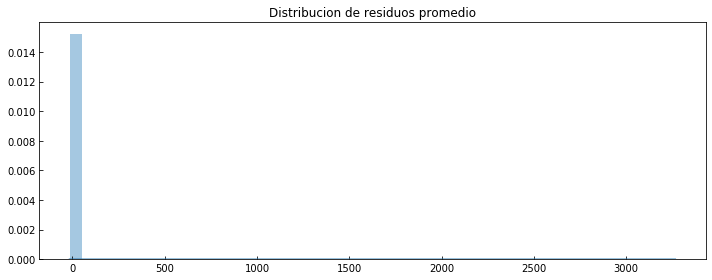

------------- Error -------------
RMSE (+-) =  2.1376537641921165
MAE  (+-) =  0.6263949919264901
------------- Smoothness -------------
AutoCorr lag-one =  0.4860128344301532
Diff MEAN =  0.20184602726330148
------------- Residual -------------
AutoCorr lag-one =  0.19368523615669253
Mean (+) STD = 0.147159 (+) 2.128500
---------------------------------------


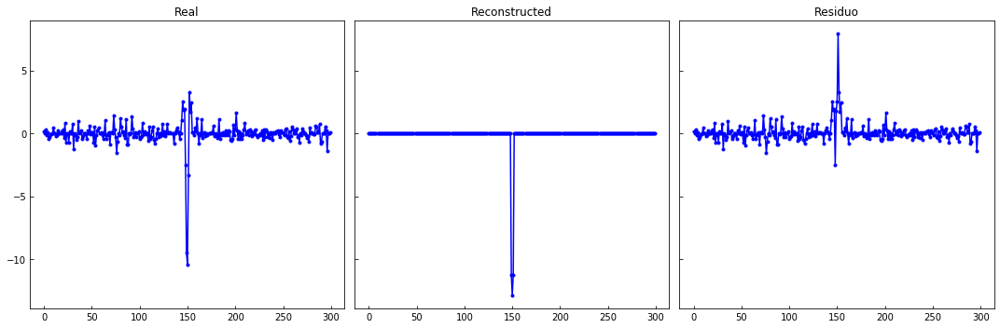

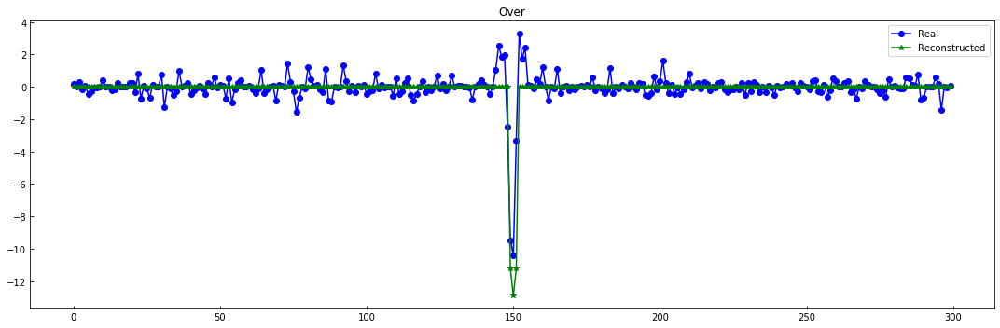

----------------------------------------------------------------


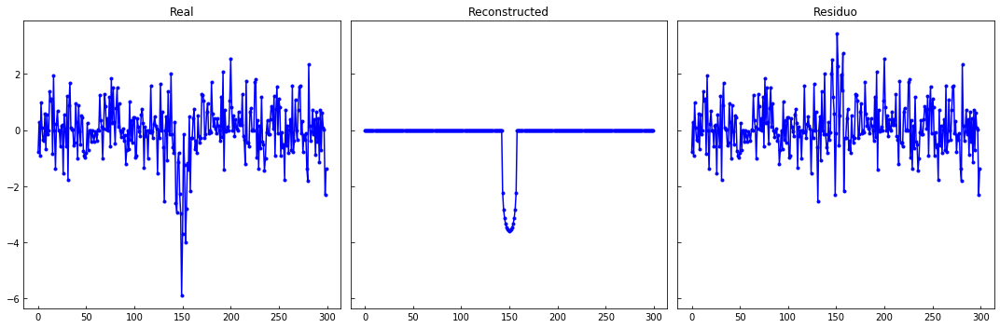

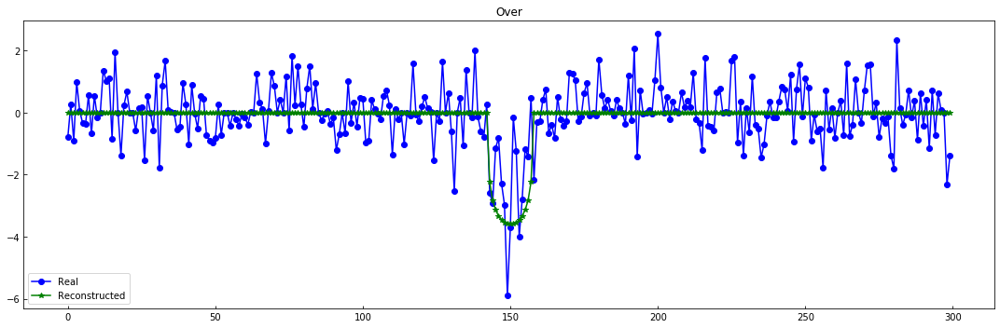

----------------------------------------------------------------


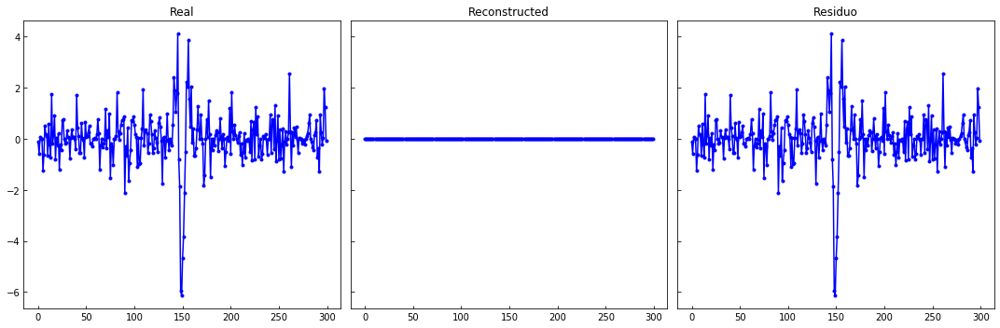

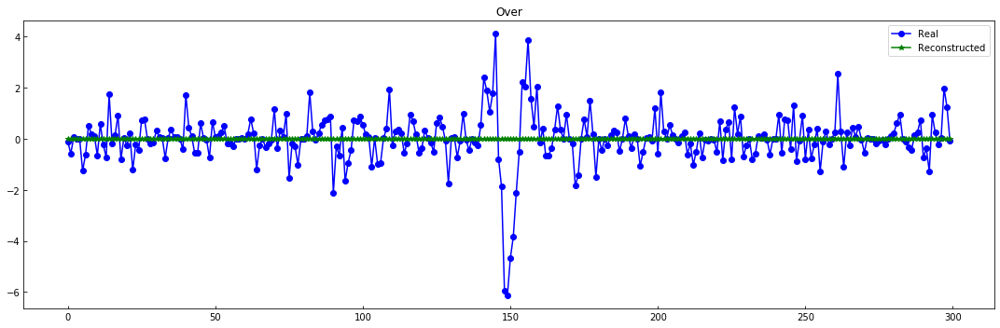

----------------------------------------------------------------


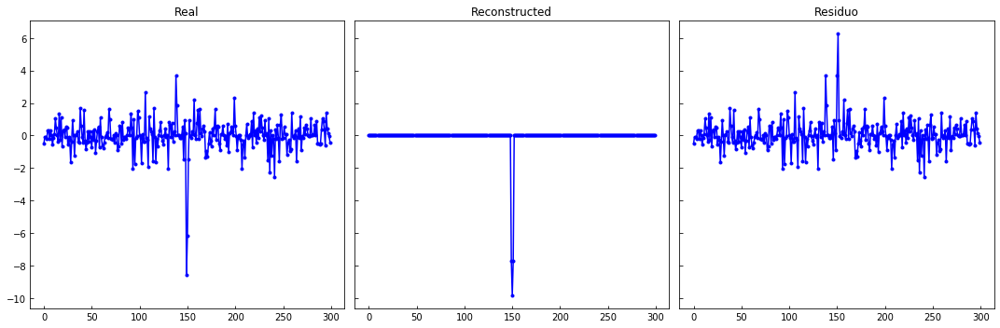

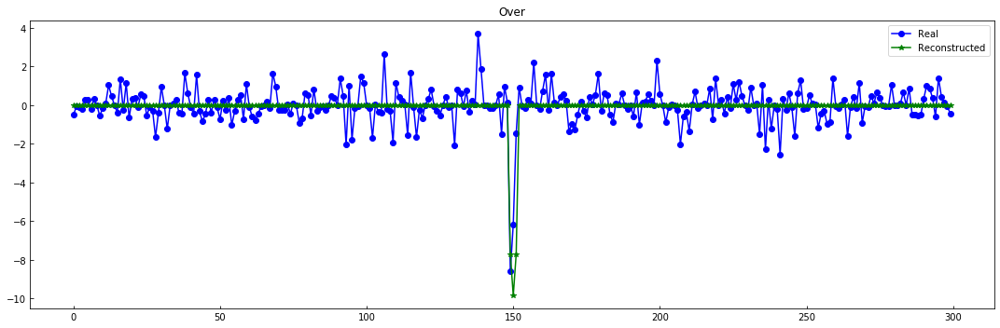

----------------------------------------------------------------


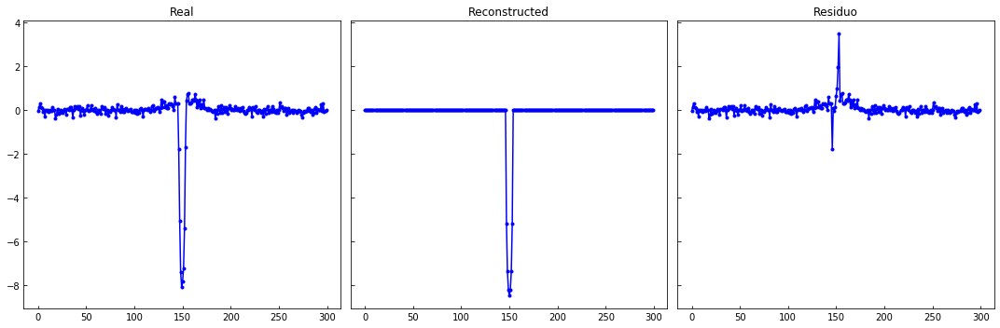

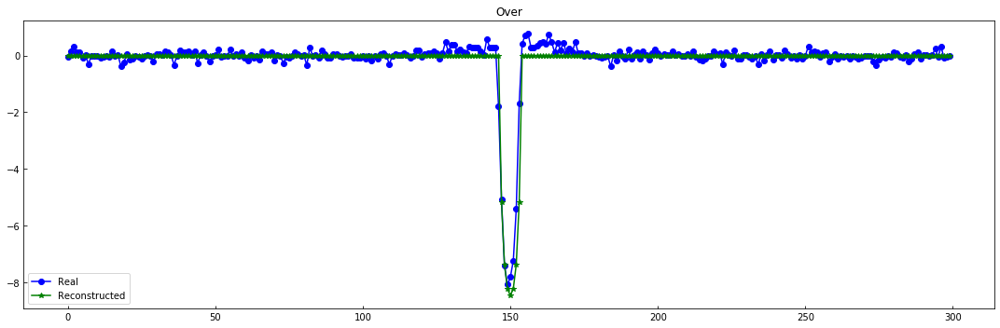

----------------------------------------------------------------


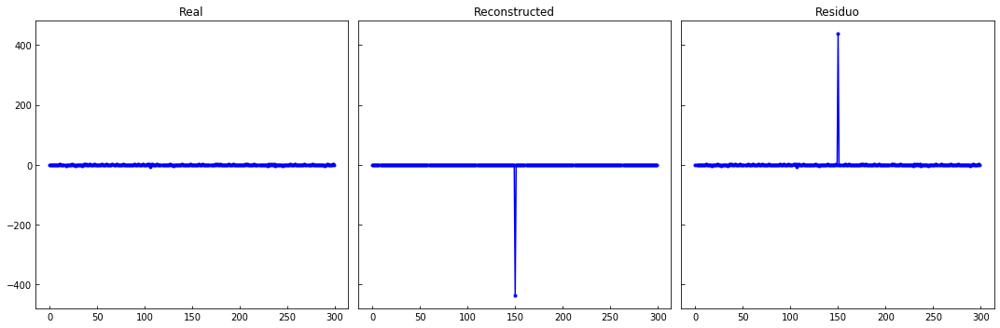

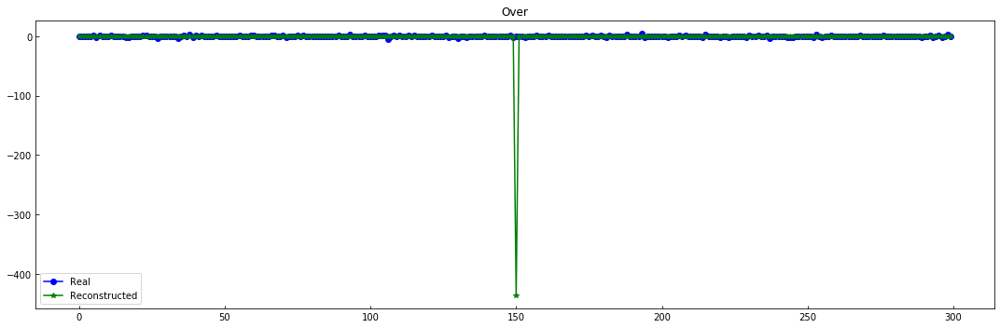

----------------------------------------------------------------


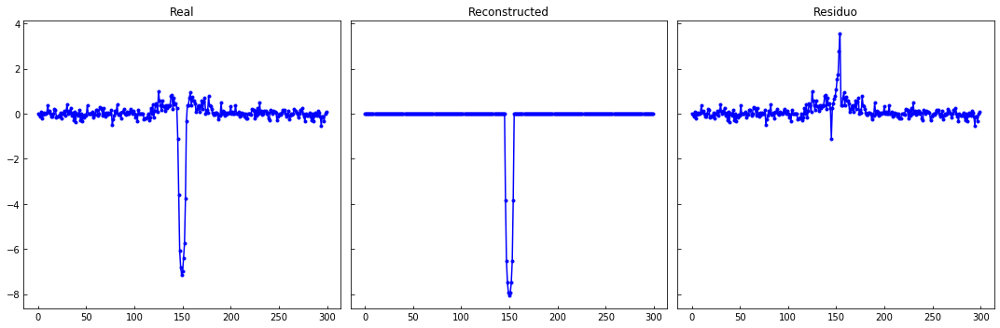

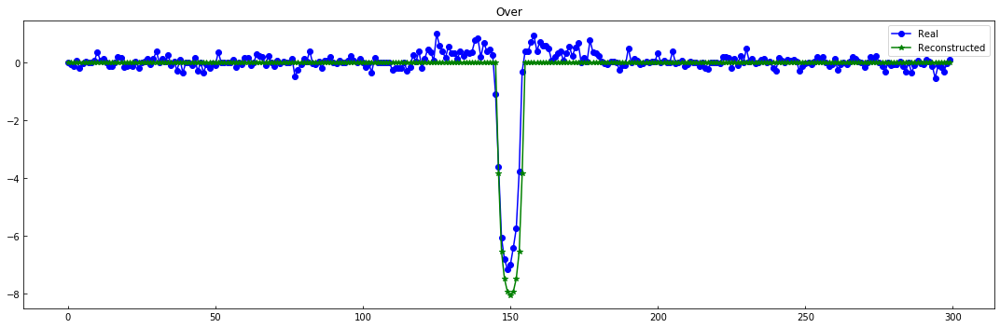

----------------------------------------------------------------


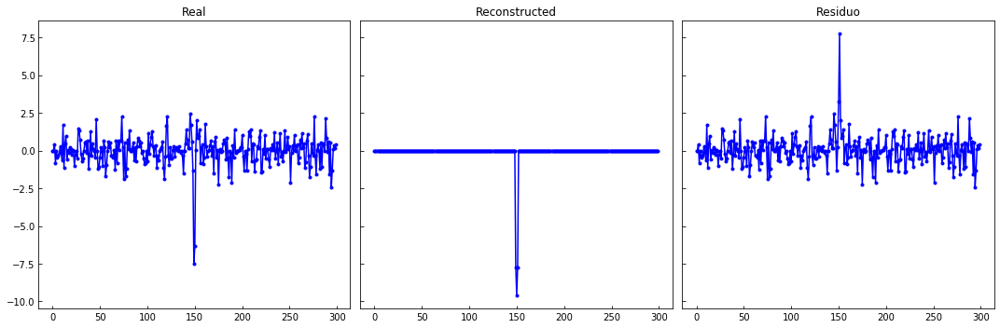

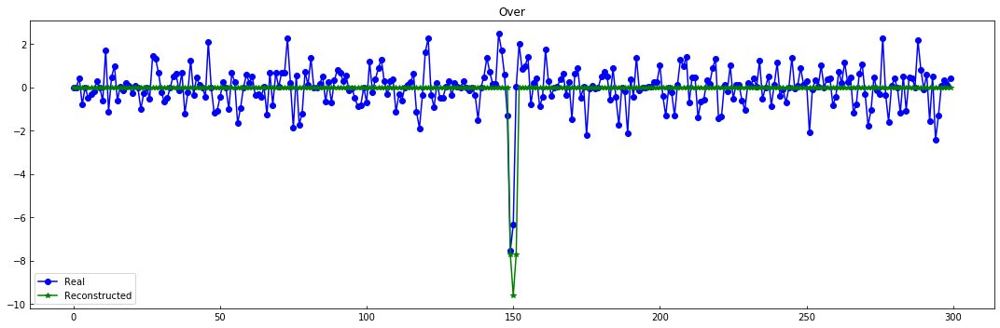

----------------------------------------------------------------


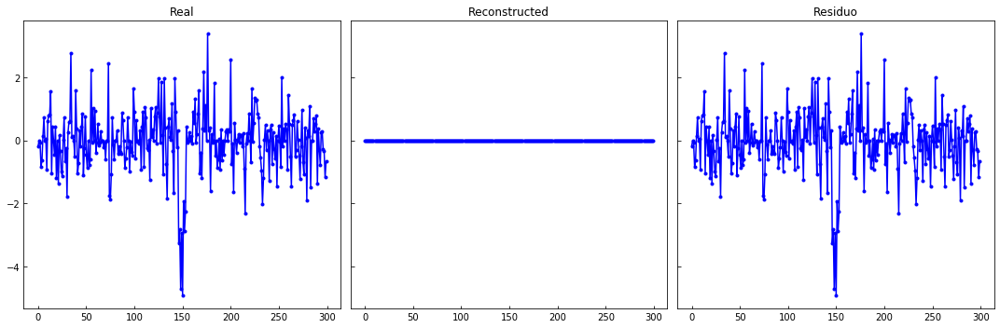

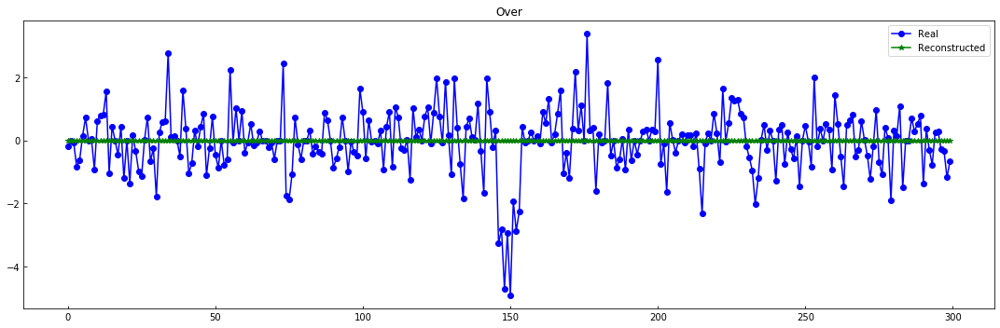

----------------------------------------------------------------


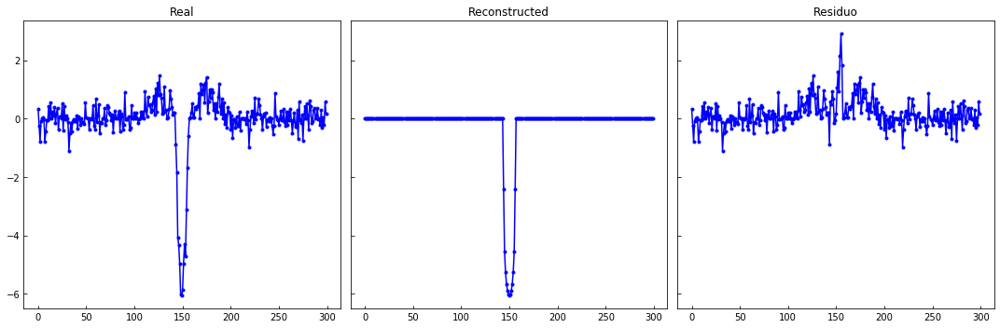

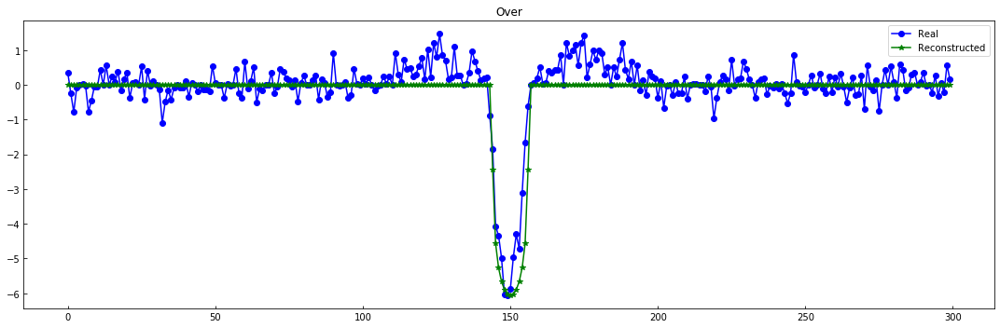

----------------------------------------------------------------


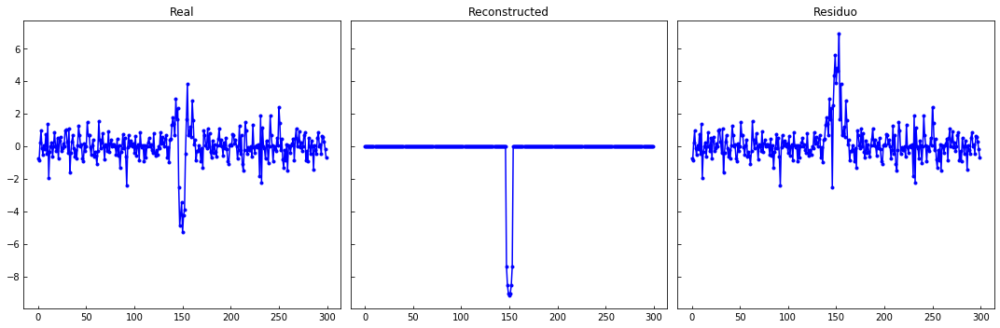

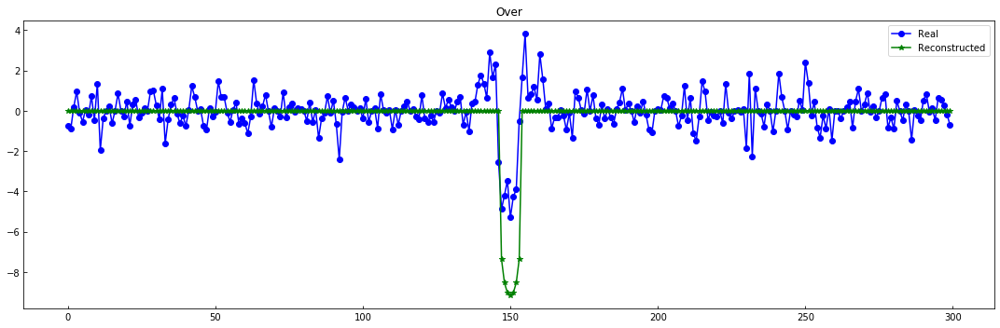

----------------------------------------------------------------


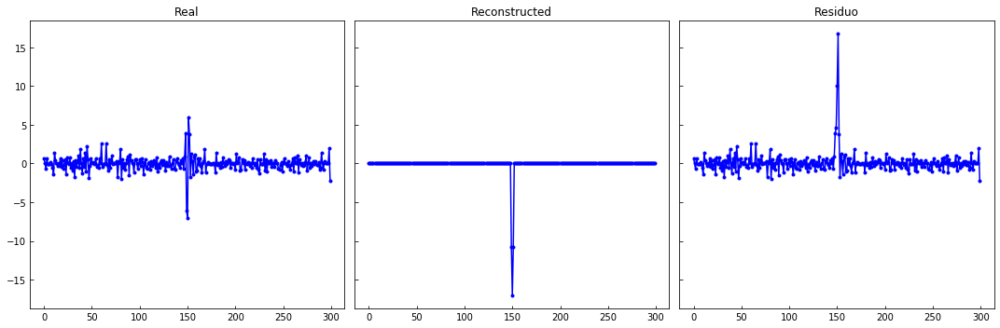

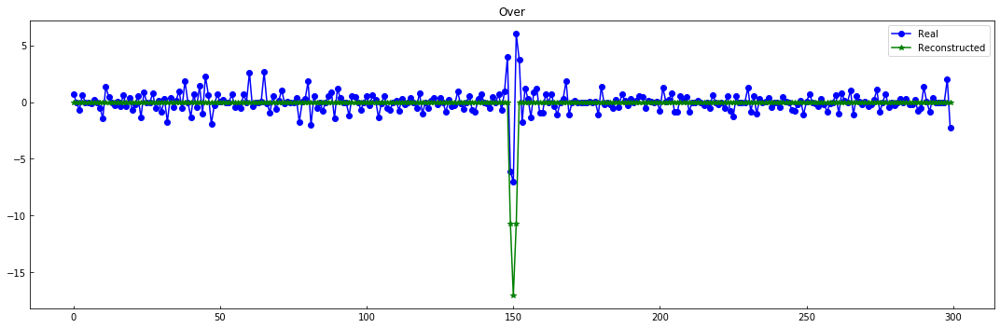

----------------------------------------------------------------


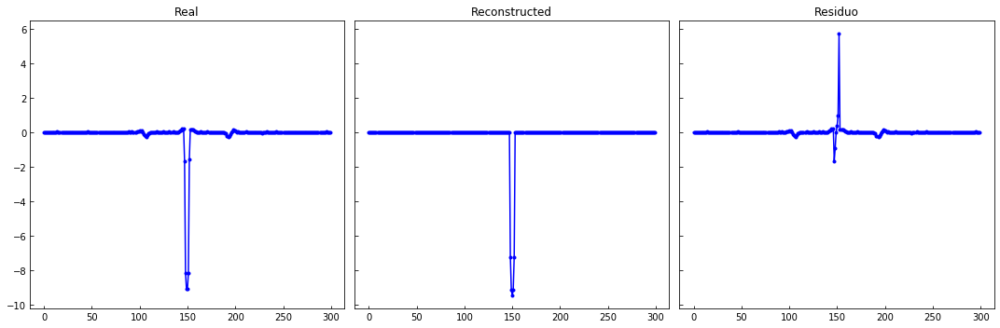

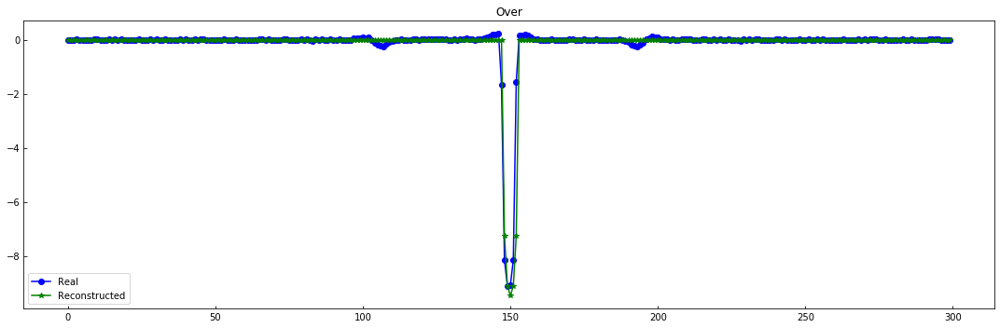

----------------------------------------------------------------


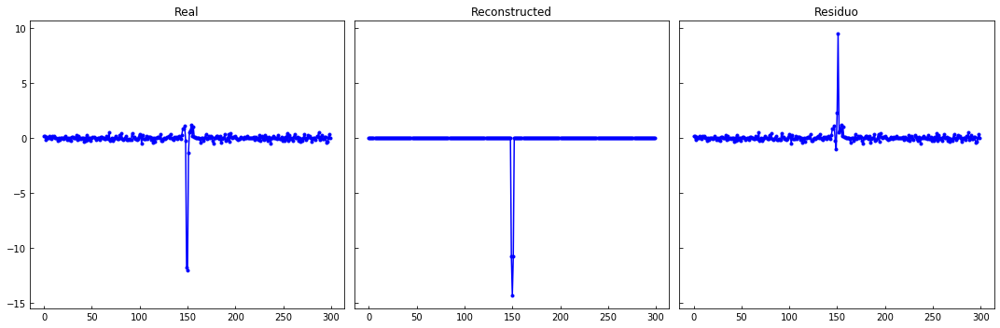

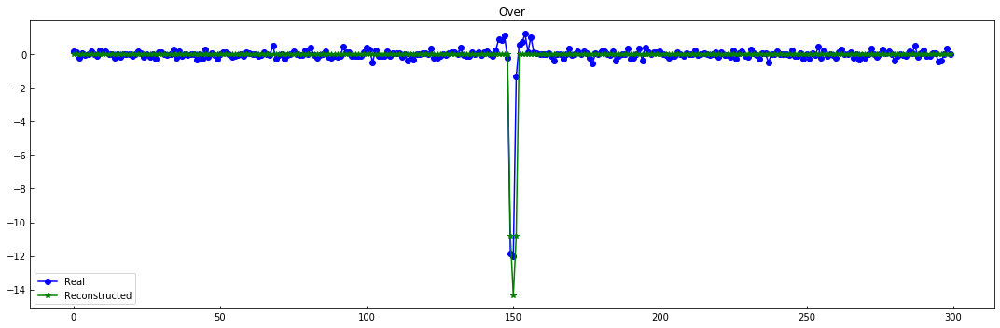

----------------------------------------------------------------


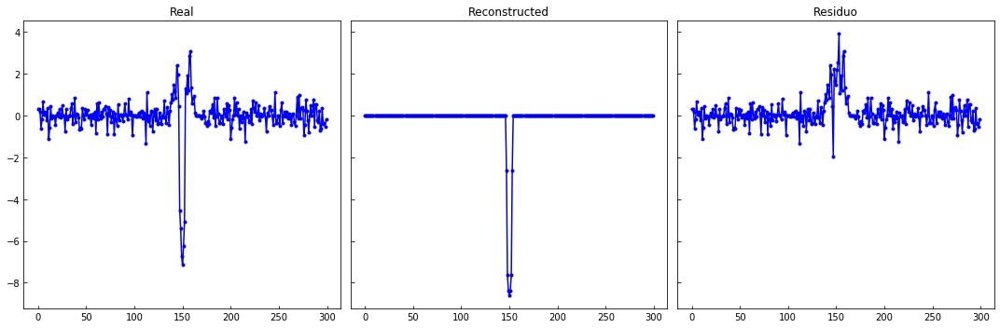

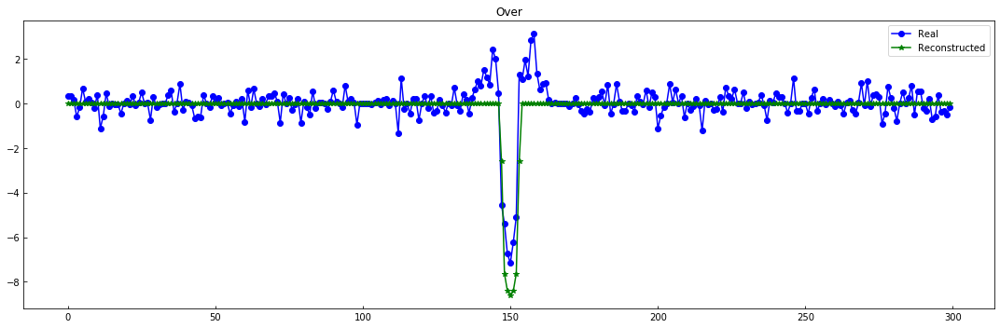

----------------------------------------------------------------


In [40]:
evaluate_reconst(X_train[:N], X_train_MA)

plot_n_lc(X_train[:N,:,0], X_train_MA, n= 15)

>   #### batman

|Periodo|T0|Planet Radius|Orbital Radius| Inclination| Limb coefs| Impact parameter| Duration| stellar dens|
|---|---|---|---|---|---|---|---|---|
|$\checkmark$|$\checkmark$|$\checkmark$|$\checkmark$|$\checkmark$|$\checkmark$|dep|dep|dep|
+ eccentricity + periastron

In [42]:
%%time
X_MA = []

for i in range(df_meta_obj.shape[0]):
    t_glo = np.cumsum(X_fold_time[i])
    
    metadata_n = df_meta_obj.iloc[i]
    sim_dat = {v: metadata_n[v] for v in MA_sim_names if v != "T0"} #get metadata
    sim_dat["T0"] = t_glo[int(np.round(len(t_glo)/2))] #trabajando con folds global ...
    
    lc_simulated = simulate_MA(t_glo, sim_dat, lib='batman', plot_m=False)
        

    X_MA.append(lc_simulated)
    
X_MA = np.asarray(X_MA)
X_MA.shape

CPU times: user 2.3 s, sys: 0 ns, total: 2.3 s
Wall time: 2.3 s


(8054, 300)

In [30]:
X_train_MA = X_MA[mask_transit]
X_train_MA = (X_train_MA-1)/S_train[:N] #M-A esta en la escala original de los datos..
X_train_MA.shape

(4317, 300)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


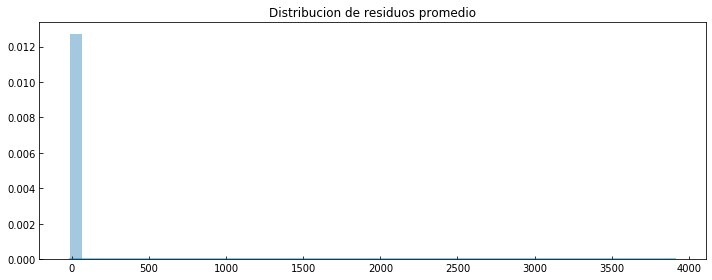

------------- Error -------------
RMSE (+-) =  2.2347697287233346
MAE  (+-) =  0.6297669242158337
------------- Smoothness -------------
AutoCorr lag-one =  0.6415037045762066
Diff MEAN =  0.21898982917905202
------------- Residual -------------
AutoCorr lag-one =  0.17662621403292916
Mean (+) STD = 0.181840 (+) 2.222896
---------------------------------------


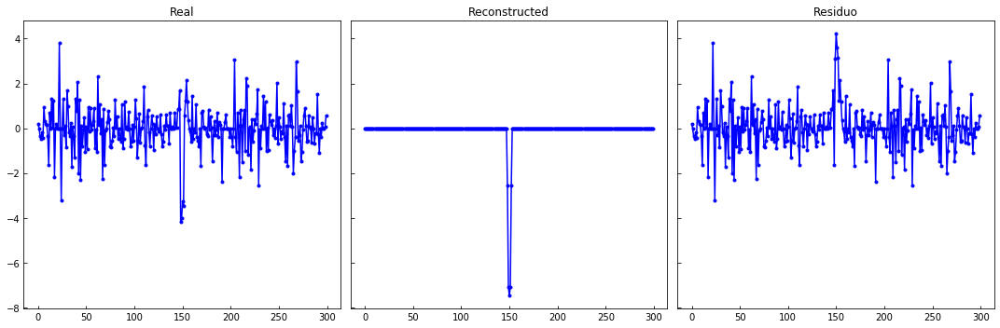

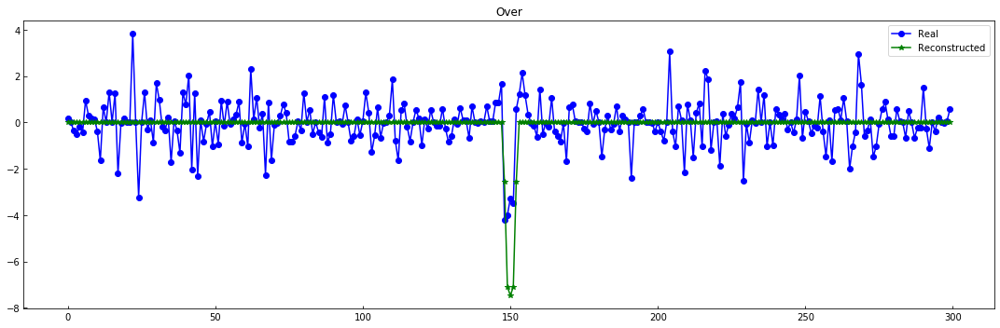

----------------------------------------------------------------


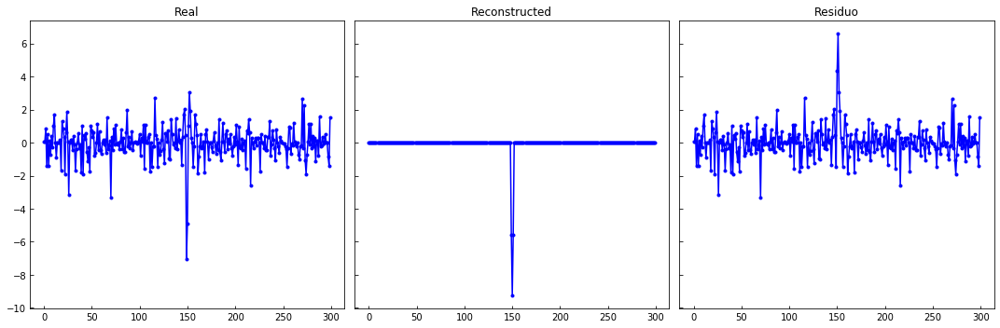

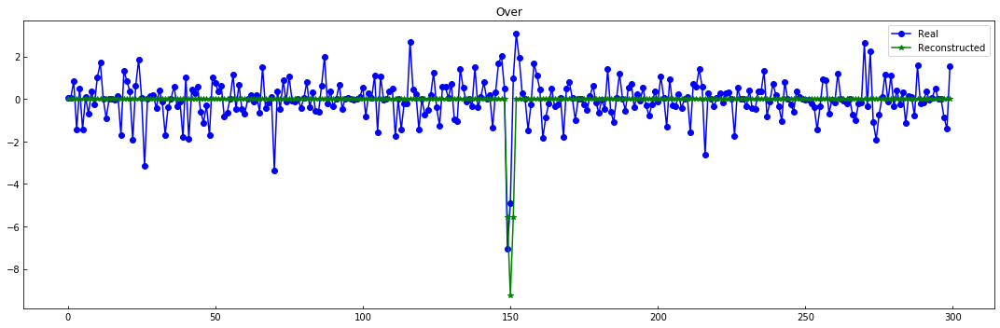

----------------------------------------------------------------


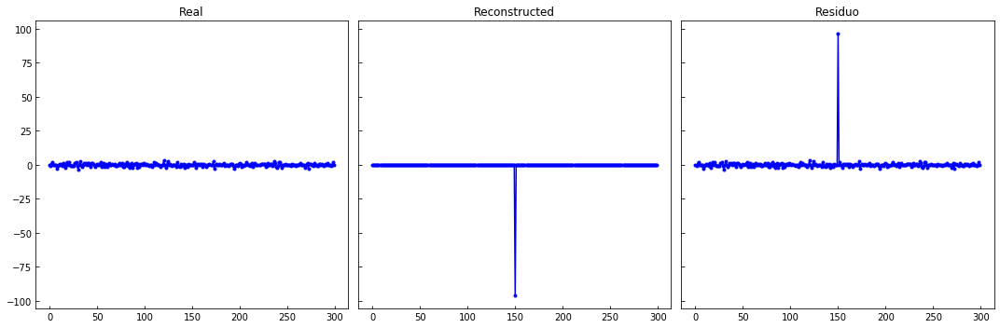

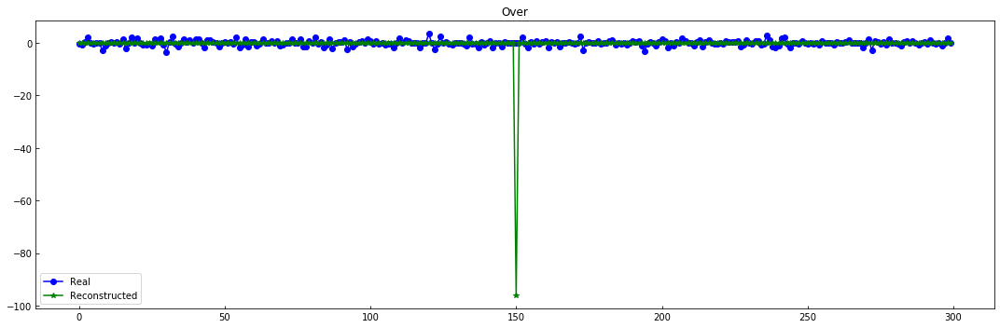

----------------------------------------------------------------


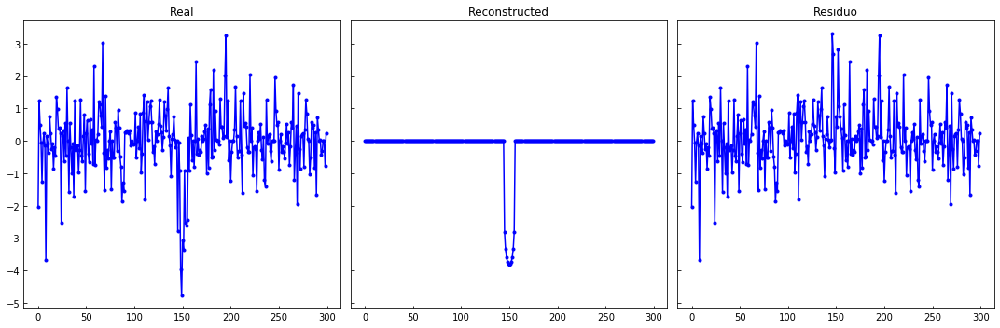

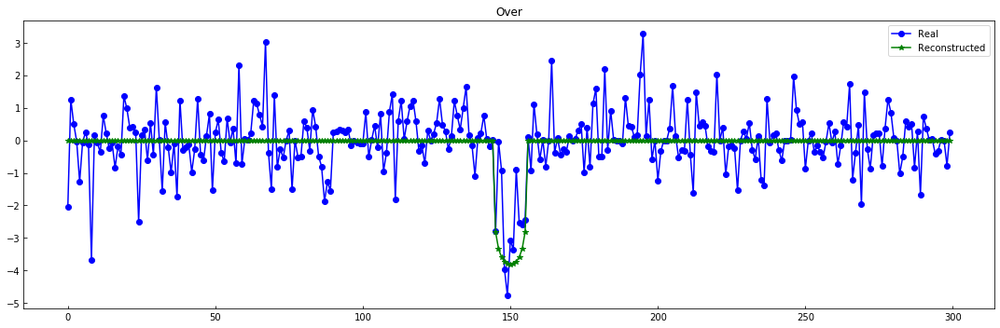

----------------------------------------------------------------


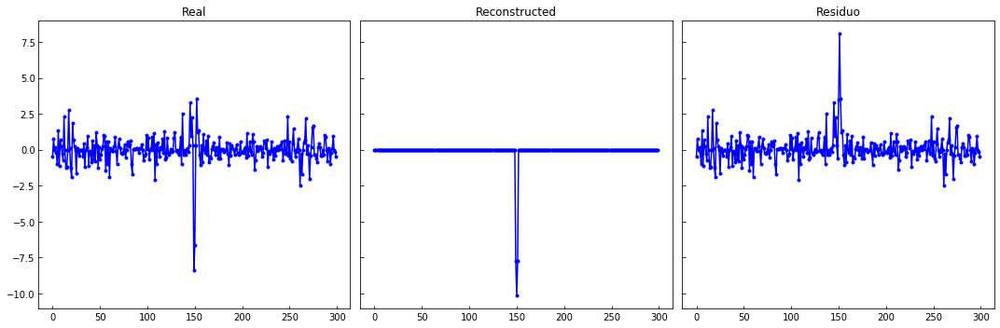

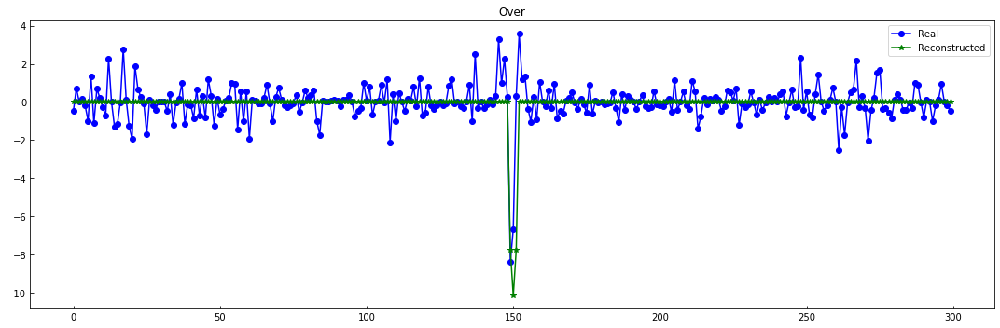

----------------------------------------------------------------


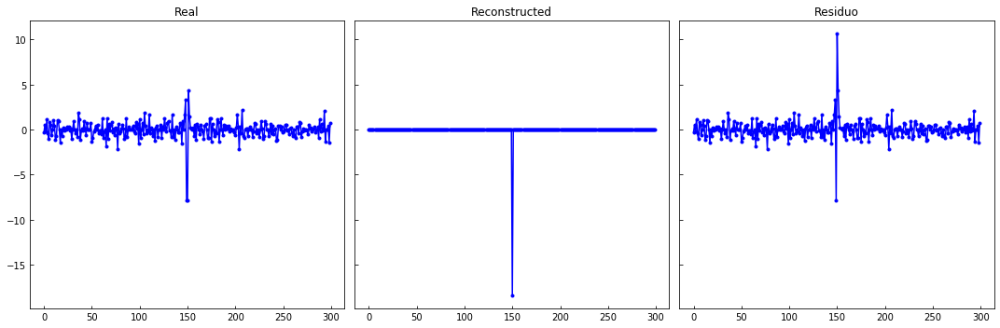

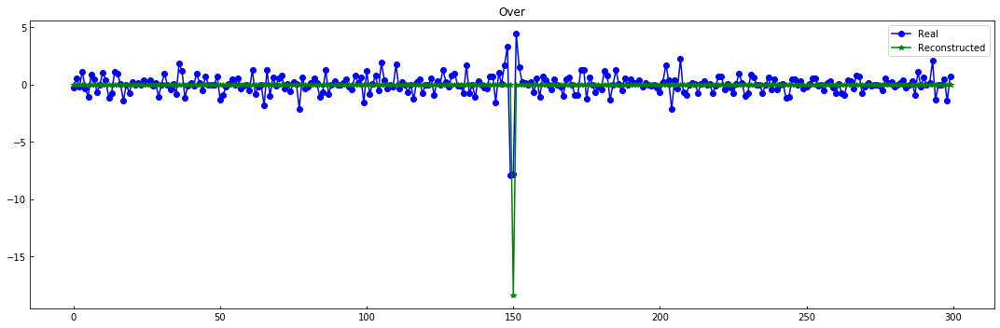

----------------------------------------------------------------


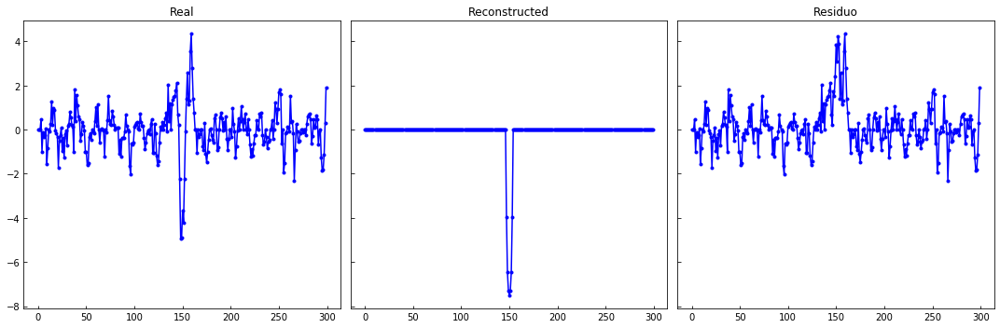

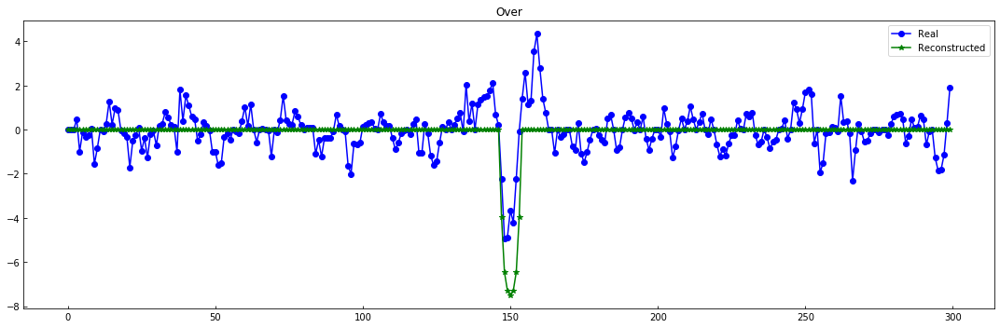

----------------------------------------------------------------


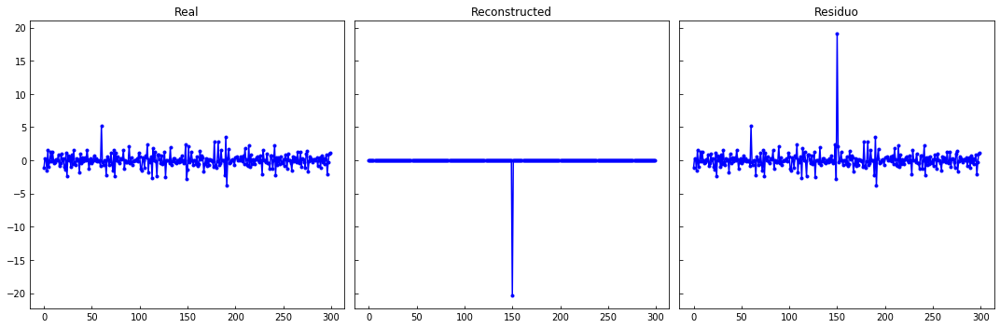

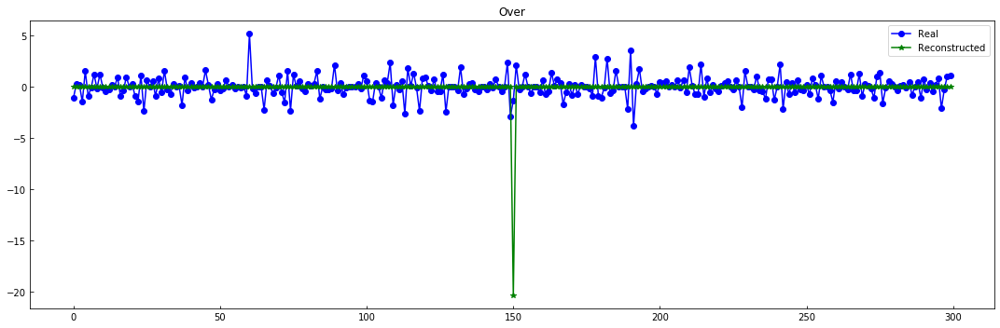

----------------------------------------------------------------


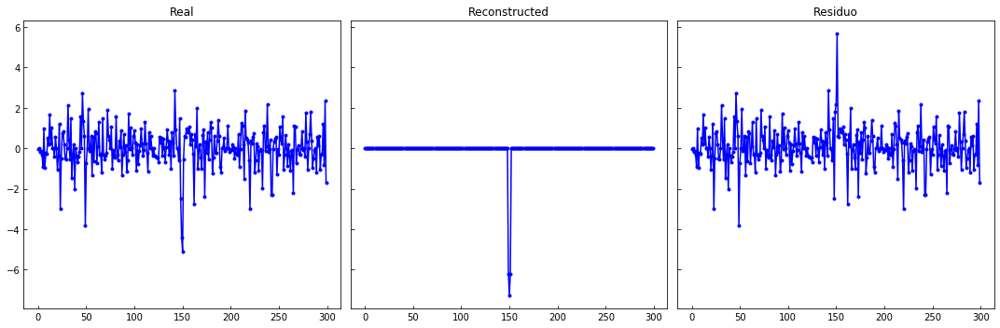

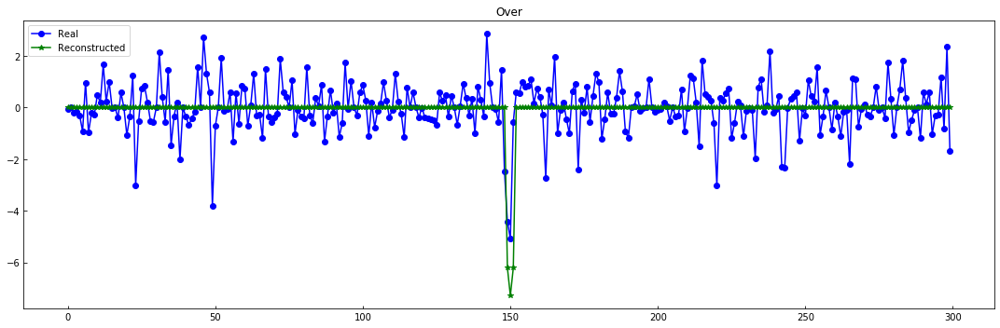

----------------------------------------------------------------


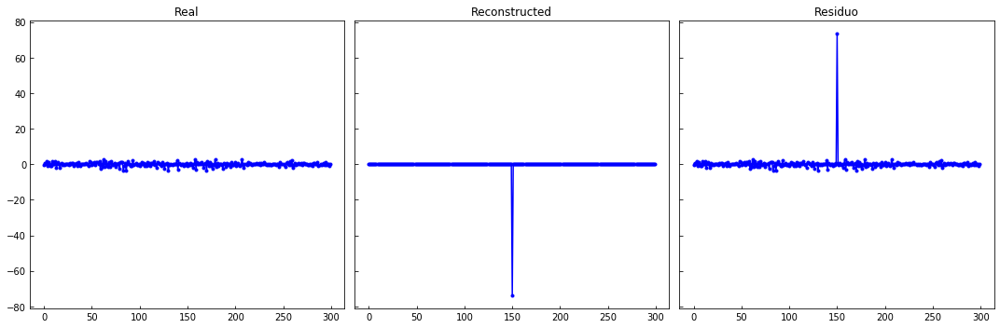

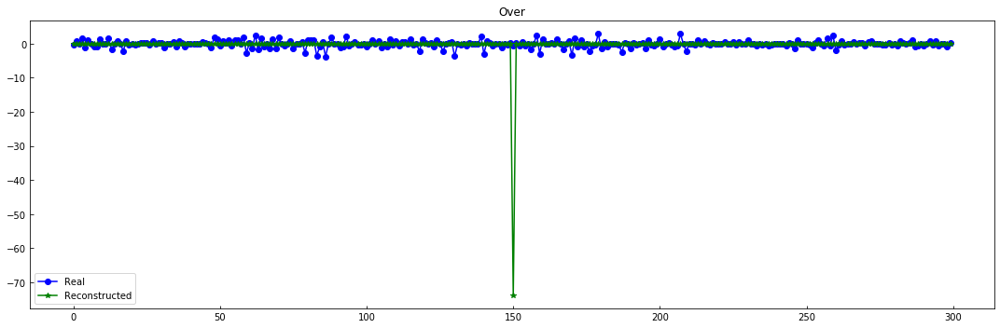

----------------------------------------------------------------


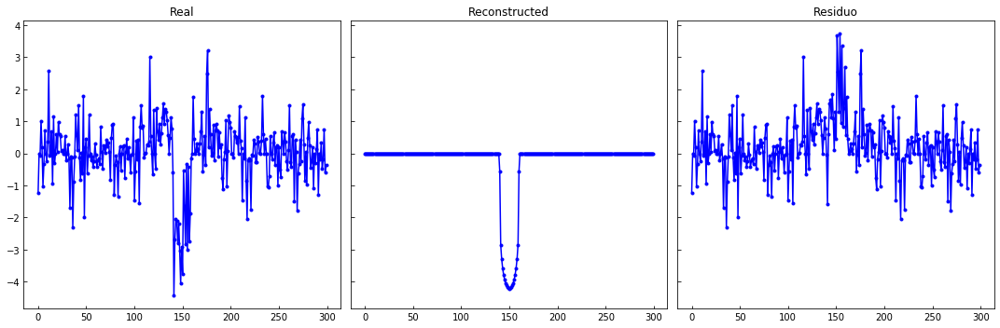

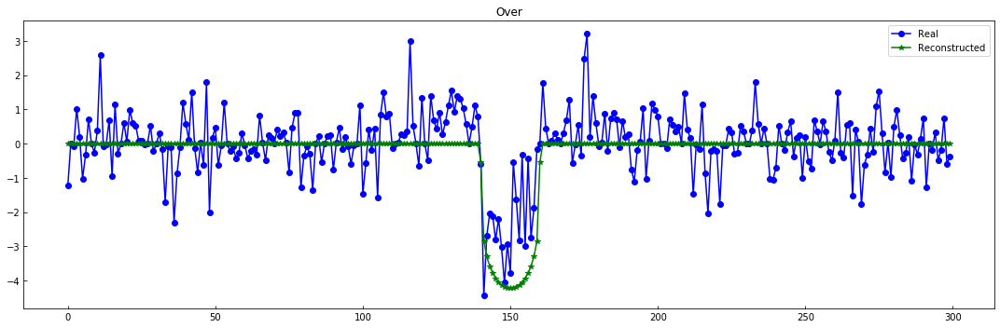

----------------------------------------------------------------


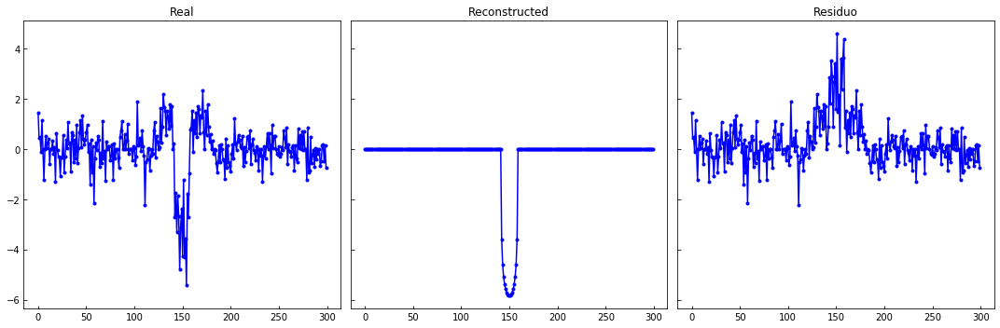

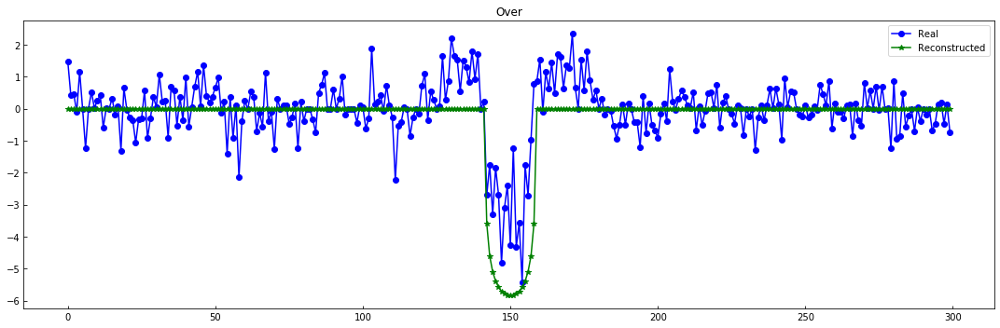

----------------------------------------------------------------


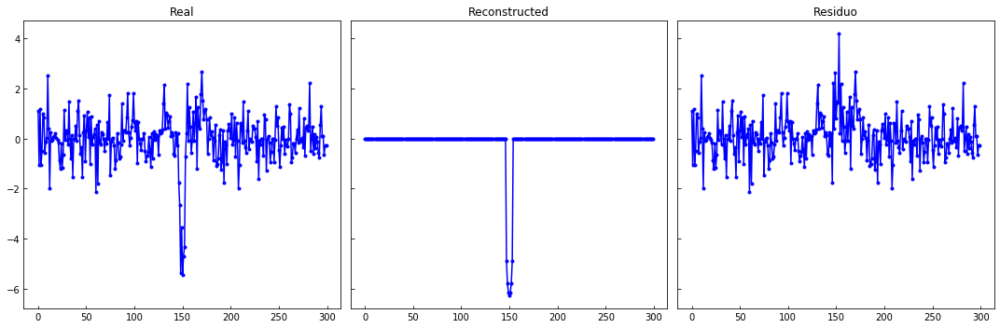

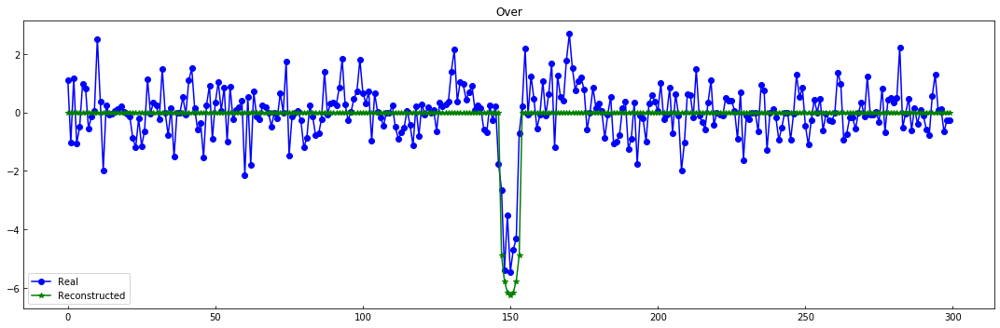

----------------------------------------------------------------


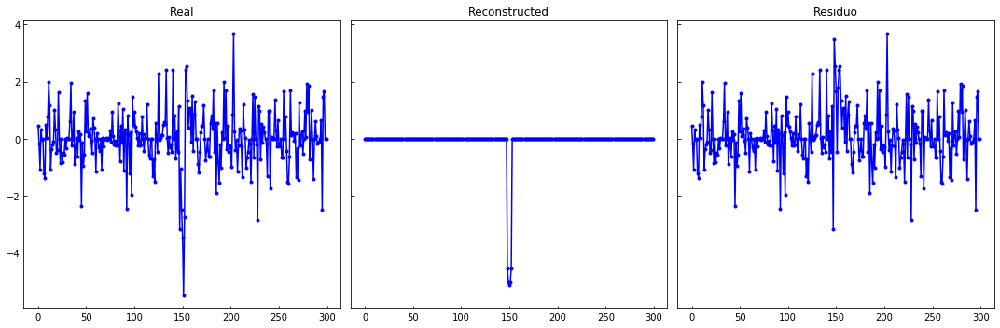

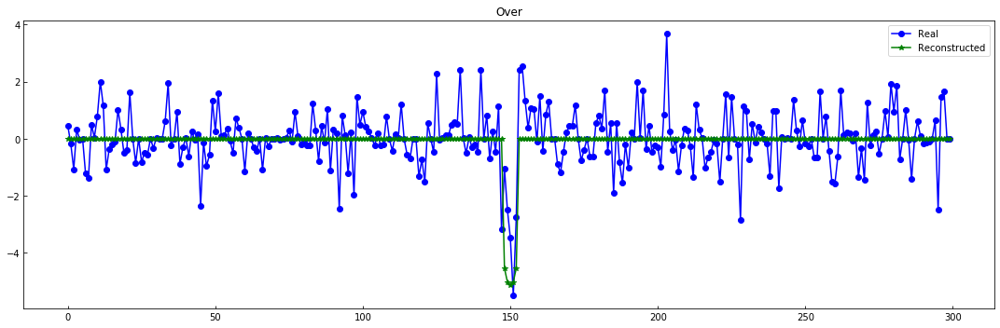

----------------------------------------------------------------


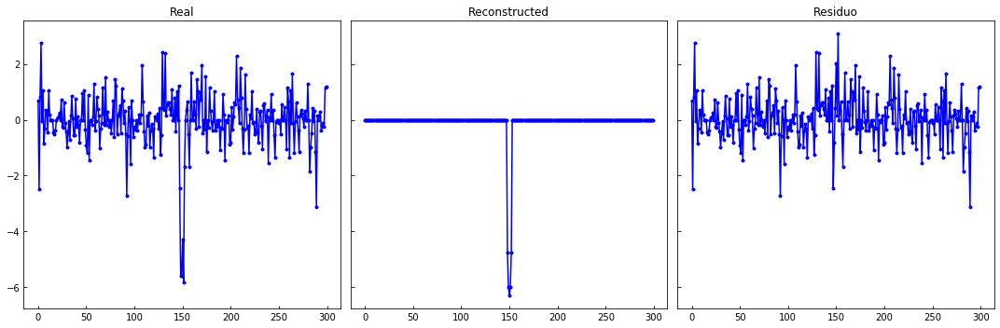

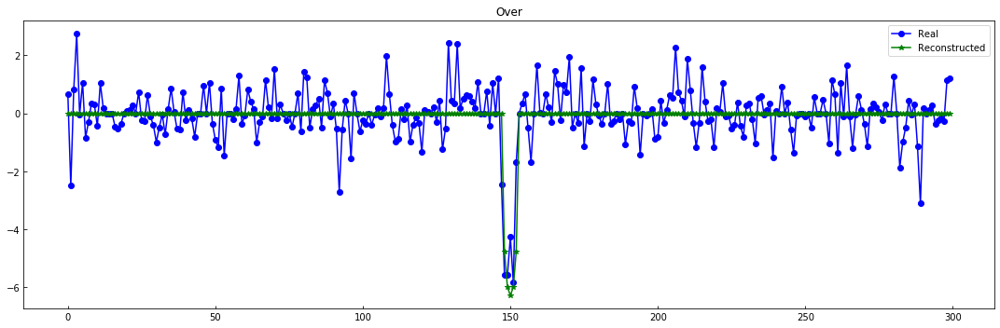

----------------------------------------------------------------


In [31]:
evaluate_reconst(X_train[:N], X_train_MA)

plot_n_lc(X_train[:N,:,0], X_train_MA, n= 15)

>   #### PySyZyGy

|Periodo|T0|Planet Radius|Orbital Radius| Inclination| Limb coefs| Impact parameter| Duration| stellar dens|
|---|---|---|---|---|---|---|---|---|
|$\checkmark$|$\checkmark$|$\checkmark$|$\checkmark$|dep|$\checkmark$|$\checkmark$|dep|dep|
+ mass

In [32]:
%%time

X_MA = []

for i in range(df_meta_obj.shape[0]):
    #load time to simulate
    t_glo = np.cumsum(X_fold_time[i])
    
    metadata_n = df_meta_obj.iloc[i]
    
    #Simular MA
    sim_dat = {v: metadata_n[v] for v in MA_sim_names if v != "T0"} #get metadata
    sim_dat["T0"] = t_glo[int(np.round(len(t_glo)/2))] #trabajando con folds global ...
    
    lc_simulated = simulate_MA(t_glo, sim_dat, lib='ps', plot_m=False)
    
    X_MA.append(lc_simulated)
    
X_MA = np.asarray(X_MA)
X_MA.shape

ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.539366,0.269683,0.016,1.012,12.57,0.988,0.314,0.304


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.283466,1.141733,1.166,4.917,84.66,0.457,0.273,0.318


ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.43574,1.21787,0.127,1.105,25.56,0.997,0.235,0.338


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.404692,0.702346,1.068,3.642,80.56,0.597,0.328,0.306


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.453067,3.726533,9.563,28.0,68.35,10.337,0.404,0.262


ERROR GENERACION DE CURVA:  Error in elliptic integral function RC().


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.922256,0.461128,0.008,1.042,17.8,0.992,0.413,0.26


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.513523,10.756762,1.475,2.6,20.29,2.441,0.547,0.171


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.948952,0.474476,1.056,3.341,73.32,0.959,0.404,0.262


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.912679,1.95634,22.82,53.344,64.31,23.127,0.335,0.306


ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.015044,0.507522,0.016,1.013,13.85,0.984,0.351,0.289


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.8811,1.44055,1.213,5.004,80.47,0.829,0.303,0.272


ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.085965,0.542983,0.113,1.09,32.81,0.916,0.128,0.249


ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.983762,0.491881,0.022,1.02,7.83,1.01,0.292,0.304


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.282033,3.141017,1.359,9.107,78.75,1.777,0.334,0.296


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,16.025019,8.012509,12.407,68.0,78.78,13.239,0.356,0.286


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,13.995854,6.997927,1.248,17.45,83.1,2.095,0.33,0.292


ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.46127,0.730635,0.357,1.352,17.61,1.288,0.454,0.234


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.722404,1.861202,1.653,13.54,79.9,2.375,0.356,0.286


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.112396,1.056198,1.055,9.48,82.21,1.285,0.404,0.262


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.878877,0.939438,1.099,4.64,84.55,0.441,0.287,0.307


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.086076,1.043038,12.633,22.1,52.67,13.376,0.324,0.298


ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.120998,0.560499,0.126,1.124,7.67,1.114,0.271,0.322


ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.302365,1.151183,0.47,1.457,40.96,1.1,0.359,0.287


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,49.266785,24.633393,7.446,79.6,83.97,8.364,0.381,0.28


ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.215591,1.607795,0.166,1.163,7.81,1.153,0.307,0.306


ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.615605,0.807803,0.196,1.154,5.58,1.149,0.274,0.319


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.35046,2.17523,3.448,19.59,77.61,4.203,0.289,0.31


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.195862,3.097931,2.432,11.31,72.61,3.38,0.434,0.243


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.656201,0.328101,1.034,2.416,53.45,1.439,0.359,0.287


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.35021,1.675105,8.829,14.16,46.93,9.666,0.273,0.318


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.735993,1.867997,1.29,3.723,74.53,0.993,0.41,0.259


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.638698,0.319349,1.258,2.396,42.83,1.757,0.3,0.314


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.852311,7.926155,6.222,88.7,85.93,6.286,0.404,0.262


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,24.328225,12.164113,3.452,15.06,72.91,4.426,0.497,0.204


ERROR GENERACION DE CURVA:  Error in elliptic integral function RC().


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.182244,2.091122,0.01,1.436,46.42,0.99,0.324,0.298


ERROR GENERACION DE CURVA:  Error in elliptic integral function RC().


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,34.650637,17.325318,0.027,8.5,83.42,0.973,0.271,0.322


ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.343285,1.671643,0.221,1.218,6.71,1.21,0.293,0.31


ERROR GENERACION DE CURVA:  Object does not transit the star.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.875197,0.437599,0.004,2.175,62.52,1.004,0.413,0.26


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.739429,0.869714,3.316,5.93,44.32,4.246,0.421,0.252


ERROR GENERACION DE CURVA:  Error in elliptic integral function RC().


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.906633,0.953317,0.02,1.671,54.12,0.98,0.273,0.317


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.063188,2.531594,3.68,9.761,69.62,3.4,0.454,0.234


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.401752,1.200876,4.418,12.96,66.1,5.25,0.574,0.155


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.873381,7.93669,3.047,32.0,83.8,3.454,0.437,0.243


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,14.541781,7.270891,21.721,58.7,67.71,22.28,0.345,0.292


ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.320693,2.160347,0.015,1.015,16.66,0.973,0.319,0.302


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.080432,1.040216,1.497,5.281,81.6,0.771,0.281,0.28


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.080434,1.040217,4.178,5.43,19.79,5.106,0.295,0.31


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,16.662167,8.331083,6.607,52.0,81.76,7.444,0.297,0.312


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.702374,3.851187,2.485,15.32,77.38,3.346,0.442,0.24


ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566796,0.283398,0.013,1.006,12.68,0.981,0.315,0.303


ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566797,0.283398,0.016,1.008,14.79,0.974,0.357,0.366


ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566795,0.283397,0.01,1.009,15.15,0.974,0.286,0.312


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,33.937542,16.968771,1.188,21.75,84.78,1.979,0.319,0.302


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,29.015853,14.507926,11.513,83.4,81.57,12.223,0.373,0.279


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.9981,3.49905,6.503,38.6,79.0,7.361,0.442,0.24


ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.566811,0.283405,0.018,1.01,13.58,0.982,0.398,0.267


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,44.827324,22.413662,1.198,80.48,88.94,1.494,0.495,0.208


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.947377,1.473688,1.654,3.92,47.65,2.641,0.258,0.309


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.37159,1.185795,1.344,8.79,79.15,1.653,0.389,0.279


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.794005,8.897002,2.741,13.61,74.13,3.72,0.319,0.302


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,121.599128,60.799564,4.104,59.6,85.18,5.011,0.324,0.298


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.113203,1.056601,2.217,3.92,35.77,3.178,0.442,0.24


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.226944,3.613472,1.601,5.79,77.71,1.233,0.315,0.302


ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.655095,0.327547,0.239,1.236,9.25,1.22,0.366,0.284


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,46.840086,23.420043,3.72,75.4,86.47,4.652,0.324,0.298


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.607274,1.803637,1.137,4.29,83.8,0.463,0.253,0.326


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,35.516192,17.758096,7.565,140.2,86.54,8.467,0.442,0.24


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,16.371987,8.185993,8.359,34.5,74.37,9.303,0.622,0.117


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,85.340926,42.670463,12.009,152.2,85.18,12.773,0.334,0.296


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.84992,10.42496,13.443,54.22,75.35,13.715,0.239,0.334


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.617281,1.30864,2.696,3.85,18.64,3.651,0.289,0.31


ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.34748,1.17374,0.487,1.473,44.47,1.051,0.351,0.289


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.888835,2.944418,5.354,16.76,68.22,6.217,0.404,0.262


ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.576587,0.788294,0.046,1.044,5.26,1.04,0.27,0.323


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.811461,0.905731,1.128,3.695,85.2,0.309,0.267,0.28


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.174915,1.087458,1.084,4.085,79.86,0.719,0.274,0.319


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,15.926991,7.963495,1.323,19.921,86.06,1.368,0.389,0.279


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.645852,0.322926,1.011,4.4,75.01,1.138,0.334,0.325


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.309067,2.154534,1.177,13.2,81.32,1.993,0.575,0.15


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.247157,0.623578,24.663,30.4,34.03,25.224,0.594,0.139


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.55651,1.778255,1.069,4.411,81.9,0.622,0.298,0.28


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.332115,1.166058,1.174,8.0,77.38,1.747,0.287,0.307


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.661896,1.830948,2.16,3.178,21.39,2.959,0.277,0.309


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,20.427232,10.213616,4.912,98.0,86.78,5.499,0.319,0.302


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.394518,2.197259,1.247,18.41,85.12,1.566,0.316,0.387


ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,2.53021,1.265105,0.293,1.288,8.13,1.275,0.382,0.274


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.096587,0.548294,1.64,2.75,17.79,2.623,0.41,0.26


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,158.348345,79.174173,2.676,45.2,85.36,3.655,0.303,0.316


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,7.061151,3.530575,1.856,7.02,66.27,2.824,0.386,0.271


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.726754,4.863377,3.746,5.62,33.72,4.676,0.317,0.303


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.726749,4.863374,1.807,8.274,76.84,1.883,0.437,0.243


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,9.296746,4.648373,1.271,16.509,84.36,1.623,0.289,0.312


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.521446,5.760723,1.625,20.75,83.13,2.483,0.386,0.271


ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,1.427966,0.713983,0.396,1.383,19.36,1.305,0.334,0.296


ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.948086,0.474043,0.121,1.12,9.31,1.105,0.273,0.329


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.371797,1.685898,3.075,19.04,80.26,3.219,0.434,0.243


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.668483,0.334242,1.271,4.754,80.64,0.773,0.404,0.262


ERROR GENERACION DE CURVA:  Star-crossing orbit.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.213185,1.606593,0.05,1.019,24.96,0.924,0.271,0.318


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.269177,1.634588,1.485,10.93,78.42,2.195,0.307,0.306


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.344105,4.172052,9.139,49.2,78.22,10.047,0.46,0.229


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,4.053254,2.026627,14.708,30.7,60.02,15.329,0.366,0.284


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.42809,4.214045,5.886,40.4,80.33,6.787,0.373,0.279


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,6.096031,3.048015,1.384,5.984,83.84,0.642,0.219,0.342


ERROR GENERACION DE CURVA:  Error in elliptic integral function RC().


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.937206,2.968603,0.024,3.033,71.23,0.976,0.312,0.308


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,5.937177,2.968589,5.442,13.66,62.62,6.282,0.404,0.262


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,0.865959,0.43298,2.821,8.58,69.06,3.068,0.221,0.4


ERROR GENERACION DE CURVA:  Bad value for ``RpRs``.


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,17.907665,8.953832,2.488,51.36,86.89,2.79,0.324,0.303


CPU times: user 6.7 s, sys: 68.3 ms, total: 6.77 s
Wall time: 6.72 s


(8054, 300)

In [33]:
X_train_MA = X_MA[mask_transit]
X_train_MA = (X_train_MA-1)/S_train[:N] #M-A esta en la escala original de los datos..
X_train_MA.shape

(4317, 300)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


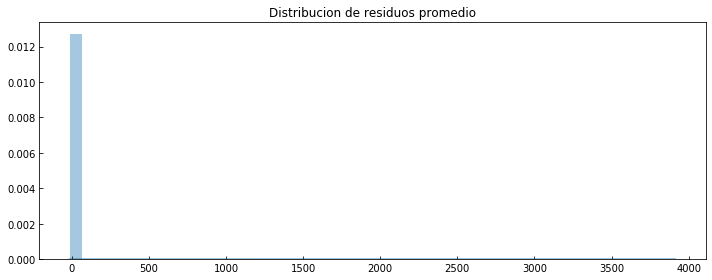

------------- Error -------------
RMSE (+-) =  2.2169312130099352
MAE  (+-) =  0.6272485220610942
------------- Smoothness -------------
AutoCorr lag-one =  0.6635252158171704
Diff MEAN =  0.21828638763722819
------------- Residual -------------
AutoCorr lag-one =  0.18818602585740113
Mean (+) STD = 0.181592 (+) 2.204820
---------------------------------------


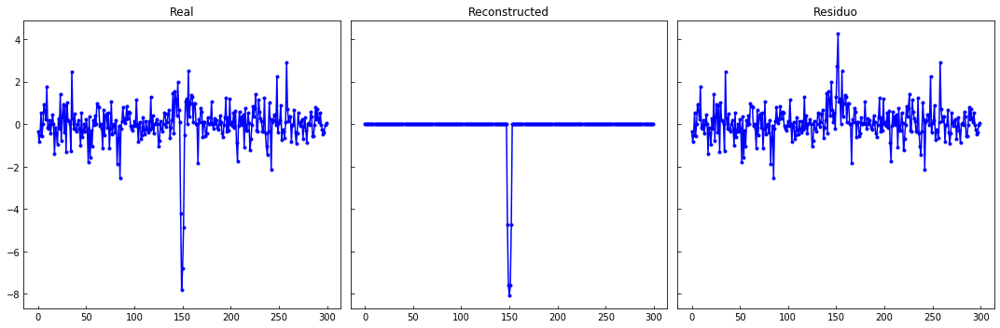

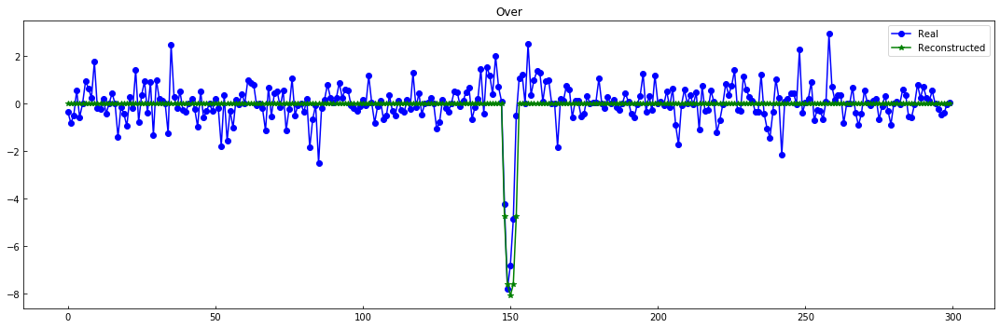

----------------------------------------------------------------


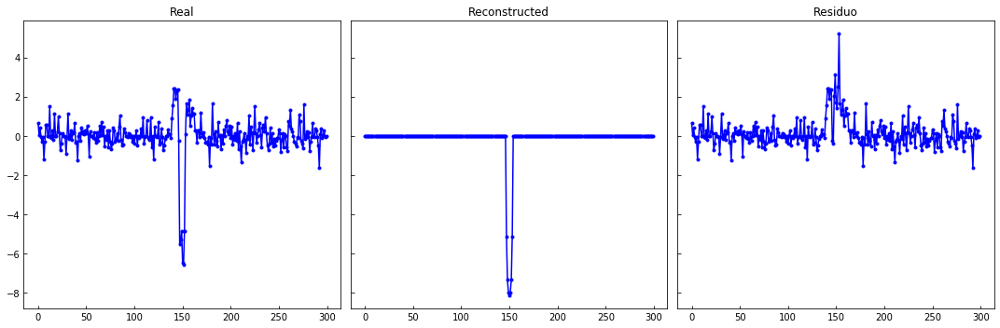

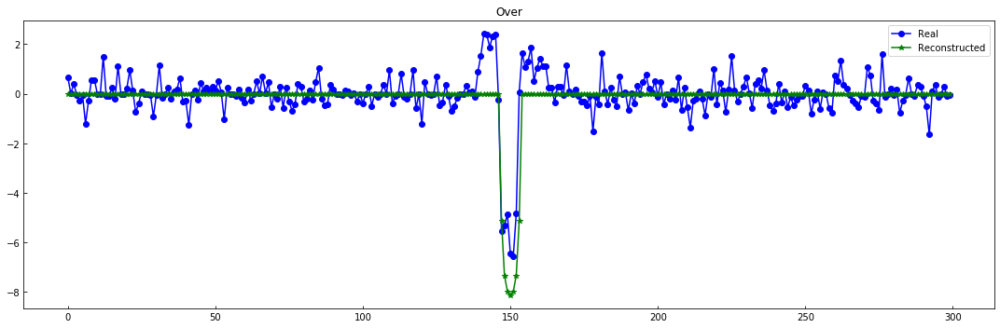

----------------------------------------------------------------


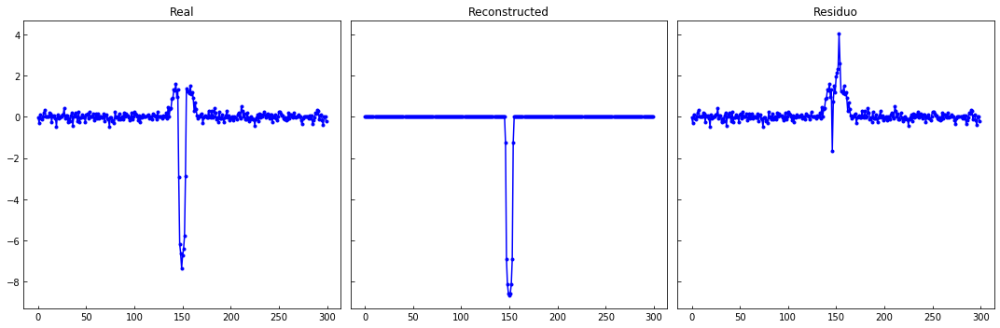

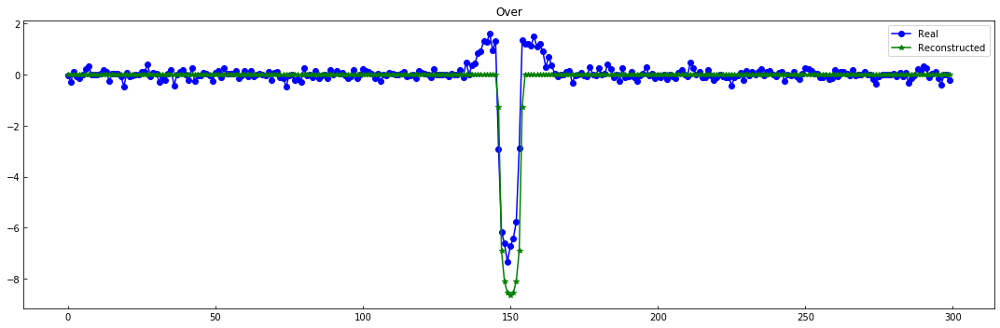

----------------------------------------------------------------


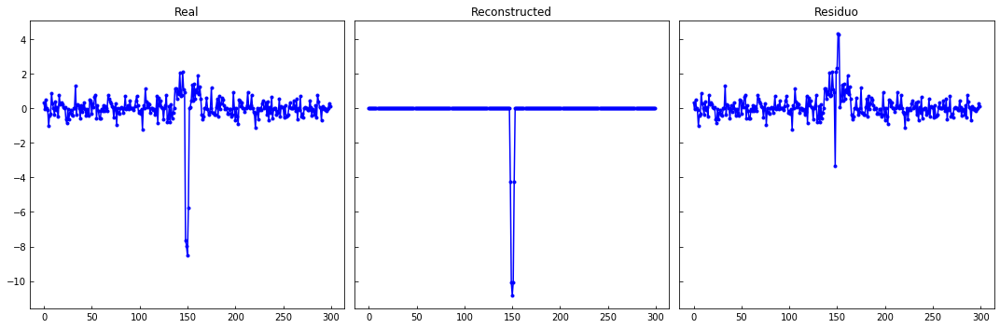

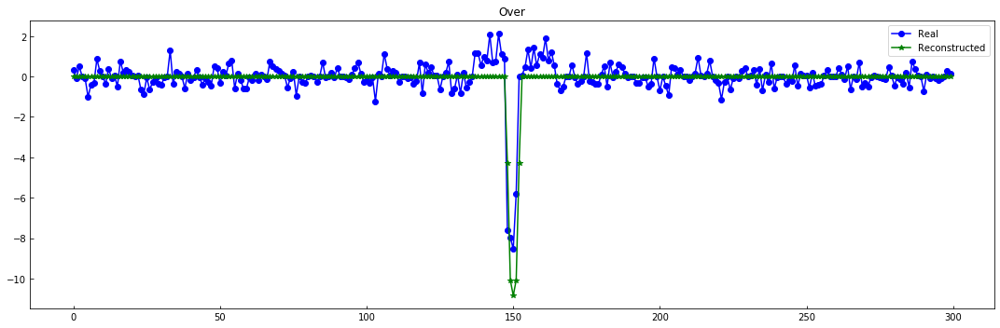

----------------------------------------------------------------


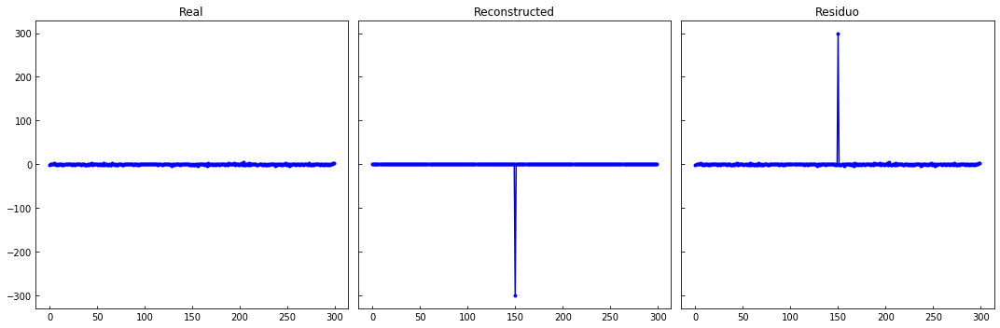

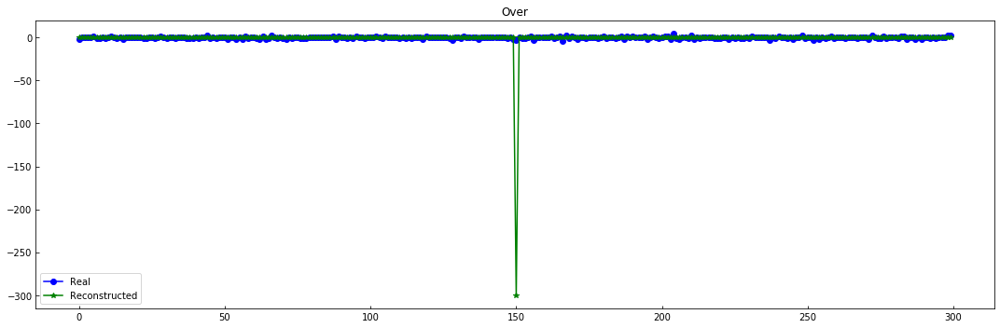

----------------------------------------------------------------


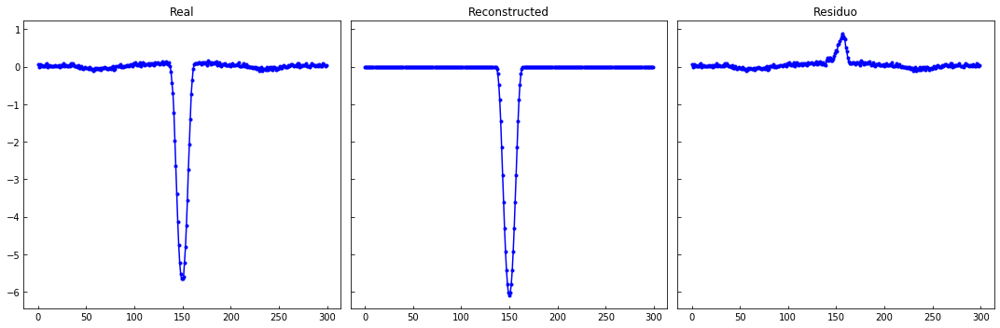

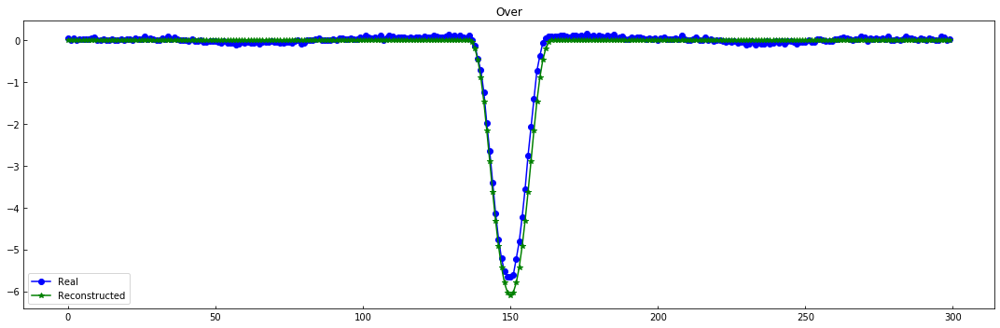

----------------------------------------------------------------


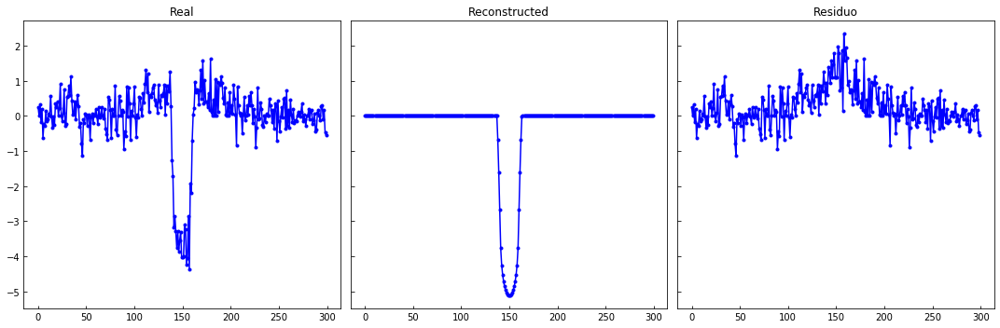

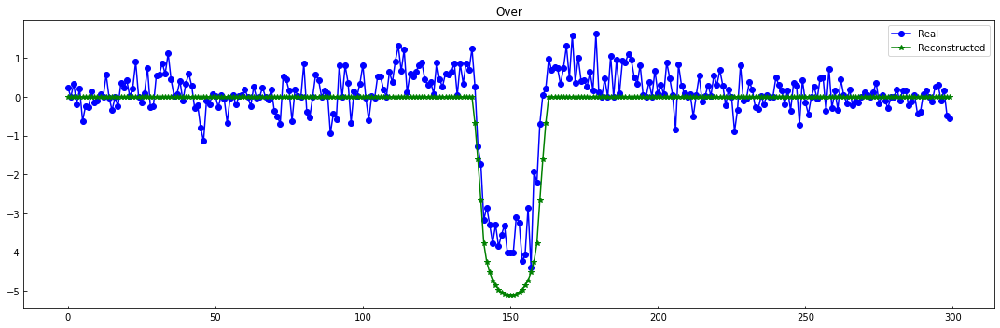

----------------------------------------------------------------


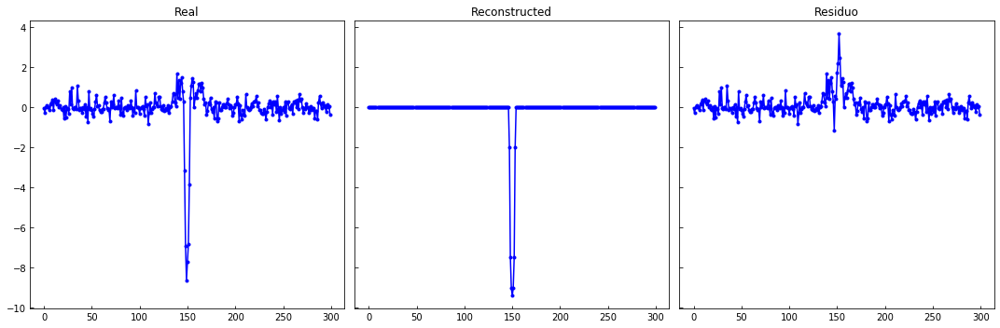

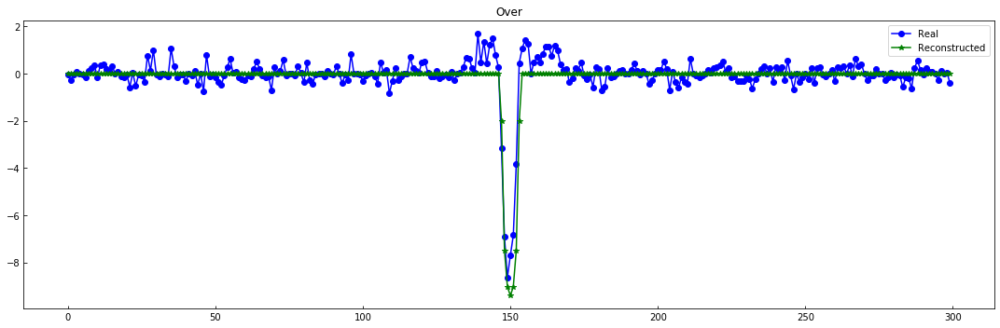

----------------------------------------------------------------


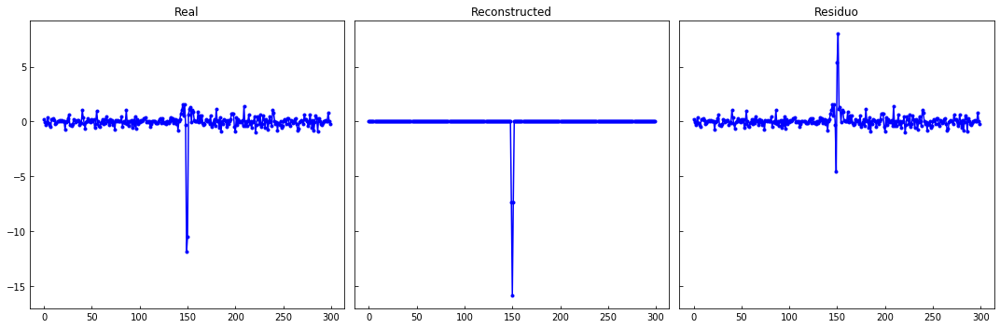

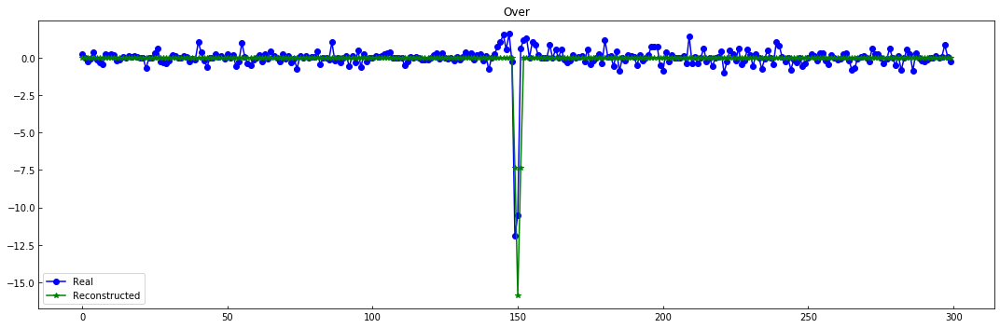

----------------------------------------------------------------


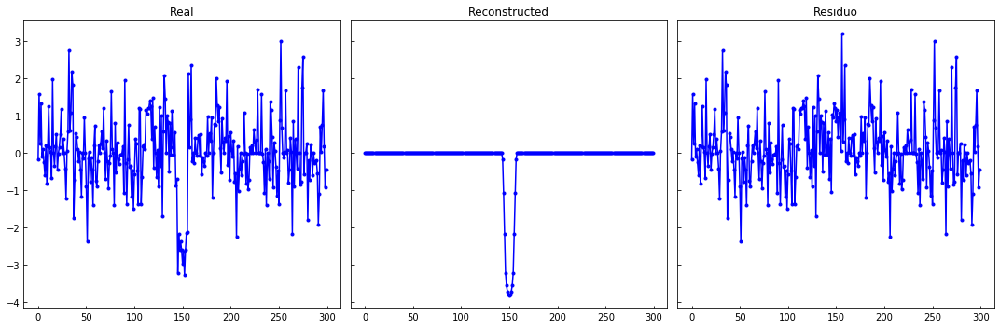

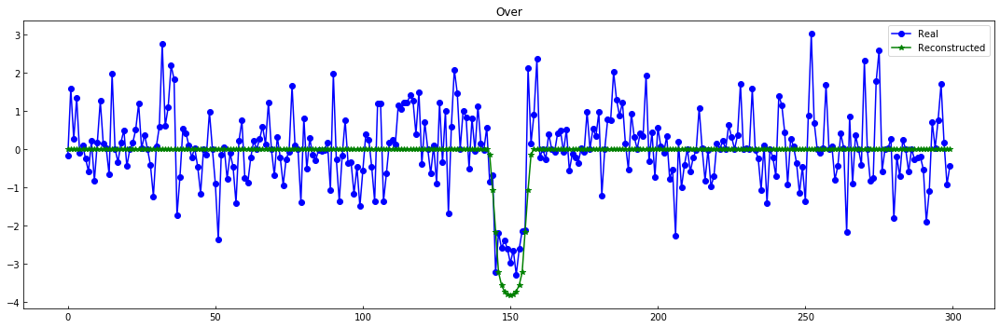

----------------------------------------------------------------


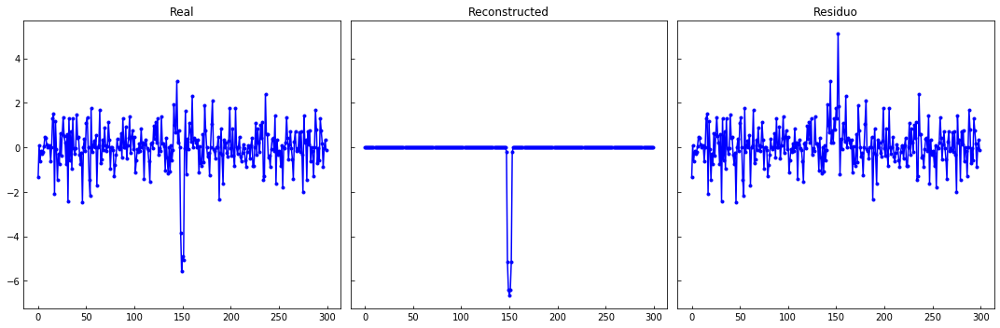

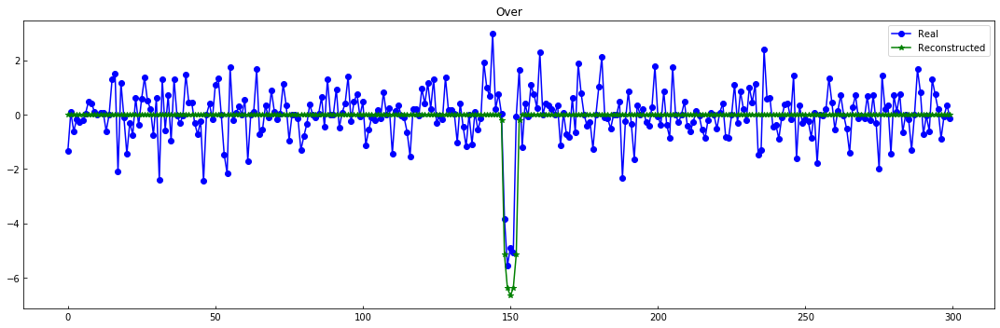

----------------------------------------------------------------


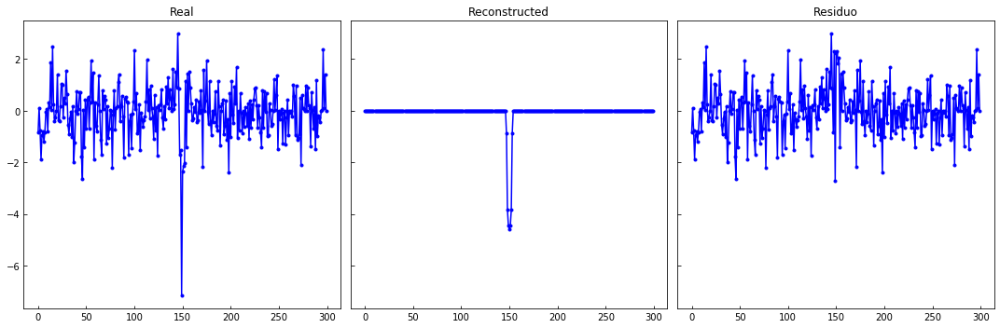

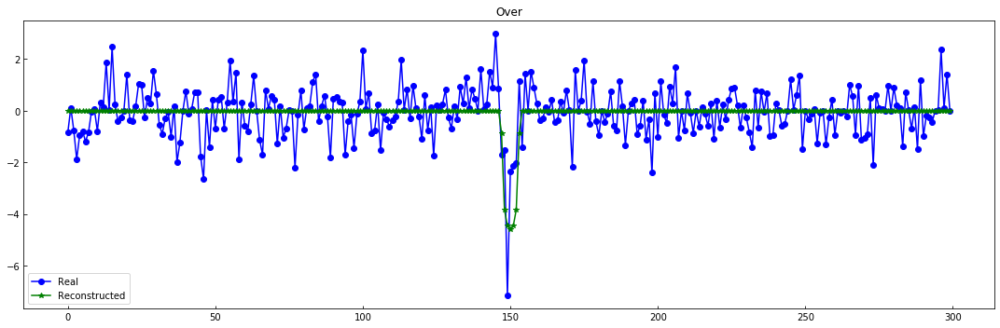

----------------------------------------------------------------


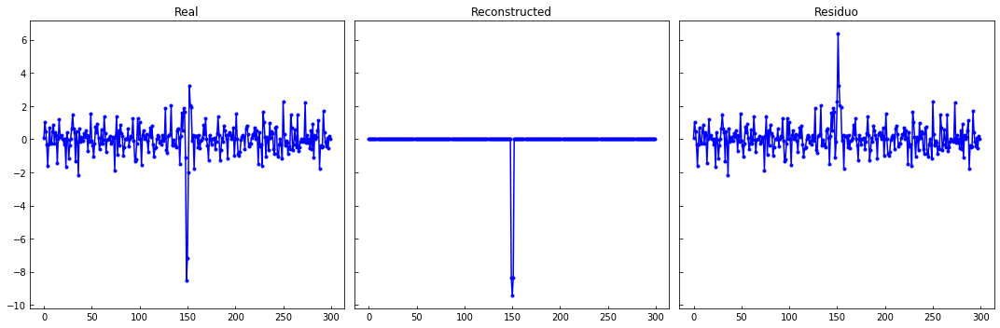

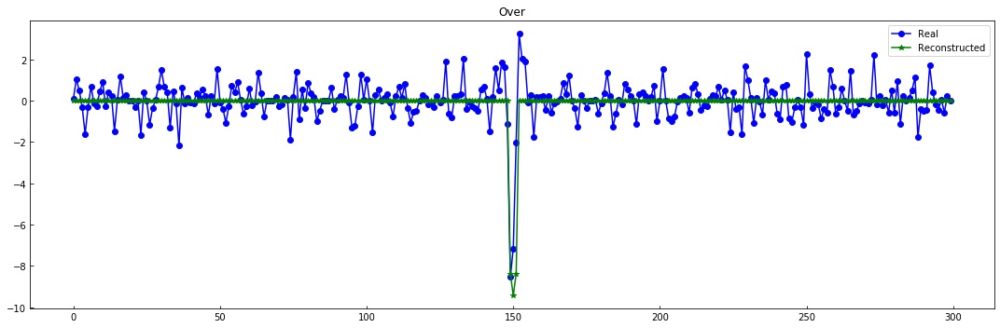

----------------------------------------------------------------


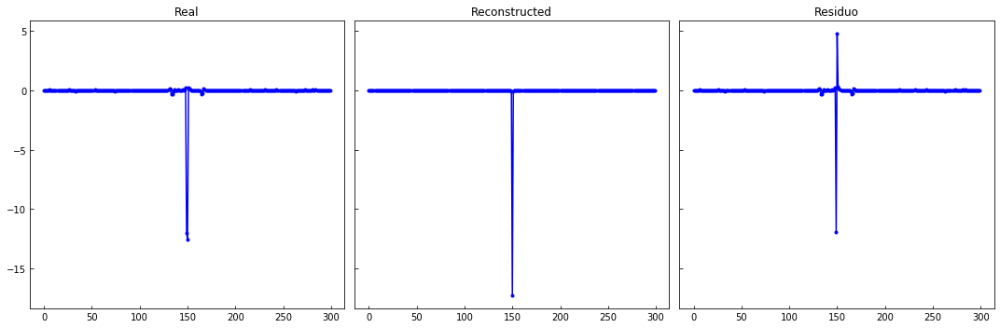

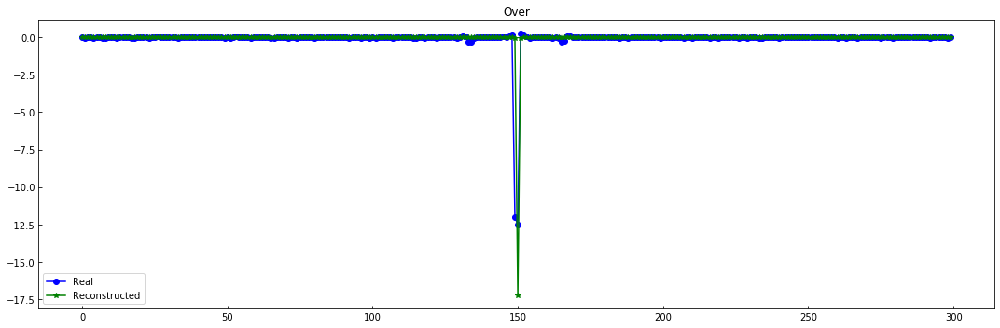

----------------------------------------------------------------


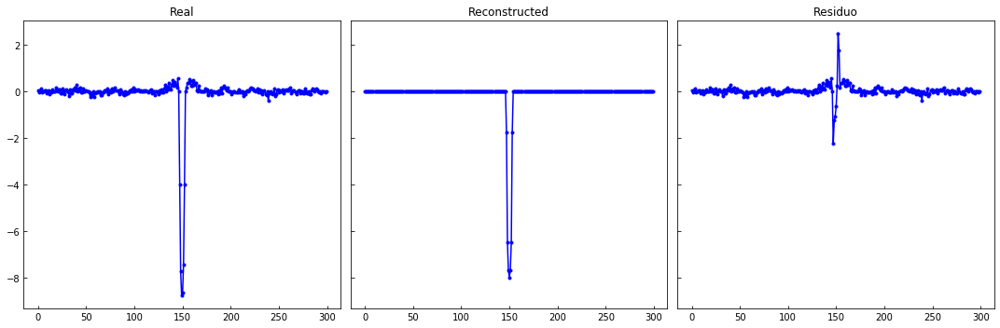

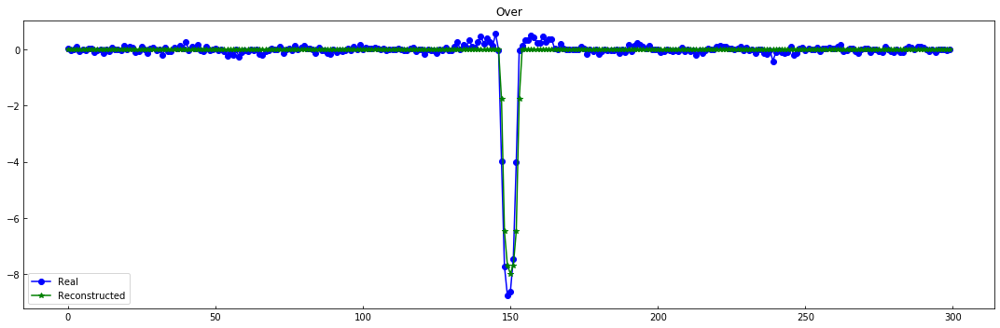

----------------------------------------------------------------


In [34]:
evaluate_reconst(X_train[:N], X_train_MA)

plot_n_lc(X_train[:N,:,0], X_train_MA, n= 15)

>   #### Everest
+ depth+ duration

In [33]:
%%time

X_MA = []

for i in range(df_meta_obj.shape[0]):
    #load time to simulate
    t_glo = np.cumsum(X_fold_time[i])
    metadata_n = df_meta_obj.iloc[i]
    
    #Simular MA
    sim_dat = {v: metadata_n[v] for v in MA_sim_names if v != "T0"} #get metadata
    sim_dat["T0"] = t_glo[int(np.round(len(t_glo)/2))] #trabajando con folds global ...
    sim_dat["Transit Depth"] = df_meta.iloc[i]["Transit Depth"]
    sim_dat["Duration"] = df_meta.iloc[i]["Duration"]
    
    lc_simulated = simulate_MA(t_glo, sim_dat, lib='everest', plot_m=False)
    
    X_MA.append(lc_simulated)
    
X_MA = np.asarray(X_MA)
X_MA.shape

Exception: Bad value for ``RpRs``.

>   #### PyLC
|Periodo|T0|Planet Radius|Orbital Radius| Inclination| Limb coefs| Impact parameter| Duration| stellar dens|
|---|---|---|---|---|---|---|---|---|
|$\checkmark$|$\checkmark$|$\checkmark$|$\checkmark$|$\checkmark$|$\checkmark$|dep|dep|dep|
+ eccentricity + periastron

In [35]:
%%time

X_MA = []

for i in range(df_meta_obj.shape[0]):
    #load time to simulate
    t_glo = np.cumsum(X_fold_time[i])
    metadata_n = df_meta_obj.iloc[i]
    
    #Simular MA
    sim_dat = {v: metadata_n[v] for v in MA_sim_names if v != "T0"} #get metadata
    sim_dat["T0"] = t_glo[int(np.round(len(t_glo)/2))] #trabajando con folds global ...
    
    lc_simulated = simulate_MA(t_glo, sim_dat, lib='pylc', plot_m=False)
    
    X_MA.append(lc_simulated)
    
X_MA = np.asarray(X_MA)
X_MA.shape

ERROR GENERACION DE CURVA: nans-generation(True) // infs-generation(False)


/opt/ohpc/pub/moduledeps/anaconda3/lib/python3.7/site-packages/pylightcurve/exoplanet_lc.py:70: RuntimeWarning: invalid value encountered in arccos
  * r * np.arccos(np.minimum((-rprs ** 2 + z * z + rsq) / (2.0 * z * r), 1.0))


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,58.873429,29.436714,0.445,37.172,90.0,0.0,0.256,0.326


ERROR GENERACION DE CURVA: nans-generation(True) // infs-generation(False)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,94.212787,47.106394,0.219,60.6,90.0,0.001,0.272,0.3


ERROR GENERACION DE CURVA: nans-generation(True) // infs-generation(False)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,11.257062,5.628531,0.795,5.415,90.0,0.0,0.253,0.326


ERROR GENERACION DE CURVA: nans-generation(True) // infs-generation(False)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.88673,1.943365,0.564,3.018,90.0,0.0,0.404,0.262


ERROR GENERACION DE CURVA: nans-generation(True) // infs-generation(False)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,21.377954,10.688977,0.455,9.592,90.0,0.0,0.54,0.175


ERROR GENERACION DE CURVA: nans-generation(True) // infs-generation(False)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.326194,1.663097,0.386,16.923,90.0,0.001,0.314,0.398


ERROR GENERACION DE CURVA: nans-generation(True) // infs-generation(False)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,3.750833,1.875416,0.044,15.393,90.0,0.001,0.419,0.256


ERROR GENERACION DE CURVA: nans-generation(True) // infs-generation(False)


,Period,T0,r/R,a/R,Inclination,Impact Parameter,Limb Darkening Coeff1,Limb Darkening Coeff2
0,46.148691,23.074346,0.54,28.46,90.0,0.002,0.455,0.233


CPU times: user 7.3 s, sys: 2.48 ms, total: 7.3 s
Wall time: 7.3 s


(8054, 300)

In [36]:
X_train_MA = X_MA[mask_transit]
X_train_MA = (X_train_MA-1)/S_train[:N] #M-A esta en la escala original de los datos..
X_train_MA.shape

(4317, 300)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


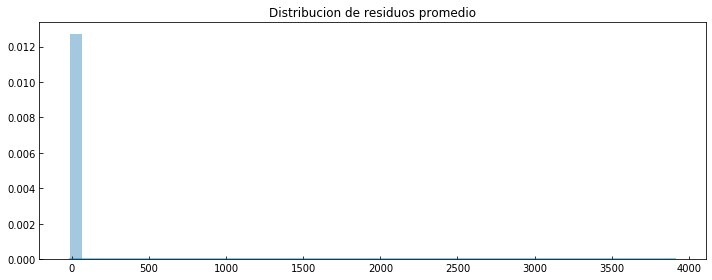

------------- Error -------------
RMSE (+-) =  2.2349599035316423
MAE  (+-) =  0.6297971273972314
------------- Smoothness -------------
AutoCorr lag-one =  0.6412921503852749
Diff MEAN =  0.21897870031967956
------------- Residual -------------
AutoCorr lag-one =  0.1767060269716349
Mean (+) STD = 0.181807 (+) 2.223085
---------------------------------------


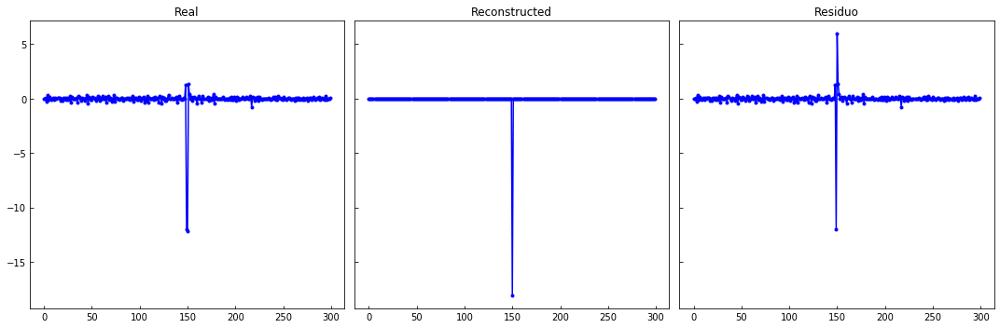

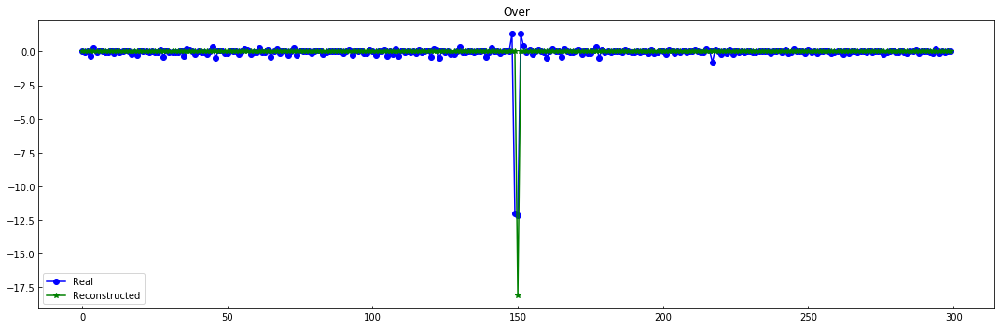

----------------------------------------------------------------


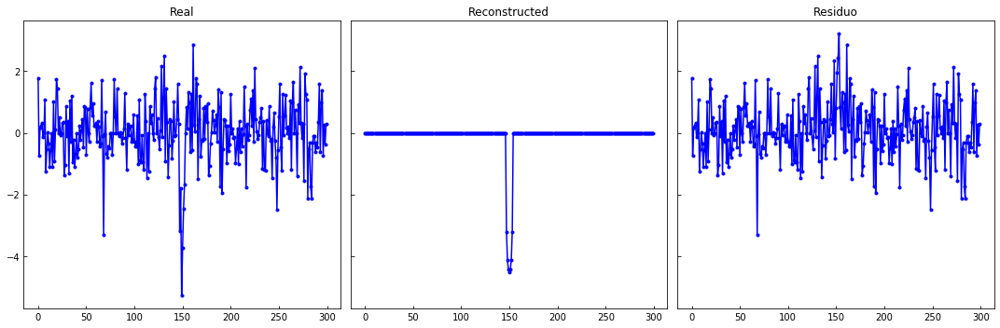

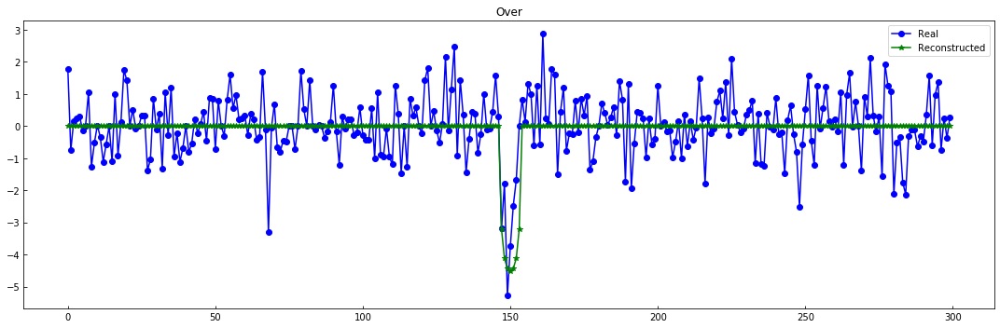

----------------------------------------------------------------


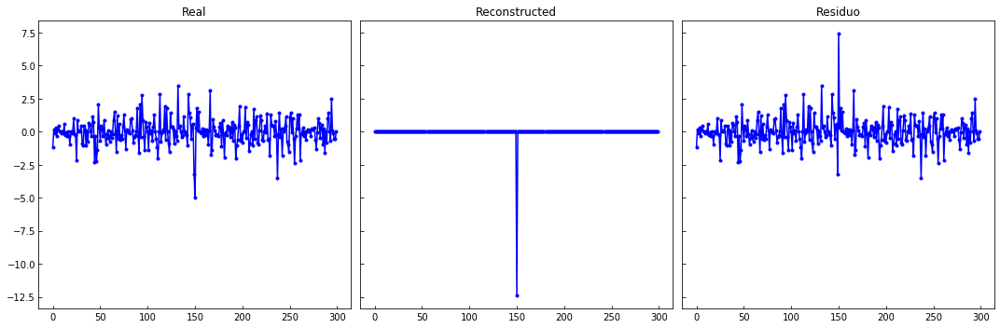

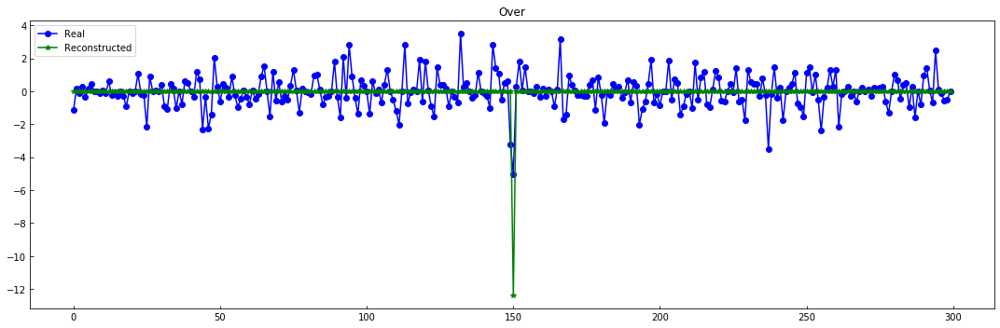

----------------------------------------------------------------


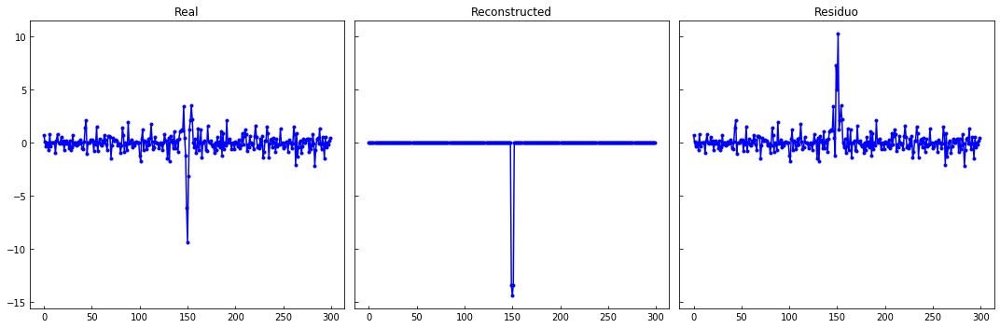

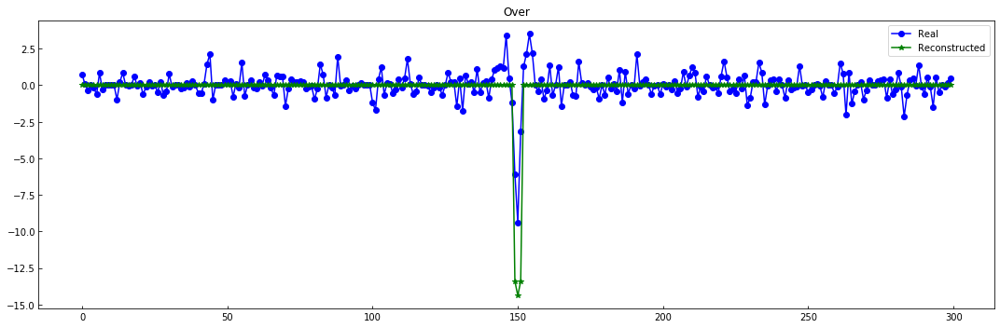

----------------------------------------------------------------


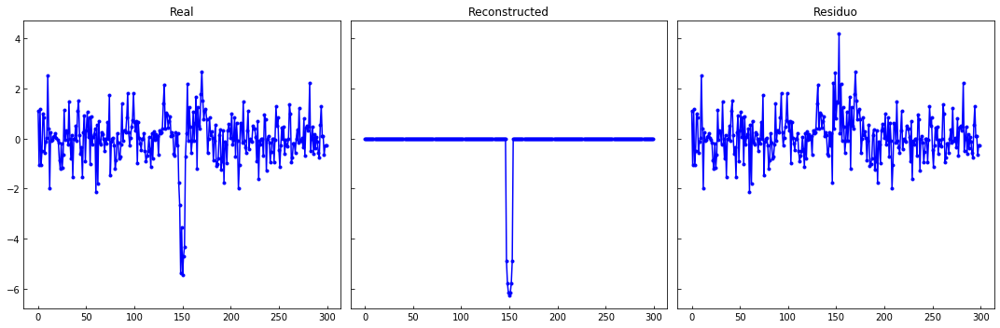

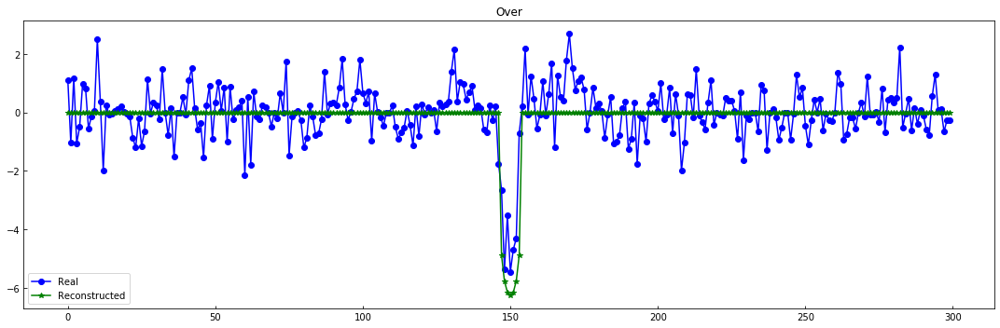

----------------------------------------------------------------


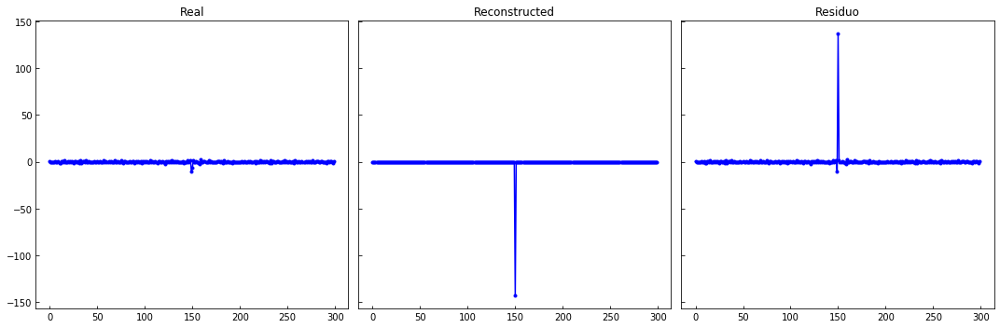

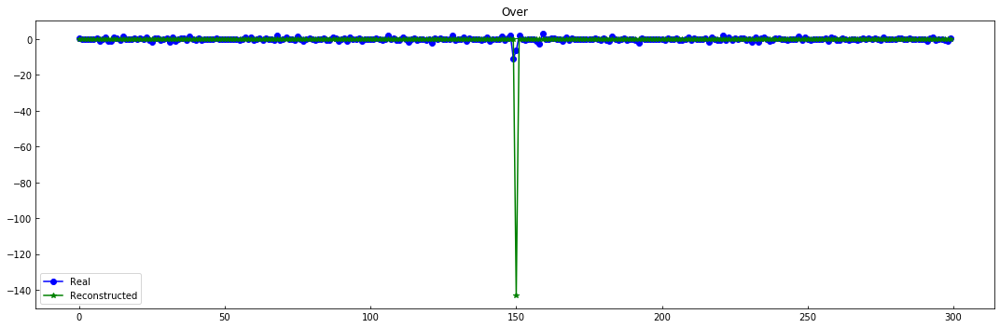

----------------------------------------------------------------


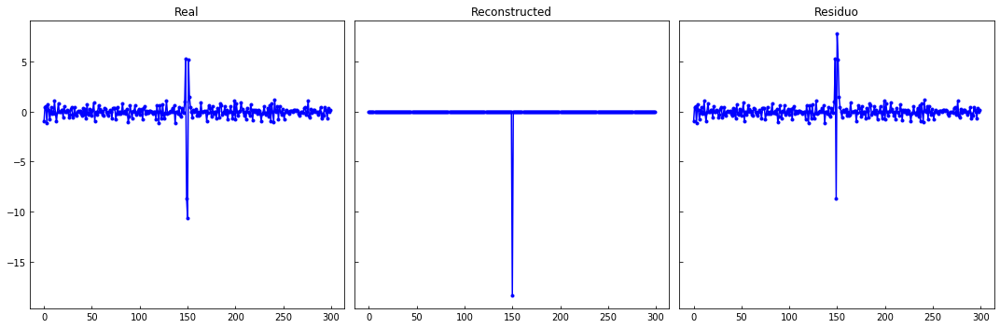

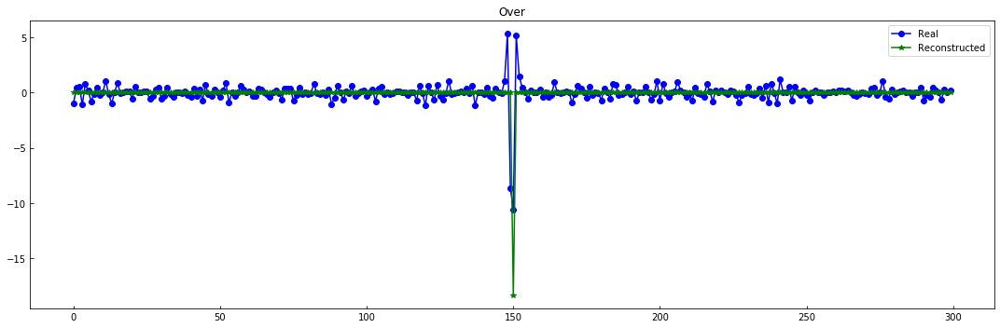

----------------------------------------------------------------


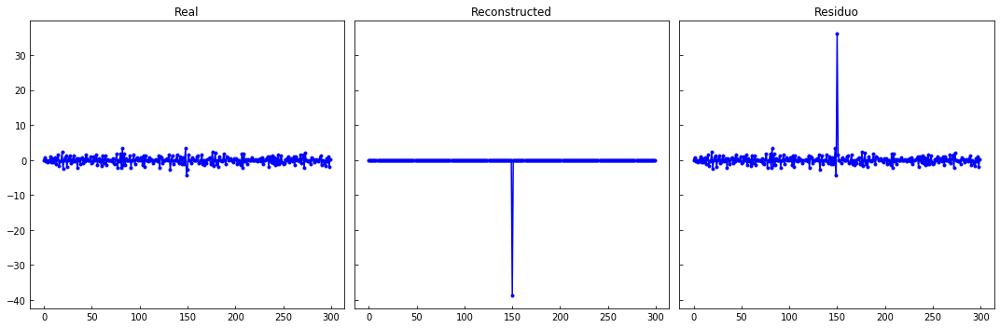

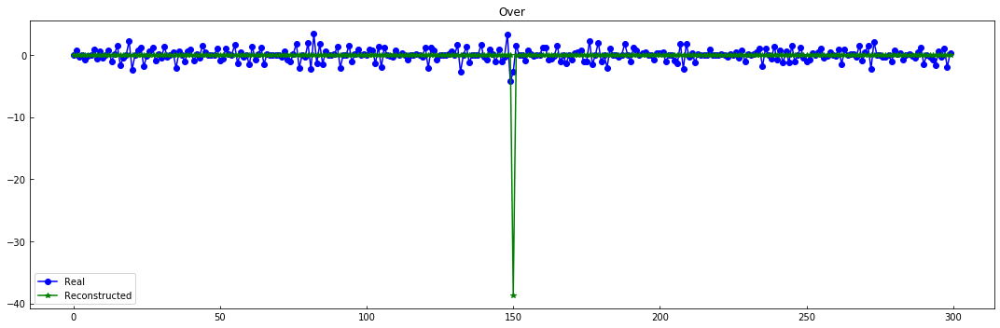

----------------------------------------------------------------


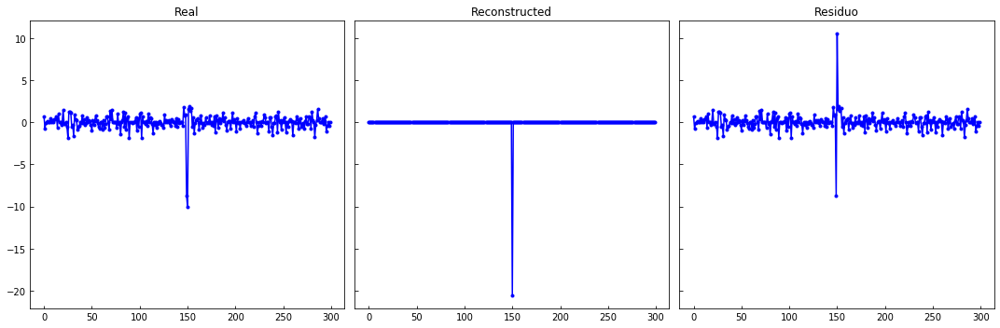

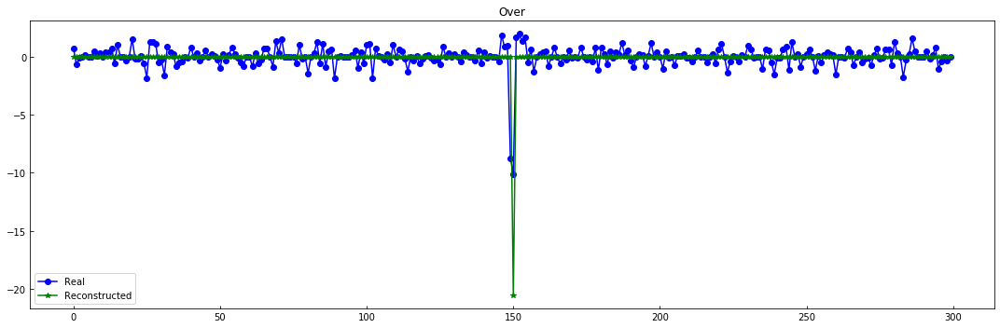

----------------------------------------------------------------


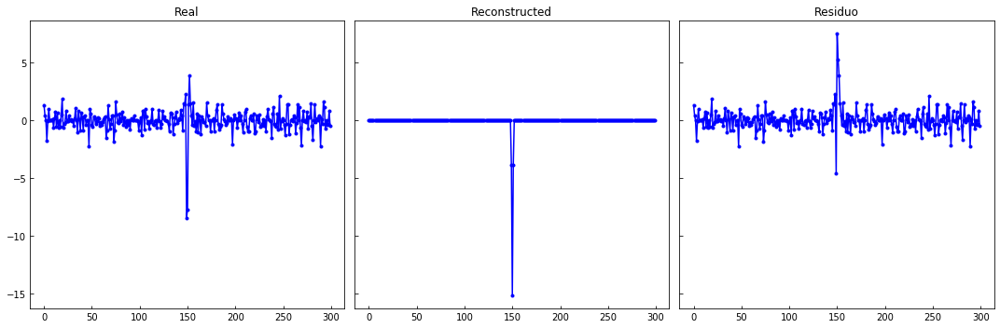

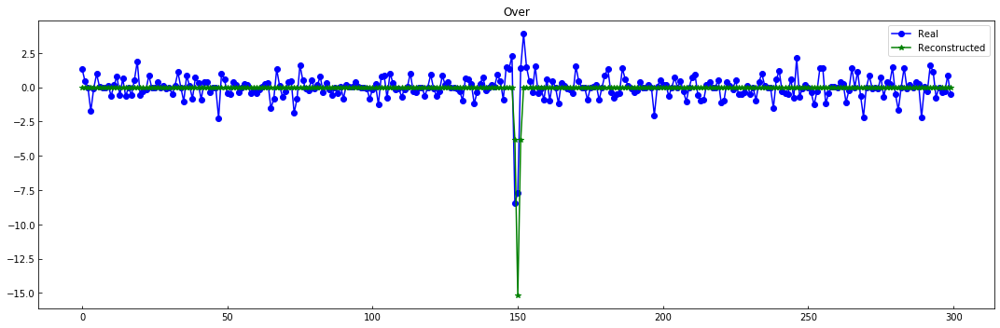

----------------------------------------------------------------


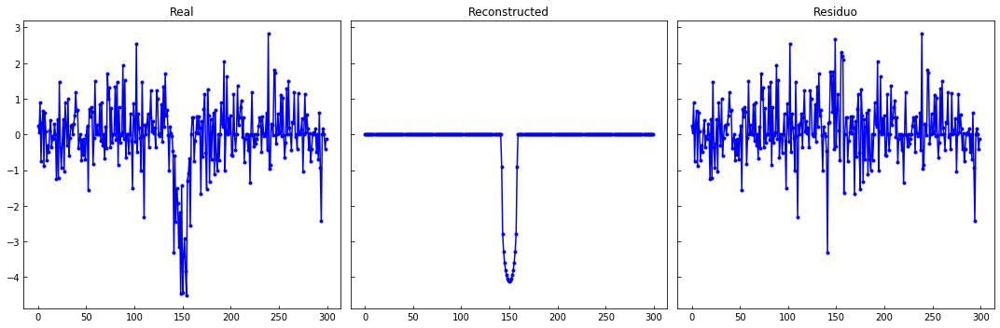

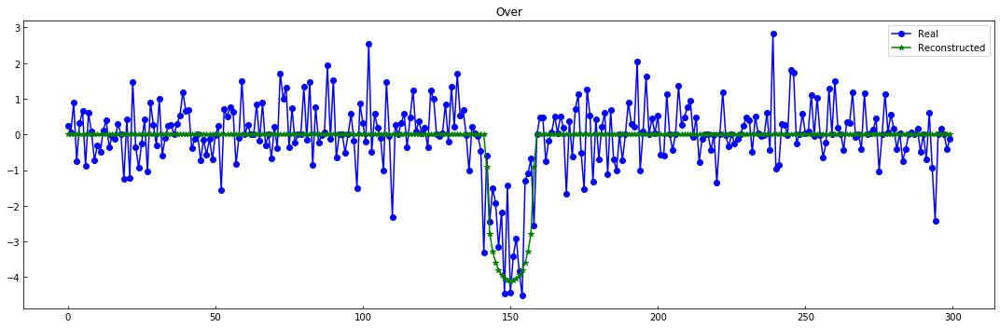

----------------------------------------------------------------


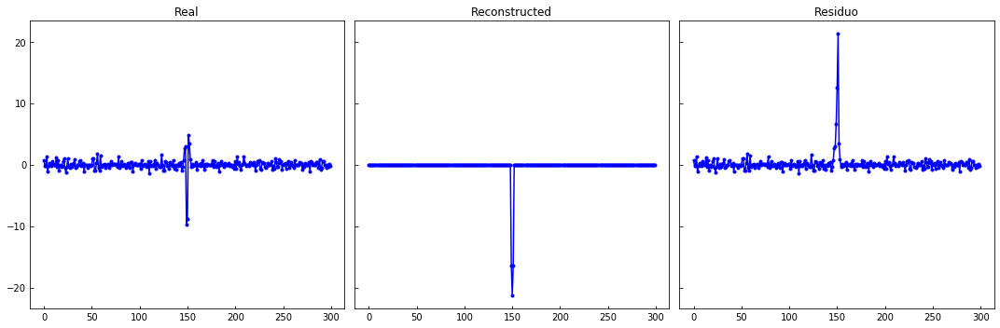

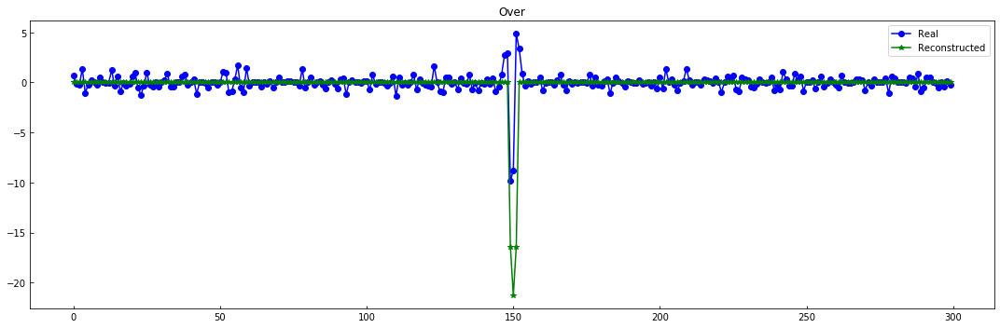

----------------------------------------------------------------


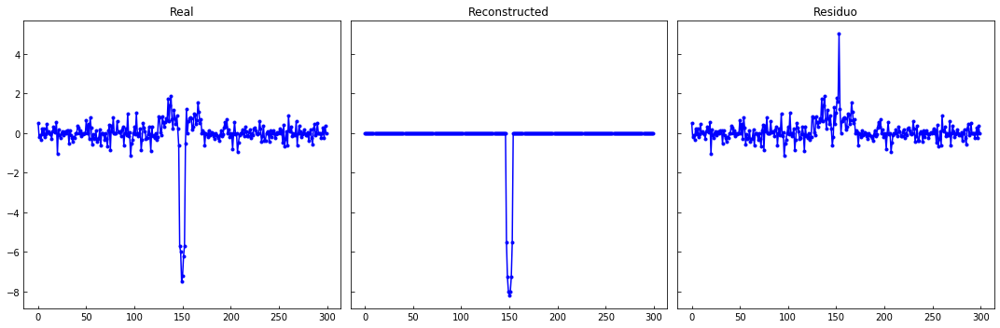

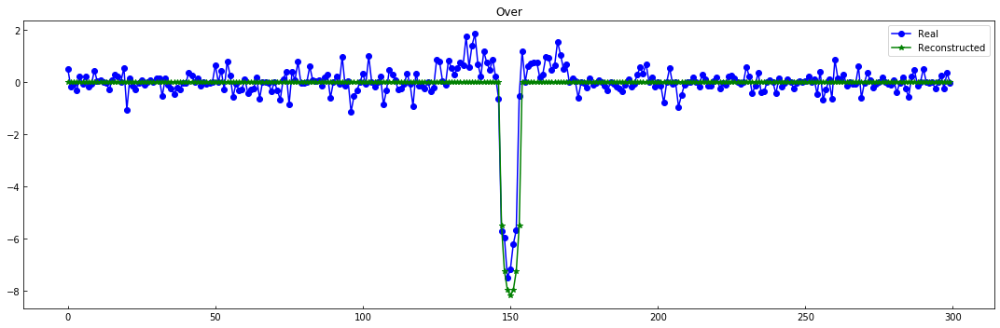

----------------------------------------------------------------


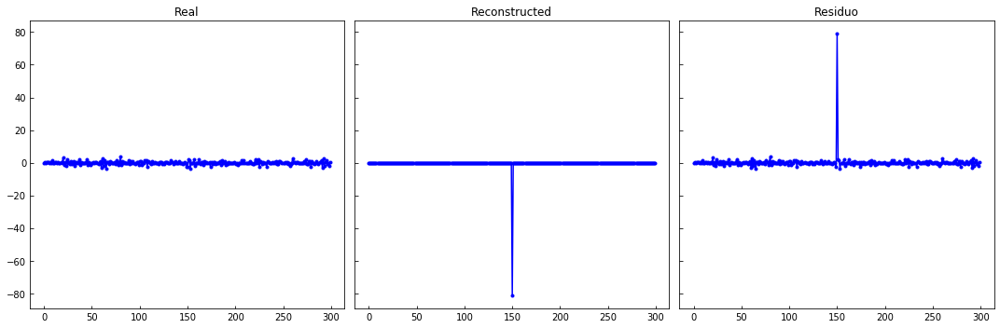

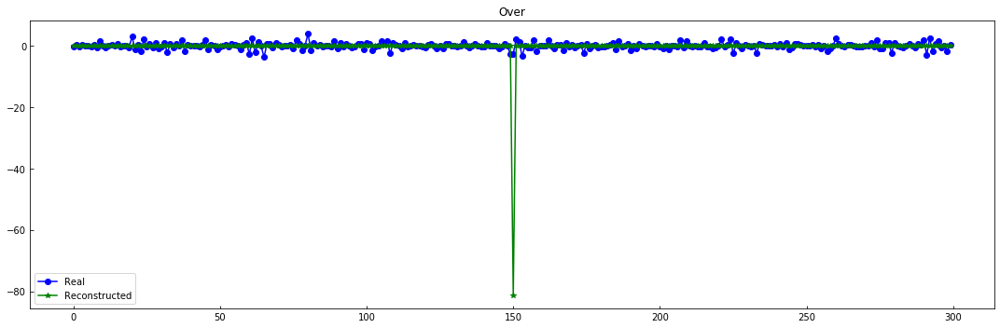

----------------------------------------------------------------


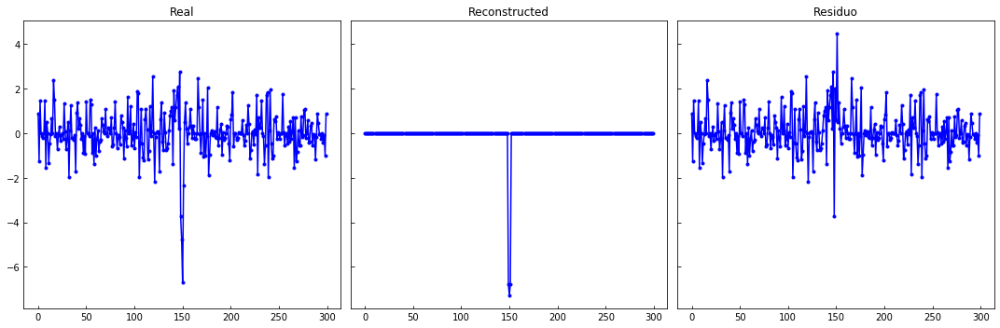

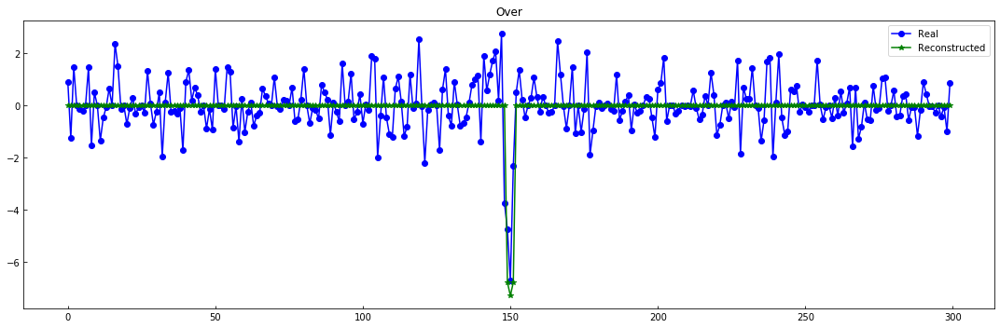

----------------------------------------------------------------


In [37]:
evaluate_reconst(X_train[:N], X_train_MA)

plot_n_lc(X_train[:N,:,0], X_train_MA, n= 15)

### Summary Reconstruction

|Técnicas| RMSE | MAE |.| AutoCorr| Diff Mean | Residuo corr| Residuo spectral-H|
|---     |---   |---  |---|---    |---        |---          |---                |
|Curva   | -    | -   |.|  0.27   | 0.78      |  ...        |  ...              |
|Passband 1-500|1.08|0.62|.|0.97  |0.05|
|Passband 50-1500|1.04|0.65|.|0.83|0.20|
|Passband 50-2500|0.96|0.64|.|0.67|0.36|
|Mov. avg (3)|0.72|0.46|.|0.70    |0.27|
|Mov. avg (5)|0.84|0.51|.|0.78    |0.17|
|Mov. avg (10)|0.94|0.55|.|0.84   |0.09|
|**AE-32**|0.83|0.50|.|0.44       |   0.18    |   0.14      |   0.88            |
|**VAE-32**|0.69|0.48|.|0.57      |   0.07    |  -0.04      |   0.90            |
|**VAE-32 (+scale)**|0.70|0.49|.|0.61|0.07    |  -0.04      |   0.90            |


|Técnicas| RMSE | MAE |.| AutoCorr| Diff Mean | Residuo corr| Residuo spectral-H|
|---     |---   |---  |---|---    |---        |---          |---                |
|**AE-16**|0.68|0.47|.|0.47       |   0.14    |  -0.03      |   0.90            |
|**VAE-16**|0.69|0.48|.|0.59      |   0.07    |  -0.05      |   0.90            |
|**VAE-16 (+scale)**|0.72|0.49|.|0.61|0.06    |  -0.01      |   0.90            |


* Es un buen denoising y + suave que su baseline(AE)
* Genera representación útil
* Autocorr y Diff mean para ver que tan suave es la curva
* Residuo numeros son para ver qué tanta información queda en el residuo

#### Mandel-Agol modelos
|Técnicas| RMSE | MAE |.| AutoCorr| Diff Mean | Residuo corr| Residuo spectral-H|
|---     |---   |---  |---|---    |---        |---          |---                |
|Curva   | -    | -   |.|0.27     |  0.78     |  ...        |  ...              |
|PyTransit|2.14|0.63  |.|0.49     |  0.20     |
|batman|2.34|0.63     |.|0.64     |  0.22     | 
|PySyZyGy|2.22|0.63   |.|0.66     |  0.22     | 
|PyLC|2.35|0.63       |.|0.64     |  0.22     | 

## Visualize encoded rep.

In [21]:
def transform_plot(model, data, just_plot=False):
    if just_plot:
        to_plot = data
    else:
        to_plot = model.fit_transform(data)
        
    plt.figure(figsize=(10,7))
    plt.scatter(to_plot[:,0],to_plot[:,1])
    plt.show()
    return to_plot

Y_transit = df_meta_obj.values[mask_transit]
labels_transit = df_meta["NExScI Disposition"].values[mask_transit]

In [16]:
## encode all.. not only transits..
encoder_all = vae.get_layer("encoder")
z_aux, z_var_aux = encoder_all.predict([X_train_t_all, X_train_all], batch_size=512)

#z_samp = samp_encoder.predict([X_train_t_all, X_train_all], batch_size=512)
z_aux.shape

NameError: name 'vae' is not defined

/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


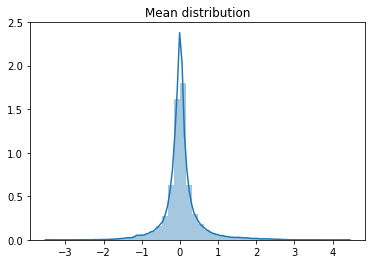

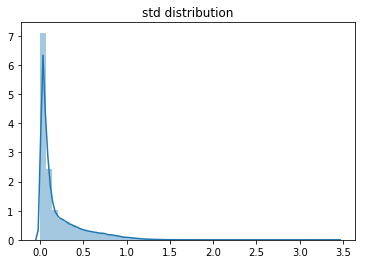

NameError: name 'z_samp' is not defined

In [37]:
sns.distplot(z_aux.flatten())
plt.title("Mean distribution")
plt.show()

sns.distplot(np.exp(z_var_aux.flatten()))
plt.title("std distribution")
plt.show()

sns.distplot(z_samp.flatten())
plt.title("Sampled distribution")
plt.show()

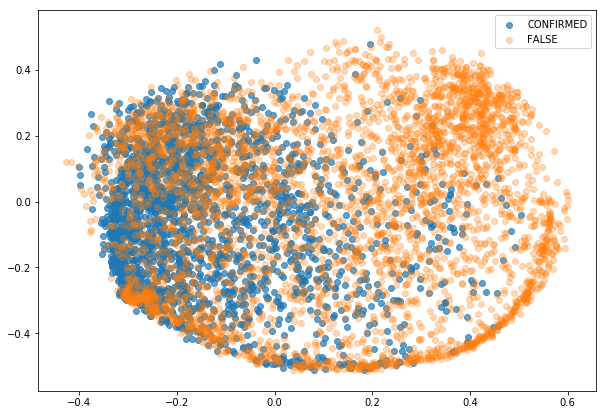

In [29]:
from sklearn.decomposition import KernelPCA
model = KernelPCA(2, kernel='rbf', gamma=None, n_jobs=-1)
    
to_plot = transform_plot(model, z_aux)

plt.figure(figsize=(10,7))
mask_ = (all_labels=="CONFIRMED")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="CONFIRMED", alpha=0.7)

mask_ = (all_labels=="FALSE POSITIVE")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="FALSE", alpha=0.3)

plt.legend()
plt.show()

#### Transit traineds

(4317, 32)


/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


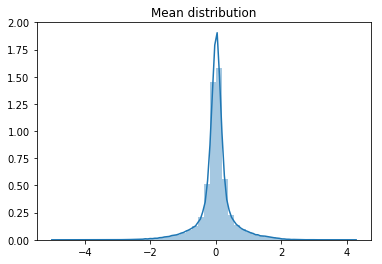

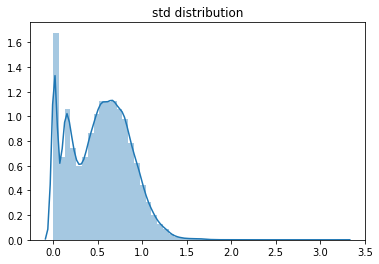

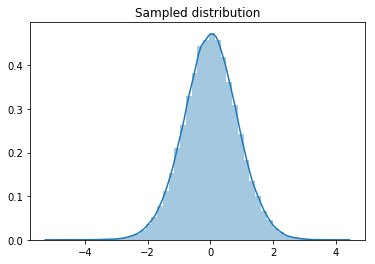

In [32]:
z_aux  = z_aux[mask_transit]
z_samp = z_samp[mask_transit]
print(z_aux.shape)

sns.distplot(z_aux.flatten())
plt.title("Mean distribution")
plt.show()

sns.distplot(np.exp(z_var_aux.flatten()))
plt.title("std distribution")
plt.show()

sns.distplot(z_samp.flatten())
plt.title("Sampled distribution")
plt.show()

/home/fmena/.local/lib/python3.5/site-packages/sklearn/utils/extmath.py:530: RuntimeWarning: invalid value encountered in multiply
  v *= signs[:, np.newaxis]


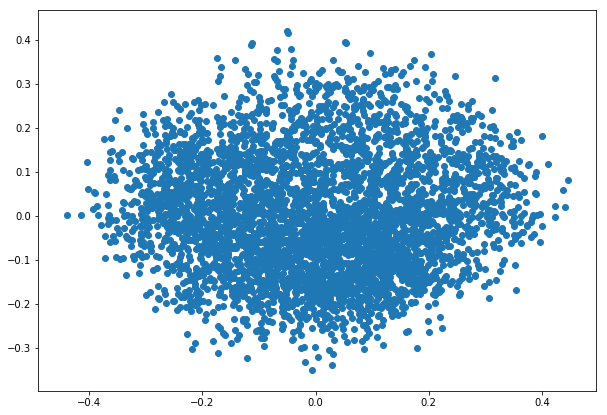

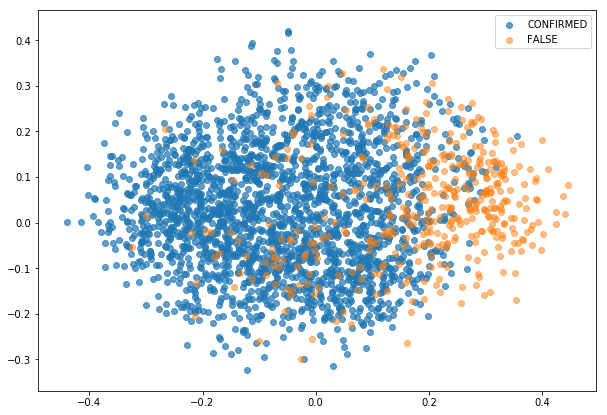

In [34]:
from sklearn.decomposition import KernelPCA
model = KernelPCA(2, kernel='rbf', gamma=None, n_jobs=-1)
    
to_plot = transform_plot(model, z_samp)

plt.figure(figsize=(10,7))
mask_ = (labels_transit=="CONFIRMED")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="CONFIRMED", alpha=0.7)

mask_ = (labels_transit=="FALSE POSITIVE")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="FALSE", alpha=0.5)

plt.legend()
plt.show()

In [43]:
np.save("./LC_features/VAE_%dT_%dD.npy"%(T,latent_dim), z_aux)
np.save("./LC_features/VAE_%dT_%dD_var.npy"%(T,latent_dim), z_var_aux)
#np.save("./LC_features/VAE_%dT_%dD_samp.npy"%(T,latent_dim), z_samp)
!ls ./LC_features

AE_300T_16D.npy		   FourierPCA_71427T_32D.npy  VAE_300T_16D_var.npy
FourierICA_300T_32D.npy    MetadataLC.npy	      VAE_300T_32D.npy
FourierICA_71427T_32D.npy  old			      VAE_300T_32D_var.npy
FourierPCA_300T_32D.npy    VAE_300T_16D.npy


### Fourier de Curva Escalada

In [17]:
### la escala del input si importa
Inp = X_fold_lc[:,:]/np.std(X_fold_lc[:,:], axis=1, keepdims=True)

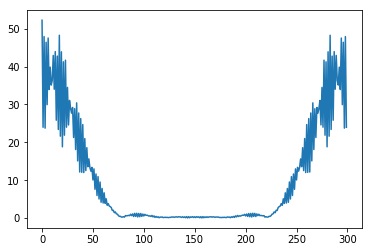

array([[26.15778101, 26.04342591, 25.42862911, ..., 24.78266268,
        25.42862911, 26.04342591],
       [11.53003706,  7.5604995 ,  5.04928396, ..., 12.72903347,
         5.04928396,  7.5604995 ],
       [22.731563  ,  5.4075442 ,  6.14663298, ...,  7.88298837,
         6.14663298,  5.4075442 ],
       ...,
       [ 9.55810768,  7.57454392, 25.27369647, ..., 39.07797339,
        25.27369647,  7.57454392],
       [ 1.08107583, 14.49249349,  9.27975872, ...,  3.85577001,
         9.27975872, 14.49249349],
       [14.65787274, 22.7791096 , 56.92800048, ..., 74.25877218,
        56.92800048, 22.7791096 ]])

In [152]:
X_fft = np.abs( np.fft.fft(Inp, axis=1) )
plt.plot(X_fft[3])
plt.show()
X_fft

In [153]:
from sklearn.preprocessing import StandardScaler
std = StandardScaler()
X_fft_std = std.fit_transform(X_fft)
X_fft_std.shape

(8054, 300)

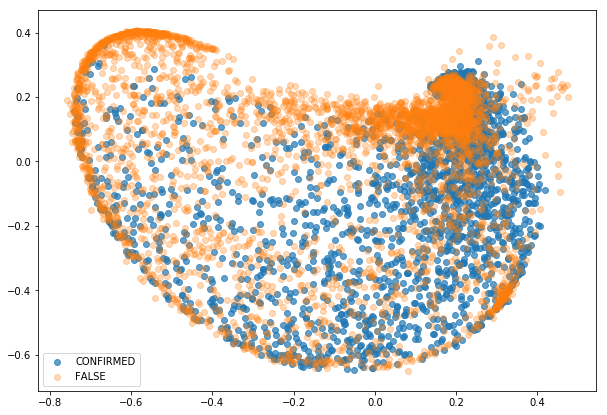

In [155]:
from sklearn.decomposition import KernelPCA
model = KernelPCA(2, kernel='rbf', gamma=None, n_jobs=-1)    
to_plot = model.fit_transform(X_fft_std)

plt.figure(figsize=(10,7))
mask_ = (all_labels=="CONFIRMED")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="CONFIRMED", alpha=0.7)

mask_ = (all_labels=="FALSE POSITIVE")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="FALSE", alpha=0.3)

plt.legend()
plt.show()

In [157]:
#save feautures of pca
from sklearn.decomposition import PCA, FastICA
model = PCA(n_components=latent_dim)
X_fft_save = model.fit_transform(X_fft_std)
np.save("./LC_features/FourierPCA_%dT_%dD.npy"%(T,latent_dim), X_fft_save)

model = FastICA(n_components=latent_dim)
X_fft_save = model.fit_transform(X_fft_std)
np.save("./LC_features/FourierICA_%dT_%dD.npy"%(T,latent_dim), X_fft_save)

!ls ./LC_features

FourierICA_300T_32D.npy  VAE_300T_32D.npy
FourierPCA_300T_32D.npy  VAE_300T_32D_samp.npy


/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/sklearn/decomposition/fastica_.py:118: UserWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn('FastICA did not converge. Consider increasing '


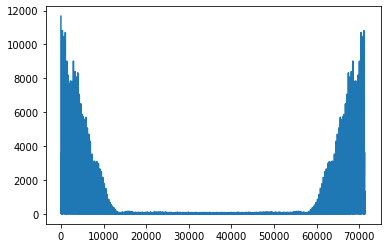

AE_300T_32D.npy		     FourierPCA_71427T_32D.npy
FourierICA_300T_32D.npy      MetadataLC.npy
FourierICA_71427T_1800D.npy  VAE_300T_32D.npy
FourierICA_71427T_32D.npy    VAE_300T_32D_samp.npy
FourierPCA_300T_32D.npy      VAE_scale_300T_32D.npy
FourierPCA_71427T_1800D.npy  VAE_scale_300T_32D_samp.npy


In [17]:
#save feautures of pca of all LC
process_lc = np.load(folder_lc+'/cleaned/LC_kepler_processed.npy')
process_lc = np.nan_to_num(process_lc) #borrar nans... arreglo variable

Inp = process_lc/np.std(process_lc, axis=1, keepdims=True)
X_fft = np.abs( np.fft.fft(Inp, axis=1) )
plt.plot(X_fft[3])
plt.show()

from sklearn.preprocessing import StandardScaler
std = StandardScaler()
X_fft_std = std.fit_transform(X_fft)
X_fft_std.shape

D= 30*30*2 #latent_dim

from sklearn.decomposition import PCA, FastICA
model = PCA(n_components=D)
X_fft_save = model.fit_transform(X_fft_std)
np.save("./LC_features/FourierPCA_%dT_%dD.npy"%(X_fft_std.shape[1],D), X_fft_save)

model = FastICA(n_components=D)
X_fft_save = model.fit_transform(X_fft_std)
np.save("./LC_features/FourierICA_%dT_%dD.npy"%(X_fft_std.shape[1],D), X_fft_save)

!ls ./LC_features

### Metadata desde curva (manuales, especializados)
* Period 
* Duration 
* Time of Transit Epoch (T0)
* r/R
* a/R
* Inclination -- se deriva desde "a/R" e Impact
* Impact Parameter (circular)
* Teq (?) -- al parecer se necesita info d la estrella..
* Fitted Stellar Density: depends only on the transit's period, depth, and duration (see Seager and Mallen-Ornelas 2003).
* Limb Darkening Coeff1 (con informacion de la estrella - aunque podrian haber sido obtenidas )
* Limb Darkening Coeff2 (con informacion de la estrella - aunque podrian haber sido obtenidas )

https://exoplanetarchive.ipac.caltech.edu/docs/API_kepcandidate_columns.html
* Ingress: (nulos):

In [35]:
metadata_LC = df_meta_obj.iloc[:,:11]
metadata_LC.drop(["Teq"], axis=1, inplace=True)
metadata_LC

/opt/ohpc/pub/moduledeps/anaconda3/lib/python3.7/site-packages/pandas/core/frame.py:3940: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  errors=errors)


,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Impact Parameter,Fitted Stellar Density,Limb Darkening Coeff1,Limb Darkening Coeff2
0,8.884923,0.086252,169.991686,0.114,36.466,89.89,0.069,11.62061,0.497,0.204
1,5.092465,0.152458,357.535940,0.014,10.670,89.14,0.161,0.88510,0.551,0.165
2,275.073650,0.140417,315.248600,0.014,512.000,89.93,0.595,33.55994,0.437,0.243
3,8.460439,0.197288,133.774490,0.478,14.087,85.68,1.061,0.73874,0.299,0.306
4,21.761298,0.051792,166.540438,0.032,137.070,89.95,0.123,102.86534,0.627,0.108
5,4.287467,0.065388,262.062450,0.026,19.940,88.93,0.374,8.16471,0.517,0.191
6,0.539366,0.226417,131.974570,0.016,1.012,12.57,0.988,0.06737,0.314,0.304
7,36.267167,0.086042,155.081300,0.022,134.100,89.91,0.214,34.69388,0.644,0.101
8,4.298920,0.114458,132.861870,0.020,3.810,75.22,0.972,0.05666,0.526,0.186
9,161.788327,0.221250,214.039000,0.273,289.800,89.95,0.267,17.58377,0.373,0.283


In [187]:
from sklearn.preprocessing import StandardScaler, RobustScaler
std = StandardScaler()
X_metadata = std.fit_transform(metadata_LC.values)
X_metadata.shape

(8054, 10)

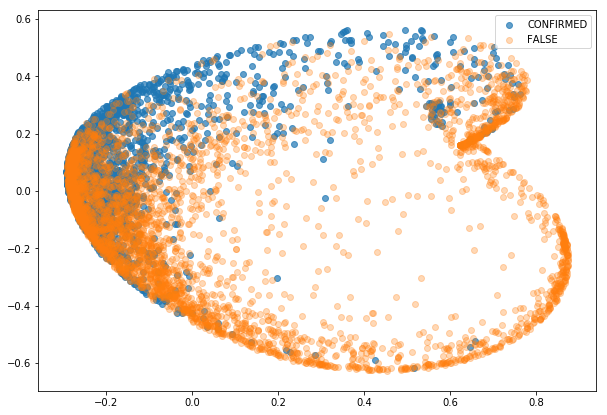

In [165]:
from sklearn.decomposition import KernelPCA
model = KernelPCA(2, kernel='rbf', gamma=None, n_jobs=-1)    
to_plot = model.fit_transform(X_metadata)

plt.figure(figsize=(10,7))
mask_ = (all_labels=="CONFIRMED")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="CONFIRMED", alpha=0.7)

mask_ = (all_labels=="FALSE POSITIVE")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="FALSE", alpha=0.3)

plt.legend()
plt.show()

In [36]:
#save features of all X-- avisar a cony y a pato
np.save("./LC_features/MetadataLC.npy", metadata_LC.values)
!ls ./LC_features

AE_300T_32D.npy		   MetadataLC.npy
FourierICA_300T_32D.npy    VAE_300T_32D.npy
FourierICA_71427T_32D.npy  VAE_300T_32D_samp.npy
FourierPCA_300T_32D.npy    VAE_scale_300T_32D.npy
FourierPCA_71427T_32D.npy  VAE_scale_300T_32D_samp.npy


---
## AE 
---

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
T_inp (InputLayer)              (None, 300, 1)       0                                            
__________________________________________________________________________________________________
LC_inp (InputLayer)             (None, 300, 1)       0                                            
__________________________________________________________________________________________________
encoder (Model)                 (None, 16)           26768       T_inp[0][0]                      
                                                                 LC_inp[0][0]                     
__________________________________________________________________________________________________
generator (Model)               (None, 300, 1)       28673       T_inp[0][0]                      
          

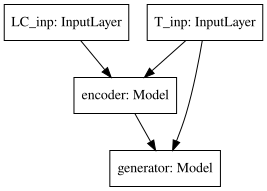

In [17]:
x_lc = Input(shape = (T, channels) , name="LC_inp")
x_t = Input(shape = (T, 1) , name ="T_inp")

x = Concatenate(axis=-1)([x_t, x_lc]) #add time encode

f1 = Bidirectional(get_GRU(32, return_sequences=True))(x) #bidirectional
f1 = Bidirectional(get_GRU(32, return_sequences=False))(f1) #bidirectional

z = Dense(latent_dim,activation='linear')(f1)
encoder = Model([x_t, x_lc], z, name="encoder")

decoder_input = Input(shape=(latent_dim,))
decode = RepeatVector(T)(decoder_input)

decode = Concatenate(axis=-1)([x_t, decode]) #add time decode

decode = Bidirectional(get_GRU(32, return_sequences=True))(decode) #bidirectional
decode = Bidirectional(get_GRU(32, return_sequences=True))(decode) #bidirectional

decode = TimeDistributed(Dense(1, activation='linear'))(decode)
generator = Model([x_t, decoder_input], decode, name="generator")

# instantiate VAE model
out = generator([x_t, encoder([x_t, x_lc]) ])
AE_m = Model([x_t, x_lc], out)

AE_m.get_layer("encoder").load_weights("./models/AE_%dT_%dD_%de_E_simp.h5"%(T,latent_dim,EPOCHS))
AE_m.get_layer("generator").load_weights("./models/AE_%dT_%dD_%de_D_simp.h5"%(T,latent_dim,EPOCHS))

AE_m.summary()
SVG(model_to_dot(AE_m).create(prog='dot', format='svg'))

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


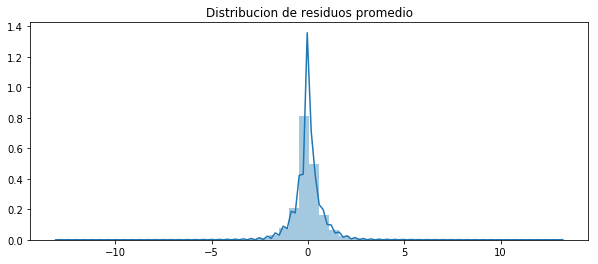

------------- Error -------------
RMSE (+-) =  0.677532935883335
MAE  (+-) =  0.4620511404520929
------------- Smoothness -------------
AutoCorr lag-one =  0.48620948
Diff MEAN =  0.18091129
------------- Residual -------------
AutoCorr lag-one =  -0.006636625660466418
Mean (+) STD = 0.006551 (+) 0.677104
---------------------------------------


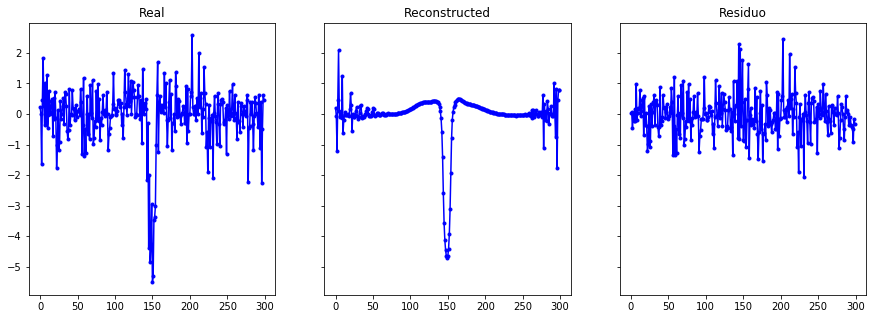

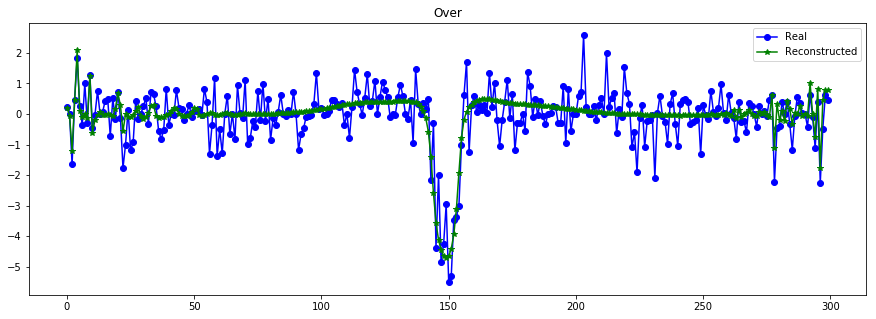

----------------------------------------------------------------


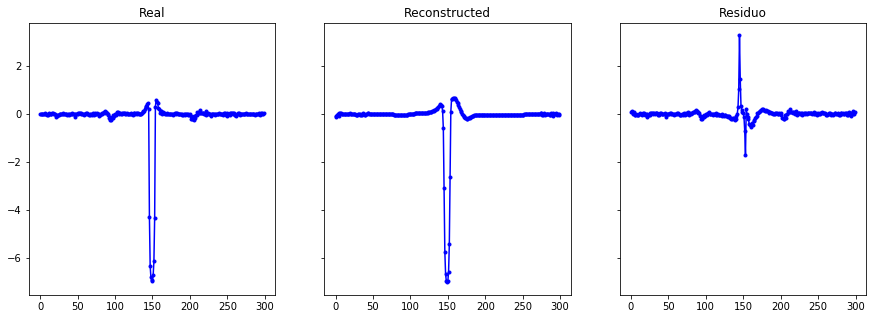

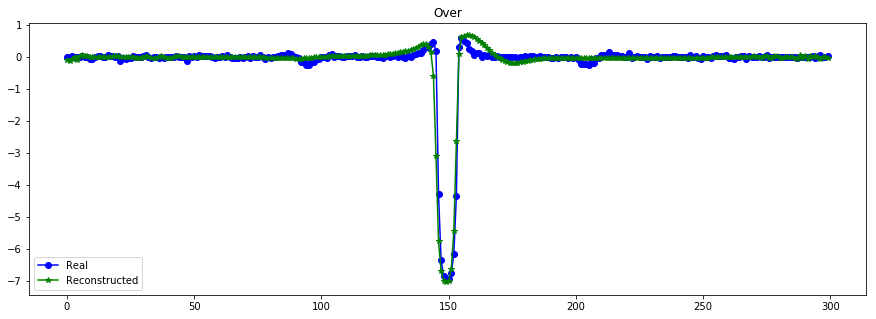

----------------------------------------------------------------


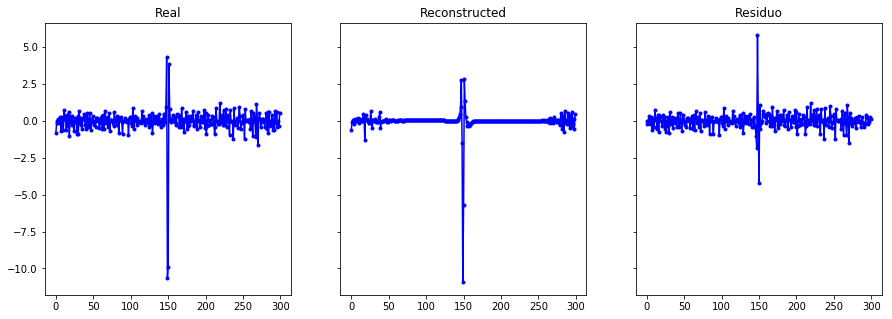

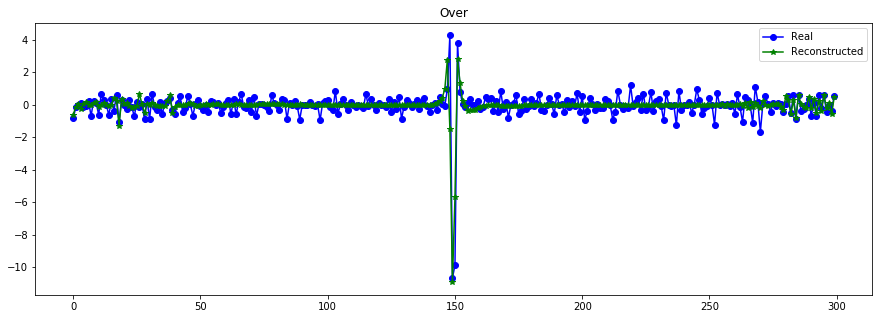

----------------------------------------------------------------


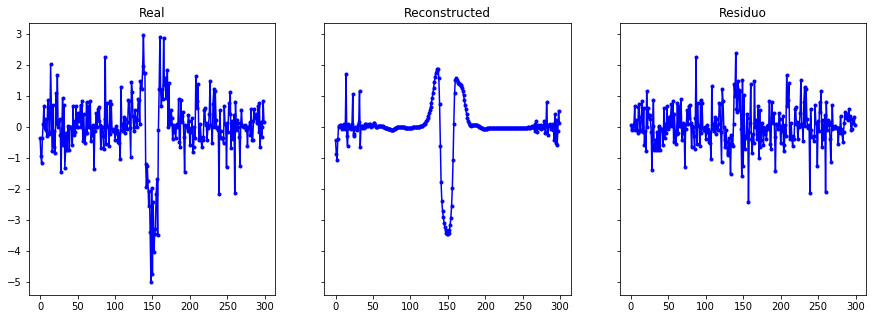

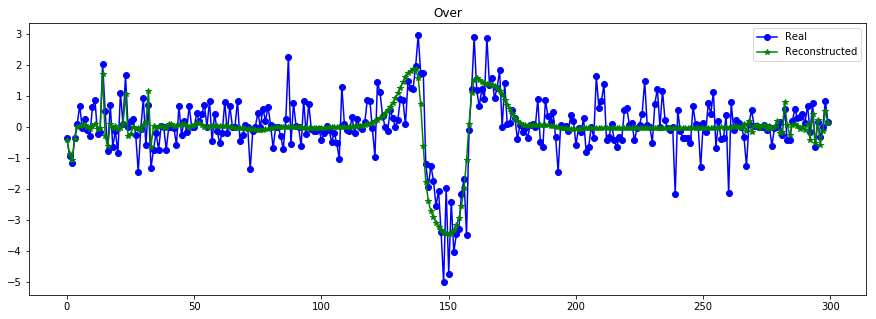

----------------------------------------------------------------


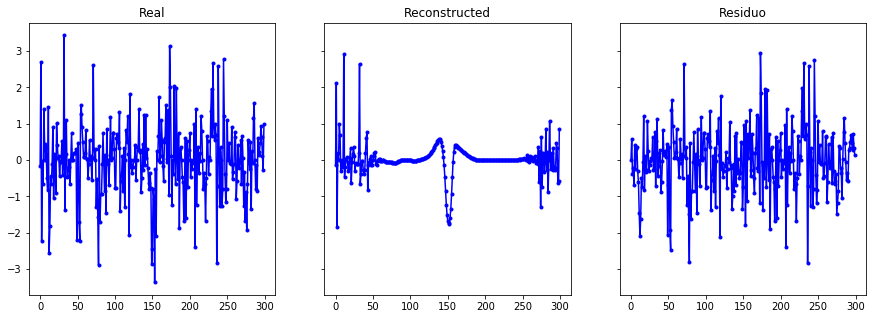

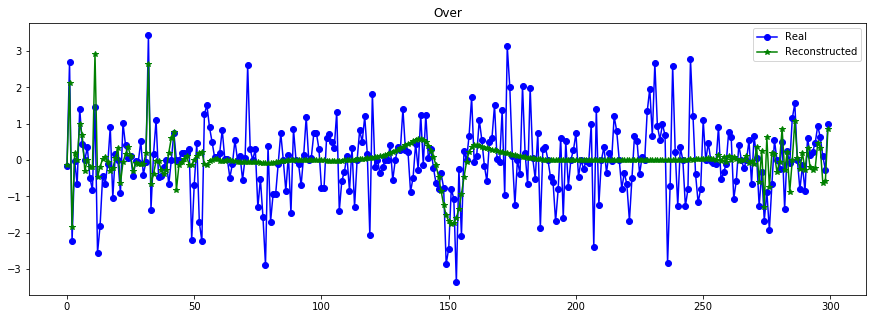

----------------------------------------------------------------


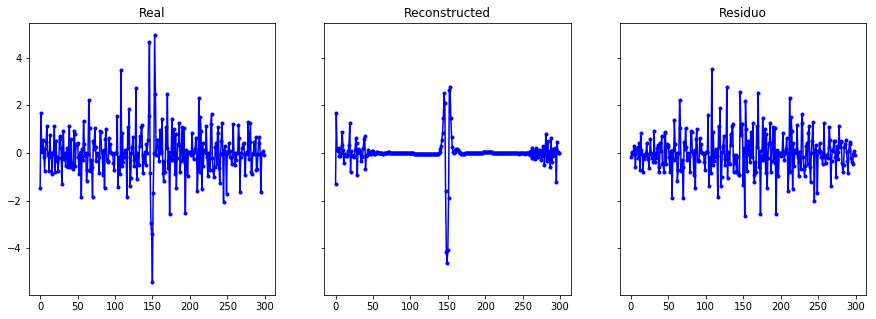

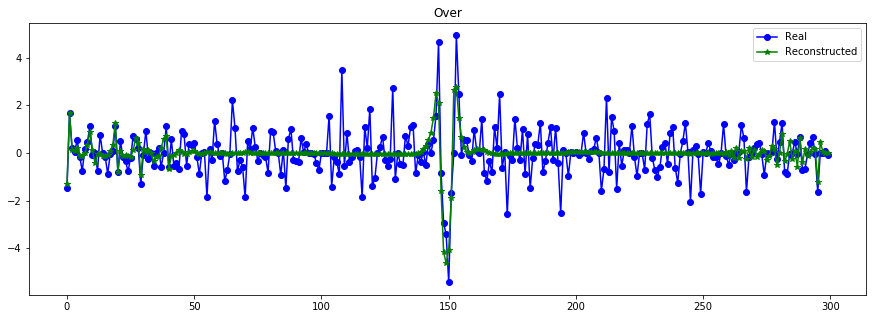

----------------------------------------------------------------


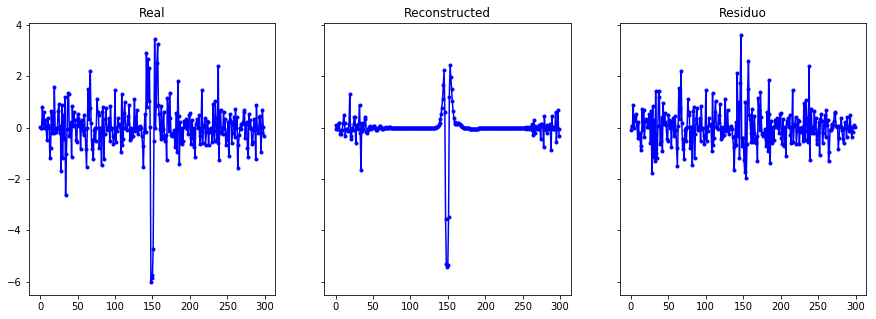

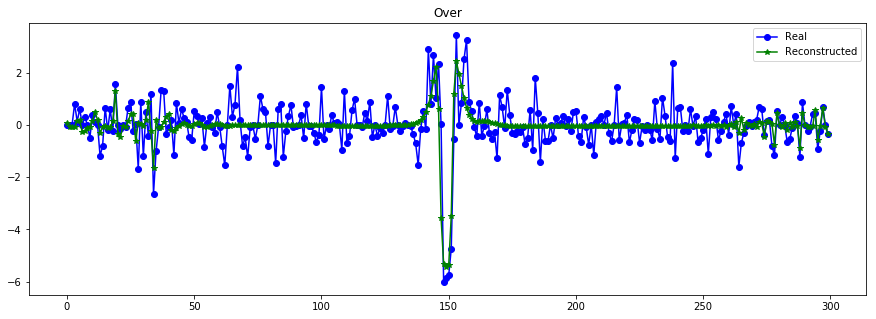

----------------------------------------------------------------


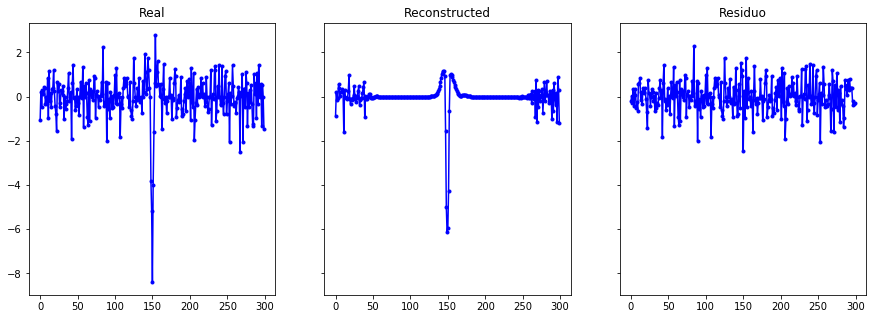

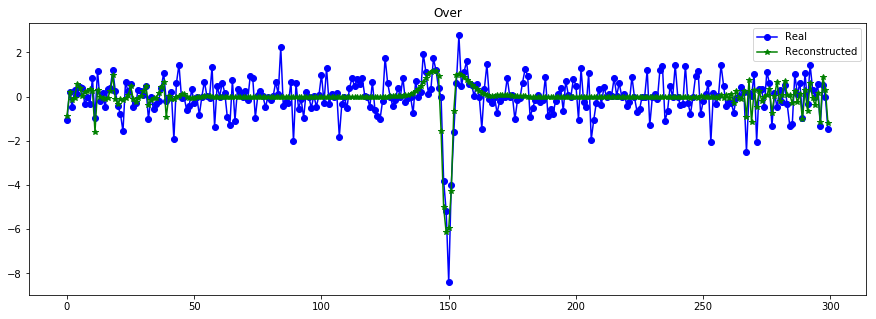

----------------------------------------------------------------


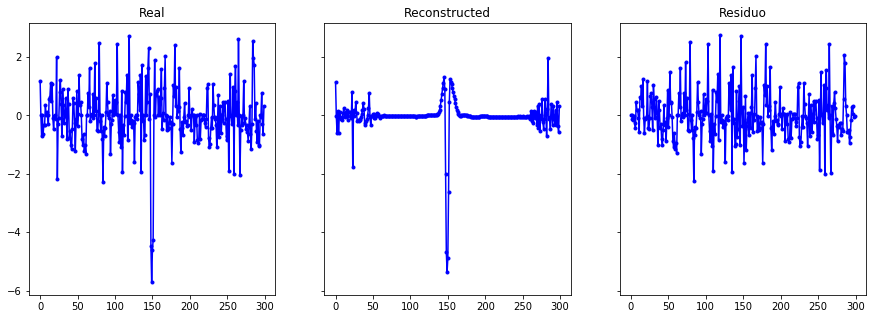

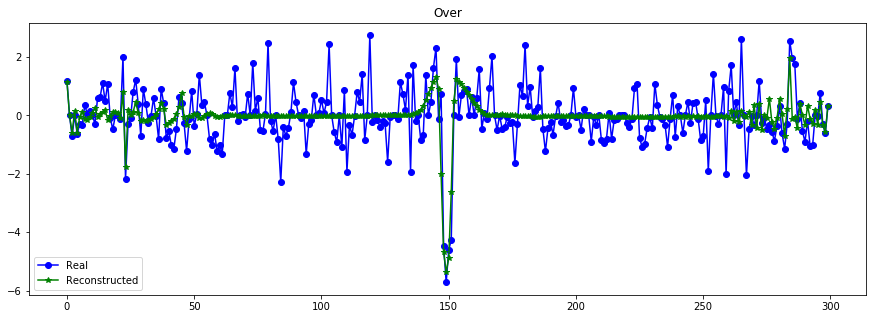

----------------------------------------------------------------


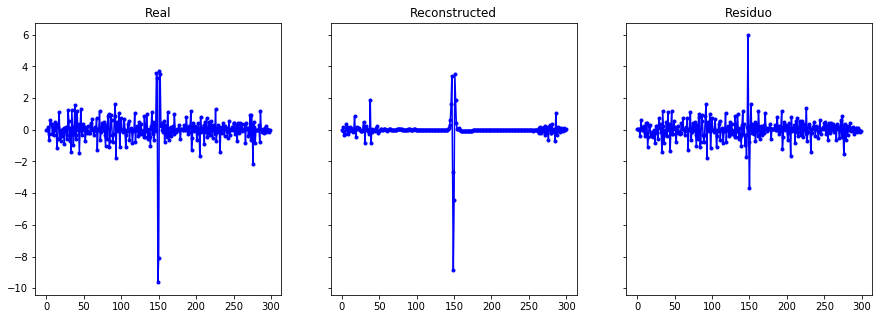

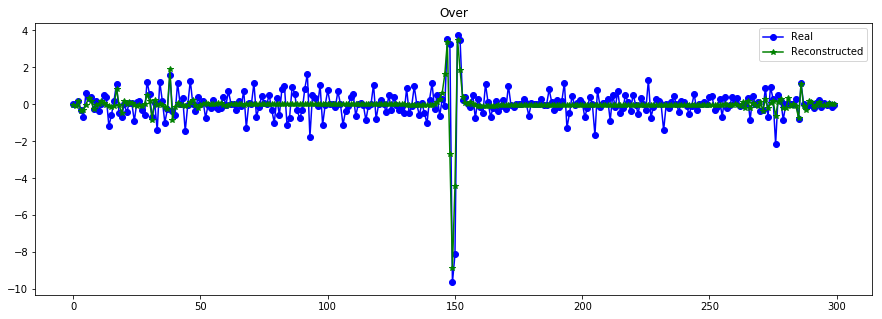

----------------------------------------------------------------


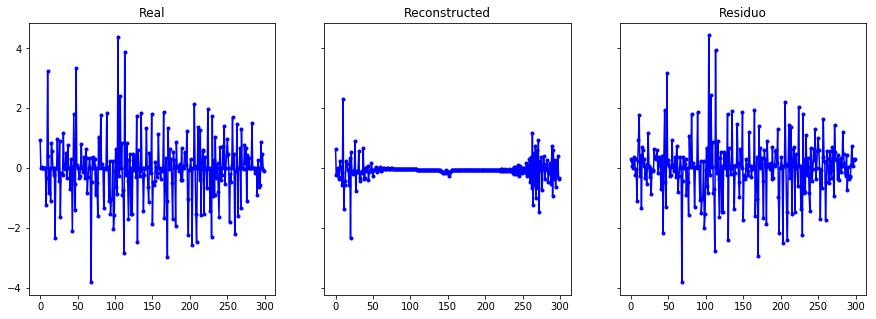

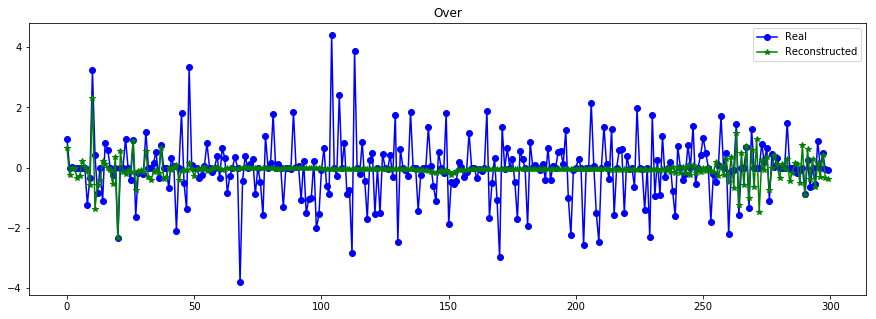

----------------------------------------------------------------


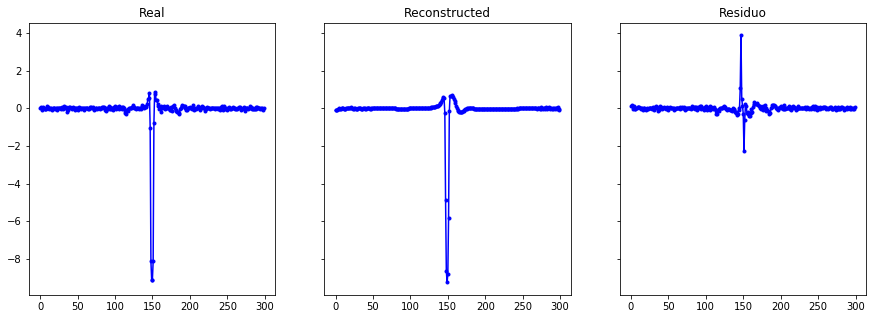

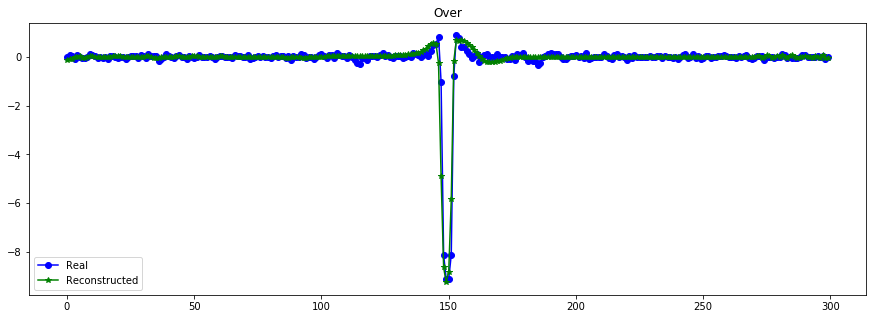

----------------------------------------------------------------


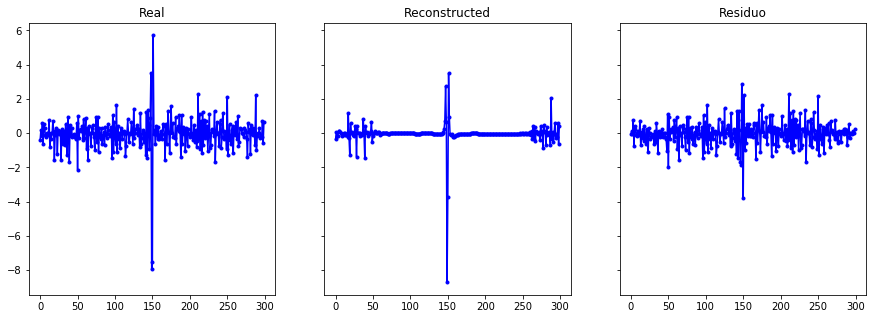

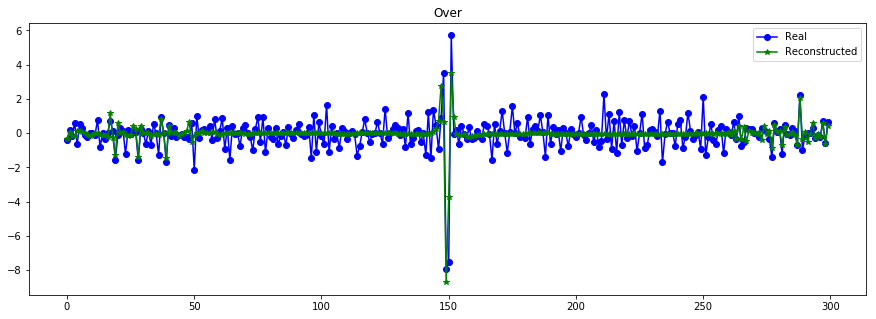

----------------------------------------------------------------


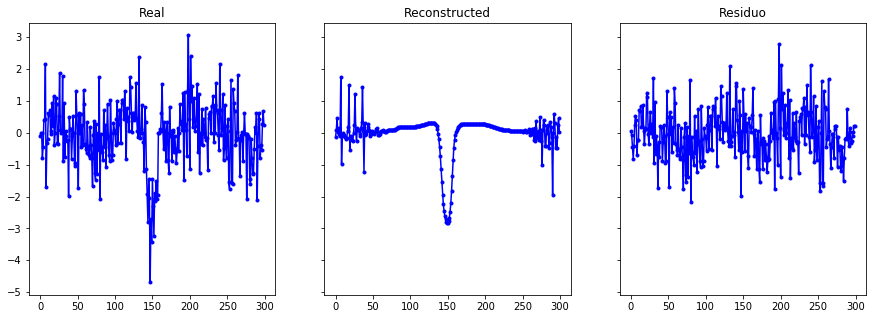

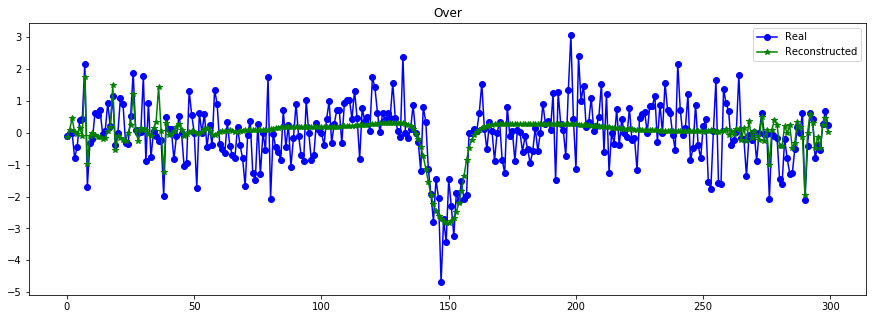

----------------------------------------------------------------


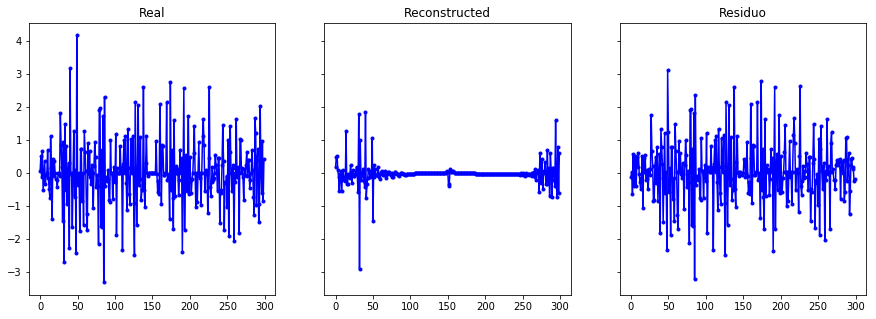

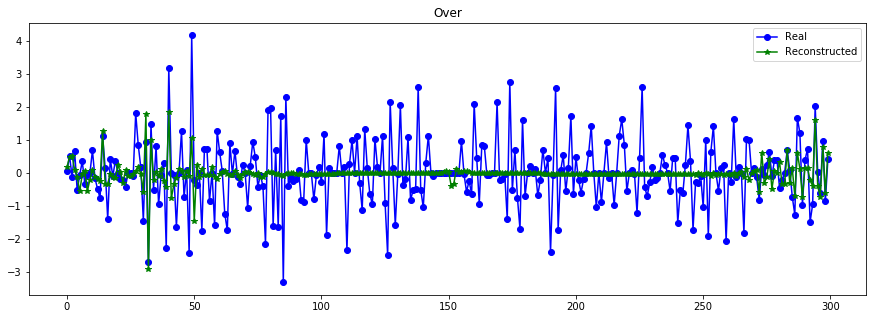

----------------------------------------------------------------


In [18]:
X_train_hat = AE_m.predict([X_train_t[:N], X_train[:N]], batch_size=512)
evaluate_reconst(X_train[:N], X_train_hat)

plot_n_lc(X_train[:N,:,0], X_train_hat, n= 15)

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


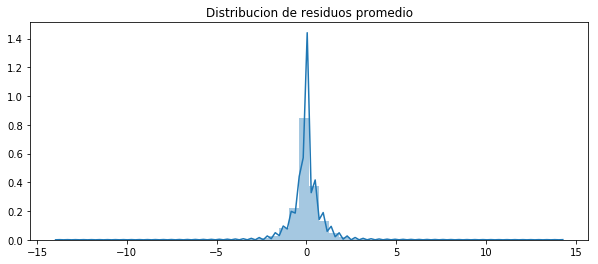

------------- Error -------------
RMSE (+-) =  0.6876326797239793
MAE  (+-) =  0.47494904781403813
------------- Smoothness -------------
AutoCorr lag-one =  0.4957904
Diff MEAN =  0.129926
------------- Residual -------------
AutoCorr lag-one =  -0.009776267132857489
Mean (+) STD = 0.006188 (+) 0.687100
---------------------------------------


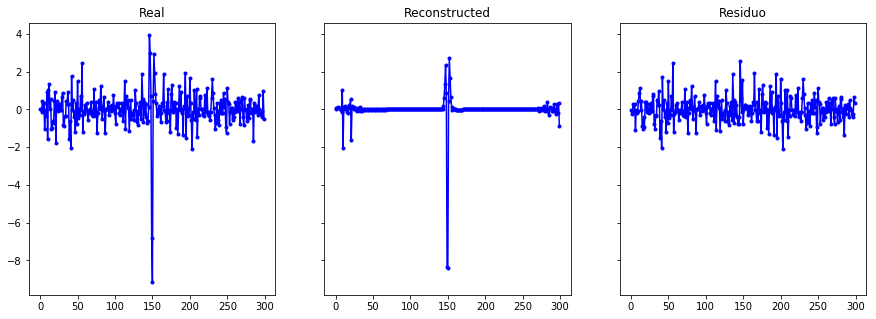

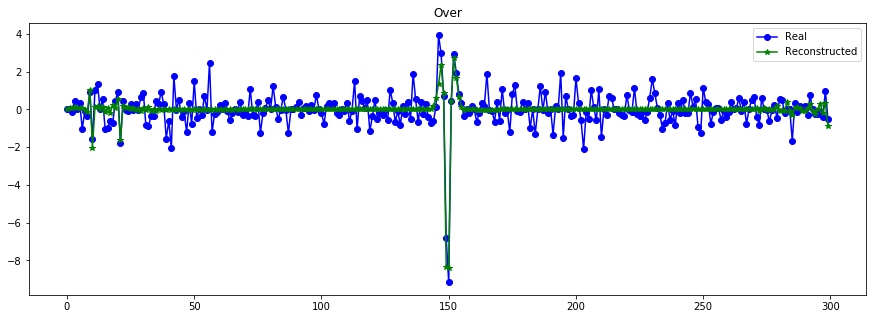

----------------------------------------------------------------


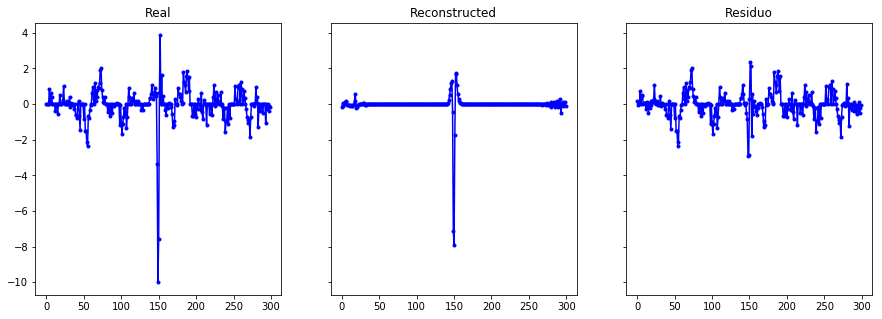

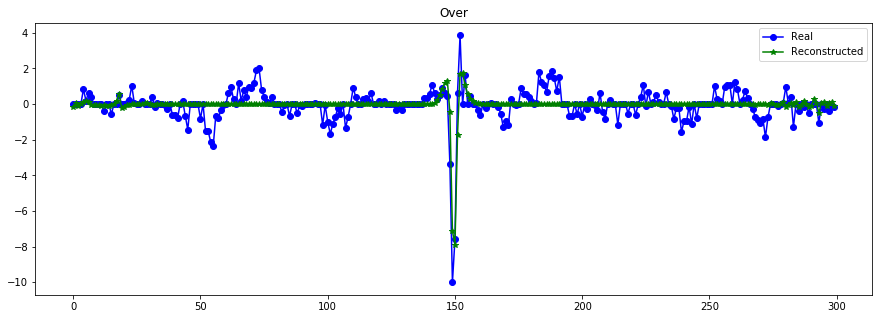

----------------------------------------------------------------


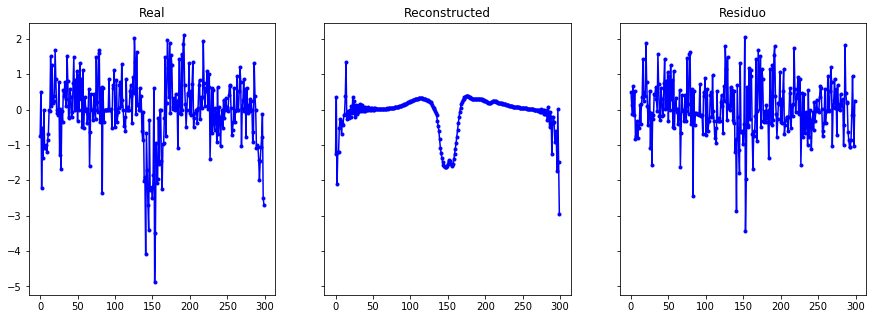

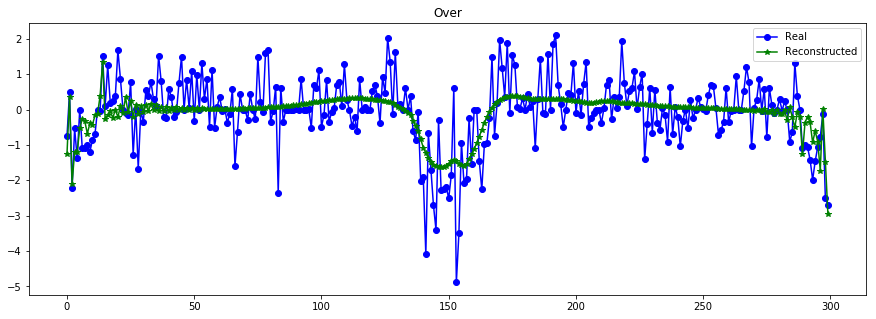

----------------------------------------------------------------


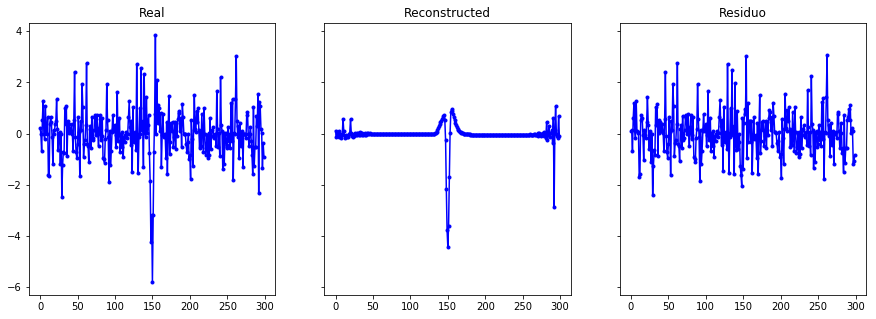

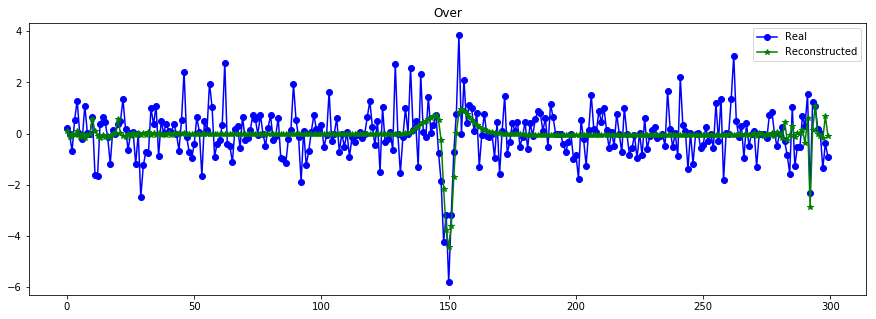

----------------------------------------------------------------


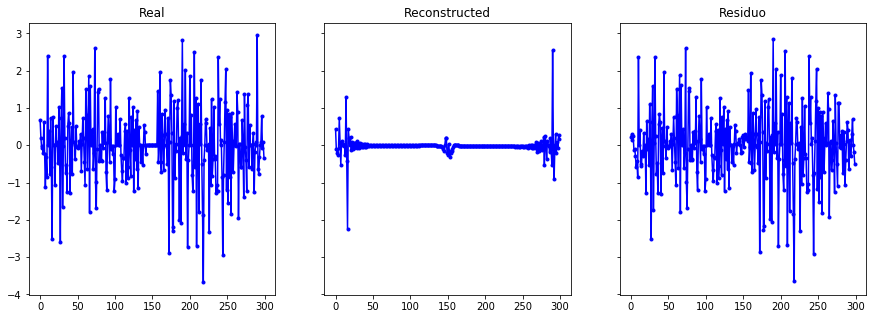

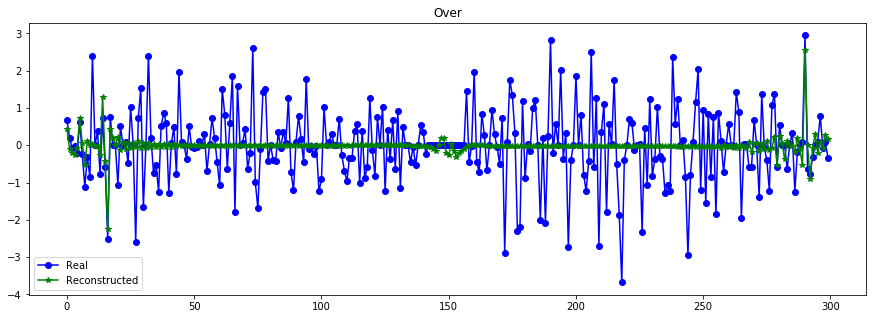

----------------------------------------------------------------


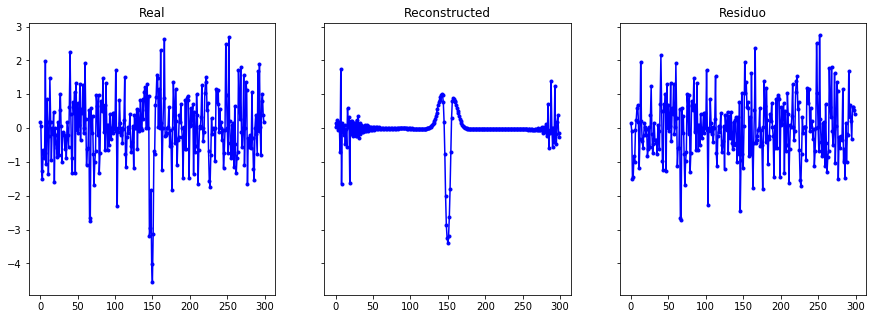

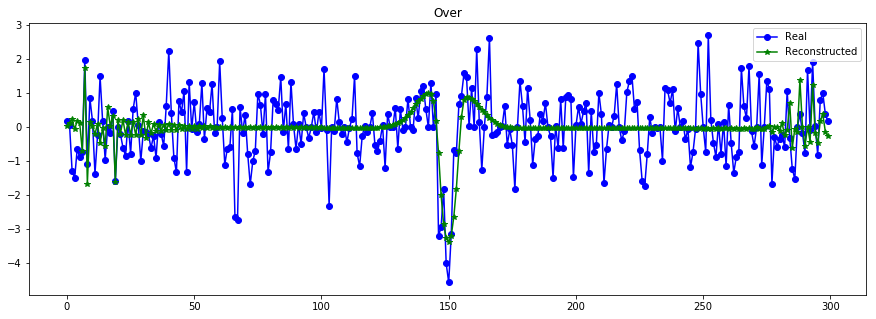

----------------------------------------------------------------


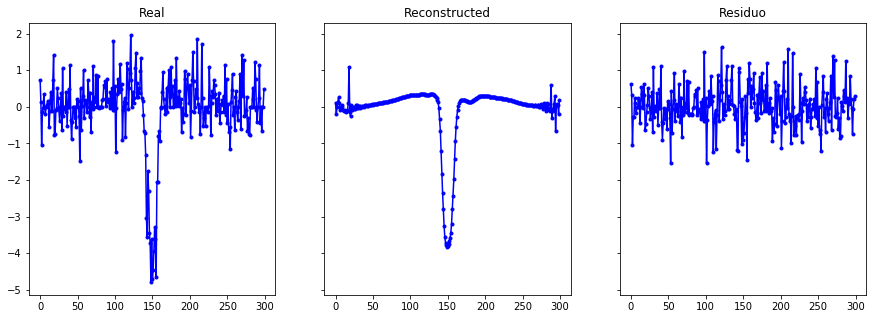

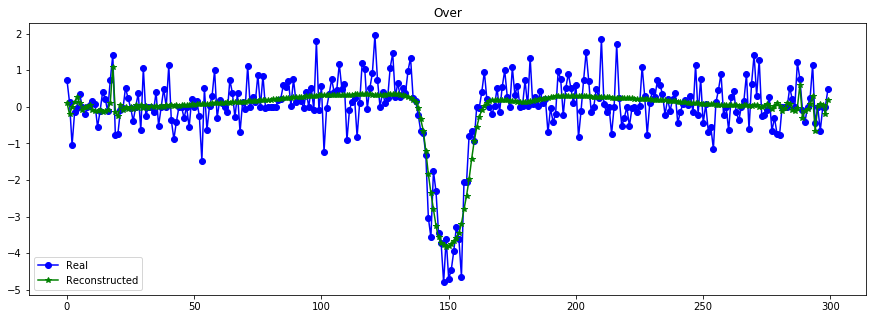

----------------------------------------------------------------


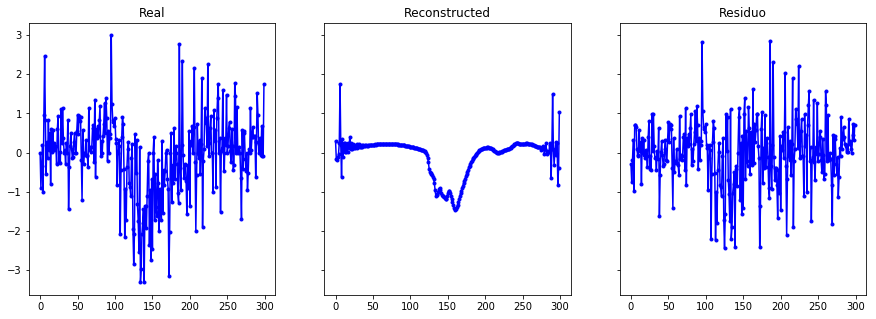

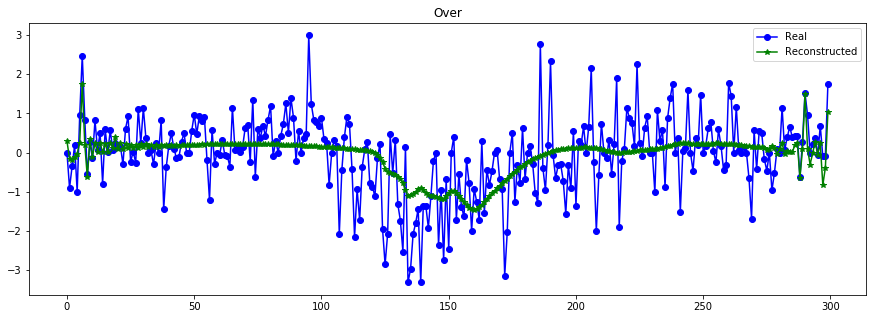

----------------------------------------------------------------


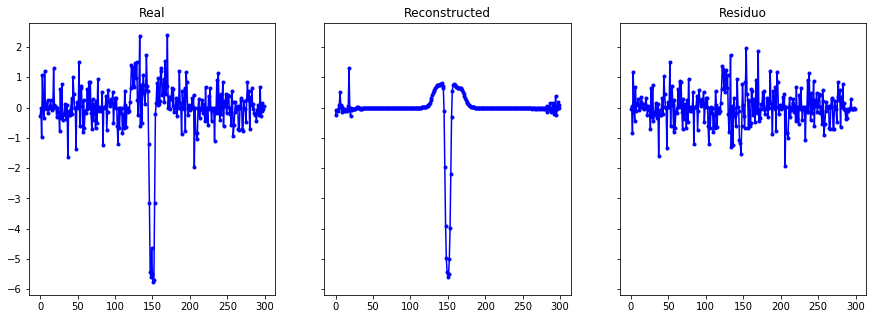

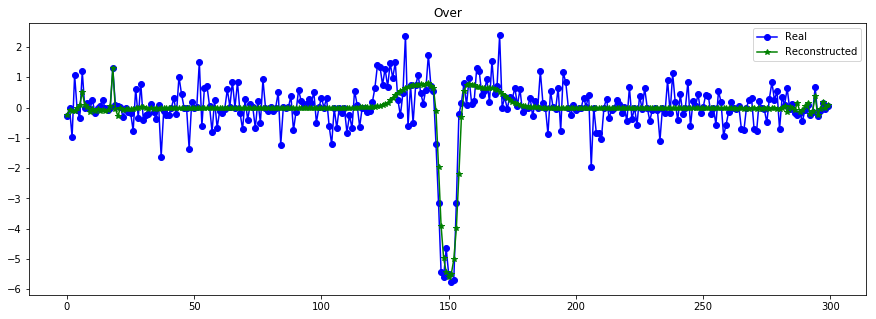

----------------------------------------------------------------


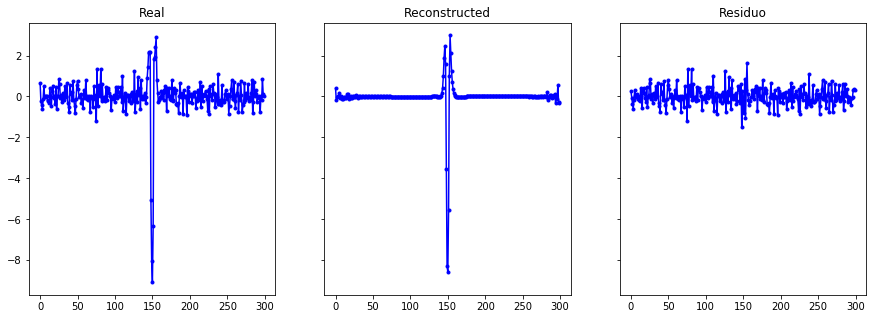

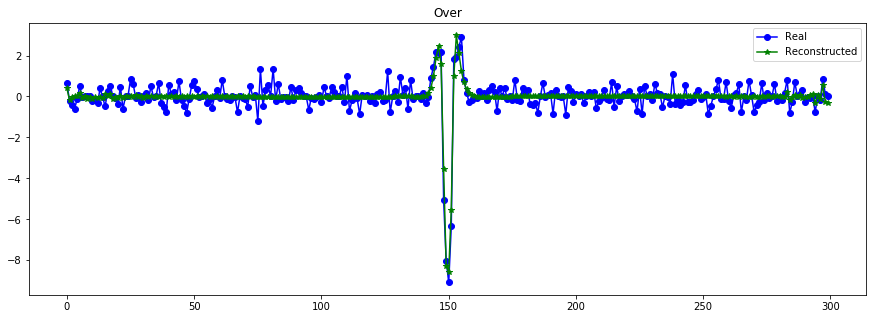

----------------------------------------------------------------


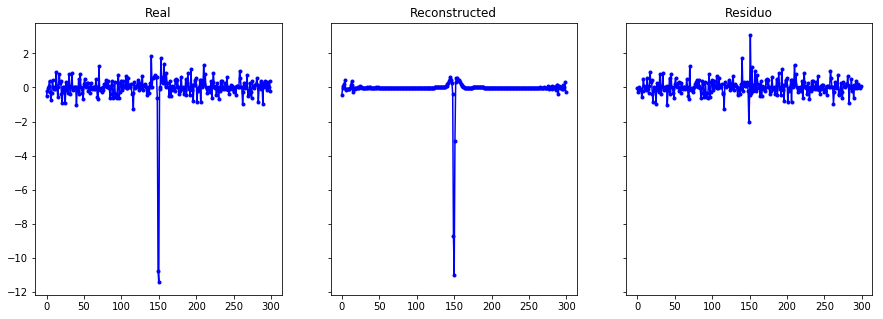

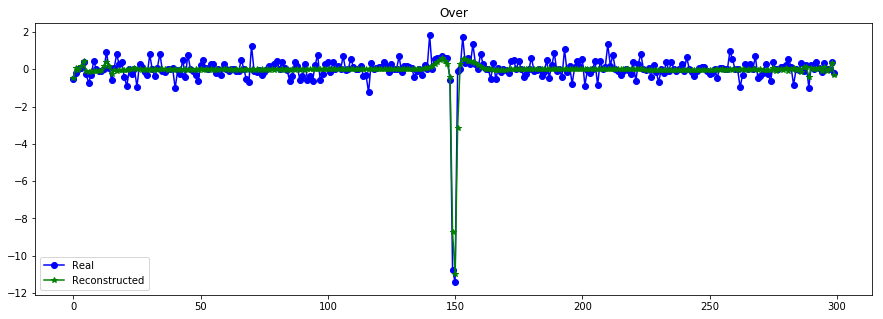

----------------------------------------------------------------


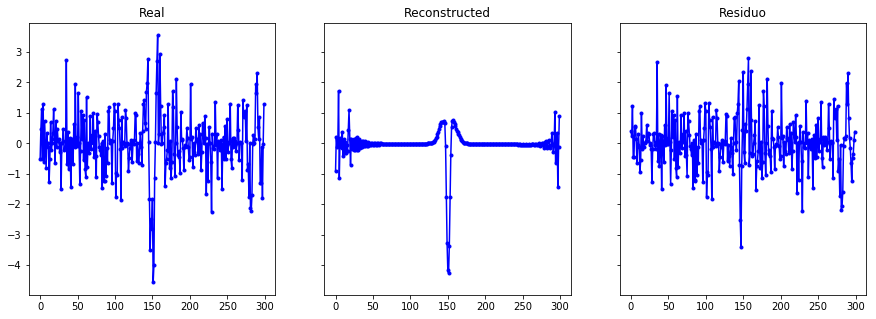

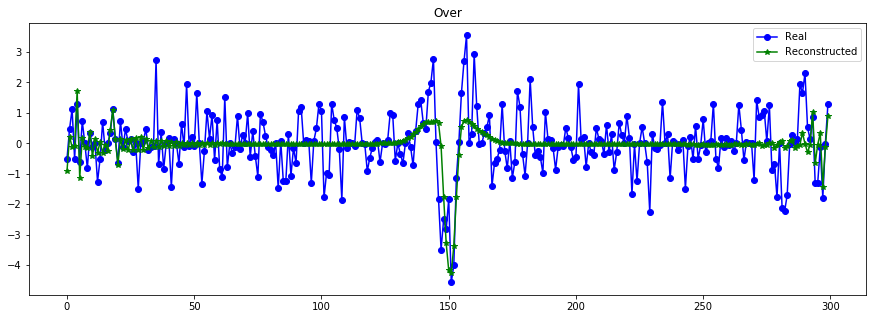

----------------------------------------------------------------


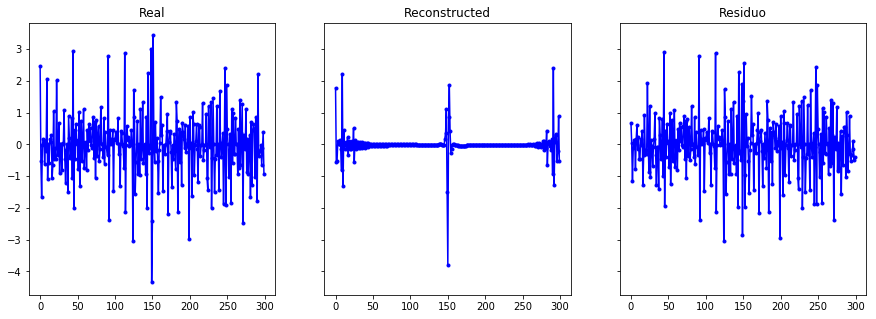

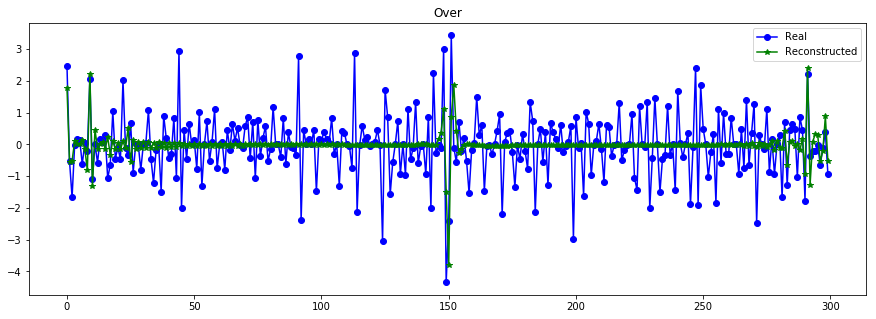

----------------------------------------------------------------


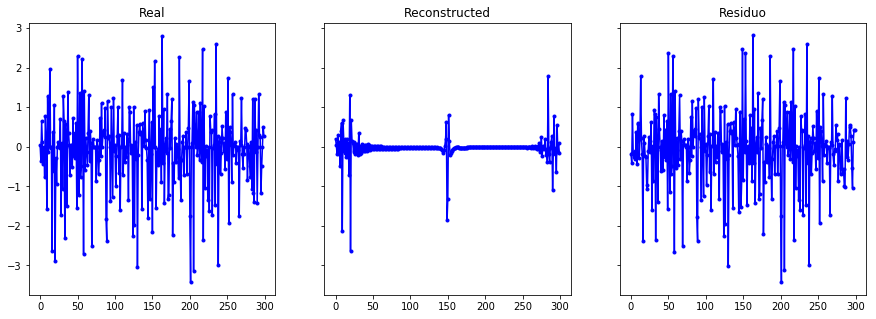

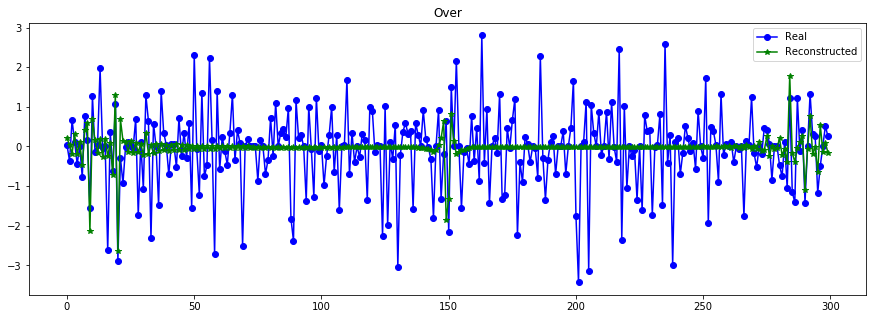

----------------------------------------------------------------


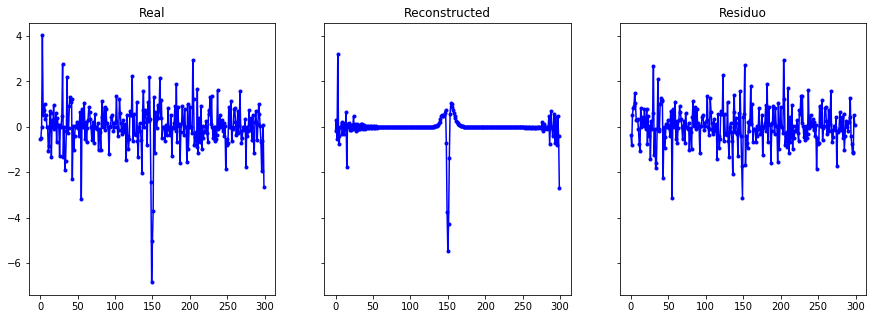

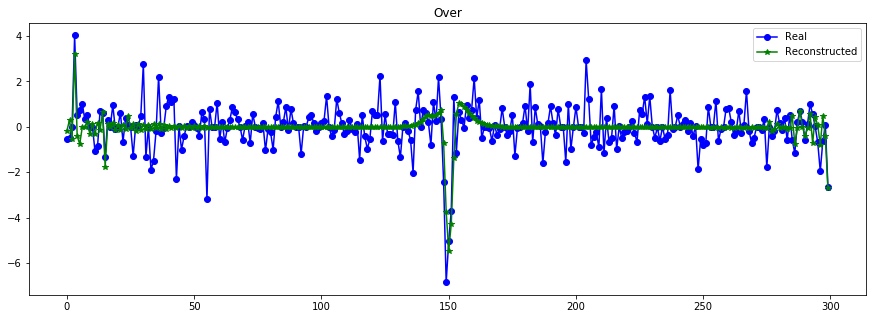

----------------------------------------------------------------


In [23]:
X_train_hat = AE_m.predict([X_train_t[:N], X_train[:N]], batch_size=512)
evaluate_reconst(X_train[:N], X_train_hat)

plot_n_lc(X_train[:N,:,0], X_train_hat, n= 15) #### 16

/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


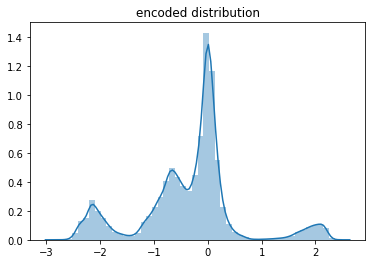

In [19]:
z_enc = AE_m.get_layer("encoder").predict([X_train_t_all, X_train_all], batch_size=512)

sns.distplot(z_enc.flatten())
plt.title("encoded distribution")
plt.show()

In [ ]:
from sklearn.decomposition import KernelPCA
model = KernelPCA(2, kernel='rbf', gamma=None, n_jobs=-1)    
to_plot = model.fit_transform(z_enc)

plt.figure(figsize=(10,7))
mask_ = (all_labels=="CONFIRMED")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="CONFIRMED", alpha=0.7)

mask_ = (all_labels=="FALSE POSITIVE")
plt.scatter(to_plot[:,0][mask_],to_plot[:,1][mask_], label="FALSE", alpha=0.3)

plt.legend()
plt.show()

In [20]:
np.save("./LC_features/AE_%dT_%dD_simp.npy"%(T,latent_dim), z_enc)
!ls ./LC_features

AE_300T_16D.npy		   FourierPCA_300T_32D.npy    VAE_300T_32D.npy
AE_300T_16D_simp.npy	   FourierPCA_71427T_32D.npy  VAE_300T_32D_var.npy
AE_300T_16D_v2.npy	   MetadataLC.npy	      VAE_S_300T_16D.npy
AE_300T_32D.npy		   old			      VAE_S_300T_16D_var.npy
FourierICA_300T_32D.npy    VAE_300T_16D.npy	      VAE_S_300T_32D.npy
FourierICA_71427T_32D.npy  VAE_300T_16D_var.npy       VAE_S_300T_32D_var.npy


### AE sin tiempo
---
demasiado overfitting

----- EVALUANDO RECONSTRUCCION DE LA CURVA -----


/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


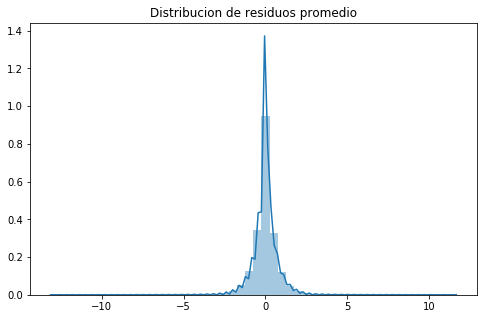

MSE      =  0.4546302783205186
RMSE (+-)=  0.6303723166722509
MAE  (+-)=  0.4476452684693792
--------- Smoothness ------------
AutoCorr lag-one =  0.42860636
Diff MEAN =  0.20617865
Diff STD =  0.6044629
--------- Smoothness ------------


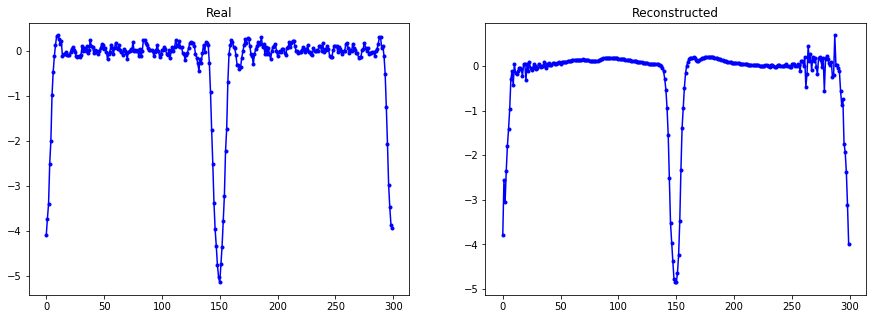

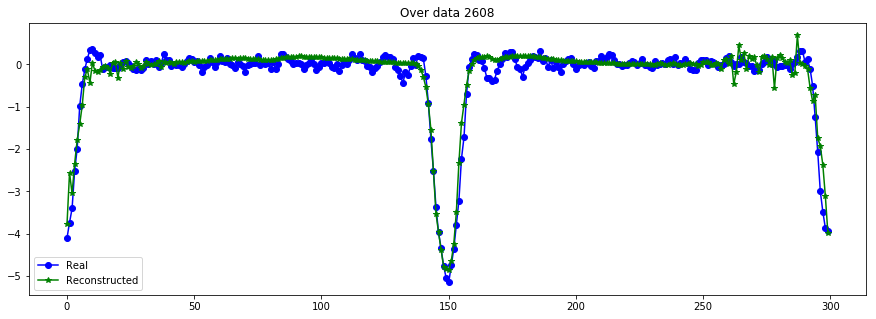

----------------------------------------------------------------


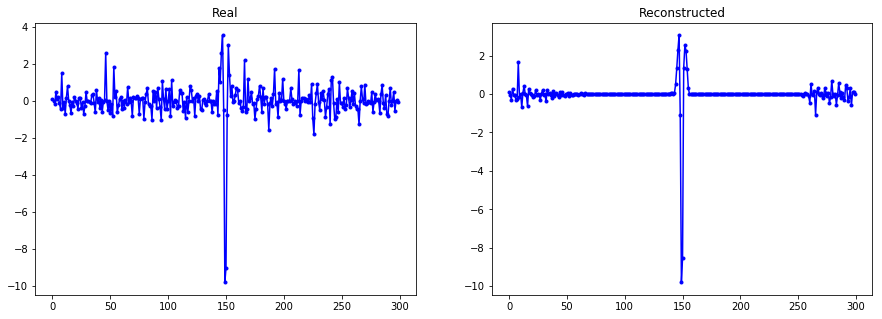

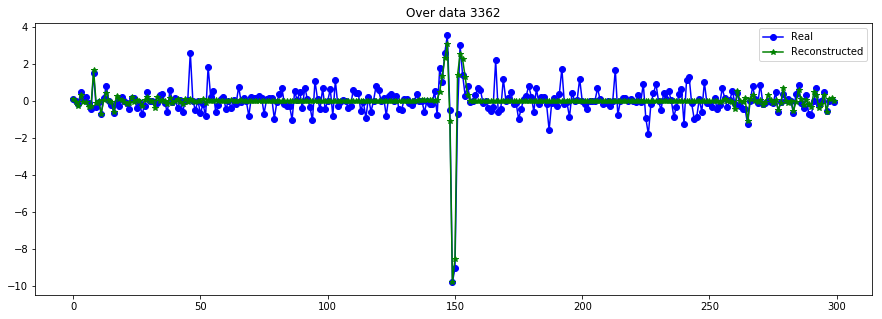

----------------------------------------------------------------


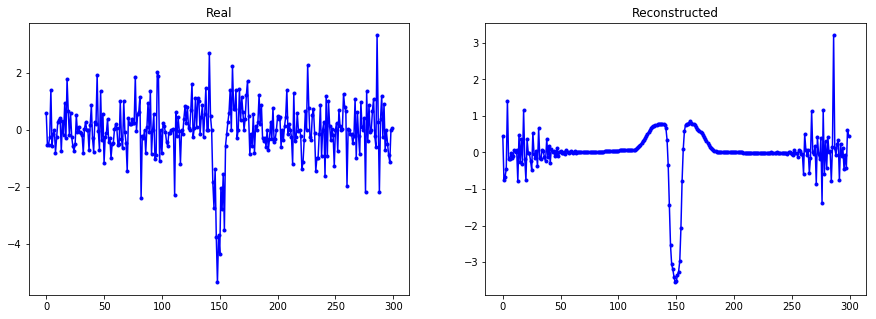

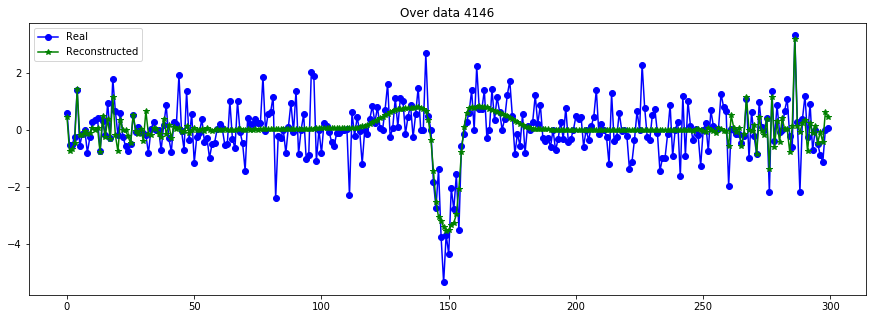

----------------------------------------------------------------


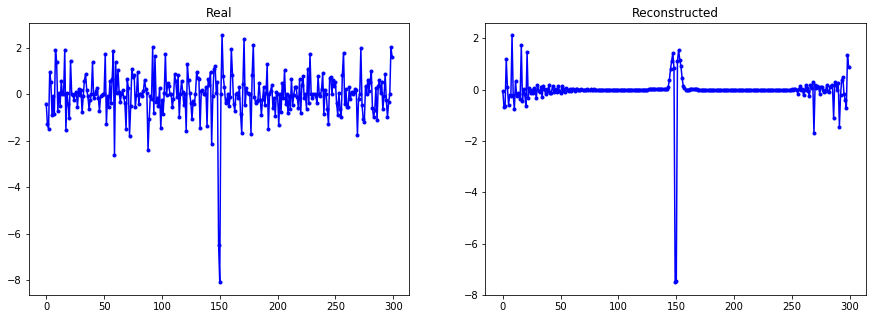

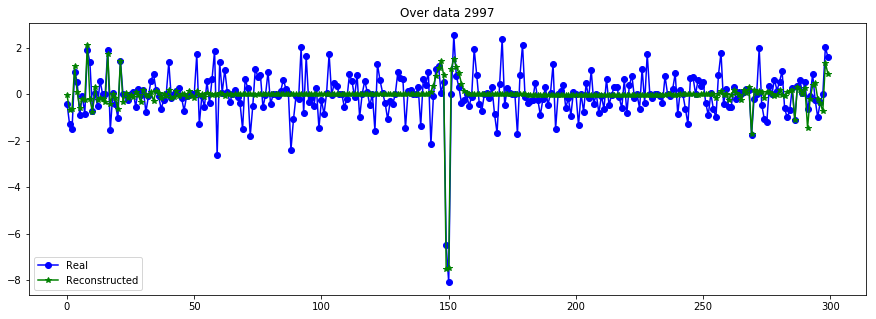

----------------------------------------------------------------


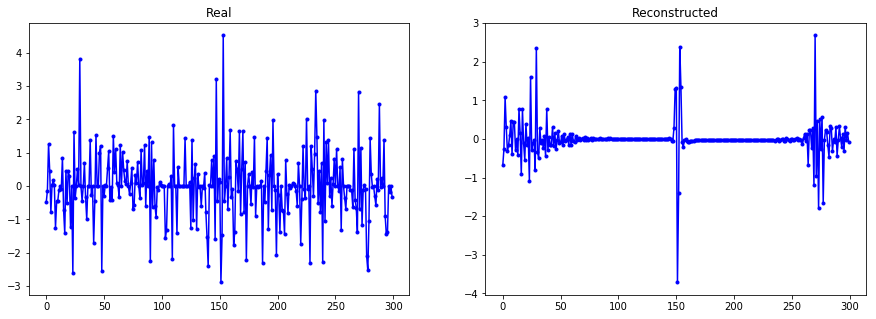

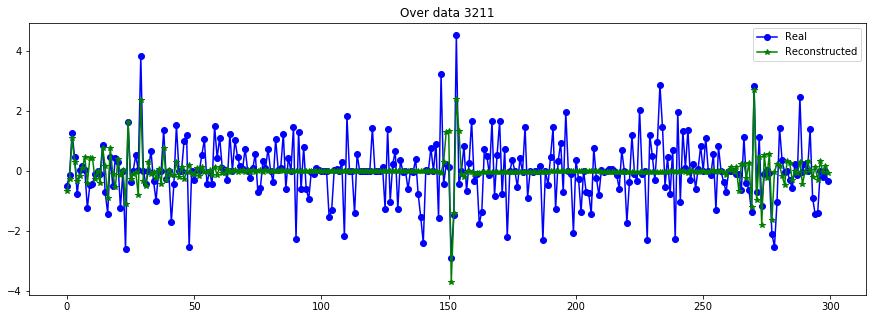

----------------------------------------------------------------


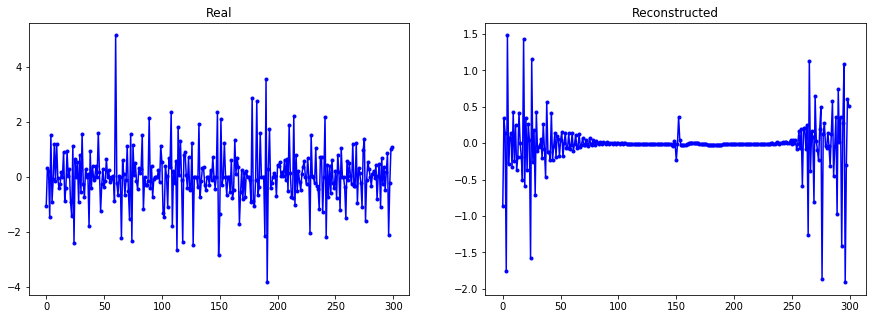

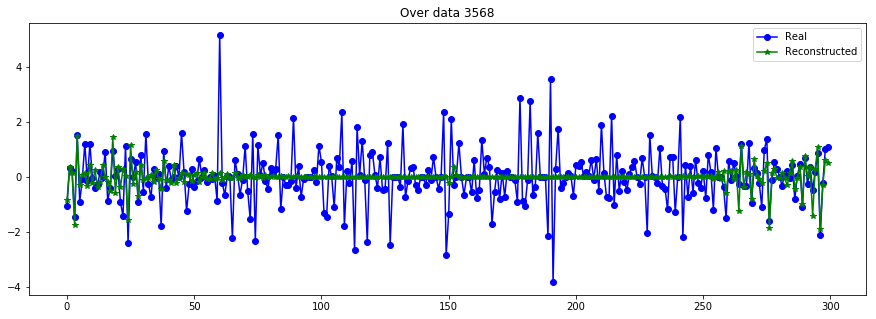

----------------------------------------------------------------


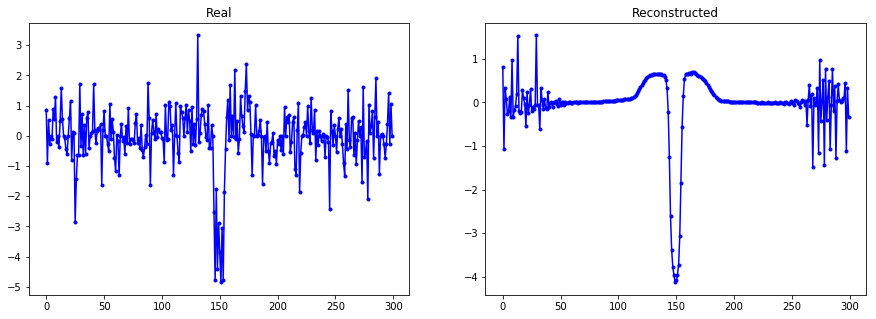

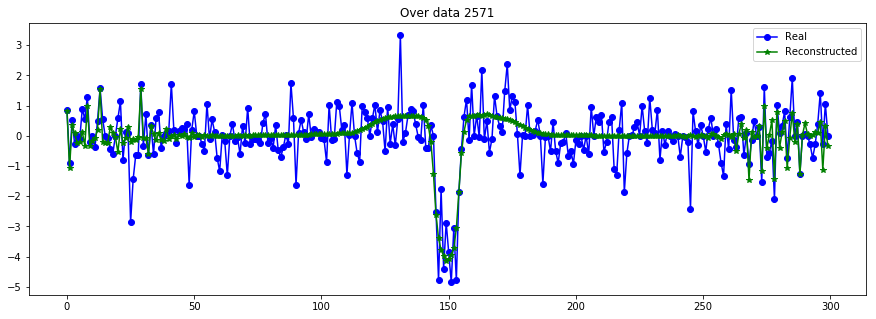

----------------------------------------------------------------


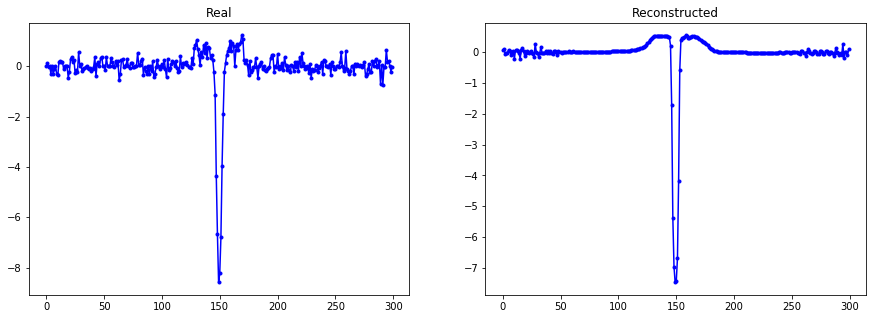

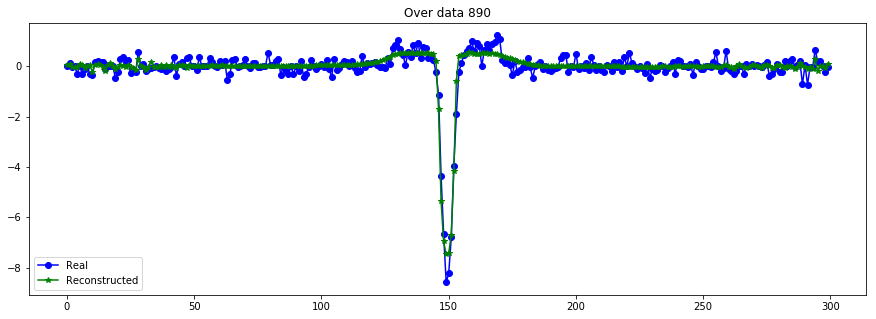

----------------------------------------------------------------


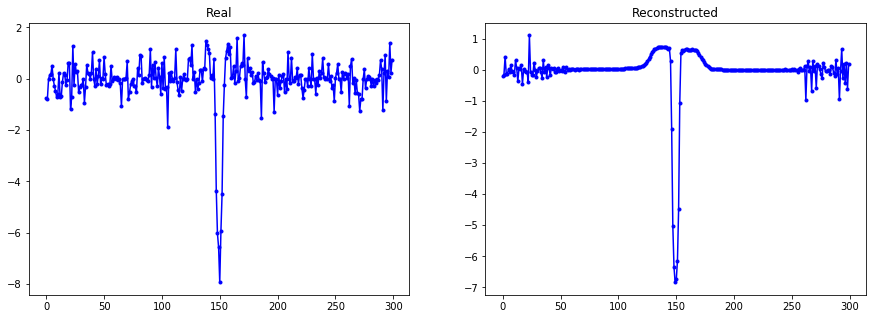

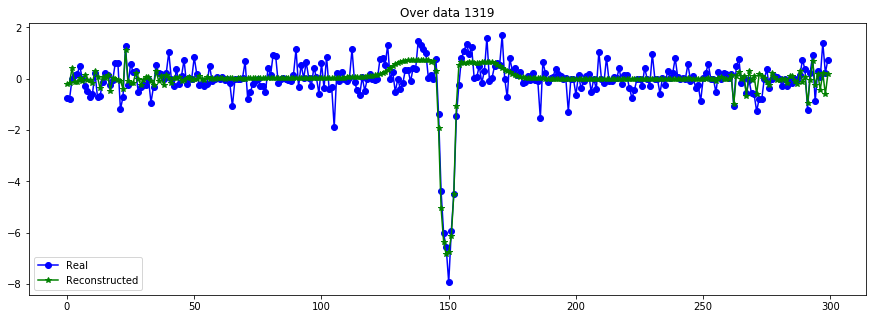

----------------------------------------------------------------


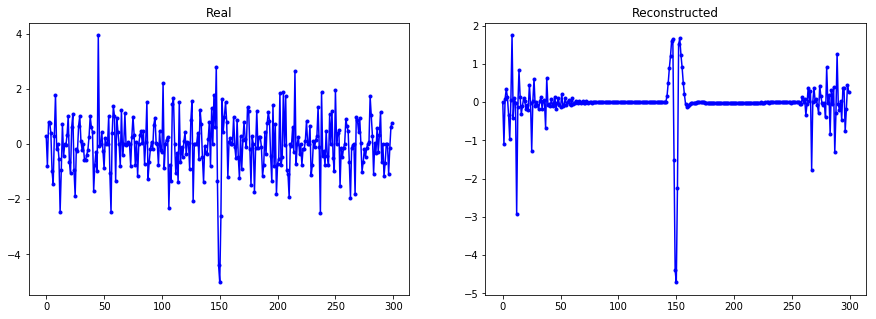

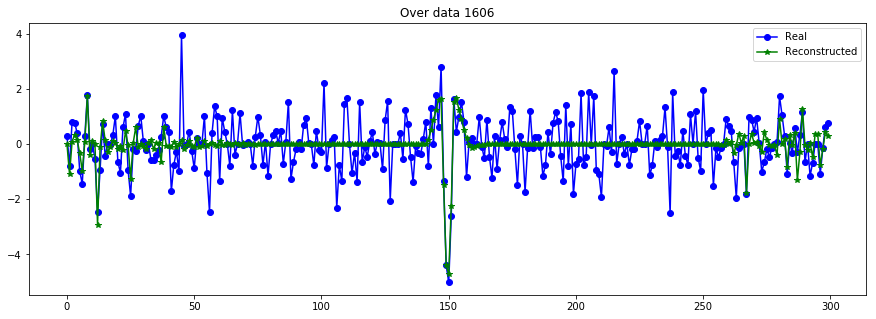

----------------------------------------------------------------


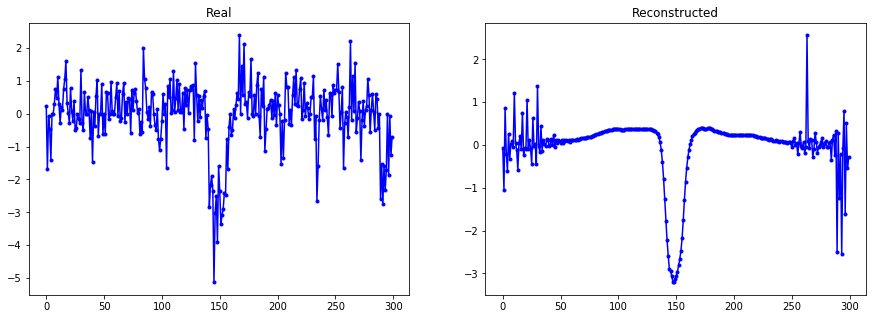

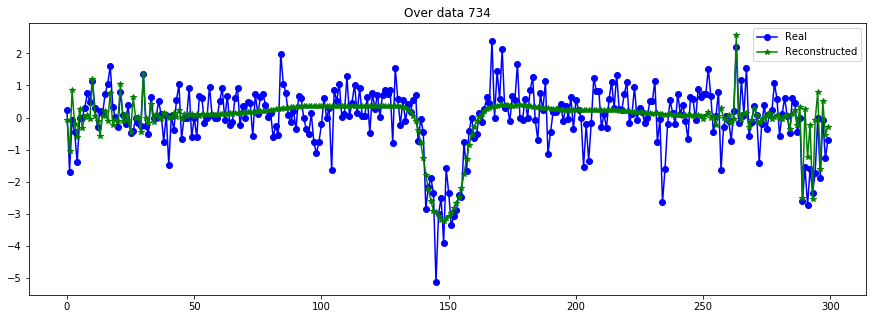

----------------------------------------------------------------


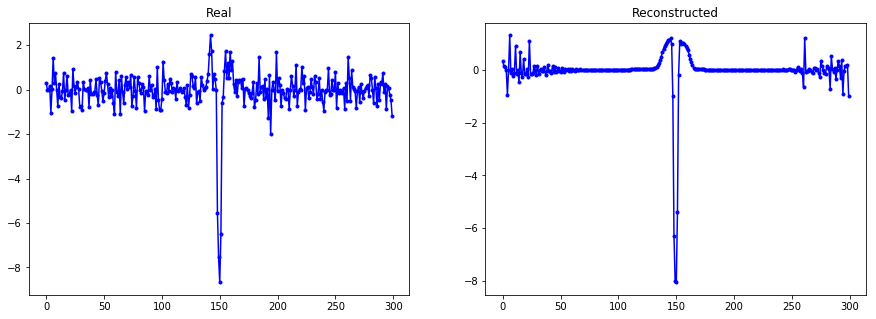

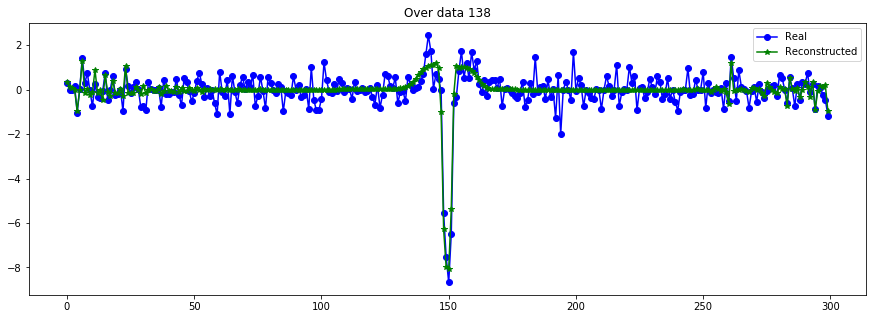

----------------------------------------------------------------


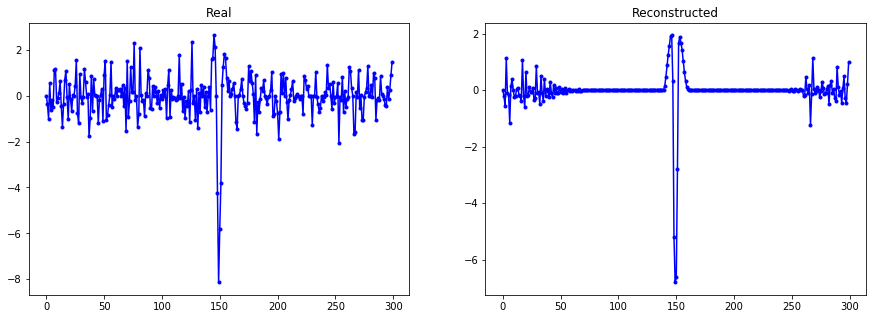

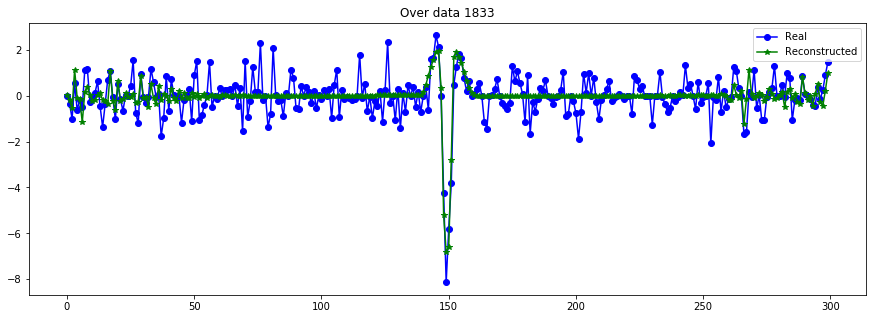

----------------------------------------------------------------


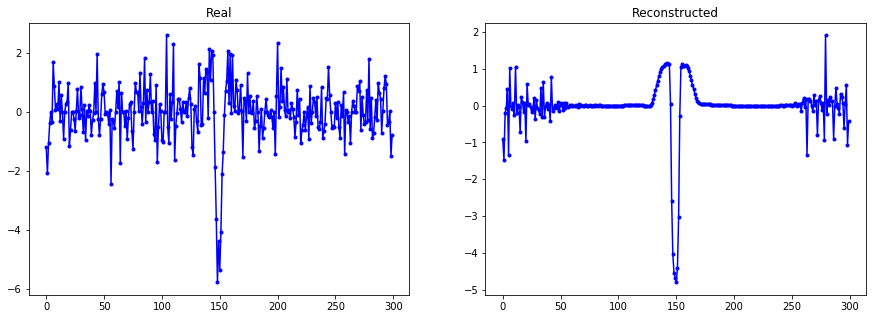

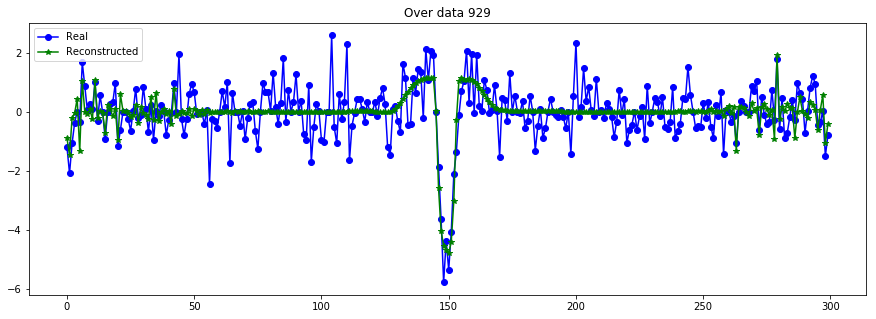

----------------------------------------------------------------


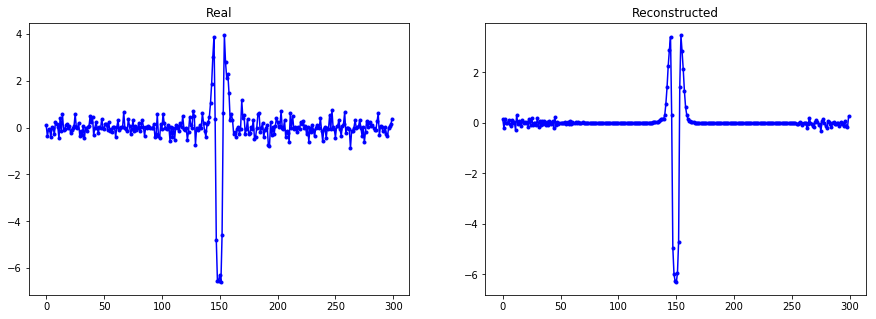

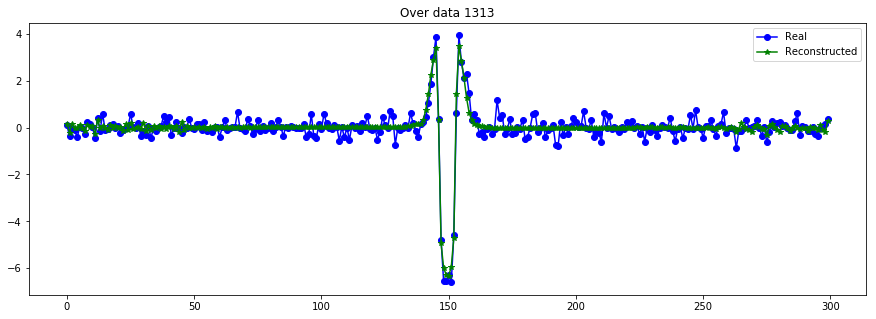

----------------------------------------------------------------


In [29]:
X_train_hat = AE_m.predict(X_train[:N], batch_size=512)
evaluate_reconst(X_train[:N], X_train_hat)

plot_n_lc(X_train[:N,:,0], X_train_hat, n= 15)

/home/casapanshop/anaconda2/envs/py3/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


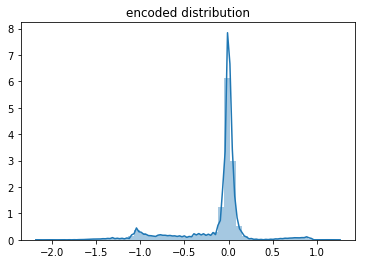

In [30]:
z_enc = encoder.predict(X_train_all, batch_size=512)

sns.distplot(z_enc.flatten())
plt.title("encoded distribution")
plt.show()